## Table of Contents:

* [Introduction](#Introduction)
* [Import Libraries](#import-libraries)
* [Selecting a Single Stock](#selecting_a_single_stock)
* [KPSS Test for Stationarity Test](#kpss)
* [ADF Test for Stationarity Test](#adf)
* [Selecting the Order of Differencing(d)](#d)
* [Selecting the Order of AR(p)](#p)
* [Selecting the Order of MA(q)](#q)
* [Fitting the ARIMA model](#fit)
* [Residual Plot](#resid)
* [Auto ARIMA Forecasting using PMDARIMA](#auto)
* [Fitting the Prophet model](#fit)
* [OUT-Of-Sample Forecast](#OUT)
* [Comparison of MAPE Plot ](#MAPE)
* [Summary across all the Consumer Companies](#sum)





## Introduction <a class="anchor" id="Introduction"></a>

ARIMA, short for 'Auto Regressive Integrated Moving Average' is actually a class of models that explains a given time series based on its own past values, that is, its own lags and the lagged forecast errors, so that equation can be used to forecast future values.
In this post, we build an optimal ARIMA model from scratch and later in this post we have used PMDARIMA and Prophet to 
build the ARIMA model automatically.

## Importing the necessary libraries <a class="anchor" id="import-libraries"></a>

In [390]:
import pandas as pd
import datetime as dt
from datetime import datetime
from urllib.error import HTTPError
import re
import csv
import warnings
import numpy as np
import pickle
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf,plot_predict
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
import pmdarima as pm
import scipy.stats as stats
from scipy.stats import boxcox
from sklearn.metrics import mean_squared_error
import fbprophet
from prophet import Prophet
import pandas as pd
import datetime as dt
from datetime import datetime
from urllib.error import HTTPError
#import pandas_market_calendars as mcal
#import requests
#from bs4 import BeautifulSoup
from sklearn import datasets, linear_model, metrics
from statsmodels.tools.sm_exceptions import ConvergenceWarning
import time

## Picking a single stock data<a class="anchor" id="selecting_a_single_stock"></a>

In [323]:
with open('cons_cyc_df_years.pickle', 'rb') as handle:
    cons_cyc_df_years = pickle.load(handle)
cons_cyc_df_years

{'AAN':               Open    High     Low   Close     Volume  Daily_Returns
 2006-01-03  13.900  14.276  13.617  14.187   462513.0       0.029237
 2006-01-04  14.196  14.206  13.900  13.998   327965.0      -0.013322
 2006-01-05  13.968  13.978  13.784  13.803   231487.0      -0.013931
 2006-01-06  13.940  14.058  13.705  14.058   325213.0       0.018474
 2006-01-09  14.078  14.412  14.038  14.325   780383.0       0.018993
 ...            ...     ...     ...     ...        ...            ...
 2017-11-06  36.280  36.570  35.570  35.590  1029506.0      -0.023058
 2017-11-07  35.720  35.720  34.290  34.440  1149793.0      -0.032312
 2017-11-08  35.510  36.090  34.800  35.990  1805497.0       0.045006
 2017-11-09  35.680  35.860  35.230  35.620   979951.0      -0.010281
 2017-11-10  37.600  38.060  36.260  36.590  1214968.0       0.027232
 
 [2987 rows x 6 columns],
 'ANF':               Open    High      Low   Close     Volume  Daily_Returns
 2006-01-03  54.419  54.938  53.6180  54.186  3

In [379]:
amazon_cl = cons_cyc_df_years['AMZN'][['Close']]
amazon_return = cons_cyc_df_years['AMZN'][['Daily_Returns']]
amazon_cl

,Close
2006-01-03,47.58
2006-01-04,47.25
2006-01-05,47.65
2006-01-06,47.87
2006-01-09,47.08
...,...
2017-11-06,1120.66
2017-11-07,1123.17
2017-11-08,1132.88
2017-11-09,1129.13


## KPSS test for stationarity<a class="anchor" id="kpss"></a>

KPSS is test to check for stationarity in the presence of a deterministic trend. 

Null Hypothesis(H0): Time series is stationary around a deterministic trend. 

Alternative Hypothesis(Ha): Time series has unit root, i.e., non-statinary. 

In [85]:
def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="ct", nlags="auto")
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    return (kpss_output)

df = kpss_test(amazon_cl.values)
df1 = kpss_test(amazon_return.values)
print (df, df1)

Results of KPSS Test:
Results of KPSS Test:
Test Statistic            1.70966
p-value                   0.01000
Lags Used                32.00000
Critical Value (10%)      0.11900
Critical Value (5%)       0.14600
Critical Value (2.5%)     0.17600
Critical Value (1%)       0.21600
dtype: float64 Test Statistic            0.031492
p-value                   0.100000
Lags Used                12.000000
Critical Value (10%)      0.119000
Critical Value (5%)       0.146000
Critical Value (2.5%)     0.176000
Critical Value (1%)       0.216000
dtype: float64


/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


The p-value reported by the test is the probability score based on which you can decide whether to reject the null hypothesis or not. If the p-value is less than a predefined alpha level (typically 0.05), we reject the null hypothesis.
So, here we can say that amazon closing price is not stationary(rejecting the H0) and for amazon return price, we fail to reject the null hypothesis, i.e., time series is sationatinary. 


## ADF test for stationarity<a class="anchor" id="adf"></a>

ADF test is for checking the stationarity.
H0: The null hypothesis of the ADF test is that the time series is non-stationary.
Ha: The alternative hypothesis of the ADF test is that the time series is stationary.     

In [86]:
result_closing = adfuller(amazon_cl.values)
result_return = adfuller(amazon_return.values)

print (result_closing)
print (result_return)

(2.9097423703974257, 1.0, 29, 2957, {'1%': -3.432563387143659, '5%': -2.8625179291294662, '10%': -2.5672905782716513}, 19642.916397494984)
(-41.231323939010906, 0.0, 1, 2985, {'1%': -3.432542607157588, '5%': -2.8625087513967085, '10%': -2.5672856921402096}, -13356.91284047806)


## How to find the order of differencing (d)<a class="anchor" id="d"></a>

The purpose of differencing it to make the time series stationary. The right order of differencing is the minimum differencing required to get a near-stationary series which roams around a defined mean and the ACF plot reaches to zero fairly quick.
If the autocorrelations are positive for many number of lags (10 or more), then the series needs further differencing. On the other hand, if the lag 1 autocorrelation itself is too negative, then the series is probably over-differenced.



<Figure size 432x288 with 0 Axes>

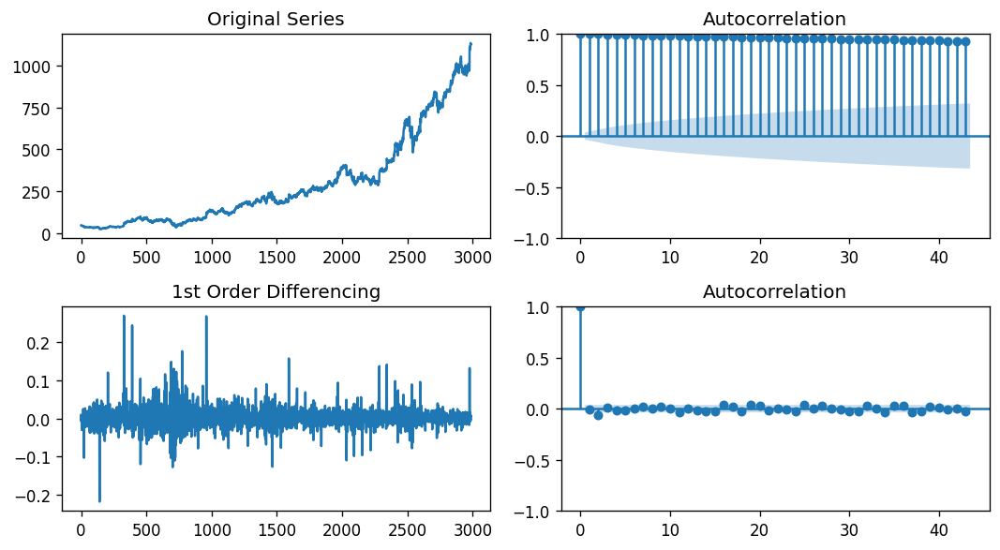

In [87]:
plt.clf()
plt.rcParams.update({'figure.figsize':(9,5), 'figure.dpi':120})
fig, axes = plt.subplots(2, 2, sharex=False)
axes[0, 0].plot(amazon_cl.values)
axes[0, 0].set_title('Original Series')
#plot_acf(amazon_cl.values, ax=axes[0, 1])
sm.graphics.tsa.plot_acf(amazon_cl.values, ax=axes[0, 1], lags = 43)

# 1st Differencing
axes[1, 0].plot(amazon_return.values)
axes[1, 0].set_title('1st Order Differencing')
sm.graphics.tsa.plot_acf(amazon_return.values, ax=axes[1, 1], lags = 43)
fig.tight_layout()
plt.show()

From the stationarity tests (KPSS and ADF) and the correlation plots above, it can be said that 
closing price of Amazon stock price is not stationary. However, after first differencing (daily returns), it looks like the stock price follows stationarity.
So, it seems like differencing(d) = 1 will serve the purpose, i.e., data follows the stationarity.

## How to find the order of AR term (p)<a class="anchor" id="p"></a>

The next step is to identify if the model needs any AR terms. You can find out the required number of AR terms by inspecting the Partial Autocorrelation (PACF) plot.
Partial autocorrelation can be imagined as the correlation between the series and its lag, after excluding the contributions from the intermediate lags. So, PACF sort of conveys the pure correlation between a lag and the series. That way, you will know if that lag is needed in the AR term or not.

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


<Figure size 1080x600 with 0 Axes>

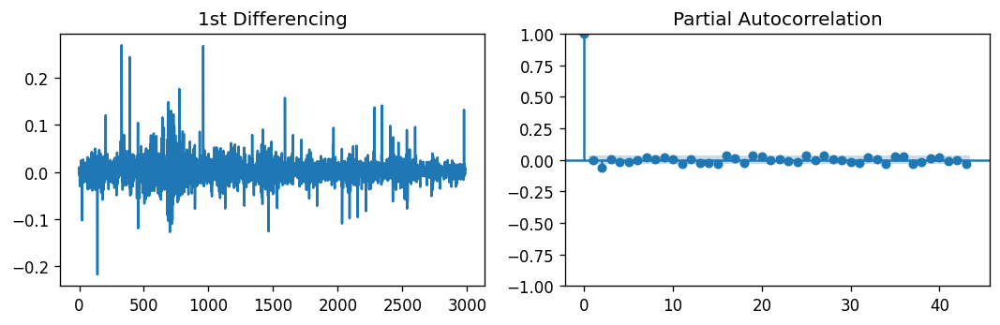

In [88]:
plt.clf()
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
fig, axes = plt.subplots(1, 2, sharex=False)
axes[0].plot(amazon_return.values)
axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
sm.graphics.tsa.plot_pacf(amazon_return.values, ax = axes[1], lags = 43)
fig.tight_layout()
plt.show()

You can observe that the PACF lag 2 is slightly significant, just managing to cross the significance limit (blue region). So, lets start with p as 2.

## How to find the order of MA term (q)<a class="anchor" id="q"></a>

Just like how we looked at the PACF plot for the number of AR terms, we can look at the ACF plot for the number of MA terms. An MA term is technically, the error of the lagged forecast.
The ACF tells how many MA terms are required to remove any autocorrelation in the stationarized series.
From the above ACF plot, it does not seem like there is any significant lags. However, there 
is a very small lag appears to be minutely significant at lag = 2. 
So, lets start to model with (2,1,2) order and then we will play around and see which model fits the best. 


## Building ARIMA model<a class="anchor" id="fit"></a>

Now that the values of p, d and q have been determined, next we can fit the ARIMA model. 

In [142]:
model = ARIMA(amazon_cl, order=(2,1,2))
model_fit = model.fit()
print(model_fit.summary())

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  Close   No. Observations:                 2987
Model:                 ARIMA(2, 1, 2)   Log Likelihood               -9911.621
Date:                Wed, 02 Mar 2022   AIC                          19833.243
Time:                        23:37:29   BIC                          19863.251
Sample:                             0   HQIC                         19844.039
                               - 2987                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0708      0.162      6.599      0.000       0.753       1.389
ar.L2         -0.5176      0.172     -3.016      0.003      -0.854      -0.181
ma.L1         -1.0466      0.165     -6.332      0.0

The model summary reveals a lot of information. The table in the middle is the coefficients table where the values under 'coef' are the weights of the respective terms.

Notice here the coefficient of all the terms are significant and the P-Value in 'P>|z|' column is highly significant (<0.05).


In [187]:
import seaborn as sns
sns.set()
def arima_model_eval_baseline(data, arima_order):
    #baseline_rmse_list = []
    #baseline_mape_list = []
    split = int(len(data) * 0.99)
    train1 = data[0:split]
    test1 =  data[split:]
    # walk-forward validation
    history = [x for x in train1]
    predictions = []
    for i in range(len(test1)):
    # predict
        yhat = history[-1]
        predictions.append(yhat)
    # observation
        obs = test1[i]
        history.append(obs)
        
# report performance
    mse = mean_squared_error(test1, predictions)
    baseline_rmse = np.sqrt(mse)
    baseline_mape = np.mean(np.abs(test1 - predictions)/np.abs(test1))
    #print('RMSE: %.3f' % rmse,  'MAPE: %.3f' % mape)
    baseline_rmse_list = ((np.square(np.subtract(test1,predictions))))
    baseline_mape_list = (np.abs(test1 - predictions)/np.abs(test1))
    baseline_rmse_list = list(map(lambda x :x[0], baseline_rmse_list))
    baseline_mape_list = list(map(lambda x :x[0], baseline_mape_list))
    #print (np.mean(baseline_rmse_list))
    #print (baseline_rmse_list)
    #sns.distplot(baseline_mape_list, color = 'maroon', kde = True)#kind = 'kde'
    return (baseline_mape_list, baseline_rmse, baseline_mape)
    
baseline_model = arima_model_eval_baseline(amazon_cl.values, (2,1,2))


[ 959.19  957.1   965.45  980.85  989.51  990.99  987.2   995.   1000.93
 1002.94 1006.34 1009.13  997.    986.61  982.91  966.3   975.9   972.91
  972.43 1100.95 1110.85 1105.28 1103.68 1094.22 1111.6  1120.66 1123.17
 1132.88 1129.13 1125.35]
[ 960.02910388  958.84367768  957.63570259  965.97326342  980.11055062
  989.16906708  991.54614718  987.64909482  994.74801848 1000.44814996
 1003.01606006 1006.87832066 1009.23885166  996.33788015  986.24688573
  983.44467458  966.63607107  975.72222083  972.41749236  972.46316259
 1103.21207876 1109.24886744 1100.67978883 1099.33993999 1091.18009661
 1111.99159791 1120.98258179 1122.12556811 1133.3211993  1128.25173199]
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


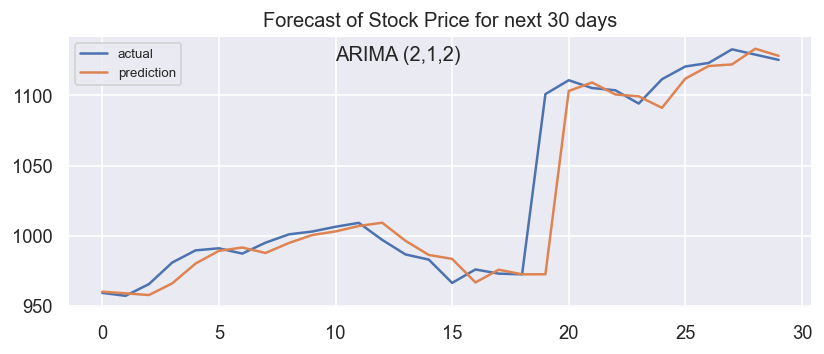

In [285]:
def arima_model_eval_manual(data, arima_order):
    split = int(len(data) * 0.99)
    train1 = data[0:split]
    test1 = data[split:len(data)]
    history = [x for x in train1]
    prediction = []
    for i in range(len(test1)):
        model = ARIMA(history, order = arima_order)
        model_fit = model.fit()
        warnings.simplefilter('ignore', ConvergenceWarning)
        model_forecast = model_fit.forecast()
        prediction.append(model_forecast[0])
        obs = test1[i]
        history.append(obs)
    test1 = np.array(list(map(lambda x: x[0], test1)))
    prediction = np.array(prediction)
    mse = mean_squared_error(test1,prediction)
    arima_rmse = np.sqrt(mse)
    arima_mape = np.mean(np.abs(test1 - prediction)/np.abs(test1))
    arima_rmse_list = ((np.square(np.subtract(test1,prediction))))
    arima_mape_list = (np.abs(test1 - prediction)/np.abs(test1))
    #arima_rmse_list = list(map(lambda x :x[0], arima_rmse_list))
    #arima_mape_list = list(map(lambda x :x[0], arima_mape_list))
    plt.plot(test1, label = 'actual') 
    plt.plot(prediction, label = 'prediction') 
    plt.title('Forecast of Stock Price for next 30 days')
    plt.legend(loc='upper left', fontsize=8)
    plt.text(10,1125,'ARIMA (2,1,2)', fontsize = 12)
    plt.show()
    return (arima_mape_list, arima_rmse, arima_mape)
arima_model = arima_model_eval_manual(amazon_cl.values, (2,1,2))

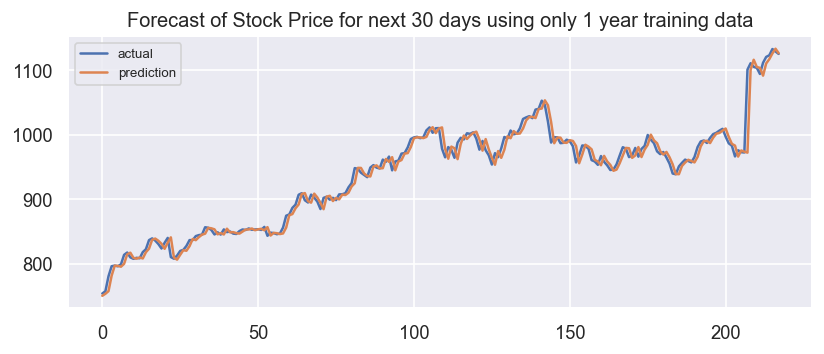

RMSE: 118.907 MAPE: 0.088


In [207]:
amazon_cl_15_17 = amazon_cl.loc[pd.to_datetime('2015'):pd.to_datetime('2018')]
amazon_cl_15_17_list = list(map(lambda x: x[0],amazon_cl_15_17.values.tolist()))
train_size = amazon_cl_15_17.loc[pd.to_datetime('2015'):pd.to_datetime('2017')].shape[0]
train_list = amazon_cl_15_17_list[:train_size]
test_list = amazon_cl_15_17_list[train_size:]
pred = []

for i in range(len(test_list)):
    arima_model = ARIMA(train_list,order = (2,1,2))
    fitted = arima_model.fit()
    warnings.simplefilter('ignore', ConvergenceWarning)
    forecast = fitted.forecast()
    pred.append(forecast[0])
    del train_list[0]
    train_list.append(test_list[i])
    
plt.plot(test_list, label = 'actual') 
plt.plot(pred, label = 'prediction') 
plt.title('Forecast of Stock Price for next 30 days using only 1 year training data')
plt.legend(loc='upper left', fontsize=8)
plt.show()
    
rmse_metric = np.sqrt(mean_squared_error(test_list,pred))
mape_metric = np.mean(np.abs(np.array(test_list) - np.array(pred))/np.abs(np.array(test_list)))
print('RMSE: %.3f' % rmse,  'MAPE: %.3f' % mape)

## Residual plot<a class="anchor" id="resid"></a>

Let’s plot the residuals to ensure there are no patterns (that is, look for constant mean and variance).

                0
count   30.000000
mean     5.919072
std     24.466823
min    -17.144675
25%     -3.228097
50%      2.219549
75%      7.770203
max    128.486837


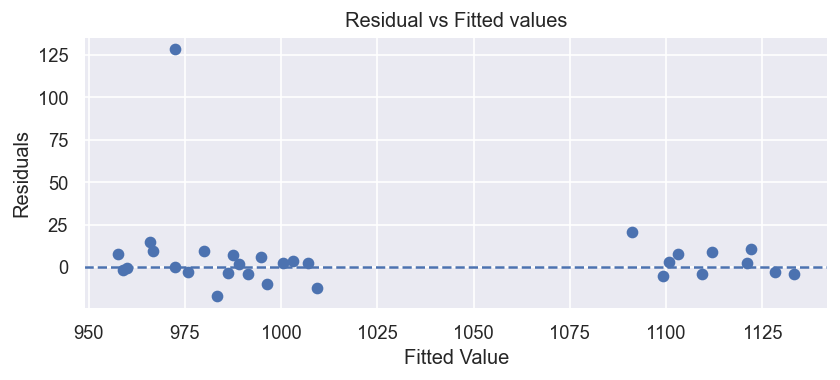

In [437]:
# Plot residual errors
plt.rcParams.update({'figure.figsize':(8,3), 'figure.dpi':120})

def arima_model_eval(data, arima_order):
    split = int(len(data) * 0.99)
    train1 = data[0:split]
    test1 = data[split:len(data)]
    history = [x for x in train1]
    prediction = []
    for i in range(len(test1)):
        model = ARIMA(history, order = arima_order)
        model_fit = model.fit()
        warnings.simplefilter('ignore', ConvergenceWarning)
        model_forecast = model_fit.forecast()
        prediction.append(model_forecast[0])
        obs = test1[i]
        history.append(obs)
    test1 = list(map(lambda x: x[0], test1))
    residuals = [test1[i]-prediction[i] for i in range(len(test1))]
    residuals = pd.DataFrame(residuals)
    print(residuals.describe())
    residuals = list(map(lambda x: x[0], residuals.values))
    plt.scatter(prediction, residuals)
    plt.title('Residual vs Fitted values')
    plt.xlabel('Fitted Value')
    plt.ylabel('Residuals')
    plt.axhline(ls = '--')
    #plt.legend(loc='upper left', fontsize=8)
    plt.show()
arima_model_eval(amazon_cl.values, (2,1,2))

## Auto Arima Forecast in Python (PMDARIMA)<a class="anchor" id="auto"></a>

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=19225.688, Time=0.50 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=19222.372, Time=0.06 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=19223.808, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=19223.794, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=19227.606, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.938 seconds


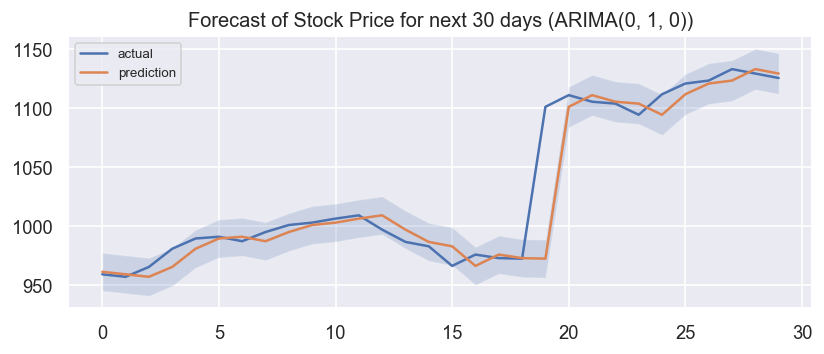

In [430]:
def pmdarima_model_eval(df):
    data = df.values
    split = int(len(data) * 0.99)
    train_pmdarima = data[0:split]
    train_pmdarima = list(map(lambda x: x[0],train_pmdarima))
    test_pmdarima = data[split:len(data)]
    test_pmdarima = list(map(lambda x: x[0],test_pmdarima))
    model_auto = pm.auto_arima(train_pmdarima, start_p=1, start_q=1,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=3, max_q=3, # maximum p and q
                      m=1,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=False,   # No Seasonality
                      start_P=0, 
                      D=0, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                        stepwise=True)
    history_pmd = [x for x in train_pmdarima]
    pmd_prediction = []
    ci_underline = []
    ci_overline = []
    for i in range(len(test_pmdarima)):
        model = ARIMA(history_pmd, order = model_auto.order)
        model_fit = model.fit()
        model_result = model_fit.get_forecast(steps=1)
        model_forecast = model_result.predicted_mean
        pmd_prediction.append(model_forecast[0])
        obs = test_pmdarima[i]
        history_pmd.append(obs)
        ci = model_result.conf_int(alpha=0.01)
        ci_underline.append(ci[0][0])
        ci_overline.append(ci[0][1])
    ci_underline = np.array(ci_underline)
    ci_overline = np.array(ci_overline)
    
    rng = np.array([i for i in range(0,len(test_pmdarima))])
    test_pmdarima = np.array(test_pmdarima)
    pmd_prediction = np.array(pmd_prediction)
    mse = mean_squared_error(test_pmdarima,pmd_prediction)
    pmdarima_rmse = np.sqrt(mse)
    pmdarima_mape = np.mean(np.abs(test_pmdarima - pmd_prediction)/np.abs(test_pmdarima))
    pmdarima_rmse_list = ((np.square(np.subtract(test_pmdarima,pmd_prediction))))
    pmdarima_mape_list = (np.abs(test_pmdarima - pmd_prediction)/np.abs(test_pmdarima))
    #pmdarima_rmse_list = list(map(lambda x :x[0], arima_rmse_list))
    #pmdarima_mape_list = list(map(lambda x :x[0], arima_mape_list))
    plt.plot(rng,test_pmdarima, label = 'actual') 
    plt.plot(rng,pmd_prediction, label = 'prediction') 
    plt.title('Forecast of Stock Price for next 30 days (ARIMA{})'.format(model_auto.order))
    plt.legend(loc='upper left', fontsize=8)
    plt.fill_between(rng, ci_underline,ci_overline, alpha=0.2 )
    plt.show()
    return (pmdarima_mape_list, pmdarima_rmse, pmdarima_mape)
    

pmdarima_model = pmdarima_model_eval(amazon_cl)


## Building Prophet model<a class="anchor" id="fit"></a>

## Make an Out-Of-sample Forecast <a class="anchor" id="OUT"></a>

In [301]:
"""
amazon_cl_15_17_pro = amazon_cl_15_17.copy()
amazon_cl_15_17_pro = amazon_cl_15_17_pro.loc[amazon_cl_15_17_pro.index.year == 2017]
amazon_cl_15_17_pro.reset_index(inplace=True)
amazon_cl_15_17_pro = amazon_cl_15_17_pro.rename(columns = {'index':'ds','Close':'y'})
amazon_cl_15_17_pro
"""

"\namazon_cl_15_17_pro = amazon_cl_15_17.copy()\namazon_cl_15_17_pro = amazon_cl_15_17_pro.loc[amazon_cl_15_17_pro.index.year == 2017]\namazon_cl_15_17_pro.reset_index(inplace=True)\namazon_cl_15_17_pro = amazon_cl_15_17_pro.rename(columns = {'index':'ds','Close':'y'})\namazon_cl_15_17_pro\n"

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -86.8346
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9031.12      0.261814       9762.89           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9248.65     0.0478723       3335.78           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9399.91    0.00545629       1709.65           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9419.78    0.00027755       278.375           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        9444.5     0.0242538       2089.25           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds        trend   yhat_lower   yhat_upper  trend_lower  \
0  2017-10-02  1014.739275   992.433229  1050.622083  1014.739275   
1  2017-10-03  1015.401637   992.709660  1049.529113  1015.401637   
2  2017-10-04  1016.063999   990.255861  1051.661378  1016.063999   
3  2017-10-05  1016.726361   991.096923  1051.460714  1016.726361   
4  2017-10-06  1017.388723   993.894884  1054.356697  1017.388723   
5  2017-10-09  1019.375809   996.334467  1055.180083  1019.375809   
6  2017-10-10  1020.038171   997.114133  1055.019066  1020.038171   
7  2017-10-11  1020.700533   996.089699  1059.988227  1020.700533   
8  2017-10-12  1021.362895  1000.567743  1059.380605  1021.362895   
9  2017-10-13  1022.025257   997.014654  1058.874806  1022.025257   
10 2017-10-16  1024.012343  1001.067308  1062.229369  1024.012343   
11 2017-10-17  1024.674705  1000.054457  1063.505812  1024.674705   
12 2017-10-18  1025.337067  1002.677160  1062.338649  1025.337067   
13 2017-10-19  1025.999429  1003.4

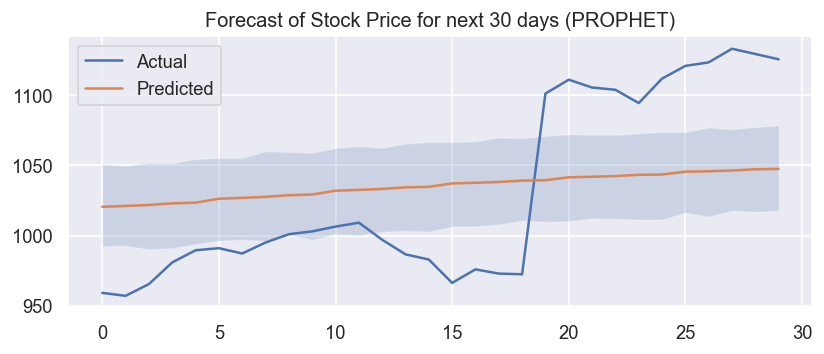

In [429]:
"""
plt.clf()
amazon_cl_train = amazon_cl.drop(amazon_cl.index[-30:])
rmse_prophet = []
mape_prophet = []
date_list = amazon_cl['ds'].tail(30).tolist()
# define the period for which we want a prediction
prophet_pred = []
for i in range(0, 30):
    model_hold_out = Prophet()
    model_hold_out.fit(amazon_cl_train)
    future_hold_out = list()
    date = date_list[i]
    future_hold_out.append([date])
    future_hold_out = pd.DataFrame(future_hold_out)
    future_hold_out.columns = ['ds']
    # use the model to make a forecast
    forecast_hold_out = model_hold_out.predict(future_hold_out)
    y_pred = forecast_hold_out['yhat'].values[0]
    print (y_pred)
    prophet_pred.append(y_pred)
    print (amazon_cl.iloc[amazon_cl_train.shape[0]])
    amazon_cl_train = amazon_cl_train.append(amazon_cl.iloc[amazon_cl_train.shape[0]])
    print (amazon_cl_train.shape[0])
"""
def prophet_model_eval(df):
    df_prophet = df.copy()
    df_prophet.reset_index(inplace=True)
    df_prophet = df_prophet.rename(columns = {'index':'ds','Close':'y'})
    prophet_train = df_prophet.drop(df_prophet.index[-30:])
    date_list = df_prophet['ds'].tail(30).tolist()
    model_hold_out = Prophet()
    model_hold_out.fit(prophet_train)
    future_hold_out = list()

# define the period for which we want a prediction
    for i in range(0, 30):
        date = date_list[i]
        future_hold_out.append([date])
    future_hold_out = pd.DataFrame(future_hold_out)
    future_hold_out.columns = ['ds']

# use the model to make a forecast
    forecast_hold_out = model_hold_out.predict(future_hold_out)
    print (forecast_hold_out)
    y_pred = forecast_hold_out['yhat'].values
    y_true = df_prophet['y'][-30:].values
    mse = mean_squared_error(y_true,y_pred)
    prophet_rmse = np.sqrt(mse)
    prophet_mape = np.mean(np.abs(y_true - y_pred)/np.abs(y_true))
    prophet_rmse_list = ((np.square(np.subtract(y_true,y_pred))))
    prophet_mape_list = (np.abs(y_true - y_pred)/np.abs(y_true))

# plot expected vs actual
    plt.plot(forecast_hold_out.index, y_true, label='Actual')
    plt.plot(forecast_hold_out.index, y_pred, label='Predicted')
    plt.fill_between(forecast_hold_out.index, forecast_hold_out['yhat_lower'].values, forecast_hold_out['yhat_upper'].values, alpha = 0.2 )
    plt.title('Forecast of Stock Price for next 30 days (PROPHET)')
    plt.legend()
    plt.show()
    
    return (prophet_mape_list, prophet_rmse, prophet_mape)

prophet_model = prophet_model_eval(amazon_cl)

## MAPE plot <a class="anchor" id="MAPE"></a>

Text(0.5, 1.0, 'MAPE Density Plot')

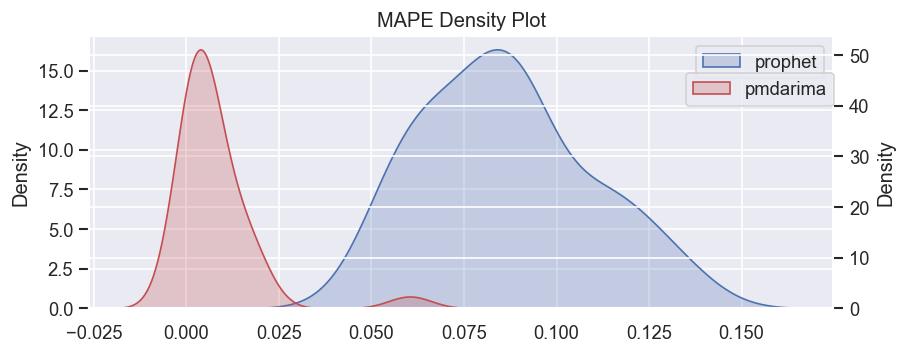

In [459]:
fig, ax = plt.subplots()
sns.kdeplot(prophet_model[0], fill = True, ax = ax, label = 'prophet')
plt.legend()
ax2 = ax.twinx()
sns.kdeplot(pmdarima_model[0], fill = True, ax = ax2,color='r',label = 'pmdarima')
plt.legend( bbox_to_anchor = (1.05,1), borderaxespad=2)
plt.title('MAPE Density Plot')

## Summary of MAPE and RMSE across all the Consumer Companies <a class="anchor" id="sum"></a>

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4811.019, Time=0.70 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4812.026, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4813.896, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4813.891, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4811.010, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.234 seconds


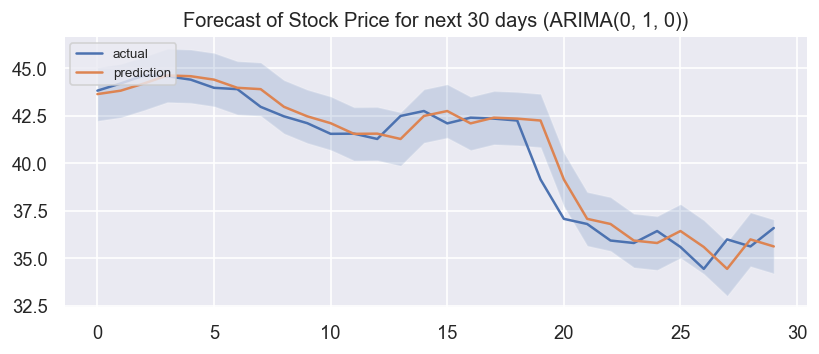

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -35.5347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6294.27   0.000249684       139.608      0.1907     0.01907      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        6307.5   0.000597694       445.337     0.04048      0.5583      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     229       6310.31   0.000248123       172.328   2.215e-06       0.001      314  LS failed, Hessian reset 
     299       6313.49    0.00166306       336.162           1           1      405   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     327       6313.78   0.000348227       179.214    4.09e-06       0.001      477  LS failed, Hessian reset 
     378       6314.69   0.000474691       247.157   5.668e-06       0.001      575  LS failed, Hessian rese

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  32.066862   27.636394   36.080927    32.066862    32.066862   
1  2017-10-03  32.071429   27.199248   36.203473    32.071429    32.071429   
2  2017-10-04  32.075996   27.554188   36.190957    32.075996    32.075996   
3  2017-10-05  32.080563   27.616783   35.914712    32.080563    32.080563   
4  2017-10-06  32.085130   27.377768   36.279635    32.085130    32.085130   
5  2017-10-09  32.098832   27.257452   35.927611    32.098832    32.098832   
6  2017-10-10  32.103399   27.190888   35.655848    32.103399    32.103399   
7  2017-10-11  32.107966   27.229838   35.341692    32.107966    32.107966   
8  2017-10-12  32.112533   27.325378   35.772622    32.112533    32.112533   
9  2017-10-13  32.117100   27.196738   35.716833    32.117100    32.117100   
10 2017-10-16  32.130801   26.894375   35.393929    32.130801    32.130801   
11 2017-10-17  32.135369   26.700074   35.484209    32.135369   

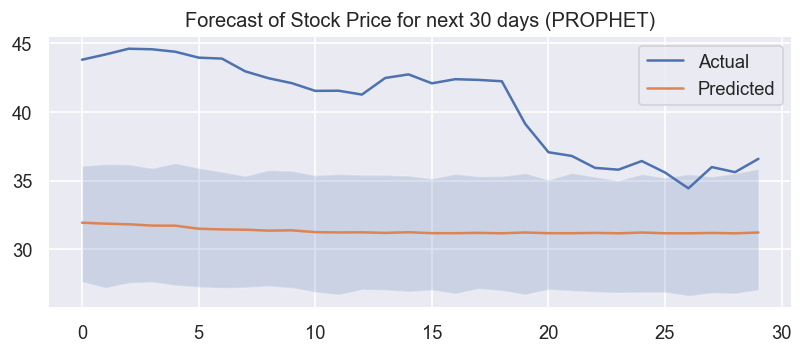

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8608.272, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8604.313, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8606.272, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8606.271, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8602.811, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.569 seconds


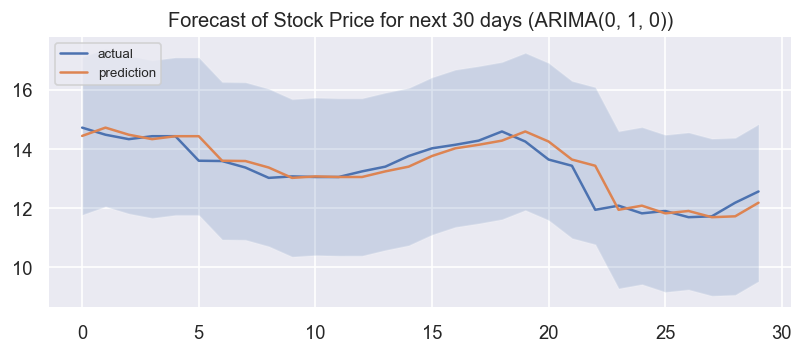

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -42.5897
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5261.97     0.0830623        418.77           1           1      108   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5461.99     0.0580832       1585.05     0.09602           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5622.02     0.0263736       468.951      0.9952      0.9952      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5683.15     0.0305732        386.28       2.075      0.2075      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5723.91    0.00469089       435.322           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  11.922694    3.550436   15.232458    11.922694    11.922694   
1  2017-10-03  11.908728    4.348179   14.883703    11.908728    11.908728   
2  2017-10-04  11.894763    4.518729   15.851930    11.894763    11.894763   
3  2017-10-05  11.880797    4.387836   15.046763    11.880797    11.880797   
4  2017-10-06  11.866831    3.696937   15.293578    11.866831    11.866831   
5  2017-10-09  11.824934    4.239455   15.332908    11.824934    11.824934   
6  2017-10-10  11.810968    3.728904   15.482900    11.810968    11.810968   
7  2017-10-11  11.797002    4.248115   15.121413    11.797002    11.797002   
8  2017-10-12  11.783036    3.756087   15.479897    11.783036    11.783036   
9  2017-10-13  11.769071    3.972077   15.125085    11.769071    11.769071   
10 2017-10-16  11.727173    4.059507   15.182855    11.727173    11.727173   
11 2017-10-17  11.713207    4.049089   15.536207    11.713207   

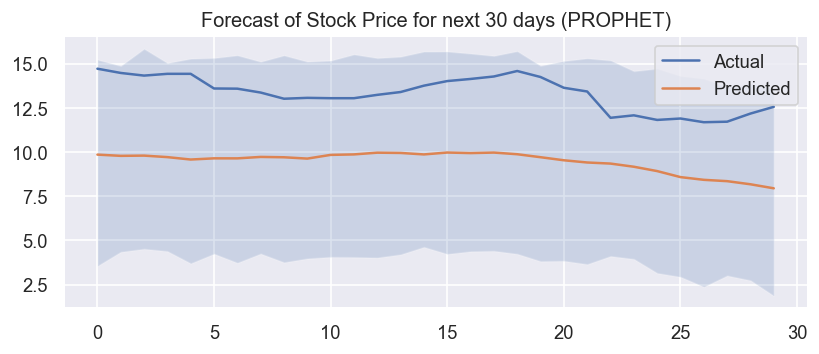

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=11648.937, Time=0.55 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=11646.217, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=11648.214, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=11648.213, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=11644.575, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.916 seconds


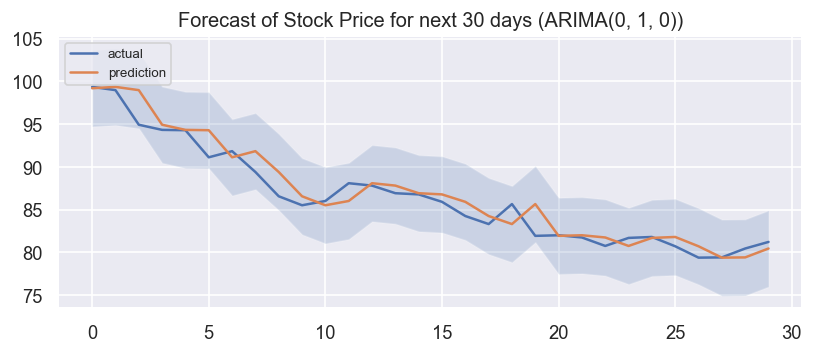

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -49.5422
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7273.98     0.0255973       952.875       4.452      0.4452      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7402.14    0.00673956       323.792           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7438.03    0.00487324       324.436      0.1758           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7469.45     0.0167236       468.092      0.6778      0.6778      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        7492.8     0.0171366       468.037           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  130.949520  115.407719  138.157970   130.949520   130.949520   
1  2017-10-03  130.902214  115.136056  138.239269   130.902214   130.902214   
2  2017-10-04  130.854907  115.112562  138.439467   130.854907   130.854907   
3  2017-10-05  130.807600  115.052608  138.901546   130.807600   130.807600   
4  2017-10-06  130.760293  114.876514  139.024175   130.760293   130.760293   
5  2017-10-09  130.618372  115.781554  138.123602   130.618372   130.618372   
6  2017-10-10  130.571065  115.908574  138.542611   130.571065   130.571065   
7  2017-10-11  130.523758  116.142299  139.139507   130.523758   130.523758   
8  2017-10-12  130.476451  116.145296  139.666714   130.476451   130.476451   
9  2017-10-13  130.429145  116.747111  140.239371   130.429145   130.429145   
10 2017-10-16  130.287224  117.339675  140.671651   130.287224   130.287224   
11 2017-10-17  130.239917  117.386999  139.589985   

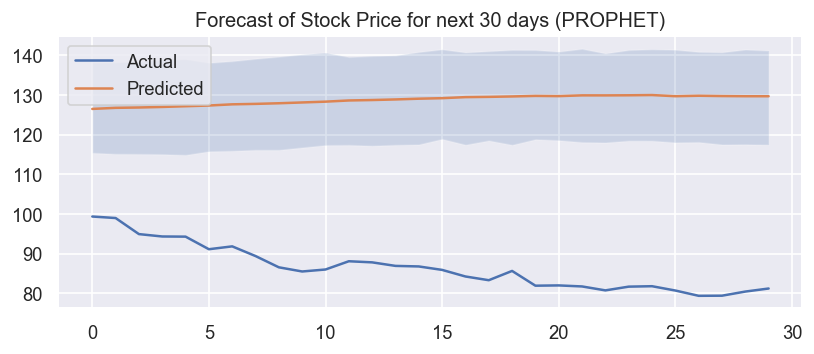

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5020.607, Time=0.53 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5022.099, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5020.149, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5020.362, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5020.746, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5019.848, Time=0.16 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=5021.848, Time=0.26 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5021.848, Time=0.26 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=5023.847, Time=0.32 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=5018.506, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=5018.844, Time=0.06 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=5020.506, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=5020.506, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=5019.291, Time=0.19 sec
 ARIMA(3,1,1)(0,0,0)[0]          

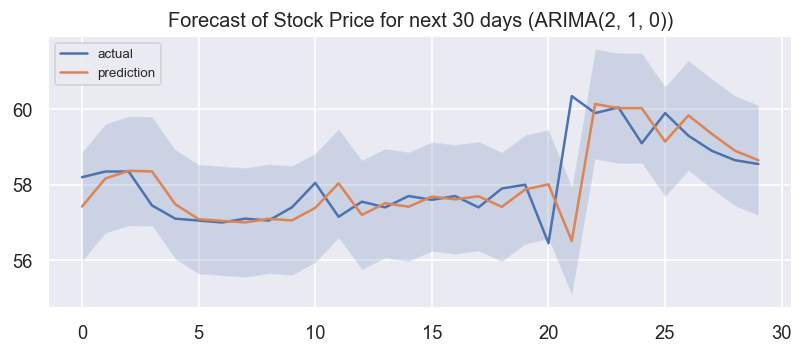

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -158.625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6831.33      0.210384       2586.12           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7166.56     0.0429492        2657.8      0.2417           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7349.02     0.0775996       3046.87           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7387.52    0.00449042       605.691           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7412.91     0.0186787       526.774      0.2151       0.606      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  50.522863   47.081160   52.533846    50.522863    50.522863   
1  2017-10-03  50.544144   47.091751   52.649463    50.544144    50.544144   
2  2017-10-04  50.565425   47.066802   52.617125    50.565425    50.565425   
3  2017-10-05  50.586707   46.794492   52.816423    50.586707    50.586707   
4  2017-10-06  50.607988   46.720185   52.565667    50.607988    50.607988   
5  2017-10-09  50.671833   46.736567   52.329891    50.671833    50.671833   
6  2017-10-10  50.693114   46.962998   52.352278    50.693114    50.693114   
7  2017-10-11  50.714395   46.734740   52.304632    50.714395    50.714395   
8  2017-10-12  50.735677   46.768912   52.275997    50.735677    50.735677   
9  2017-10-13  50.756958   46.691393   52.359830    50.756958    50.756958   
10 2017-10-16  50.820803   46.734322   52.112376    50.820803    50.820803   
11 2017-10-17  50.842084   46.751669   52.641574    50.842084   

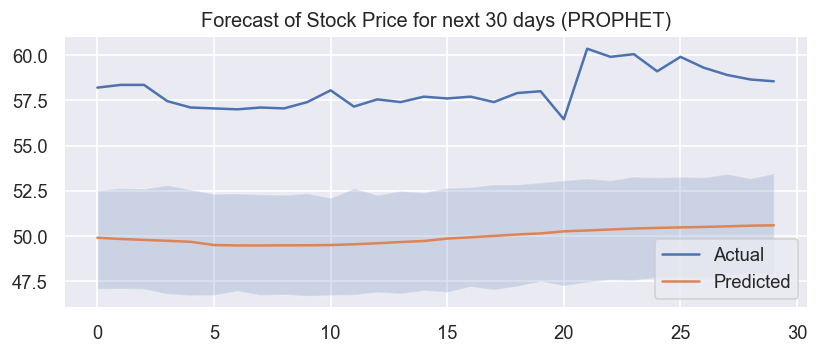

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=19225.688, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=19222.372, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=19223.808, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=19223.794, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=19227.606, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.797 seconds


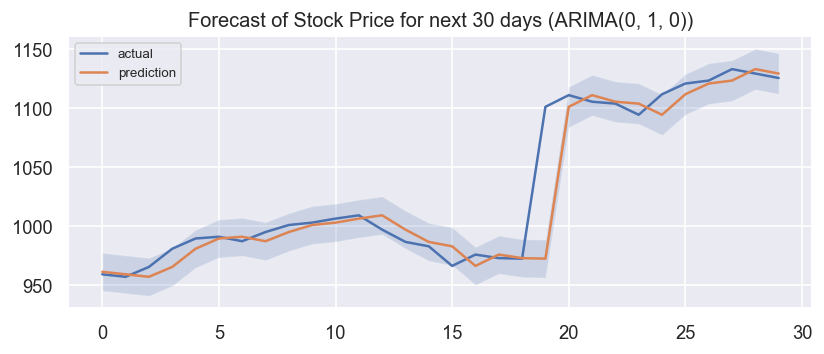

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -86.8346
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9031.12      0.261814       9762.89           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9248.65     0.0478723       3335.78           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9399.91    0.00545629       1709.65           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9419.78    0.00027755       278.375           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        9444.5     0.0242538       2089.25           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds        trend   yhat_lower   yhat_upper  trend_lower  \
0  2017-10-02  1014.739275   989.448793  1052.290664  1014.739275   
1  2017-10-03  1015.401637   991.598236  1051.582495  1015.401637   
2  2017-10-04  1016.063999   991.879740  1051.017127  1016.063999   
3  2017-10-05  1016.726361   991.987618  1053.993686  1016.726361   
4  2017-10-06  1017.388723   993.862177  1054.883938  1017.388723   
5  2017-10-09  1019.375809   994.992907  1054.840728  1019.375809   
6  2017-10-10  1020.038171   996.057732  1054.968375  1020.038171   
7  2017-10-11  1020.700533   997.376401  1058.161499  1020.700533   
8  2017-10-12  1021.362895   998.202987  1057.894555  1021.362895   
9  2017-10-13  1022.025257  1001.395096  1058.418055  1022.025257   
10 2017-10-16  1024.012343  1000.033197  1062.162715  1024.012343   
11 2017-10-17  1024.674705  1001.293771  1060.352664  1024.674705   
12 2017-10-18  1025.337067  1003.090794  1063.736442  1025.337067   
13 2017-10-19  1025.999429  1002.8

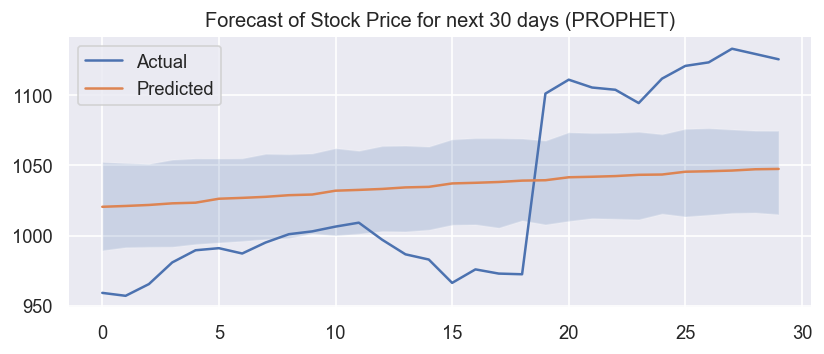

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3616.537, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3614.478, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3615.394, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3615.382, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3612.480, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.971 seconds


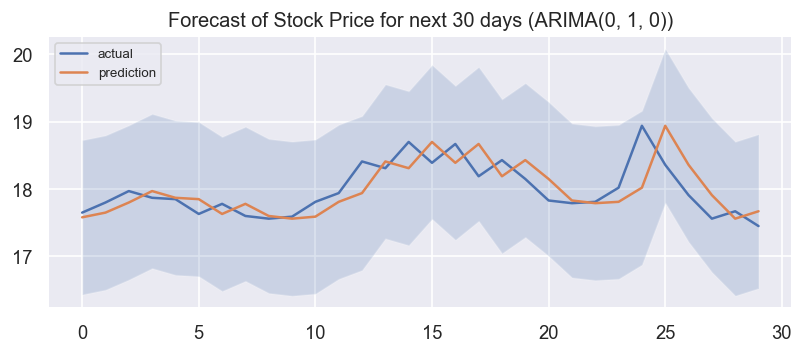

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -85.2717
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5138.86     0.0206458       572.032           1           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5498.81     0.0187498       1179.75      0.1653           1      217   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5578.73    0.00506941       163.314      0.8312      0.8312      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5648.57    0.00597397       542.802      0.1316      0.7581      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5659.89     0.0036933       90.5137      0.9875      0.9875      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  15.700202   11.740621   17.102198    15.700202    15.700202   
1  2017-10-03  15.693531   11.689791   17.164098    15.693531    15.693531   
2  2017-10-04  15.686860   11.773811   17.141155    15.686860    15.686860   
3  2017-10-05  15.680189   11.697490   16.850702    15.680189    15.680189   
4  2017-10-06  15.673518   11.742522   17.192488    15.673518    15.673518   
5  2017-10-09  15.653505   11.522717   16.910804    15.653505    15.653505   
6  2017-10-10  15.646834   11.550171   16.989820    15.646834    15.646834   
7  2017-10-11  15.640163   11.535909   17.245791    15.640163    15.640163   
8  2017-10-12  15.633492   11.126167   17.111257    15.633492    15.633492   
9  2017-10-13  15.626821   11.506782   16.917956    15.626821    15.626821   
10 2017-10-16  15.606808   11.455069   16.911932    15.606808    15.606808   
11 2017-10-17  15.600137   11.678228   17.027021    15.600137   

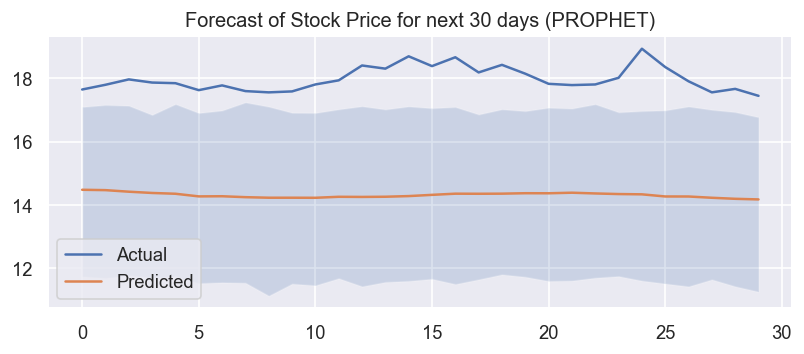

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8525.555, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8525.082, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8523.588, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8523.567, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8524.748, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=8525.553, Time=0.26 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=8527.552, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=8523.353, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=8525.346, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=8525.345, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=8523.369, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=8527.344, Time=0.14 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 1.576 seconds


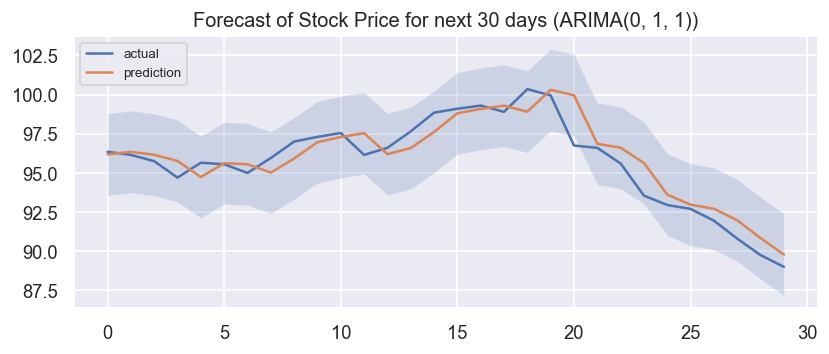

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -125.927
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7573.69      0.173438       3924.39           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7822.58    0.00629151       817.826           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7940.67     0.0153858       1490.19      0.3893           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7973.88     0.0136876       928.107           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7993.38   0.000979311       216.724           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  93.071644   89.495506   98.303036    93.071644    93.071644   
1  2017-10-03  93.113371   89.064366   98.095159    93.113371    93.113371   
2  2017-10-04  93.155099   89.082171   98.488220    93.155099    93.155099   
3  2017-10-05  93.196826   89.243006   98.487440    93.196826    93.196826   
4  2017-10-06  93.238553   89.688029   98.333069    93.238553    93.238553   
5  2017-10-09  93.363735   89.689259   98.550549    93.363735    93.363735   
6  2017-10-10  93.405462   89.762728   98.406890    93.405462    93.405462   
7  2017-10-11  93.447189   89.566067   98.470743    93.447189    93.447189   
8  2017-10-12  93.488917   89.806110   98.493719    93.488917    93.488917   
9  2017-10-13  93.530644   89.537684   98.883810    93.530644    93.530644   
10 2017-10-16  93.655826   89.806438   98.839009    93.655826    93.655826   
11 2017-10-17  93.697553   89.506974   98.918238    93.697553   

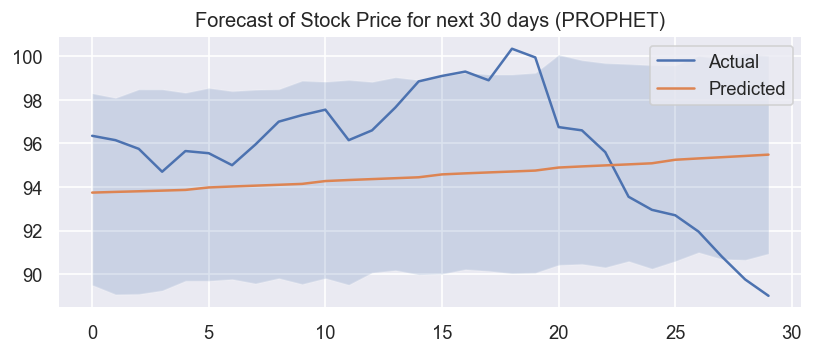

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9591.577, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9587.597, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9589.253, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9589.255, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9587.153, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.615 seconds


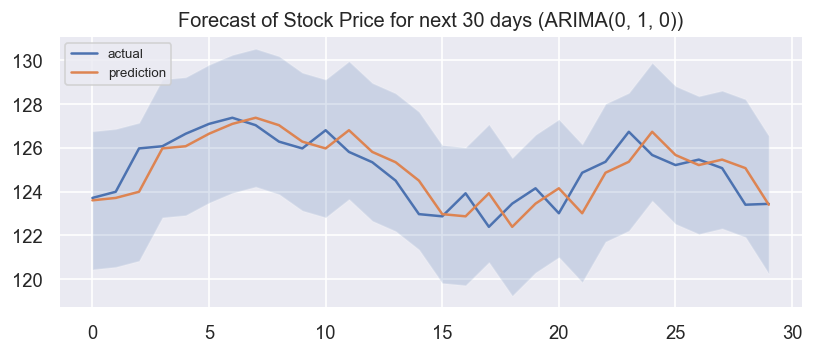

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -46.5675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        7321.9      0.222898       11244.4      0.2292           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7557.05    0.00677282       469.567           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7660.44     0.0218193       3152.53           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7701.16    0.00636511       326.632         0.9         0.9      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     456        7718.4   0.000112716       341.592   2.096e-07       0.001      550  LS failed, Hessian reset 
     499        7721.8     0.0114513    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  105.934714   99.133368  110.901342   105.934714   105.934714   
1  2017-10-03  105.931933   98.295234  110.636260   105.931933   105.931933   
2  2017-10-04  105.929151   98.883606  110.667840   105.929151   105.929151   
3  2017-10-05  105.926370   99.126738  110.647609   105.926370   105.926370   
4  2017-10-06  105.923589   97.815147  110.384394   105.923589   105.923589   
5  2017-10-09  105.915244   98.018359  110.306511   105.915244   105.915244   
6  2017-10-10  105.912463   97.485562  110.447700   105.912463   105.912463   
7  2017-10-11  105.909681   98.019075  110.193379   105.909681   105.909681   
8  2017-10-12  105.906900   98.254584  110.410916   105.906900   105.906900   
9  2017-10-13  105.904118   97.484133  110.163928   105.904118   105.904118   
10 2017-10-16  105.895774   97.582445  110.239410   105.895774   105.895774   
11 2017-10-17  105.892992   97.534269  110.407360   

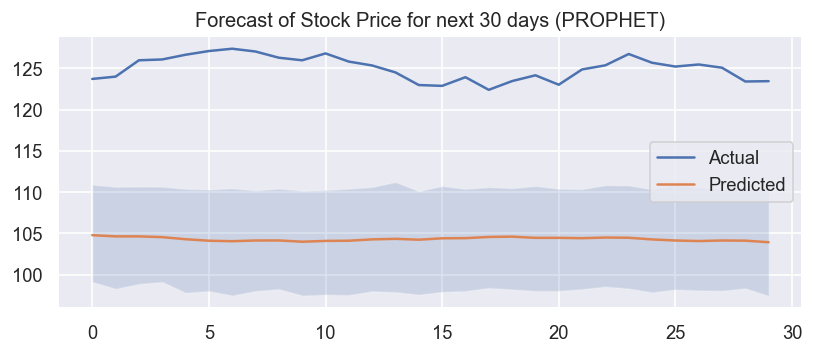

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6059.404, Time=0.65 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6056.381, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6058.210, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6058.204, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6054.865, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.135 seconds


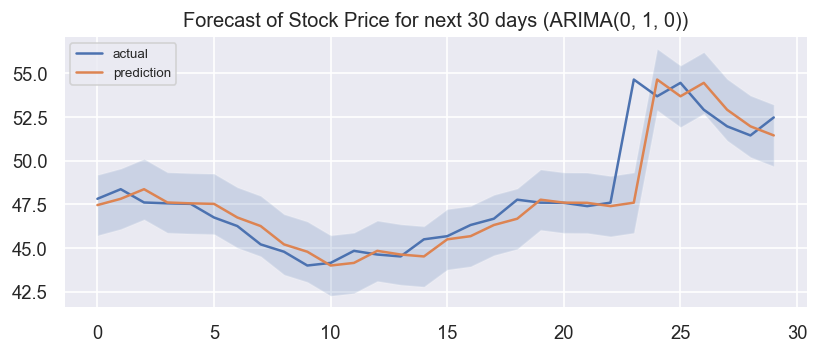

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -39.5111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7575.75     0.0262984       1972.15           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7730.18     0.0994784       936.857           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7791.37     0.0162183       912.504           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7825.11    0.00497812        163.05           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7836.51     0.0018373       291.724      0.8251      0.8251      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  38.813184   35.704559   42.321742    38.813184    38.813184   
1  2017-10-03  38.786395   35.412043   42.012920    38.786395    38.786395   
2  2017-10-04  38.759606   35.428450   41.928028    38.759606    38.759606   
3  2017-10-05  38.732818   35.619057   42.046318    38.732818    38.732818   
4  2017-10-06  38.706029   35.326460   42.060849    38.706029    38.706029   
5  2017-10-09  38.625662   35.349339   41.723528    38.625662    38.625662   
6  2017-10-10  38.598873   35.344221   41.831268    38.598873    38.598873   
7  2017-10-11  38.572084   35.295850   41.985365    38.572084    38.572084   
8  2017-10-12  38.545296   35.219611   41.934255    38.545296    38.545296   
9  2017-10-13  38.518507   35.334156   42.056812    38.518507    38.518507   
10 2017-10-16  38.438140   35.113242   41.806147    38.438140    38.438140   
11 2017-10-17  38.411351   35.180666   41.821703    38.411351   

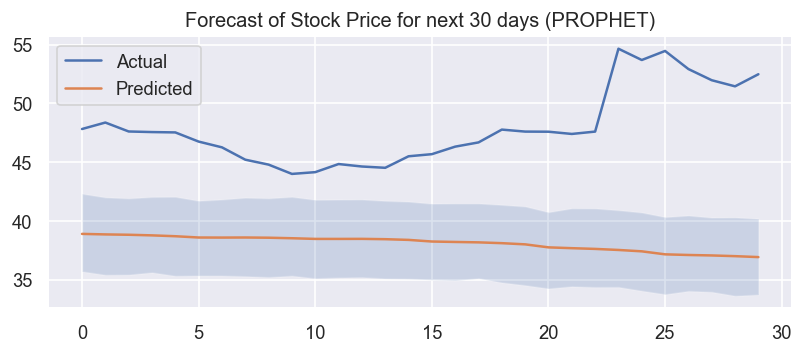

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=18400.822, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=18407.777, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=18403.463, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=18403.245, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=18408.659, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=18402.814, Time=0.70 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=18407.243, Time=0.44 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=18404.313, Time=0.42 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=18404.797, Time=0.17 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=18402.504, Time=0.91 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=18402.550, Time=0.14 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 3.563 seconds


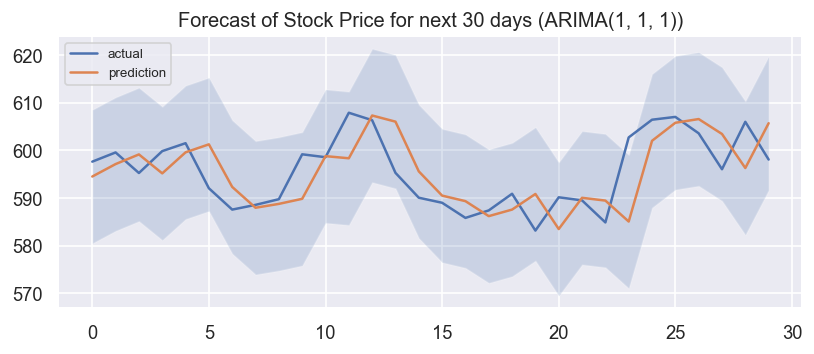

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -27.7945
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7267.34     0.0736673       2530.46      0.9985      0.9985      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7484.39    0.00556238       2401.41       0.609       0.609      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7592.5     0.0162014       1458.58           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7629.83     0.0125054       761.809      0.3241      0.3241      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7661.83    0.00167043       256.896           1           1      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  667.655746  620.017319  703.725161   667.655746   667.655746   
1  2017-10-03  667.551898  614.720456  702.543681   667.551898   667.551898   
2  2017-10-04  667.448050  616.927520  704.084725   667.448050   667.448050   
3  2017-10-05  667.344201  618.010732  703.657551   667.344201   667.344201   
4  2017-10-06  667.240353  618.289673  702.934734   667.240353   667.240353   
5  2017-10-09  666.928808  615.082384  703.987523   666.928808   666.928808   
6  2017-10-10  666.824960  619.945166  703.970857   666.824960   666.824960   
7  2017-10-11  666.721111  615.269559  704.399259   666.721111   666.721111   
8  2017-10-12  666.617263  615.619442  702.851097   666.617263   666.617263   
9  2017-10-13  666.513415  616.416959  701.943520   666.513415   666.513415   
10 2017-10-16  666.201870  617.368064  703.561732   666.201870   666.201870   
11 2017-10-17  666.098021  621.995645  709.506103   

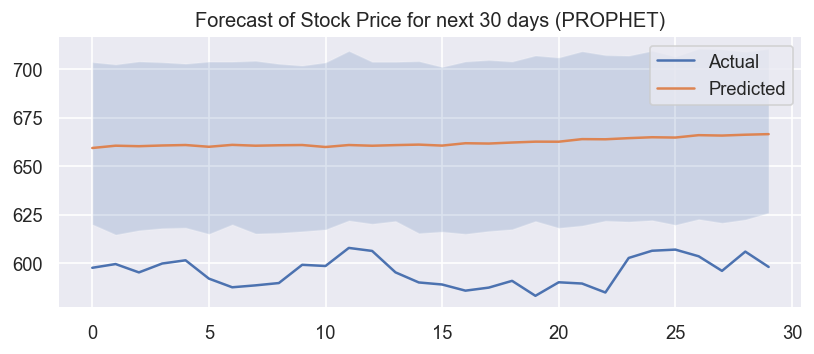

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1398.246, Time=1.09 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1413.540, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1405.895, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1405.369, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1415.169, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1397.506, Time=1.61 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1405.737, Time=0.21 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=1409.428, Time=0.37 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1400.061, Time=1.40 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1397.459, Time=1.74 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1405.561, Time=0.35 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=1401.541, Time=1.45 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1407.286, Time=0.38 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=1405.787, Time=2.50 sec
 ARIMA(1,1,2)(0,0,0)[0]          

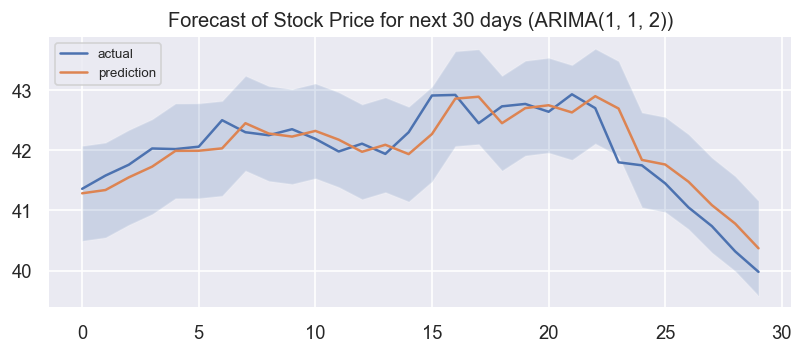

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -27.9158
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8904.13     0.0107567       1629.89           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9076.68    0.00441072       1280.23      0.3391      0.3391      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9131.38   0.000427598       461.478           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9172.66   0.000616455       535.045           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       9186.54   0.000746558       520.204           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  40.123918   38.431889   41.036136    40.123918    40.123918   
1  2017-10-03  40.131974   38.460177   41.091224    40.131974    40.131974   
2  2017-10-04  40.140029   38.464908   40.986806    40.140029    40.140029   
3  2017-10-05  40.148085   38.508170   41.072433    40.148085    40.148085   
4  2017-10-06  40.156141   38.598661   41.076287    40.156141    40.156141   
5  2017-10-09  40.180309   38.362618   41.063909    40.180309    40.180309   
6  2017-10-10  40.188365   38.489557   40.979813    40.188365    40.188365   
7  2017-10-11  40.196421   38.529304   41.030627    40.196421    40.196421   
8  2017-10-12  40.204477   38.505014   41.037989    40.204477    40.204477   
9  2017-10-13  40.212533   38.585973   41.059236    40.212533    40.212533   
10 2017-10-16  40.236700   38.542058   41.103883    40.236700    40.236700   
11 2017-10-17  40.244756   38.650850   41.242543    40.244756   

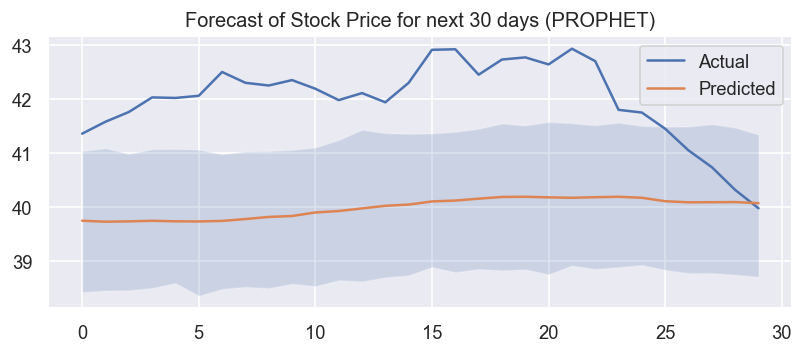

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7508.546, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7512.194, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7506.601, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7506.558, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7510.262, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=7508.548, Time=0.24 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7510.549, Time=0.32 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=7504.633, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=7506.622, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=7506.623, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=7504.676, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=7508.625, Time=0.17 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 1.712 seconds


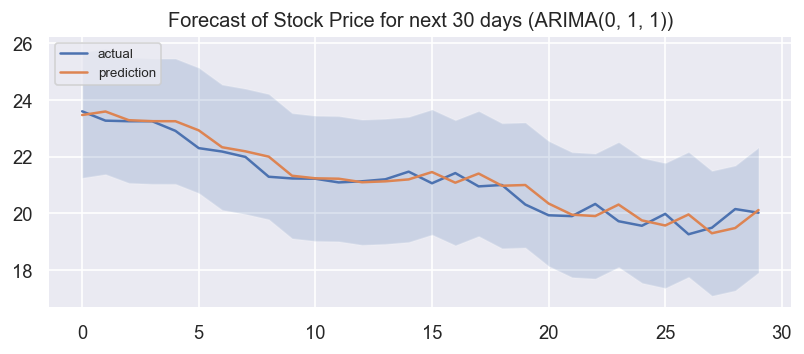

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -147.524
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6925.77    0.00382378        630.33           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7038.27    0.00168395       508.318       0.274       0.274      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7068.1    0.00679547       483.931           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7101.54     0.0138546        726.05           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7138.36    0.00841228       624.032           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  26.412097   22.617493   31.020471    26.412097    26.412097   
1  2017-10-03  26.367161   23.122172   30.618430    26.367161    26.367161   
2  2017-10-04  26.322225   22.505654   30.229043    26.322225    26.322225   
3  2017-10-05  26.277289   22.273809   30.276197    26.277289    26.277289   
4  2017-10-06  26.232353   22.139430   29.978711    26.232353    26.232353   
5  2017-10-09  26.097545   21.890513   30.081831    26.097545    26.097545   
6  2017-10-10  26.052609   21.742102   29.606422    26.052609    26.052609   
7  2017-10-11  26.007673   21.810677   29.409447    26.007673    26.007673   
8  2017-10-12  25.962737   21.419267   29.683817    25.962737    25.962737   
9  2017-10-13  25.917801   21.891487   29.383247    25.917801    25.917801   
10 2017-10-16  25.782993   21.482999   29.197456    25.782993    25.782993   
11 2017-10-17  25.738057   21.165036   29.263934    25.738057   

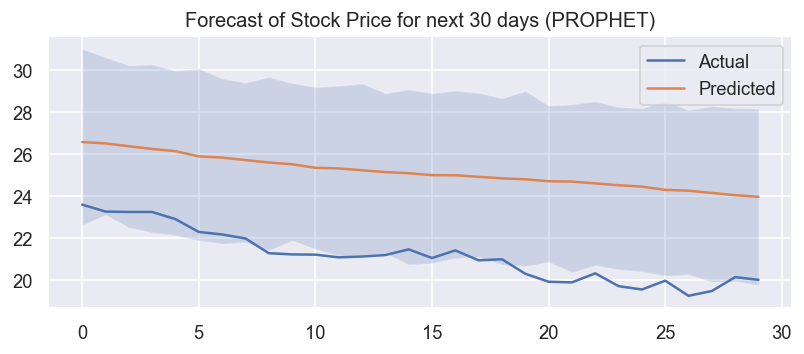

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6854.027, Time=0.58 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6850.743, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6852.396, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6852.365, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6848.987, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.090 seconds


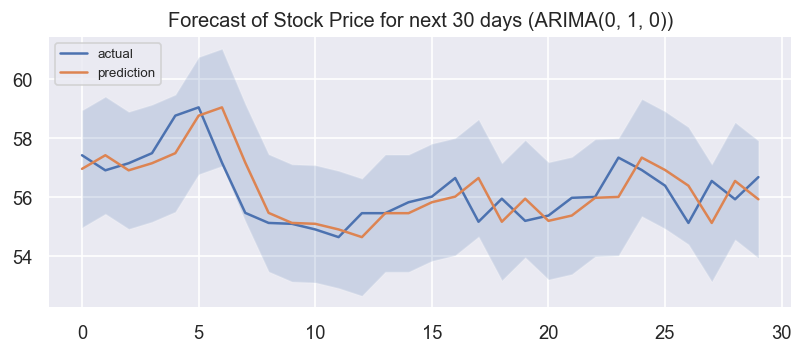

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2144.778, Time=0.58 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2146.032, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2144.218, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2144.309, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2144.305, Time=0.12 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2145.781, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2146.756, Time=0.92 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2142.512, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=2144.067, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2143.063, Time=0.39 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2142.603, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2145.043, Time=0.40 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.580 seconds


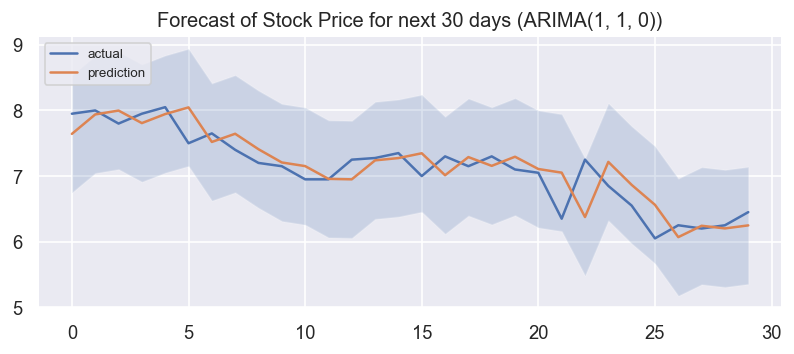

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -77.4615
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       4644.52     0.0112425       948.098      0.4495      0.4495      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       4932.08     0.0130231       1780.96      0.1727      0.1727      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5043.38     0.0297001       350.085      0.9317      0.9317      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5087.64     0.0129582       362.145           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        5112.5    0.00144883       418.289      0.7194     0.07194      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  13.331890   10.503928   14.483885    13.331890    13.331890   
1  2017-10-03  13.334242   10.646990   14.542297    13.334242    13.334242   
2  2017-10-04  13.336595   10.625835   14.608624    13.336595    13.336595   
3  2017-10-05  13.338947   10.354702   14.660741    13.338947    13.338947   
4  2017-10-06  13.341300   10.383582   14.461597    13.341300    13.341300   
5  2017-10-09  13.348357   10.587810   14.897668    13.348357    13.348357   
6  2017-10-10  13.350710   10.532249   14.767824    13.350710    13.350710   
7  2017-10-11  13.353062   10.645393   14.935481    13.353062    13.353062   
8  2017-10-12  13.355415   10.676421   14.958895    13.355415    13.355415   
9  2017-10-13  13.357767   10.507297   14.731399    13.357767    13.357767   
10 2017-10-16  13.364825   10.751074   14.839436    13.364825    13.364825   
11 2017-10-17  13.367177   10.684863   14.929667    13.367177   

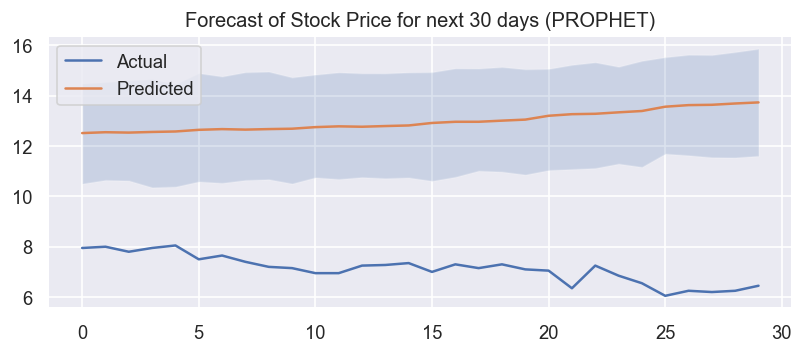

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=19982.708, Time=0.44 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=19990.442, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=19981.633, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=19982.019, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=19988.442, Time=0.04 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=19982.726, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=19983.709, Time=0.80 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=19979.633, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=19980.726, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=19980.708, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=19980.019, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=19981.709, Time=0.34 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.533 seconds


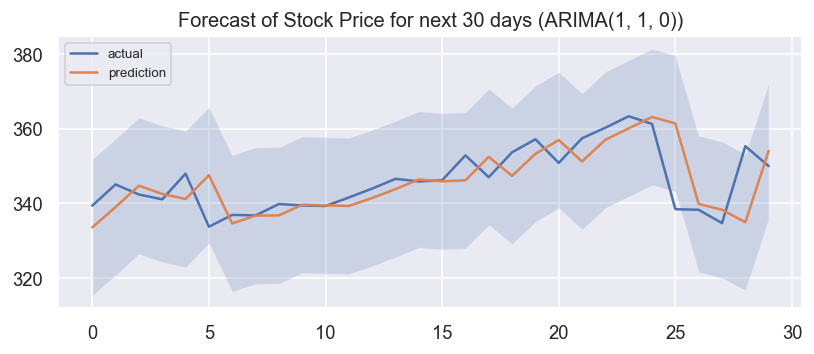

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -51.0865
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6001.49       0.10974       2422.83      0.9342      0.9342      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6216.88     0.0266247       733.449           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6265.97    0.00358127       199.082      0.3856           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6293.14    0.00685252       207.167           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     482       6303.07   0.000198393       171.796    4.21e-07       0.001      604  LS failed, Hessian reset 
     497       6304.86   8.24904e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  401.676977  352.407919  435.286707   401.676977   401.676977   
1  2017-10-03  401.695070  355.009192  434.059072   401.695070   401.695070   
2  2017-10-04  401.713163  355.068140  434.013859   401.713163   401.713163   
3  2017-10-05  401.731256  355.297443  434.252805   401.731256   401.731256   
4  2017-10-06  401.749349  356.601679  434.138934   401.749349   401.749349   
5  2017-10-09  401.803629  354.691430  436.195894   401.803629   401.803629   
6  2017-10-10  401.821722  354.994014  433.588323   401.821722   401.821722   
7  2017-10-11  401.839815  356.289935  436.181675   401.839815   401.839815   
8  2017-10-12  401.857908  356.797488  433.992583   401.857908   401.857908   
9  2017-10-13  401.876001  354.340584  436.402692   401.876001   401.876001   
10 2017-10-16  401.930281  356.916027  434.846574   401.930281   401.930281   
11 2017-10-17  401.948374  357.548901  435.852487   

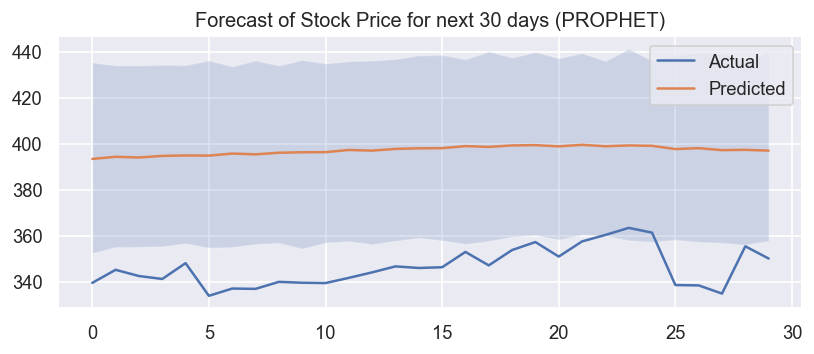

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4929.932, Time=0.72 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4934.325, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4932.236, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4931.905, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4932.446, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4931.527, Time=0.33 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4931.515, Time=0.74 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4929.873, Time=0.27 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=4931.413, Time=0.34 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=4933.154, Time=1.90 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=4928.017, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4930.037, Time=0.08 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=4929.663, Time=0.32 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=4929.560, Time=0.18 sec
 ARIMA(1,1,1)(0,0,0)[0]          

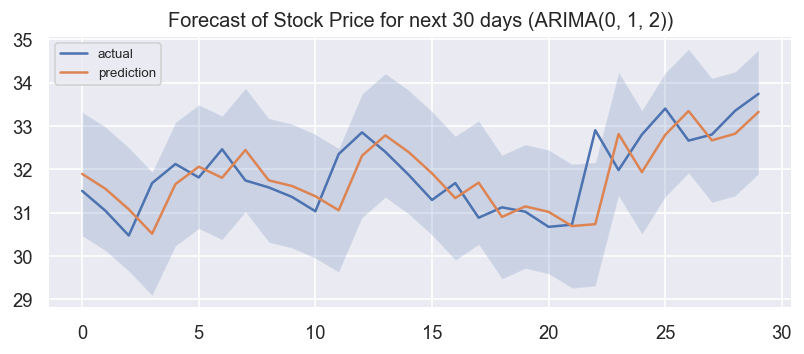

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -62.1343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7249.27     0.0642784       3519.95           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7378.65     0.0183635       539.371           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7442.74    0.00332247        235.89      0.2101      0.2101      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     388       7452.35   0.000101396       205.214   4.425e-07       0.001      486  LS failed, Hessian reset 
     399       7452.76    0.00261692       144.911           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     449       7458.36   0.000215742    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  38.074474   34.614102   41.219241    38.074474    38.074474   
1  2017-10-03  38.057870   34.509957   40.967631    38.057870    38.057870   
2  2017-10-04  38.041266   34.695763   41.178014    38.041266    38.041266   
3  2017-10-05  38.024661   34.182806   41.152291    38.024661    38.024661   
4  2017-10-06  38.008057   34.358981   41.031454    38.008057    38.008057   
5  2017-10-09  37.958244   34.274198   40.737584    37.958244    37.958244   
6  2017-10-10  37.941640   33.993286   40.657421    37.941640    37.941640   
7  2017-10-11  37.925035   33.770466   40.594468    37.925035    37.925035   
8  2017-10-12  37.908431   33.923463   40.458495    37.908431    37.908431   
9  2017-10-13  37.891826   33.850149   40.503525    37.891826    37.891826   
10 2017-10-16  37.842013   33.675136   40.272944    37.842013    37.842013   
11 2017-10-17  37.825409   33.465686   40.045096    37.825409   

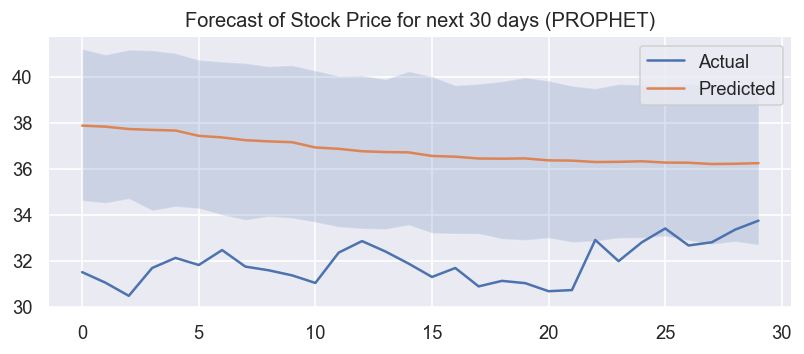

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6032.955, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6030.039, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6031.351, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6031.329, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6028.260, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.209 seconds


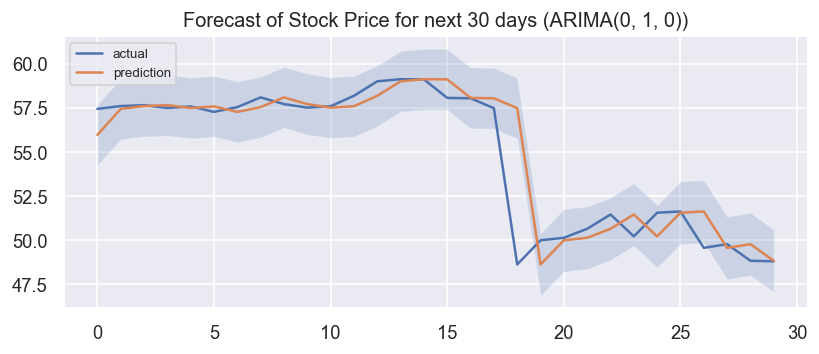

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -175.968
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6945.32    0.00436785       1954.51      0.2587      0.2587      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7130.23     0.0840064       1647.23           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7195.58    0.00693814       544.019           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     306       7198.38   0.000198829        271.87   1.411e-06       0.001      393  LS failed, Hessian reset 
     399       7210.15   0.000124003       69.3556      0.4616      0.4616      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7218.39    0.00340178    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  55.942250   50.364270   58.141696    55.942250    55.942250   
1  2017-10-03  55.951866   50.308956   58.311998    55.951866    55.951866   
2  2017-10-04  55.961482   50.361192   57.883373    55.961482    55.961482   
3  2017-10-05  55.971098   50.267378   58.155903    55.971098    55.971098   
4  2017-10-06  55.980714   50.235336   57.906233    55.980714    55.980714   
5  2017-10-09  56.009563   50.494734   58.164477    56.009563    56.009563   
6  2017-10-10  56.019179   50.604580   58.060060    56.019179    56.019179   
7  2017-10-11  56.028795   49.996351   58.589948    56.028795    56.028795   
8  2017-10-12  56.038411   50.443816   58.303301    56.038411    56.038411   
9  2017-10-13  56.048027   50.266274   58.263138    56.048027    56.048027   
10 2017-10-16  56.076875   50.383700   58.044907    56.076875    56.076875   
11 2017-10-17  56.086491   50.373346   58.090924    56.086491   

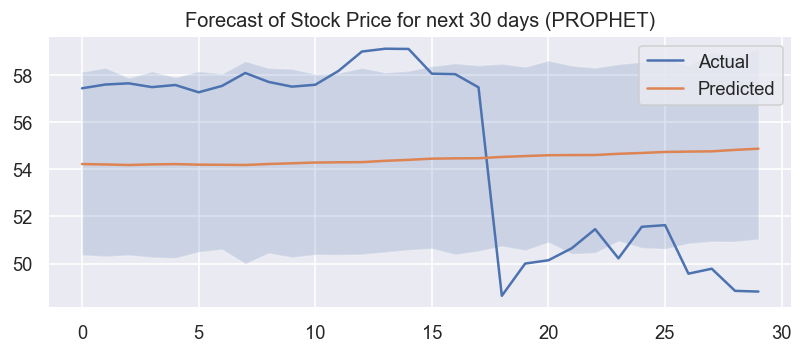

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3333.490, Time=0.60 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3332.462, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3332.208, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3332.083, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3331.242, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.188 seconds


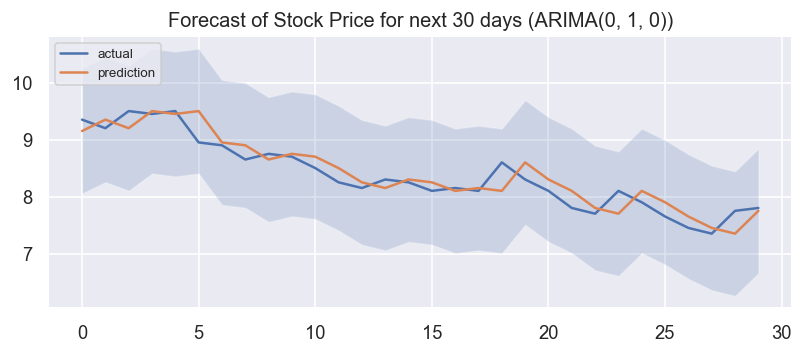

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -177.421
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6241.5       0.01981       1437.28      0.8686      0.8686      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6573.47    0.00895531       783.985           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6643.81     0.0877602       1282.67      0.9765      0.9765      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6682.44    0.00480379        169.38           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6689.89    0.00642884       187.235           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  8.767662    5.662986   10.034110     8.767662     8.767662   
1  2017-10-03  8.757392    6.023428    9.964864     8.757392     8.757392   
2  2017-10-04  8.747123    5.861320    9.925483     8.747123     8.747123   
3  2017-10-05  8.736854    5.621315   10.016428     8.736854     8.736854   
4  2017-10-06  8.726584    5.789291    9.941299     8.726584     8.726584   
5  2017-10-09  8.695776    5.721463    9.994051     8.695776     8.695776   
6  2017-10-10  8.685506    5.767253    9.883285     8.685506     8.685506   
7  2017-10-11  8.675237    5.932829   10.127832     8.675237     8.675237   
8  2017-10-12  8.664968    5.861232   10.117279     8.664968     8.664968   
9  2017-10-13  8.654698    5.970140   10.224793     8.654698     8.654698   
10 2017-10-16  8.623890    5.985566   10.094228     8.623890     8.623890   
11 2017-10-17  8.613620    6.022465   10.215524     8.613620     8.613620   

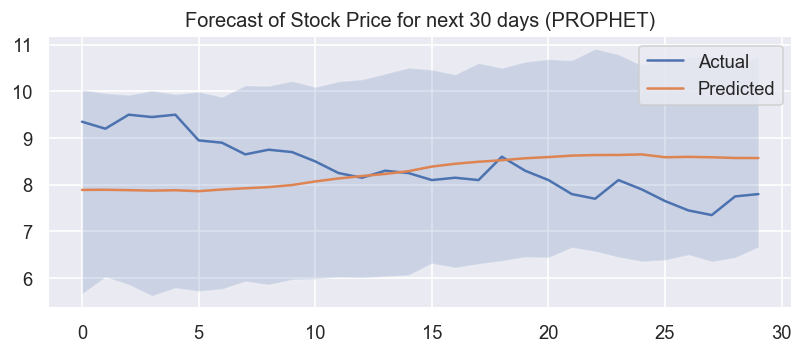

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6824.399, Time=0.60 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6821.373, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6823.369, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6823.368, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6821.551, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.138 seconds


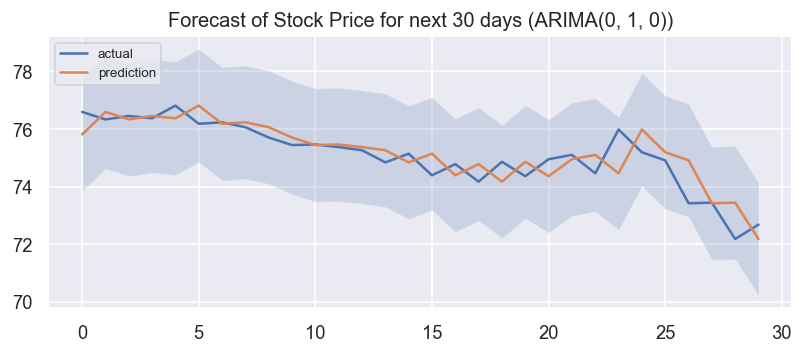

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -40.7431
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6607.82     0.0108638       615.887           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6655.92   0.000488491       120.502           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     273       6674.68   0.000405261       218.839   2.948e-06       0.001      362  LS failed, Hessian reset 
     299       6677.99     0.0118873       494.647           1           1      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6689.45     0.0125849       229.413           1           1      522   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6701.74     0.0215464    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  60.029266   52.867914   63.834295    60.029266    60.029266   
1  2017-10-03  60.030027   52.227705   63.812118    60.030027    60.030027   
2  2017-10-04  60.030788   52.761345   63.410680    60.030788    60.030788   
3  2017-10-05  60.031549   52.542497   63.015561    60.031549    60.031549   
4  2017-10-06  60.032310   52.520590   63.938786    60.032310    60.032310   
5  2017-10-09  60.034594   52.411554   63.014790    60.034594    60.034594   
6  2017-10-10  60.035355   52.205253   63.129576    60.035355    60.035355   
7  2017-10-11  60.036116   52.717325   63.471309    60.036116    60.036116   
8  2017-10-12  60.036877   52.229188   62.776073    60.036877    60.036877   
9  2017-10-13  60.037638   52.245936   63.060500    60.037638    60.037638   
10 2017-10-16  60.039922   52.511345   63.545371    60.039922    60.039922   
11 2017-10-17  60.040683   53.075196   63.235251    60.040683   

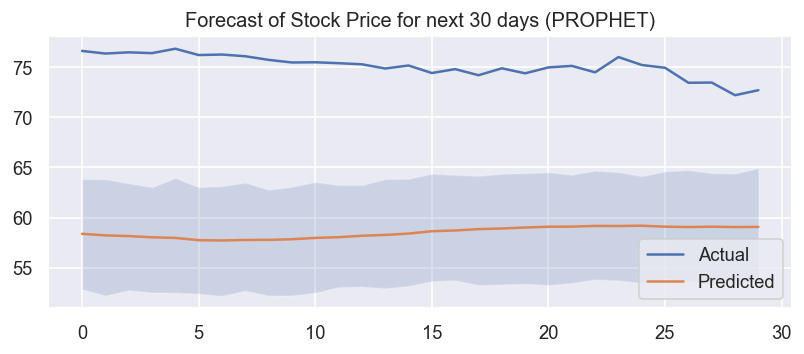

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5958.330, Time=0.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5961.672, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5963.076, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5962.994, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5959.961, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5956.244, Time=0.69 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5954.318, Time=0.19 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=5956.284, Time=0.24 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=5958.282, Time=0.33 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=5952.653, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=5961.373, Time=0.05 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=5954.621, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=5954.584, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=5956.727, Time=0.30 sec
 ARIMA(3,1,1)(0,0,0)[0]          

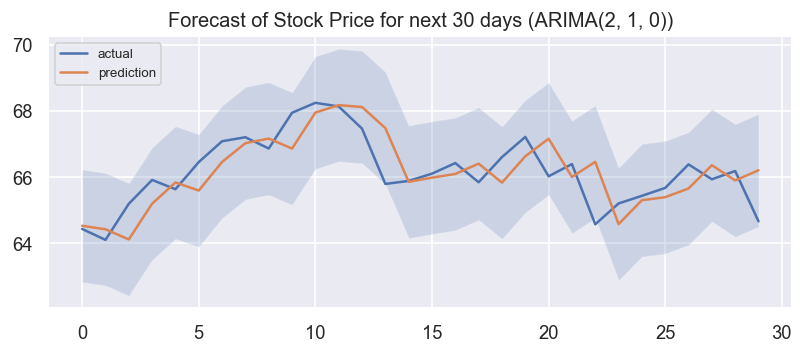

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -129.717
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7264.97      0.241292       3345.88           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7364.15     0.0818884       750.159           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7410.58    0.00329951       217.052           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7435.78   0.000675191       207.736      0.8082      0.8082      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7452.38    0.00355234       125.004           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  61.875634   57.215116   64.900801    61.875634    61.875634   
1  2017-10-03  61.897337   57.089729   64.886728    61.897337    61.897337   
2  2017-10-04  61.919040   57.066450   64.932178    61.919040    61.919040   
3  2017-10-05  61.940743   57.134389   64.971990    61.940743    61.940743   
4  2017-10-06  61.962446   57.180070   64.882383    61.962446    61.962446   
5  2017-10-09  62.027555   57.015046   64.950770    62.027555    62.027555   
6  2017-10-10  62.049258   57.260443   64.926851    62.049258    62.049258   
7  2017-10-11  62.070961   57.065288   64.444961    62.070961    62.070961   
8  2017-10-12  62.092664   57.180119   64.691445    62.092664    62.092664   
9  2017-10-13  62.114367   57.171071   64.796797    62.114367    62.114367   
10 2017-10-16  62.179476   57.150636   64.857323    62.179476    62.179476   
11 2017-10-17  62.201179   57.110128   65.252957    62.201179   

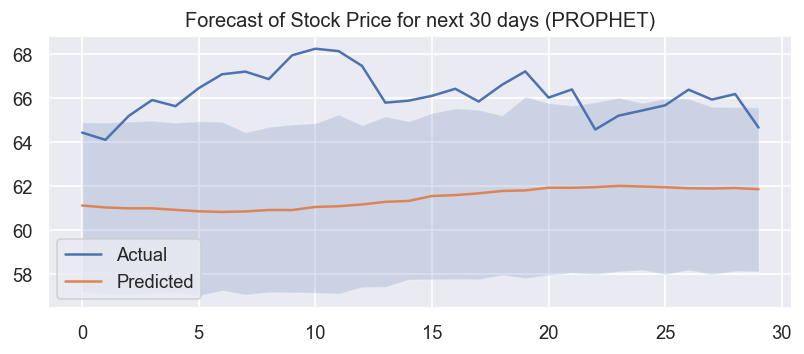

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5988.315, Time=0.61 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5988.674, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5990.417, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5990.384, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5986.877, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.161 seconds


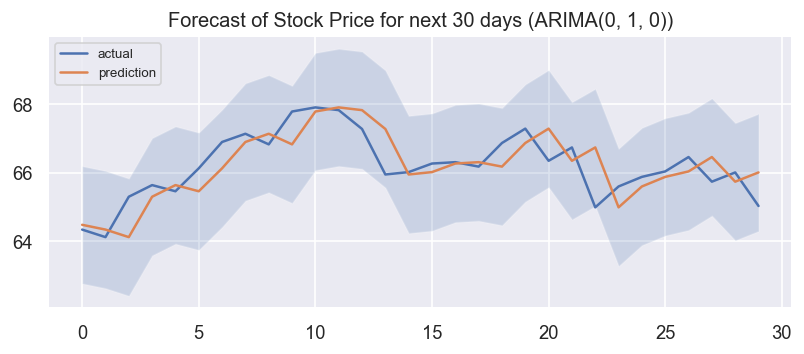

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -136.844
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7017.07     0.0222674       1310.09           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7194.64     0.0165671       380.642           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7239.55    0.00271468       605.735           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7270.73    0.00595741       127.133           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7285.08    0.00665079       1550.09      0.6565      0.6565      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  61.775629   56.491310   64.742188    61.775629    61.775629   
1  2017-10-03  61.795555   56.543136   64.827443    61.795555    61.795555   
2  2017-10-04  61.815481   56.497945   64.861432    61.815481    61.815481   
3  2017-10-05  61.835407   56.535540   64.283437    61.835407    61.835407   
4  2017-10-06  61.855333   56.527042   64.729621    61.855333    61.855333   
5  2017-10-09  61.915111   56.493326   64.506369    61.915111    61.915111   
6  2017-10-10  61.935037   56.159328   64.196958    61.935037    61.935037   
7  2017-10-11  61.954963   56.236178   64.644337    61.954963    61.954963   
8  2017-10-12  61.974889   56.259195   64.177238    61.974889    61.974889   
9  2017-10-13  61.994815   56.252856   64.643256    61.994815    61.994815   
10 2017-10-16  62.054593   56.141237   64.702479    62.054593    62.054593   
11 2017-10-17  62.074519   56.599378   64.560434    62.074519   

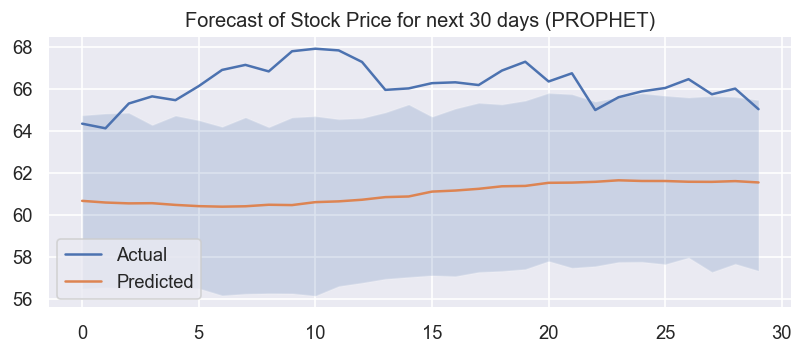

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=218.024, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=219.618, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=218.455, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=218.297, Time=0.38 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=219.946, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=219.765, Time=1.21 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=218.130, Time=1.02 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=218.477, Time=0.32 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=218.726, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=219.610, Time=1.94 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=218.726, Time=0.18 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 6.027 seconds


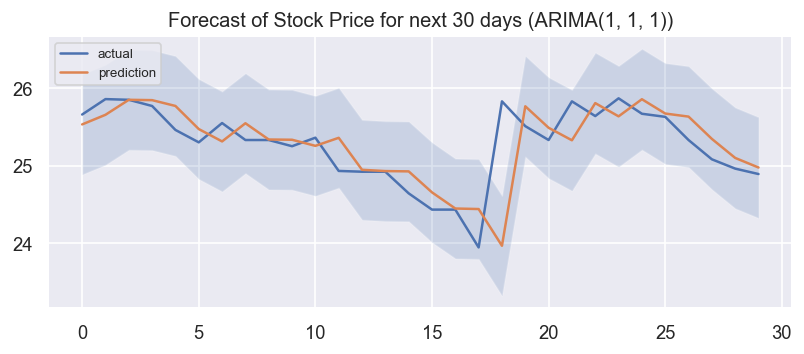

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -51.633
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7269.27      0.046296       8108.14      0.9362      0.9362      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7577.97     0.0638116       2663.75           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7725.15    0.00163479       328.585           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7747.51    0.00122116       481.796      0.4969      0.4969      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7760.33   0.000168756       262.153      0.6427      0.6427      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  26.303252   24.257596   26.922624    26.303252    26.303252   
1  2017-10-03  26.307823   24.377105   27.000004    26.307823    26.307823   
2  2017-10-04  26.312395   24.258247   27.005284    26.312395    26.312395   
3  2017-10-05  26.316966   24.312401   26.911278    26.316966    26.316966   
4  2017-10-06  26.321537   24.211136   26.930012    26.321537    26.321537   
5  2017-10-09  26.335250   24.397726   26.952604    26.335250    26.335250   
6  2017-10-10  26.339821   24.380793   27.028935    26.339821    26.339821   
7  2017-10-11  26.344392   24.427103   27.082481    26.344392    26.344392   
8  2017-10-12  26.348964   24.434732   27.087257    26.348964    26.348964   
9  2017-10-13  26.353535   24.480232   27.165283    26.353535    26.353535   
10 2017-10-16  26.367248   24.534790   27.133224    26.367248    26.367248   
11 2017-10-17  26.371819   24.621788   27.167105    26.371819   

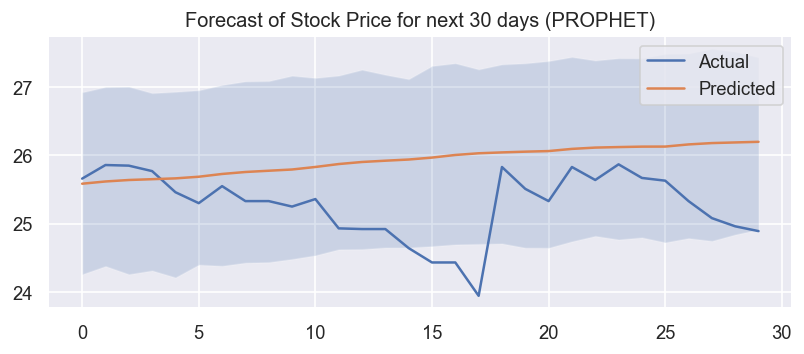

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-2387.151, Time=0.61 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-2387.795, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-2387.744, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-2387.684, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-2389.001, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.294 seconds


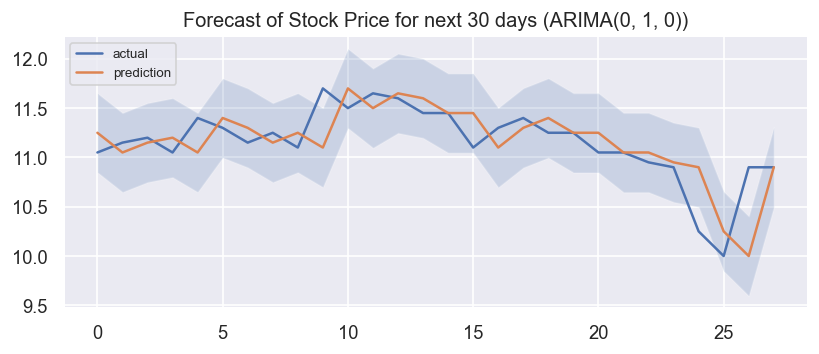

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -50.3992
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6681.95     0.0109399       481.611           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6917.93     0.0092095       1197.63           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7024.45    0.00232085       770.159      0.3776      0.3776      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7091.29    0.00146331       270.756           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7137.81    0.00589902       1159.35           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  13.367834   12.412315   14.005826    13.367834    13.367834   
1  2017-10-03  13.369252   12.494051   13.959978    13.369252    13.369252   
2  2017-10-04  13.370670   12.471942   13.993656    13.370670    13.370670   
3  2017-10-05  13.372088   12.547618   14.068317    13.372088    13.372088   
4  2017-10-06  13.373506   12.508344   14.043633    13.373506    13.373506   
5  2017-10-09  13.377759   12.512019   14.009191    13.377759    13.377759   
6  2017-10-10  13.379177   12.516039   14.030346    13.379177    13.379177   
7  2017-10-11  13.380594   12.530599   14.017513    13.380594    13.380594   
8  2017-10-12  13.382012   12.559018   14.059452    13.382012    13.382012   
9  2017-10-13  13.383430   12.434558   14.084653    13.383430    13.383430   
10 2017-10-16  13.387683   12.505243   14.061673    13.387683    13.387683   
11 2017-10-17  13.389101   12.458142   14.030072    13.389101   

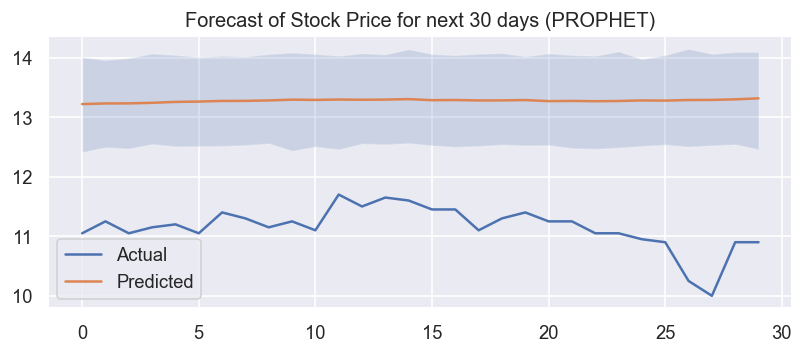

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=10135.937, Time=0.91 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=10140.976, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=10135.192, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=10135.352, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=10141.183, Time=0.04 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=10136.831, Time=0.17 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=10137.831, Time=0.75 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=10135.638, Time=0.06 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0] intercept
Total fit time: 2.234 seconds


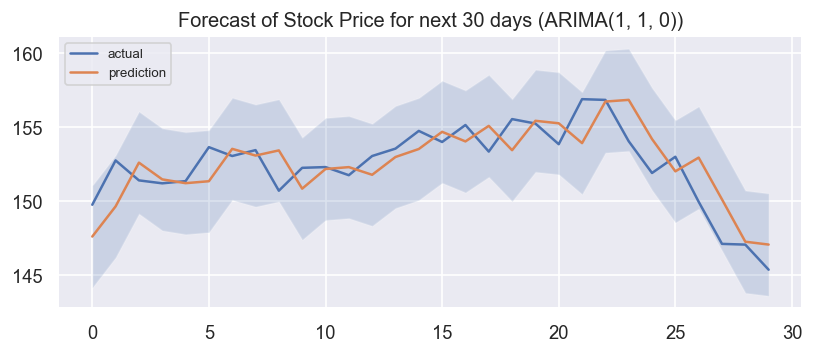

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -117.499
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8276.62   0.000782364        744.39      0.8657      0.8657      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8496.28   0.000395232       387.374           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8642.74    0.00960226        660.29      0.3906           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8668.14    0.00659225       297.776      0.8699     0.08699      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8687.19   0.000910576       222.514           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  126.348220  120.260492  131.121832   126.348220   126.348220   
1  2017-10-03  126.417118  120.181715  130.752599   126.417118   126.417118   
2  2017-10-04  126.486017  120.214369  131.058682   126.486017   126.486017   
3  2017-10-05  126.554915  119.972667  130.925198   126.554915   126.554915   
4  2017-10-06  126.623814  120.440644  131.051558   126.623814   126.623814   
5  2017-10-09  126.830509  119.906876  130.508942   126.830509   126.830509   
6  2017-10-10  126.899407  119.896879  131.066610   126.899407   126.899407   
7  2017-10-11  126.968306  120.204894  131.473189   126.968306   126.968306   
8  2017-10-12  127.037204  120.506338  130.944139   127.037204   127.037204   
9  2017-10-13  127.106103  120.635311  131.519348   127.106103   127.106103   
10 2017-10-16  127.312798  121.106330  131.728051   127.312798   127.312798   
11 2017-10-17  127.381696  120.845445  131.720618   

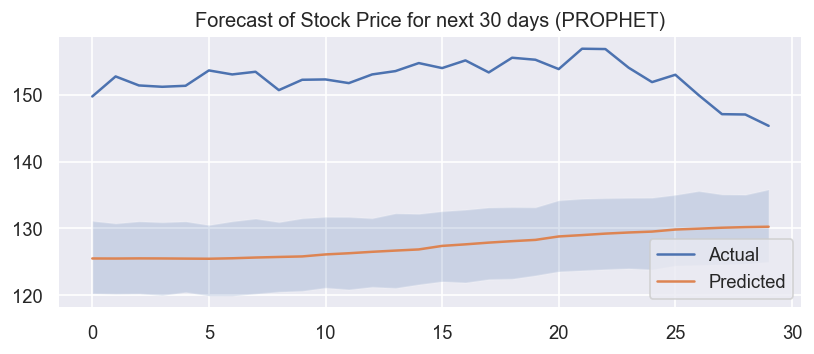

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3212.447, Time=0.51 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3216.215, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3210.973, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3211.196, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3218.072, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3212.286, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3214.270, Time=1.34 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3212.456, Time=0.08 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0] intercept
Total fit time: 2.692 seconds


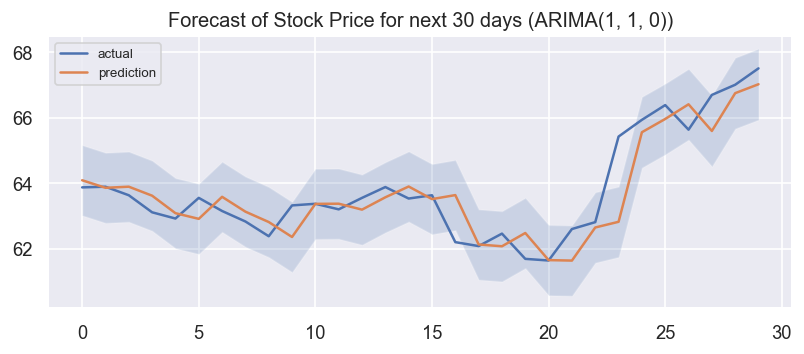

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -84.8447
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9247.82     0.0115754       2530.93      0.4549      0.4549      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        9428.4   0.000591353       937.909      0.5714      0.5714      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9480.81     0.0108489       1362.71           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        9510.5     0.0138128       2096.81           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       9526.26    0.00249261       459.044           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  68.035453   64.718051   68.696768    68.035453    68.035453   
1  2017-10-03  68.060544   64.617366   68.779807    68.060544    68.060544   
2  2017-10-04  68.085635   64.711132   68.659460    68.085635    68.085635   
3  2017-10-05  68.110726   64.764125   68.846763    68.110726    68.110726   
4  2017-10-06  68.135817   64.665845   68.754842    68.135817    68.135817   
5  2017-10-09  68.211091   64.524271   68.708181    68.211091    68.211091   
6  2017-10-10  68.236182   64.682077   68.642178    68.236182    68.236182   
7  2017-10-11  68.261273   64.736421   68.794571    68.261273    68.261273   
8  2017-10-12  68.286364   64.691627   68.733531    68.286364    68.286364   
9  2017-10-13  68.311455   64.727897   68.848854    68.311455    68.311455   
10 2017-10-16  68.386728   64.999760   69.035795    68.386728    68.386728   
11 2017-10-17  68.411819   64.913734   68.936104    68.411819   

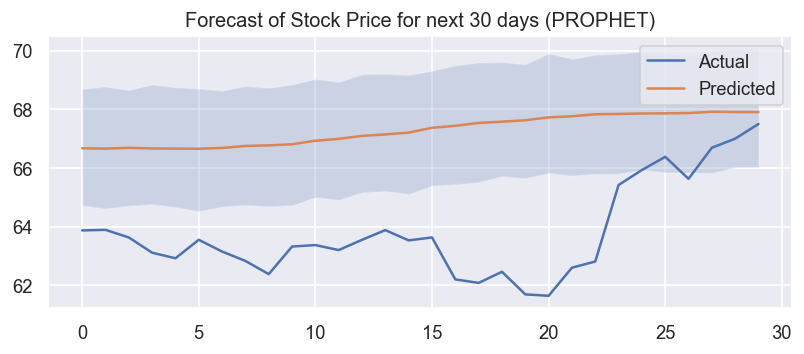

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-2705.686, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-2696.040, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-2706.903, Time=0.30 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-2707.207, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-2698.038, Time=0.11 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-2705.532, Time=0.35 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-2707.326, Time=0.87 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-2705.725, Time=2.08 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-2705.947, Time=2.66 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=-2703.887, Time=0.65 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-2707.915, Time=1.38 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-2705.413, Time=0.14 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-2705.844, Time=1.87 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-2703.566, Time=0.41 sec
 ARIMA(3,1,2)(0,0,0

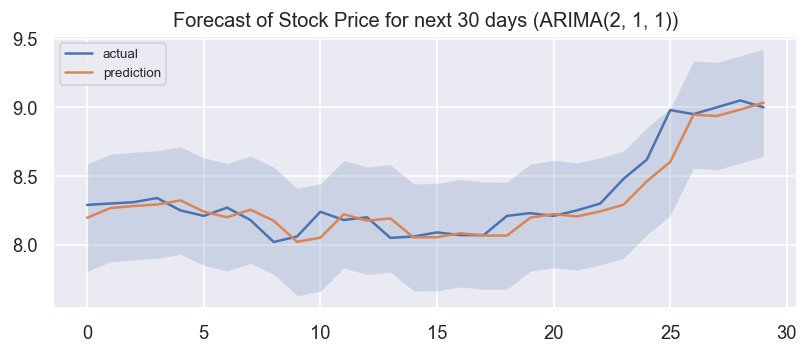

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -193.01
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6662.71     0.0282444       1067.24       0.794       0.794      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7168.71    0.00678012       1266.66           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7303.88    0.00207181        257.19           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7349.53     0.0182431        293.81      0.7233      0.7233      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7375.22     0.0134316       465.257           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  7.497802    6.831800    7.997011     7.497802     7.497802   
1  2017-10-03  7.499758    6.776187    8.017395     7.499758     7.499758   
2  2017-10-04  7.501714    6.850057    8.091263     7.501714     7.501714   
3  2017-10-05  7.503671    6.890844    8.052960     7.503671     7.503671   
4  2017-10-06  7.505627    6.832270    8.059770     7.505627     7.505627   
5  2017-10-09  7.511495    6.900572    8.102280     7.511495     7.511495   
6  2017-10-10  7.513452    6.890674    8.060000     7.513452     7.513452   
7  2017-10-11  7.515408    6.958827    8.097890     7.515408     7.515408   
8  2017-10-12  7.517364    6.947661    8.112805     7.517364     7.517364   
9  2017-10-13  7.519320    6.953506    8.106120     7.519320     7.519320   
10 2017-10-16  7.525189    6.942142    8.139792     7.525189     7.525189   
11 2017-10-17  7.527145    6.962340    8.118358     7.527145     7.527145   

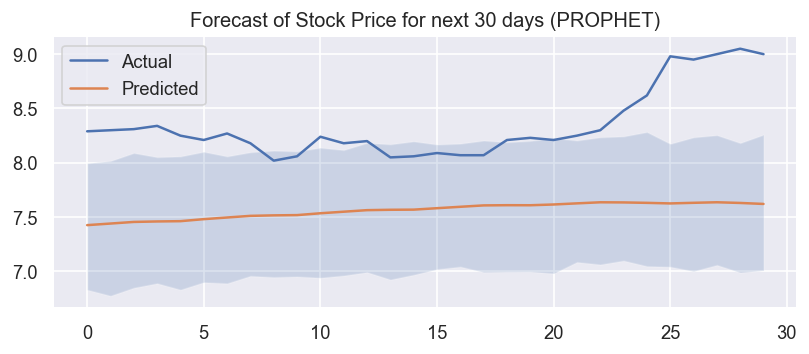

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2656.841, Time=0.27 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=24305.647, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.18 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=20309.545, Time=0.14 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2657.586, Time=0.54 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2657.128, Time=0.41 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=16862.356, Time=0.40 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.27 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2659.423, Time=0.41 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=2656.872, Time=0.77 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 3.435 seconds


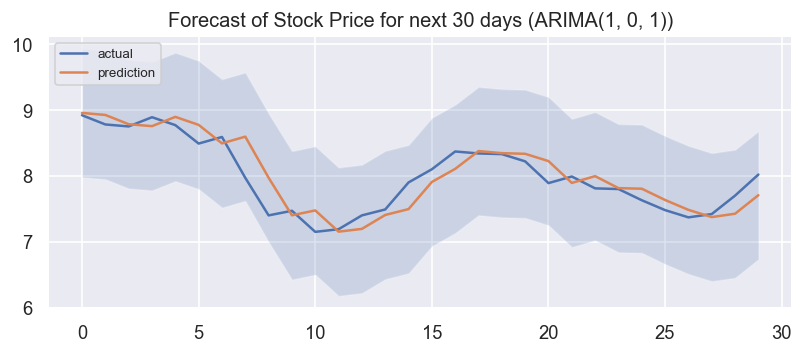

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -149.738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6870.33     0.0269406       1642.83      0.7346      0.7346      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7135.01      0.032019       929.803           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7431.97     0.0133185       704.853      0.9884      0.9884      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7566.57     0.0157856       1198.81           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7652.51    0.00340858       554.801           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  9.443163    7.949648   11.632475     9.443163     9.443163   
1  2017-10-03  9.438230    7.994768   11.592115     9.438230     9.438230   
2  2017-10-04  9.433297    8.070706   11.649776     9.433297     9.433297   
3  2017-10-05  9.428364    8.026372   11.536294     9.428364     9.428364   
4  2017-10-06  9.423432    7.963611   11.584747     9.423432     9.423432   
5  2017-10-09  9.408633    7.955916   11.561276     9.408633     9.408633   
6  2017-10-10  9.403700    8.022163   11.410183     9.403700     9.403700   
7  2017-10-11  9.398767    7.922130   11.447620     9.398767     9.398767   
8  2017-10-12  9.393834    7.982546   11.382341     9.393834     9.393834   
9  2017-10-13  9.388901    7.894346   11.508527     9.388901     9.388901   
10 2017-10-16  9.374102    7.730595   11.459443     9.374102     9.374102   
11 2017-10-17  9.369169    7.955744   11.233654     9.369169     9.369169   

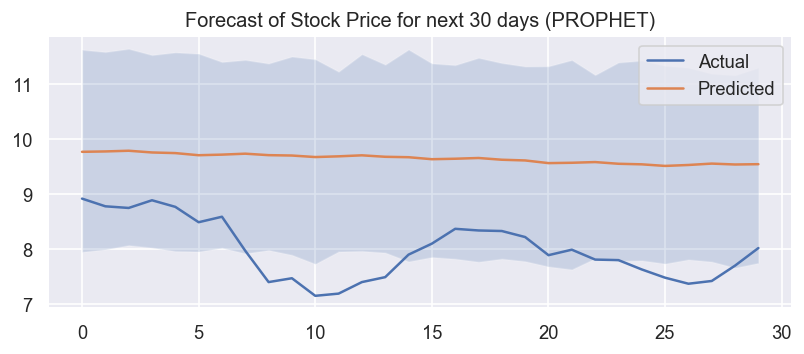

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=19746.121, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=19742.468, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=19744.121, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=19744.121, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=19740.959, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.562 seconds


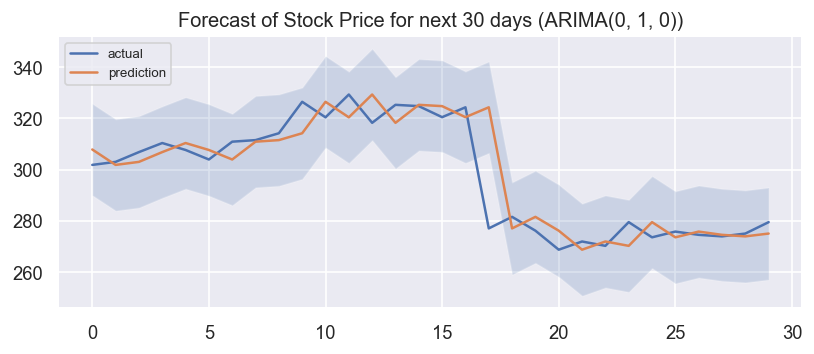

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -95.9574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6636.58     0.0206927       1765.92      0.0846           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        6854.9     0.0430111       301.052           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6925.4    0.00235098       409.809           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6945.82     0.0289834       1213.66           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     482       6963.94   0.000173676       236.656   2.725e-07       0.001      611  LS failed, Hessian reset 
     499       6966.69    0.00546635    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  317.801247  273.565198  365.254950   317.801247   317.801247   
1  2017-10-03  317.424800  268.239778  366.664297   317.424800   317.424800   
2  2017-10-04  317.048352  268.582948  361.859989   317.048352   317.048352   
3  2017-10-05  316.671905  270.605205  364.283032   316.671905   316.671905   
4  2017-10-06  316.295458  269.321789  367.850453   316.295458   316.295458   
5  2017-10-09  315.166116  269.482244  362.288709   315.166116   315.166116   
6  2017-10-10  314.789669  267.337267  365.551462   314.789669   314.789669   
7  2017-10-11  314.413221  262.758681  361.307941   314.413221   314.413221   
8  2017-10-12  314.036774  265.748285  360.957748   314.036774   314.036774   
9  2017-10-13  313.660327  266.179054  357.913979   313.660327   313.660327   
10 2017-10-16  312.530985  262.115496  357.583496   312.530985   312.530985   
11 2017-10-17  312.154538  260.152152  357.316452   

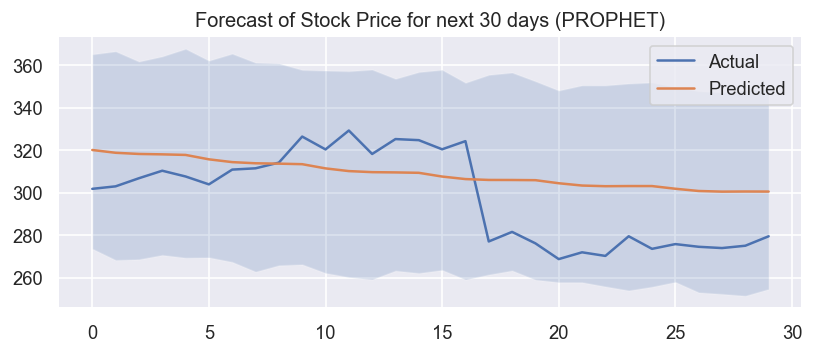

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9598.774, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9603.808, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9599.065, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9598.585, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9608.302, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=9597.720, Time=0.23 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=9599.539, Time=0.75 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=9599.351, Time=0.31 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=9601.314, Time=1.74 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=9603.374, Time=0.11 sec

Best model:  ARIMA(0,1,2)(0,0,0)[0] intercept
Total fit time: 3.722 seconds


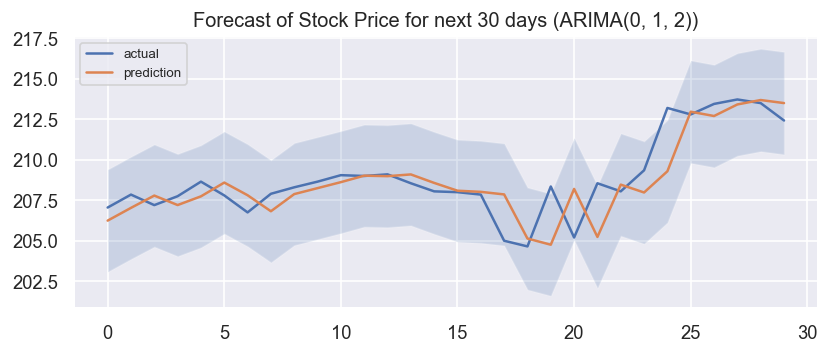

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -105.636
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8769.83     0.0128396       747.551       0.967       0.967      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8858.26     0.0107139          2337           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8892.14     0.0168687       356.453           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8910.69    0.00198482        299.94           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8918.26   0.000495565       329.797      0.7309      0.7309      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  176.739452  171.023902  185.686047   176.739452   176.739452   
1  2017-10-03  176.808771  170.646954  185.186097   176.808771   176.808771   
2  2017-10-04  176.878090  170.571923  185.241669   176.878090   176.878090   
3  2017-10-05  176.947408  170.227471  185.514551   176.947408   176.947408   
4  2017-10-06  177.016727  170.329862  185.355744   177.016727   177.016727   
5  2017-10-09  177.224684  169.628382  184.467142   177.224684   177.224684   
6  2017-10-10  177.294003  169.507888  184.607883   177.294003   177.294003   
7  2017-10-11  177.363321  170.160679  184.927782   177.363321   177.363321   
8  2017-10-12  177.432640  170.409109  185.314424   177.432640   177.432640   
9  2017-10-13  177.501959  169.961257  184.459887   177.501959   177.501959   
10 2017-10-16  177.709916  169.725959  184.700545   177.709916   177.709916   
11 2017-10-17  177.779235  170.069672  184.321421   

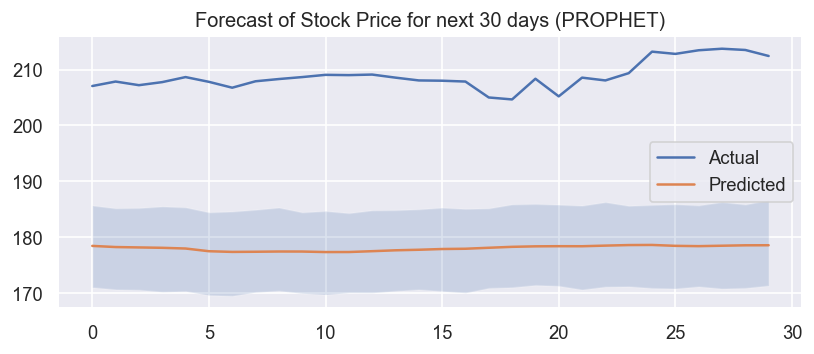

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6886.895, Time=0.90 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6891.473, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6892.858, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6892.837, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6889.703, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6887.626, Time=0.95 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6887.704, Time=1.35 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6893.920, Time=0.25 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=6894.057, Time=0.18 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6890.102, Time=0.83 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=6885.230, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=6891.074, Time=0.06 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=6891.095, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=6885.962, Time=0.22 sec
 ARIMA(1,1,2)(0,0,0)[0]          

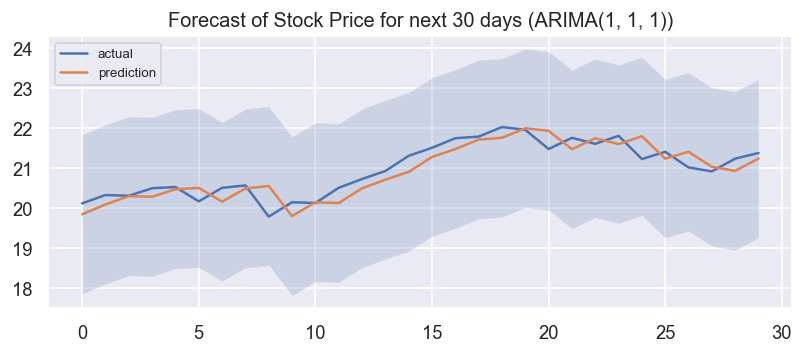

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -68.1983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6134.63     0.0336805       1890.08           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6291.73     0.0140822       1132.73      0.3828      0.3828      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6385.44     0.0458586       317.078           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6442.07      0.105442       1228.71      0.1491           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6464.48     0.0386238       867.322           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  16.334877   12.519209   20.101593    16.334877    16.334877   
1  2017-10-03  16.328222   12.204697   19.852045    16.328222    16.328222   
2  2017-10-04  16.321566   12.308390   19.873142    16.321566    16.321566   
3  2017-10-05  16.314911   12.232572   20.043445    16.314911    16.314911   
4  2017-10-06  16.308255   12.037075   19.751273    16.308255    16.308255   
5  2017-10-09  16.288289   12.495494   19.689150    16.288289    16.288289   
6  2017-10-10  16.281634   12.205471   19.731041    16.281634    16.281634   
7  2017-10-11  16.274978   12.233735   19.915777    16.274978    16.274978   
8  2017-10-12  16.268323   12.151371   19.799879    16.268323    16.268323   
9  2017-10-13  16.261667   12.149114   19.573639    16.261667    16.261667   
10 2017-10-16  16.241701   12.327402   19.719474    16.241701    16.241701   
11 2017-10-17  16.235046   12.044749   19.880874    16.235046   

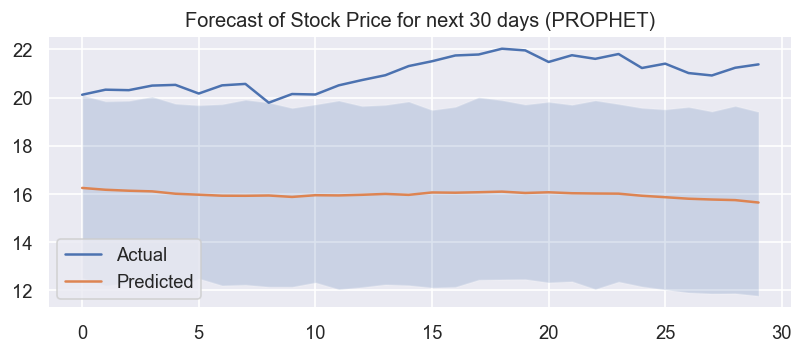

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1711.557, Time=0.73 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1706.438, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1704.921, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1704.918, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1708.429, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-1700.965, Time=0.49 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1700.954, Time=0.50 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1702.951, Time=0.65 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-1702.969, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1707.567, Time=1.48 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1713.530, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1706.908, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-1706.912, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-1702.955, Time=0.18 sec
 ARIMA(1,1,2)(0,0,0

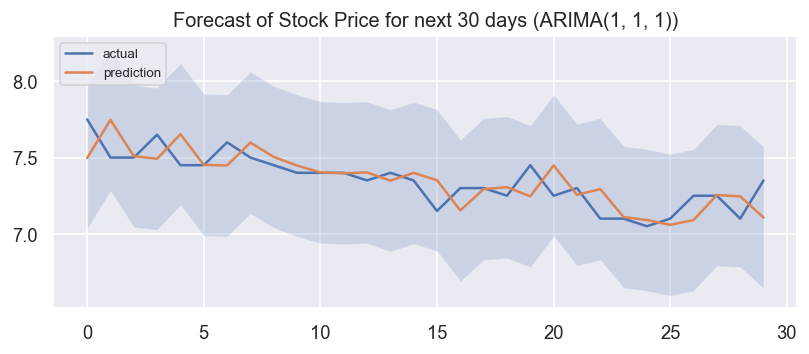

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -40.562
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5956.57     0.0827347       1936.25           1           1      107   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6136.82     0.0359706       1097.97       0.233           1      213   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6192.19     0.0266628       921.112      0.7303      0.7303      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6204.17    0.00584492       133.932           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     449       6212.36   9.28152e-05       89.3226   5.243e-07       0.001      575  LS failed, Hessian reset 
     474       6214.06   0.000145045     

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  5.234036    3.581889    5.986468     5.234036     5.234036   
1  2017-10-03  5.231999    3.529780    6.094742     5.231999     5.231999   
2  2017-10-04  5.229962    3.513841    5.981726     5.229962     5.229962   
3  2017-10-05  5.227926    3.532007    5.869085     5.227926     5.227926   
4  2017-10-06  5.225889    3.490801    6.103970     5.225889     5.225889   
5  2017-10-09  5.219780    3.693640    6.137966     5.219780     5.219780   
6  2017-10-10  5.217743    3.662673    6.110866     5.217743     5.217743   
7  2017-10-11  5.215706    3.712533    6.173512     5.215706     5.215706   
8  2017-10-12  5.213670    3.632957    6.109115     5.213670     5.213670   
9  2017-10-13  5.211633    3.734133    6.124188     5.211633     5.211633   
10 2017-10-16  5.205524    3.724820    6.356998     5.205524     5.205524   
11 2017-10-17  5.203487    3.850548    6.149155     5.203487     5.203487   

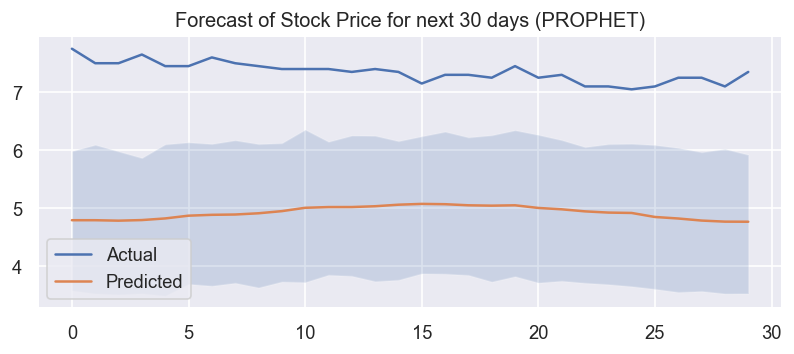

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6248.580, Time=0.70 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6245.337, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6247.329, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6247.329, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6244.485, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.226 seconds


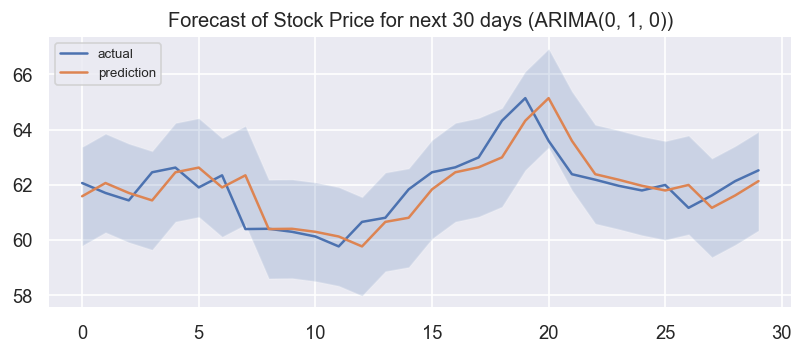

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -49.2574
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7518.64     0.0772954       2159.83           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7777.23     0.0110796       856.253           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7924.48     0.0167814       1693.11      0.3748           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7954.71     0.0177799       409.577           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     408       7956.23   6.02852e-05        190.03   3.061e-07       0.001      516  LS failed, Hessian reset 
     499       7967.77   0.000758031    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  56.584816   53.138335   59.229393    56.584816    56.584816   
1  2017-10-03  56.585836   53.105281   59.193482    56.585836    56.585836   
2  2017-10-04  56.586855   53.119319   59.246398    56.586855    56.586855   
3  2017-10-05  56.587874   53.008216   59.159457    56.587874    56.587874   
4  2017-10-06  56.588894   52.975799   59.123526    56.588894    56.588894   
5  2017-10-09  56.591952   52.724445   58.809461    56.591952    56.591952   
6  2017-10-10  56.592972   52.817721   58.555595    56.592972    56.592972   
7  2017-10-11  56.593991   52.489953   58.793726    56.593991    56.593991   
8  2017-10-12  56.595011   52.742651   58.750437    56.595011    56.595011   
9  2017-10-13  56.596030   52.673074   58.925216    56.596030    56.596030   
10 2017-10-16  56.599088   52.560889   58.599567    56.599088    56.599088   
11 2017-10-17  56.600108   52.550542   58.625749    56.600108   

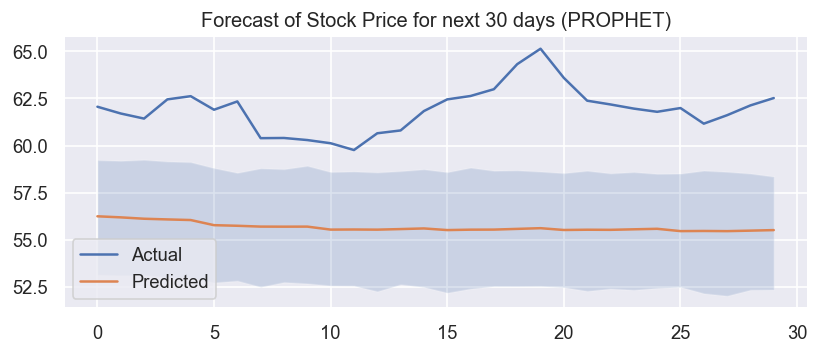

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5982.478, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5980.439, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5980.550, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5980.536, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5978.474, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.686 seconds


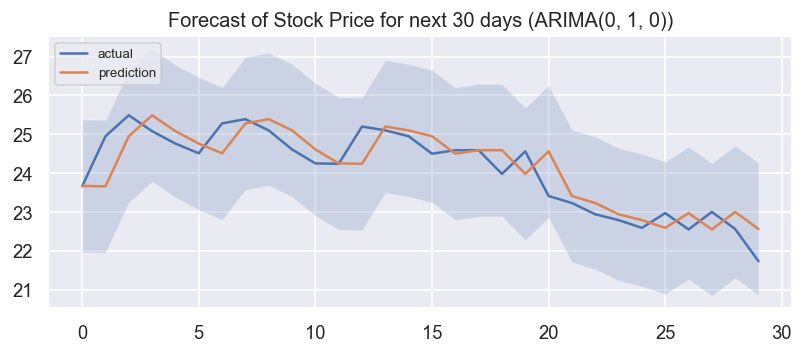

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -100.625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5626.91     0.0399354       1167.79           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5827.26     0.0191581       397.459           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5965.47     0.0160765       637.483      0.3338           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6015.28     0.0386212        510.28           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6059.96    0.00987059       354.461      0.4138      0.4138      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.429785   11.883416   20.831689    17.429785    17.429785   
1  2017-10-03  17.428613   11.454848   20.831911    17.428613    17.428613   
2  2017-10-04  17.427440   11.565697   20.813538    17.427440    17.427440   
3  2017-10-05  17.426268   12.264364   20.781899    17.426268    17.426268   
4  2017-10-06  17.425095   11.855322   20.800346    17.425095    17.425095   
5  2017-10-09  17.421578   11.893429   21.075112    17.421578    17.421578   
6  2017-10-10  17.420405   11.897560   20.697283    17.420405    17.420405   
7  2017-10-11  17.419233   12.279061   21.130151    17.419233    17.419233   
8  2017-10-12  17.418060   12.152217   21.289835    17.418060    17.418060   
9  2017-10-13  17.416888   12.466999   21.291268    17.416888    17.416888   
10 2017-10-16  17.413370   12.809010   21.478712    17.413370    17.413370   
11 2017-10-17  17.412197   12.518057   21.714795    17.412197   

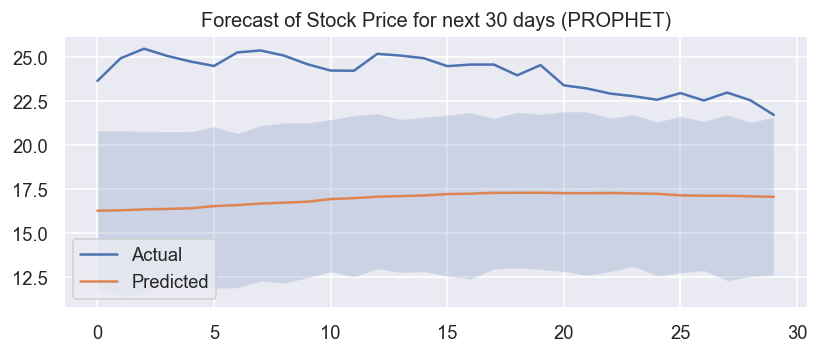

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9144.657, Time=0.47 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9141.592, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9142.938, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9142.912, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9143.570, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.838 seconds


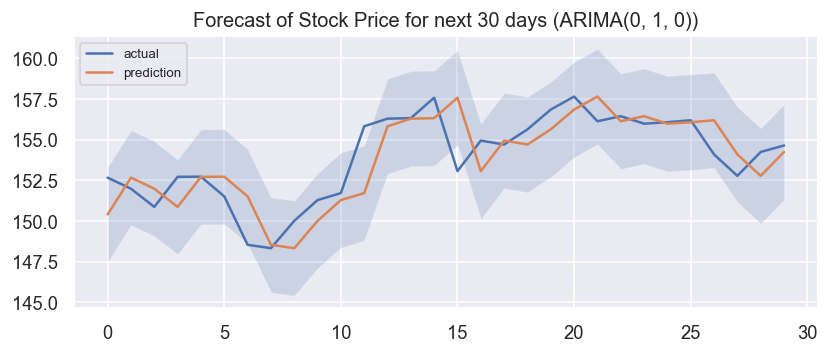

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -53.306
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        7988.9    0.00207968       1080.75           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8139.35    0.00231164        1057.8      0.1937           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8241.66     0.0298746       887.733           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8289.65     0.0449147       1662.61           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8324.94    0.00246902       274.115      0.9555      0.9555      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  157.609921  149.833832  161.998733   157.609921   157.609921   
1  2017-10-03  157.650663  149.937561  161.710985   157.650663   157.650663   
2  2017-10-04  157.691405  149.819690  161.966538   157.691405   157.691405   
3  2017-10-05  157.732147  149.459975  161.502536   157.732147   157.732147   
4  2017-10-06  157.772889  149.938794  162.366426   157.772889   157.772889   
5  2017-10-09  157.895116  149.648123  162.152120   157.895116   157.895116   
6  2017-10-10  157.935858  149.963599  162.649323   157.935858   157.935858   
7  2017-10-11  157.976600  149.961081  161.592974   157.976600   157.976600   
8  2017-10-12  158.017342  149.807494  162.209393   158.017342   158.017342   
9  2017-10-13  158.058084  149.736923  162.284897   158.058084   158.058084   
10 2017-10-16  158.180311  149.923406  162.096811   158.180311   158.180311   
11 2017-10-17  158.221053  149.863003  162.316483   

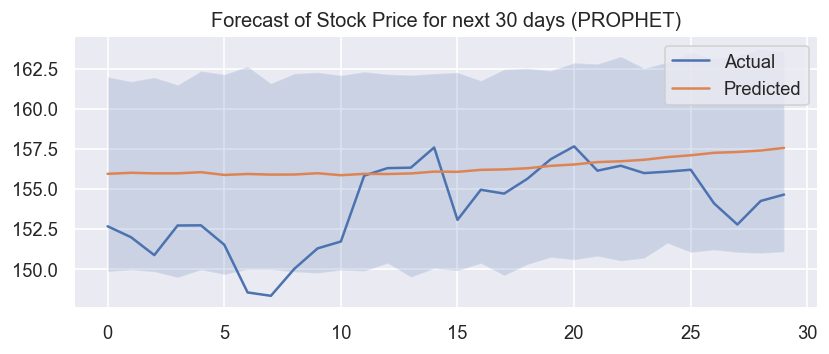

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4641.042, Time=0.45 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=29943.432, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.31 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=inf, Time=0.18 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=inf, Time=0.71 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=4641.925, Time=0.64 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=22268.772, Time=0.47 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.46 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=0.97 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=4640.665, Time=0.17 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=19460.683, Time=0.40 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.11 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=4641.694, Time=0.69 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=4641.590, Time=0.31 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=23376.344, Time=0.

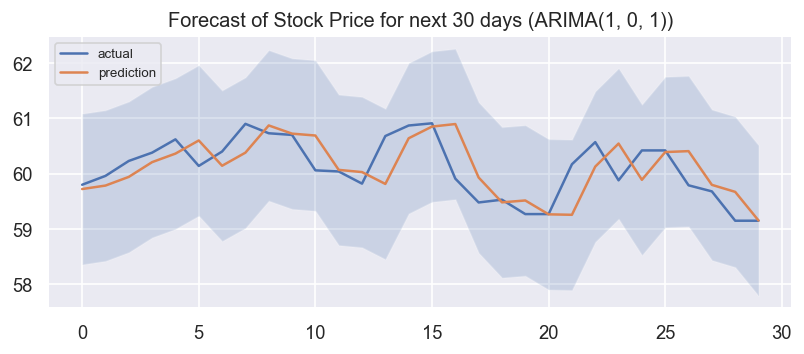

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -11.7624
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
Error evaluating model log probability: Non-finite gradient.

      99       8073.76     0.0122213       843.328           1           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8169.32     0.0156107       452.322      0.2823           1      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8221.91    0.00159768       592.758           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          8305     0.0664282       2370.23       7.842      0.7842      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8360.01      0.022799       537.739           1           1      583   
  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  56.537210   52.903617   57.497923    56.537210    56.537210   
1  2017-10-03  56.544225   52.748259   57.529277    56.544225    56.544225   
2  2017-10-04  56.551239   52.772656   57.522052    56.551239    56.551239   
3  2017-10-05  56.558254   52.756908   57.474159    56.558254    56.558254   
4  2017-10-06  56.565269   52.901989   57.548688    56.565269    56.565269   
5  2017-10-09  56.586313   52.629936   57.499327    56.586313    56.586313   
6  2017-10-10  56.593327   52.932141   57.745658    56.593327    56.593327   
7  2017-10-11  56.600342   53.074523   57.871785    56.600342    56.600342   
8  2017-10-12  56.607357   53.147891   57.714960    56.607357    56.607357   
9  2017-10-13  56.614371   53.006766   57.928660    56.614371    56.614371   
10 2017-10-16  56.635415   53.199992   58.016478    56.635415    56.635415   
11 2017-10-17  56.642430   53.430857   57.931860    56.642430   

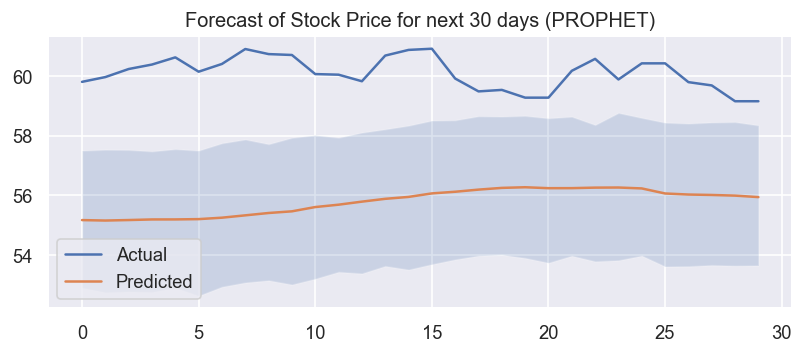

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2016.740, Time=1.06 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2020.122, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2018.253, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2018.550, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2020.506, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2017.308, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2017.293, Time=0.68 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2015.295, Time=0.23 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=2017.293, Time=0.45 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=2019.254, Time=0.58 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=2015.645, Time=0.13 sec

Best model:  ARIMA(0,1,2)(0,0,0)[0] intercept
Total fit time: 4.189 seconds


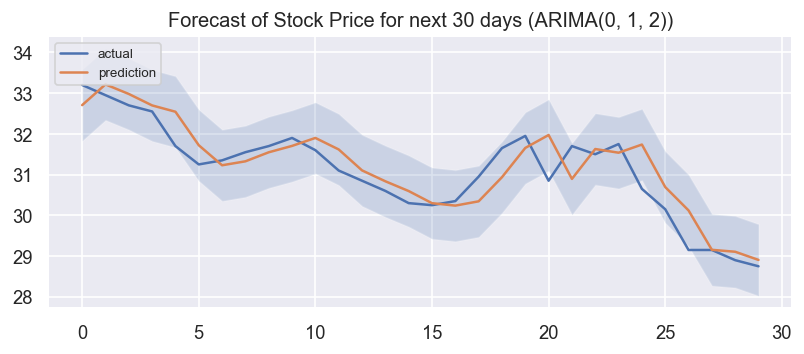

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -43.4184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7102.09     0.0268808       1138.49           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7305.54     0.0924613       2183.29           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7428.09      0.354504       2616.52           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7516.46    0.00267339       422.634           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7547.17     0.0219362       692.578           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  32.268447   30.340547   33.993313    32.268447    32.268447   
1  2017-10-03  32.275446   30.359396   34.116620    32.275446    32.275446   
2  2017-10-04  32.282445   30.244067   34.094127    32.282445    32.282445   
3  2017-10-05  32.289444   30.257584   34.089870    32.289444    32.289444   
4  2017-10-06  32.296443   30.342289   33.987556    32.296443    32.296443   
5  2017-10-09  32.317440   30.201716   33.869873    32.317440    32.317440   
6  2017-10-10  32.324439   30.266878   33.932968    32.324439    32.324439   
7  2017-10-11  32.331438   30.366139   33.965735    32.331438    32.331438   
8  2017-10-12  32.338437   30.094923   33.993457    32.338437    32.338437   
9  2017-10-13  32.345436   30.288063   34.024740    32.345436    32.345436   
10 2017-10-16  32.366433   30.318248   34.033802    32.366433    32.366433   
11 2017-10-17  32.373432   30.028151   33.891706    32.373432   

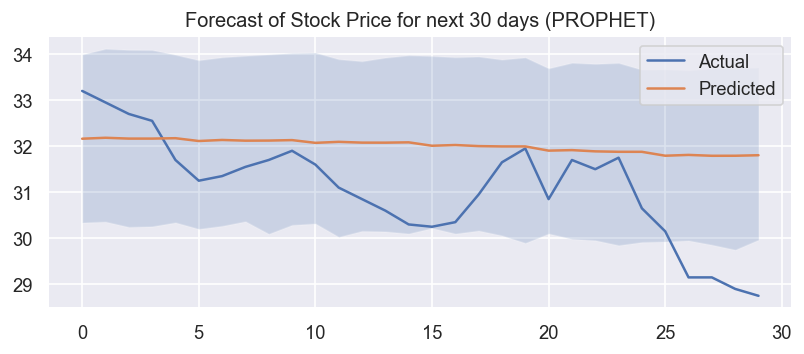

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6027.578, Time=0.81 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6026.943, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6027.395, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6027.298, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6026.919, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.324 seconds


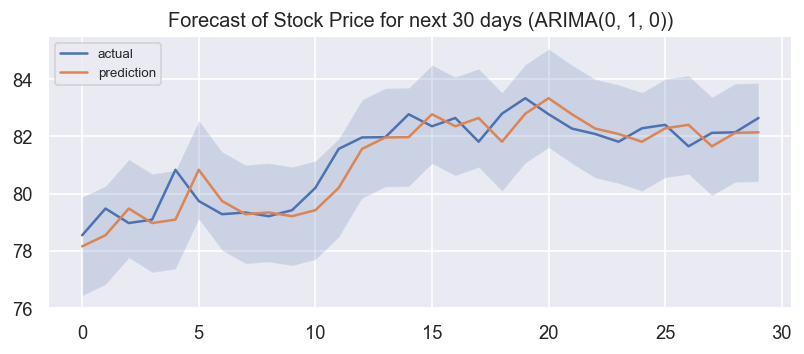

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -48.0443
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8316.25    0.00976432       398.395           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8378.63     0.0208769       2206.36           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8399.03   0.000478802       115.739           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8411.03   0.000724185       688.522      0.2858      0.2858      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8414.08   0.000156976       186.279      0.4972      0.4972      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  82.741003   78.427062   86.164370    82.741003    82.741003   
1  2017-10-03  82.777393   78.134409   85.821205    82.777393    82.777393   
2  2017-10-04  82.813782   78.023644   85.982036    82.813782    82.813782   
3  2017-10-05  82.850171   77.917074   85.619891    82.850171    82.850171   
4  2017-10-06  82.886561   77.775860   85.605641    82.886561    82.886561   
5  2017-10-09  82.995729   78.034474   85.385340    82.995729    82.995729   
6  2017-10-10  83.032119   77.865236   85.690560    83.032119    83.032119   
7  2017-10-11  83.068508   77.860403   85.453927    83.068508    83.068508   
8  2017-10-12  83.104898   77.589719   85.572966    83.104898    83.104898   
9  2017-10-13  83.141287   77.923345   85.756555    83.141287    83.141287   
10 2017-10-16  83.250455   77.965098   85.863131    83.250455    83.250455   
11 2017-10-17  83.286845   77.906117   85.646298    83.286845   

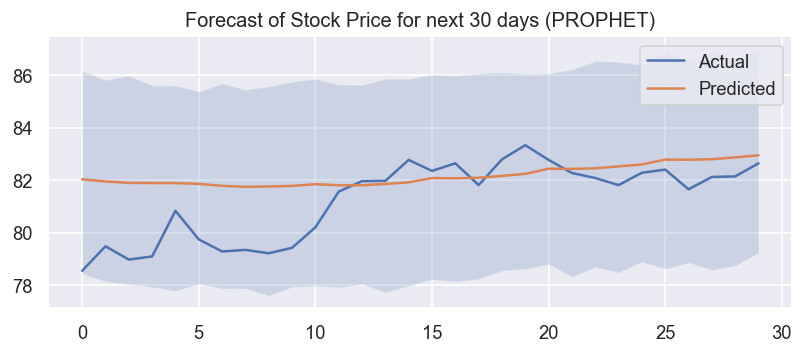

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2966.242, Time=0.67 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2973.419, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2965.458, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2965.605, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2971.493, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2967.334, Time=0.26 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2967.094, Time=1.08 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2963.539, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=2965.414, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2964.319, Time=0.26 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2963.687, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2965.174, Time=0.52 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.641 seconds


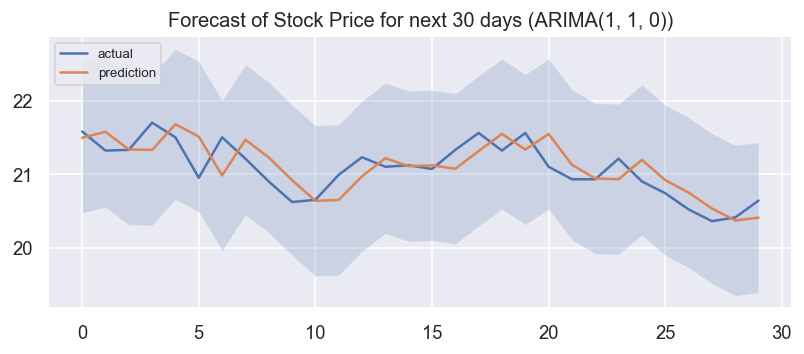

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -88.8701
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5536.02     0.0873968       1468.59      0.2373           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5690.53       0.12297       461.358       1.397      0.1397      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     292       5728.64   0.000262234       218.124   1.498e-06       0.001      385  LS failed, Hessian reset 
     299       5729.26   0.000475077       286.624      0.5689      0.5689      392   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     317       5736.06   0.000173105       154.601   7.861e-07       0.001      445  LS failed, Hessian reset 
     399       5755.14     0.0126374       172.775           1           1      540   
    Iter      log pro

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  21.254545   19.814951   24.239971    21.254545    21.254545   
1  2017-10-03  21.264073   19.842642   24.366344    21.264073    21.264073   
2  2017-10-04  21.273601   19.809258   24.327991    21.273601    21.273601   
3  2017-10-05  21.283129   19.749843   24.282963    21.283129    21.283129   
4  2017-10-06  21.292657   19.931448   24.472769    21.292657    21.292657   
5  2017-10-09  21.321240   19.822385   24.453366    21.321240    21.321240   
6  2017-10-10  21.330768   20.038850   24.384639    21.330768    21.330768   
7  2017-10-11  21.340296   19.995238   24.482708    21.340296    21.340296   
8  2017-10-12  21.349824   19.945916   24.564407    21.349824    21.349824   
9  2017-10-13  21.359352   20.231046   24.626673    21.359352    21.359352   
10 2017-10-16  21.387936   19.998654   24.504959    21.387936    21.387936   
11 2017-10-17  21.397464   20.121262   24.386526    21.397464   

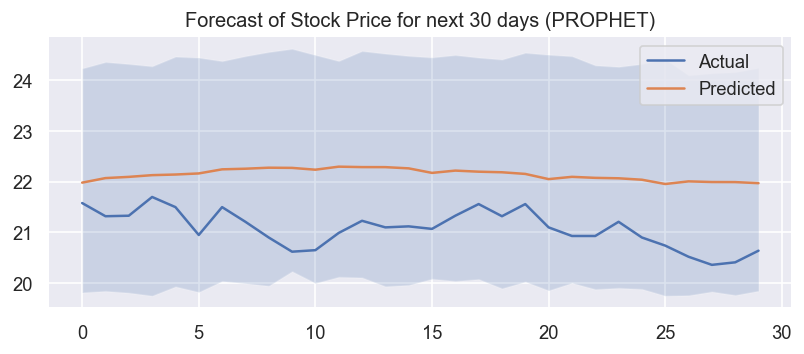

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1970.138, Time=0.81 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1954.866, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1955.490, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1955.731, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1956.662, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-1960.059, Time=1.79 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1970.123, Time=2.50 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1959.894, Time=0.36 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-1958.542, Time=0.30 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1969.087, Time=1.91 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1971.784, Time=0.28 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1957.512, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-1957.273, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-1971.866, Time=0.34 sec
 ARIMA(2,1,0)(0,0,0

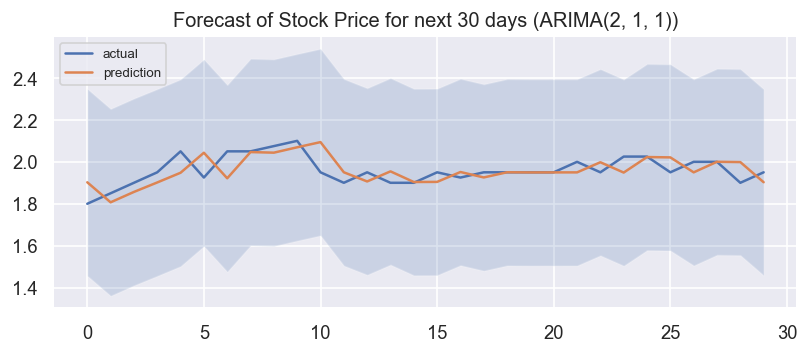

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -56.217
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6181.56     0.0683165       6911.46           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7014.68   0.000856865       654.537      0.5643      0.5643      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7139.49      0.020869       1447.16           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7338.41     0.0924997       2377.42      0.4871           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7392.01     0.0285677       378.898           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  2.141662    2.222467    3.725554     2.141662     2.141662   
1  2017-10-03  2.137852    2.190078    3.581208     2.137852     2.137852   
2  2017-10-04  2.134042    2.182399    3.641731     2.134042     2.134042   
3  2017-10-05  2.130231    2.136948    3.688464     2.130231     2.130231   
4  2017-10-06  2.126421    2.169912    3.598259     2.126421     2.126421   
5  2017-10-09  2.114990    2.148007    3.548960     2.114990     2.114990   
6  2017-10-10  2.111179    2.174380    3.605446     2.111179     2.111179   
7  2017-10-11  2.107369    2.113216    3.525972     2.107369     2.107369   
8  2017-10-12  2.103559    2.145212    3.549718     2.103559     2.103559   
9  2017-10-13  2.099748    2.072157    3.529644     2.099748     2.099748   
10 2017-10-16  2.088317    2.078341    3.566280     2.088317     2.088317   
11 2017-10-17  2.084507    2.089848    3.487953     2.084507     2.084507   

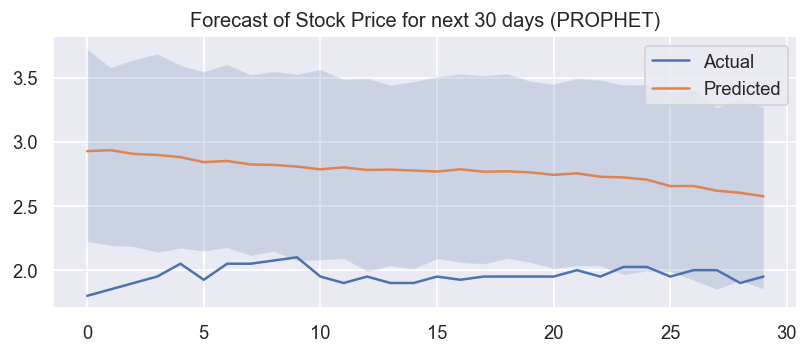

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6751.682, Time=0.56 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6754.605, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6751.888, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6751.563, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6752.676, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6750.752, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6752.722, Time=1.10 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=6752.688, Time=0.35 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=6750.092, Time=1.57 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=6745.915, Time=1.72 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6754.036, Time=1.77 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=6754.216, Time=3.05 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=6746.220, Time=2.44 sec
 ARIMA(2,1,3)(0,0,0)[0]             : AIC=6743.995, Time=0.87 sec
 ARIMA(1,1,3)(0,0,0)[0]          

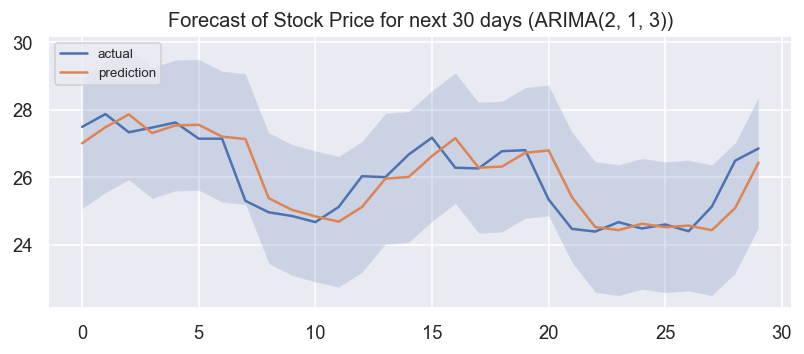

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -119.017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6001.09      0.040431       488.576       0.341      0.8563      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6089.75     0.0463336       1104.22           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     221       6102.61   0.000297113       281.614   8.378e-07       0.001      300  LS failed, Hessian reset 
     262       6117.93    0.00055135       187.049   3.367e-06       0.001      387  LS failed, Hessian reset 
     291       6122.52   0.000184014       171.419   1.454e-06       0.001      460  LS failed, Hessian reset 
     299       6124.04    0.00417534        258.63           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  43.413870   38.053886   48.991702    43.413870    43.413870   
1  2017-10-03  43.407898   38.117422   49.096781    43.407898    43.407898   
2  2017-10-04  43.401926   37.498884   49.153110    43.401926    43.401926   
3  2017-10-05  43.395954   37.926538   49.222704    43.395954    43.395954   
4  2017-10-06  43.389982   37.895517   48.961439    43.389982    43.389982   
5  2017-10-09  43.372066   38.138948   48.962811    43.372066    43.372066   
6  2017-10-10  43.366094   37.929989   48.737433    43.366094    43.366094   
7  2017-10-11  43.360122   38.222947   48.910985    43.360122    43.360122   
8  2017-10-12  43.354150   38.368642   49.034764    43.354150    43.354150   
9  2017-10-13  43.348178   37.855813   49.487317    43.348178    43.348178   
10 2017-10-16  43.330262   37.912814   48.866832    43.330262    43.330262   
11 2017-10-17  43.324290   38.035853   49.282625    43.324290   

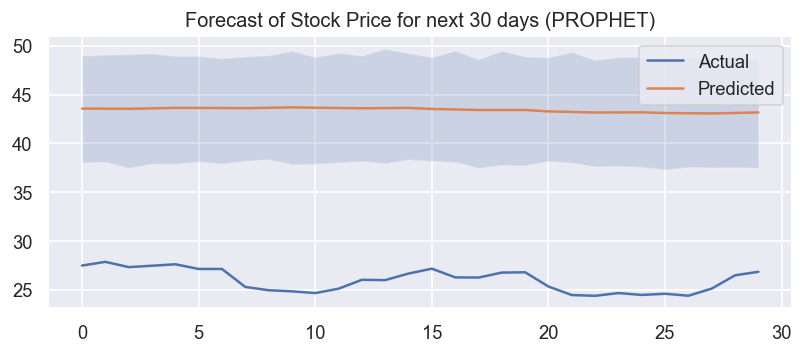

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8340.511, Time=0.77 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8339.606, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8341.261, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8341.272, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8337.614, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.346 seconds


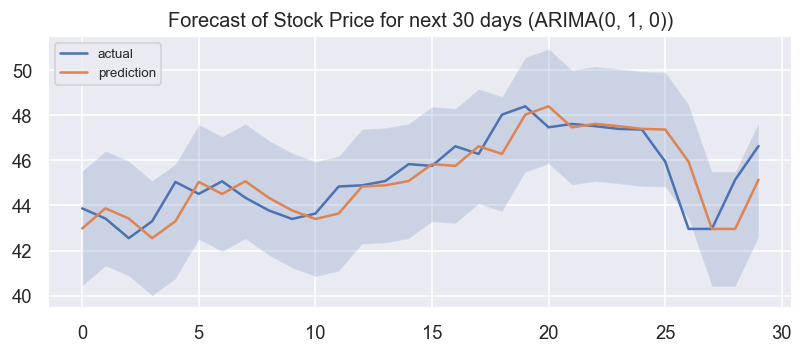

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -74.8911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6324.77     0.0585959       2401.42           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6691.01     0.0106047       444.475           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6758.98     0.0116129       1325.34           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        6810.6     0.0948504       358.824           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6859.41   0.000660496       530.239      0.6399      0.6399      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  46.789828   38.810209   51.189125    46.789828    46.789828   
1  2017-10-03  46.736755   38.499053   51.109485    46.736755    46.736755   
2  2017-10-04  46.683683   38.429813   50.843084    46.683683    46.683683   
3  2017-10-05  46.630610   38.216562   50.577917    46.630610    46.630610   
4  2017-10-06  46.577537   38.404518   50.240782    46.577537    46.577537   
5  2017-10-09  46.418319   37.799939   50.557964    46.418319    46.418319   
6  2017-10-10  46.365247   37.951444   49.882306    46.365247    46.365247   
7  2017-10-11  46.312174   37.804354   49.975548    46.312174    46.312174   
8  2017-10-12  46.259101   37.609886   50.233687    46.259101    46.259101   
9  2017-10-13  46.206029   38.027372   50.267169    46.206029    46.206029   
10 2017-10-16  46.046811   37.557257   50.246710    46.046811    46.046811   
11 2017-10-17  45.993738   37.873541   50.286391    45.993738   

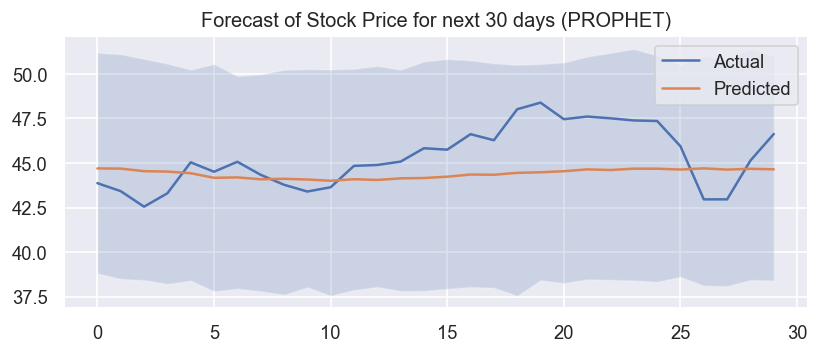

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9398.949, Time=0.43 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9402.964, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9397.109, Time=0.11 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9397.217, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9409.259, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=9398.980, Time=0.55 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=9400.946, Time=0.76 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=9402.578, Time=0.06 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0] intercept
Total fit time: 2.219 seconds


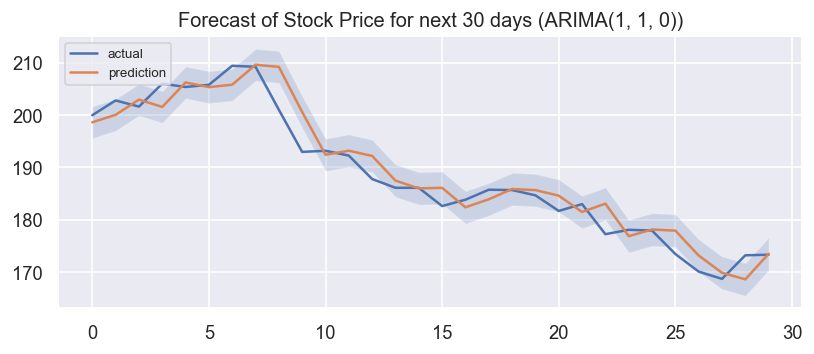

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -109.758
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9080.49     0.0046943       2946.08      0.6602      0.6602      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9169.74     0.0324971       718.773           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9208.15    0.00592519       325.859           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9217.18   0.000560163       616.334      0.4002      0.4002      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     468       9218.68   3.80477e-05        205.01   7.596e-08       0.001      593  LS failed, Hessian reset 
     499       9219.11   0.000141522    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  201.930694  192.740813  207.605424   201.930694   201.930694   
1  2017-10-03  202.058008  193.873247  207.822359   202.058008   202.058008   
2  2017-10-04  202.185323  193.288920  208.064304   202.185323   202.185323   
3  2017-10-05  202.312637  194.088200  208.070753   202.312637   202.312637   
4  2017-10-06  202.439951  193.646100  208.349370   202.439951   202.439951   
5  2017-10-09  202.821894  194.240256  207.770378   202.821894   202.821894   
6  2017-10-10  202.949208  194.732127  208.037131   202.949208   202.949208   
7  2017-10-11  203.076523  194.662644  208.812814   203.076523   203.076523   
8  2017-10-12  203.203837  194.953751  208.224765   203.203837   203.203837   
9  2017-10-13  203.331151  195.238378  209.022347   203.331151   203.331151   
10 2017-10-16  203.713094  195.569994  209.194093   203.713094   203.713094   
11 2017-10-17  203.840408  195.499171  209.426871   

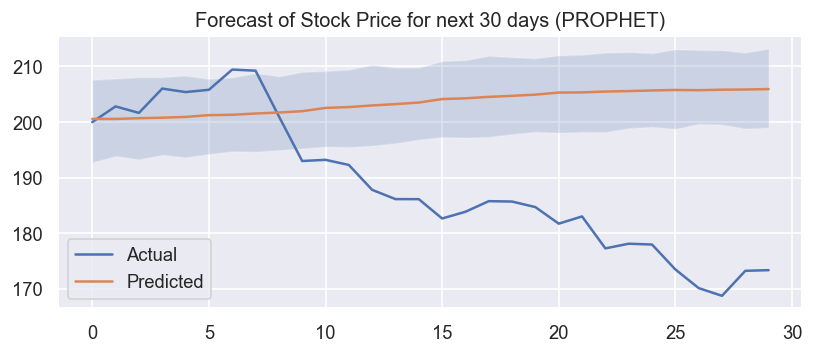

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5918.427, Time=1.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5917.076, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5919.070, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5919.069, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5918.576, Time=0.06 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 2.059 seconds


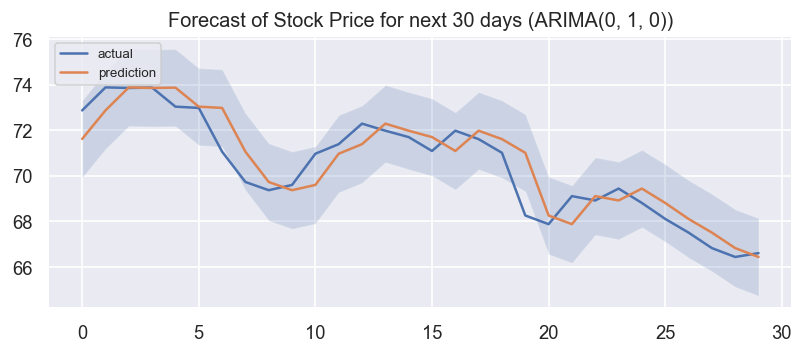

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -32.5988
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7888.57    0.00217672       1310.76           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8083.22    0.00355579       361.456           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        8100.3    0.00311093       622.697           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8112.56    0.00224531       475.728      0.6601      0.6601      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8119.22    0.00345407        311.14           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  79.760698   75.445337   83.160997    79.760698    79.760698   
1  2017-10-03  79.802702   75.270088   83.060461    79.802702    79.802702   
2  2017-10-04  79.844706   75.451927   82.913732    79.844706    79.844706   
3  2017-10-05  79.886710   75.234170   83.138136    79.886710    79.886710   
4  2017-10-06  79.928714   75.297941   83.063122    79.928714    79.928714   
5  2017-10-09  80.054726   75.596982   83.331949    80.054726    80.054726   
6  2017-10-10  80.096730   75.696544   83.264398    80.096730    80.096730   
7  2017-10-11  80.138734   75.542432   83.415115    80.138734    80.138734   
8  2017-10-12  80.180738   75.867193   83.426600    80.180738    80.180738   
9  2017-10-13  80.222742   75.936319   83.583101    80.222742    80.222742   
10 2017-10-16  80.348754   75.752198   83.537696    80.348754    80.348754   
11 2017-10-17  80.390758   75.487670   83.344262    80.390758   

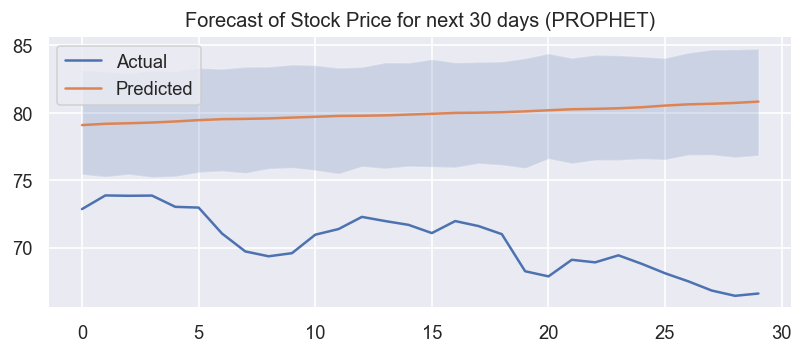

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3923.451, Time=0.60 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3920.466, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3922.049, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3922.025, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3918.505, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.195 seconds


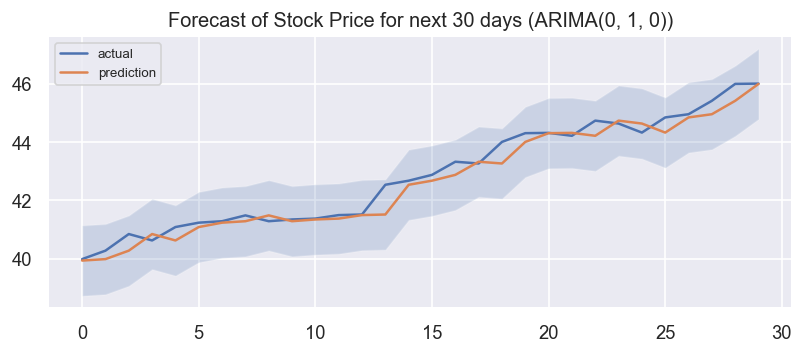

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -352.966
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6881.62     0.0330913       998.039           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7063.49     0.0134229       1033.46           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7171.18     0.0941638       684.832           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7208.58     0.0106151       325.874           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7235.72    0.00176934        119.18      0.4313      0.4313      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  34.251808   31.799250   35.930289    34.251808    34.251808   
1  2017-10-03  34.260978   31.606687   35.976812    34.260978    34.260978   
2  2017-10-04  34.270149   31.672934   35.861048    34.270149    34.270149   
3  2017-10-05  34.279319   31.360402   35.928887    34.279319    34.279319   
4  2017-10-06  34.288490   31.389295   35.723476    34.288490    34.288490   
5  2017-10-09  34.316001   31.256172   35.707690    34.316001    34.316001   
6  2017-10-10  34.325172   31.247434   35.645053    34.325172    34.325172   
7  2017-10-11  34.334342   31.213660   35.609461    34.334342    34.334342   
8  2017-10-12  34.343512   31.191422   35.711734    34.343512    34.343512   
9  2017-10-13  34.352683   31.139800   35.727567    34.352683    34.352683   
10 2017-10-16  34.380194   30.918649   35.371826    34.380194    34.380194   
11 2017-10-17  34.389365   31.195372   35.520258    34.389365   

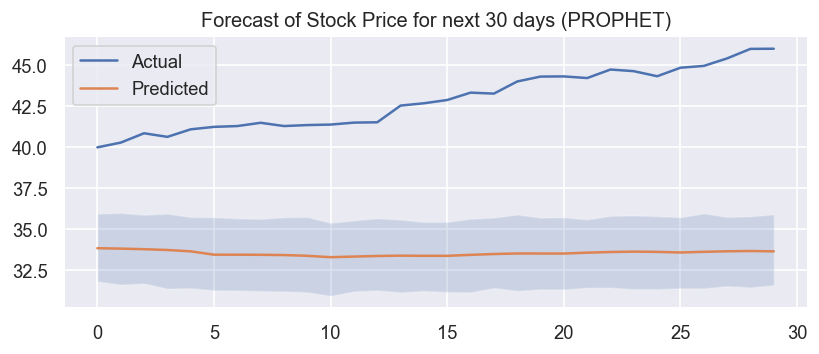

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2026.322, Time=0.36 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2028.458, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2027.882, Time=0.31 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2027.678, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2027.594, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2027.560, Time=1.11 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2027.553, Time=0.39 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2025.672, Time=0.31 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=2027.605, Time=0.78 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=1.15 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=2024.974, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2026.887, Time=0.08 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=2026.877, Time=0.18 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=2026.918, Time=0.20 sec
 ARIMA(1,1,1)(0,0,0)[0]             : 

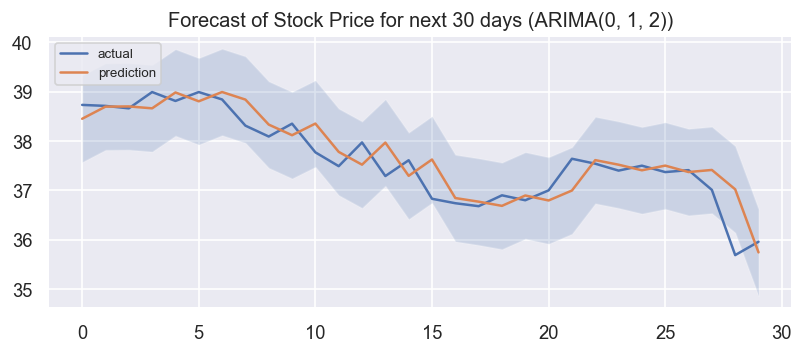

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -132.451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7459.88       0.07835       3712.85           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7666.64     0.0292154       798.188      0.9182      0.9182      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7768.16     0.0142115       944.127      0.5095           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7813.11    0.00195615       612.891           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7866.35     0.0149812       303.056       1.221      0.1221      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  35.195531   33.667963   37.267524    35.195531    35.195531   
1  2017-10-03  35.208445   33.574906   37.159619    35.208445    35.208445   
2  2017-10-04  35.221359   33.732053   37.253121    35.221359    35.221359   
3  2017-10-05  35.234273   33.629408   37.232051    35.234273    35.234273   
4  2017-10-06  35.247187   33.540417   37.189630    35.247187    35.247187   
5  2017-10-09  35.285928   33.395521   36.992059    35.285928    35.285928   
6  2017-10-10  35.298842   33.465088   37.142801    35.298842    35.298842   
7  2017-10-11  35.311755   33.392297   37.077138    35.311755    35.311755   
8  2017-10-12  35.324669   33.466653   37.045985    35.324669    35.324669   
9  2017-10-13  35.337583   33.443141   36.959891    35.337583    35.337583   
10 2017-10-16  35.376324   33.360957   37.009585    35.376324    35.376324   
11 2017-10-17  35.389238   33.476903   37.024757    35.389238   

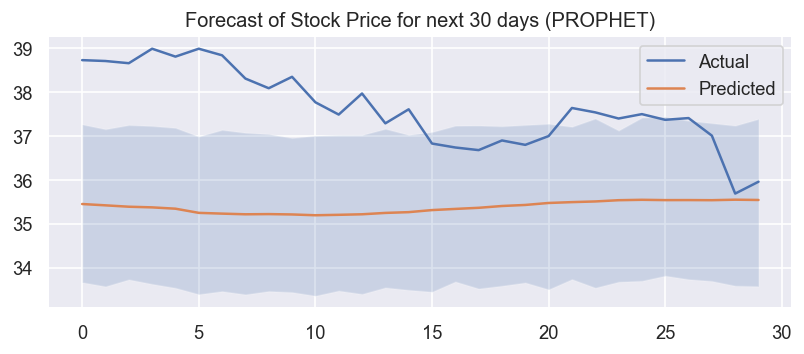

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1202.683, Time=0.90 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1200.759, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1202.030, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1202.373, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1202.561, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-1205.774, Time=0.81 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-1207.102, Time=0.19 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-1206.232, Time=0.30 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-1204.761, Time=1.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-1208.867, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-1203.818, Time=0.11 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=-1208.006, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-1207.543, Time=0.41 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1204.453, Time=0.21 sec
 ARIMA(3,1,1)(0,0,0

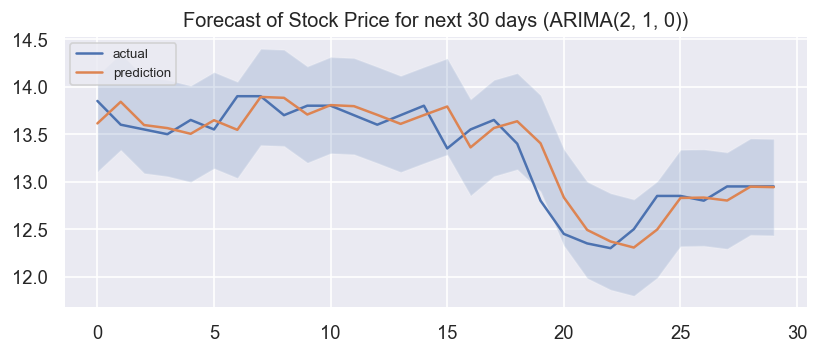

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -126.481
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6271.85     0.0123048       653.615           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6459.53     0.0211602       1241.75       0.839       0.839      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6525.97     0.0249092       1975.51           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6582.02    0.00141143       806.971      0.5818      0.5818      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     412       6584.38   0.000386097       348.259   3.369e-07       0.001      519  LS failed, Hessian reset 
     499       6598.67    0.00193821    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  11.045879    9.584875   12.152511    11.045879    11.045879   
1  2017-10-03  11.041779    9.567621   12.195050    11.041779    11.041779   
2  2017-10-04  11.037679    9.643438   12.153691    11.037679    11.037679   
3  2017-10-05  11.033578    9.630750   12.241199    11.033578    11.033578   
4  2017-10-06  11.029478    9.571442   12.187007    11.029478    11.029478   
5  2017-10-09  11.017177    9.522603   12.125596    11.017177    11.017177   
6  2017-10-10  11.013076    9.414237   12.066668    11.013076    11.013076   
7  2017-10-11  11.008976    9.389416   12.134842    11.008976    11.008976   
8  2017-10-12  11.004876    9.466144   12.109349    11.004876    11.004876   
9  2017-10-13  11.000775    9.434110   12.083928    11.000775    11.000775   
10 2017-10-16  10.988474    9.381967   12.033565    10.988474    10.988474   
11 2017-10-17  10.984374    9.387798   11.953831    10.984374   

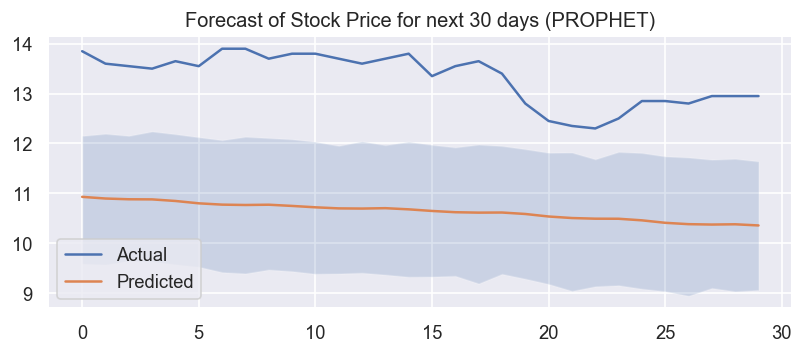

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=10054.176, Time=0.70 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=10057.050, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=10058.845, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=10058.833, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=10057.879, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=10041.810, Time=0.82 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=10058.571, Time=0.17 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=10041.485, Time=0.74 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=10054.936, Time=0.23 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=10041.220, Time=1.79 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=10040.651, Time=1.94 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=10042.154, Time=0.88 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=10041.410, Time=1.74 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=10041.932, Time=0.88 sec
 ARIMA(3,1,3)(0,0,0

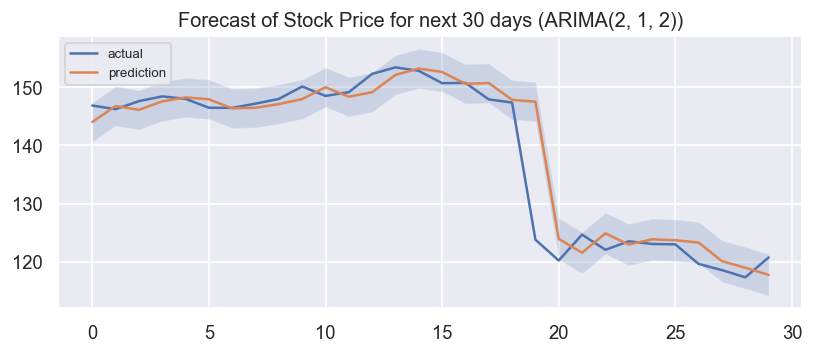

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -73.4965
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7957.99    0.00163257        352.75           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8074.83    0.00282307       597.809      0.4506      0.4506      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8110.46     0.0107474       956.048           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8161.29     0.0364364        1005.7           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8174.08    0.00137048       145.595           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  139.749253  133.493183  147.550096   139.749253   139.749253   
1  2017-10-03  139.794402  134.171775  146.931903   139.794402   139.794402   
2  2017-10-04  139.839550  133.727788  147.229233   139.839550   139.839550   
3  2017-10-05  139.884699  133.076648  147.449394   139.884699   139.884699   
4  2017-10-06  139.929847  133.522290  147.513605   139.929847   139.929847   
5  2017-10-09  140.065292  133.453459  147.417949   140.065292   140.065292   
6  2017-10-10  140.110441  132.999394  146.624366   140.110441   140.110441   
7  2017-10-11  140.155589  133.196836  147.220901   140.155589   140.155589   
8  2017-10-12  140.200738  133.724527  147.224795   140.200738   140.200738   
9  2017-10-13  140.245886  133.878413  147.518169   140.245886   140.245886   
10 2017-10-16  140.381332  133.824436  148.063331   140.381332   140.381332   
11 2017-10-17  140.426480  134.260676  148.096380   

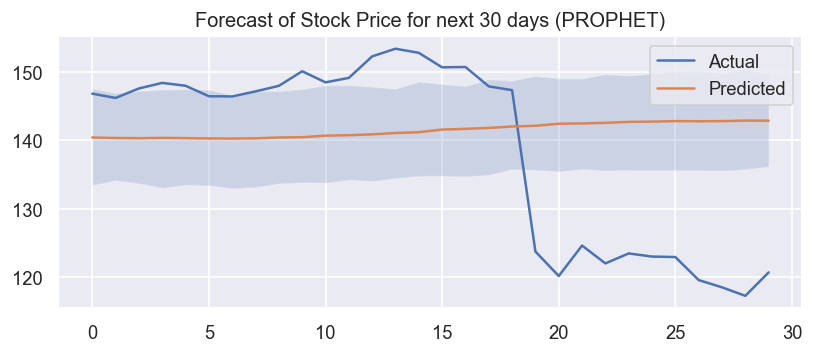

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6269.462, Time=0.57 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6266.870, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6268.499, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6268.484, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6265.018, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.051 seconds


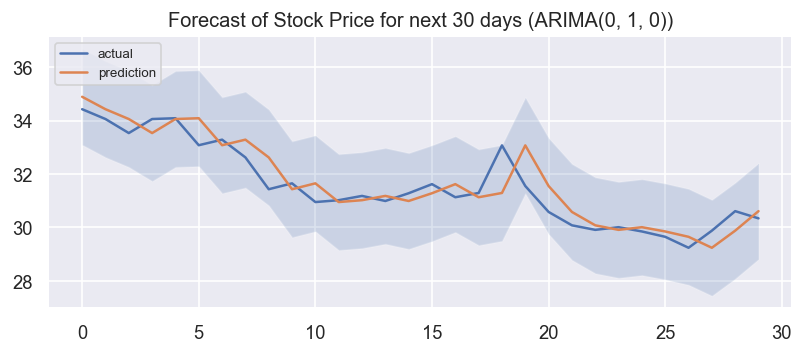

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -72.3367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6724.48     0.0621442       432.031           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6784.62     0.0133036       428.809      0.9833      0.9833      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          6817     0.0161729       207.367           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     342       6823.15   0.000242177       190.949   2.008e-06       0.001      464  LS failed, Hessian reset 
     399       6828.06    0.00899034       184.743      0.5517           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     428       6829.66   6.88259e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  58.252493   53.271583   64.318503    58.252493    58.252493   
1  2017-10-03  58.246523   53.032936   64.714040    58.246523    58.246523   
2  2017-10-04  58.240554   52.981021   64.034526    58.240554    58.240554   
3  2017-10-05  58.234584   53.084853   64.457385    58.234584    58.234584   
4  2017-10-06  58.228615   52.772721   64.579076    58.228615    58.228615   
5  2017-10-09  58.210707   53.719118   64.497503    58.210707    58.210707   
6  2017-10-10  58.204738   53.210961   64.481791    58.204738    58.204738   
7  2017-10-11  58.198768   53.455683   64.610207    58.198768    58.198768   
8  2017-10-12  58.192799   53.514767   64.554276    58.192799    58.192799   
9  2017-10-13  58.186830   53.271687   64.880514    58.186830    58.186830   
10 2017-10-16  58.168922   53.580565   65.073583    58.168922    58.168922   
11 2017-10-17  58.162952   53.630271   64.571845    58.162952   

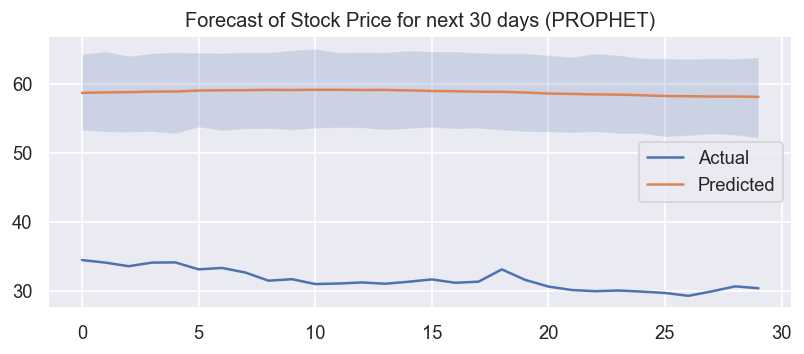

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6332.263, Time=0.46 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6333.412, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6331.192, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6331.117, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6331.455, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6332.873, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6327.555, Time=0.79 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6329.927, Time=1.33 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=6325.599, Time=1.09 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=6331.518, Time=0.36 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=6327.531, Time=1.88 sec
 ARIMA(1,1,3)(0,0,0)[0]             : AIC=6323.647, Time=0.50 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=6329.567, Time=0.17 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=6325.601, Time=0.35 sec
 ARIMA(2,1,3)(0,0,0)[0]          

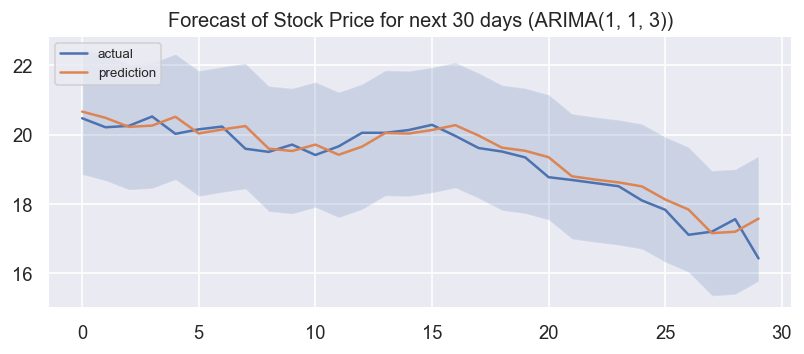

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -95.5478
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5529.43     0.0283132       828.384      0.5747      0.5747      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5816.63      0.119524        896.82       3.187     0.03187      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6129.71     0.0474683        836.13           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6196.99     0.0114412       403.117           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6230.41    0.00793876       783.401      0.5982      0.5982      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.461978   16.639129   23.364880    17.461978    17.461978   
1  2017-10-03  17.441370   16.346857   23.162575    17.441370    17.441370   
2  2017-10-04  17.420761   16.252915   22.869810    17.420761    17.420761   
3  2017-10-05  17.400152   16.374360   23.131393    17.400152    17.400152   
4  2017-10-06  17.379544   16.468321   23.102218    17.379544    17.379544   
5  2017-10-09  17.317717   16.448886   22.922998    17.317717    17.317717   
6  2017-10-10  17.297109   16.222895   23.085329    17.297109    17.297109   
7  2017-10-11  17.276500   16.410699   22.973958    17.276500    17.276500   
8  2017-10-12  17.255891   16.429077   23.199870    17.255891    17.255891   
9  2017-10-13  17.235283   16.128417   23.004920    17.235283    17.235283   
10 2017-10-16  17.173456   16.323665   22.905102    17.173456    17.173456   
11 2017-10-17  17.152848   16.386266   23.151137    17.152848   

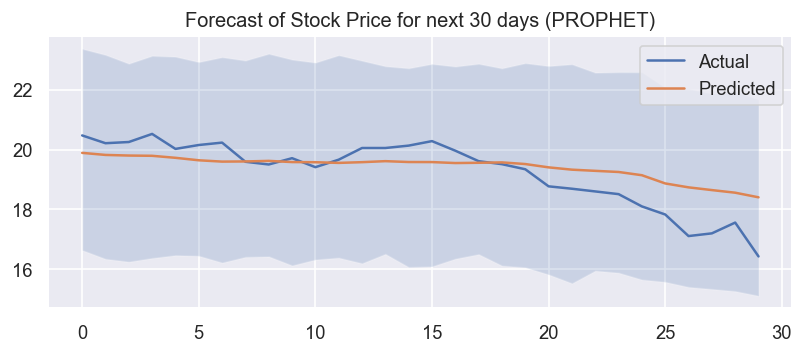

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9599.936, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9602.072, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9602.525, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9602.444, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9600.085, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=9601.610, Time=0.78 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=9601.623, Time=0.71 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=9602.481, Time=0.23 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=9602.736, Time=0.17 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=9603.924, Time=0.68 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=9597.953, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=9600.458, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=9600.539, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=9599.627, Time=0.31 sec
 ARIMA(1,1,2)(0,0,0)[0]          

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


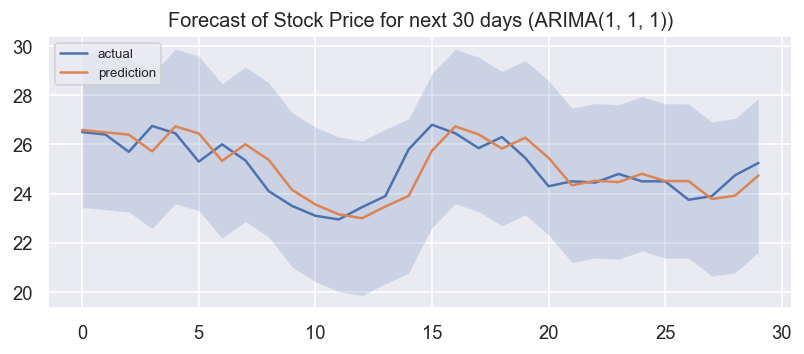

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -139.537
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6129.56     0.0142424       524.681      0.5894      0.5894      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6245.41     0.0105616       192.282      0.6396      0.6396      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6272.87    0.00135754       351.137      0.1311      0.2533      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6281.91   1.81948e-05        68.064      0.1019     0.01019      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6286.18    0.00434532       120.829      0.7637      0.7637      611   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  43.405963   34.496215   49.289234    43.405963    43.405963   
1  2017-10-03  43.373943   35.462540   49.402591    43.373943    43.373943   
2  2017-10-04  43.341923   34.833211   49.012217    43.341923    43.341923   
3  2017-10-05  43.309903   34.867392   49.814164    43.309903    43.309903   
4  2017-10-06  43.277883   34.656284   49.776365    43.277883    43.277883   
5  2017-10-09  43.181822   34.895466   49.644942    43.181822    43.181822   
6  2017-10-10  43.149802   34.659195   49.403441    43.149802    43.149802   
7  2017-10-11  43.117782   34.896344   50.017048    43.117782    43.117782   
8  2017-10-12  43.085762   35.401260   49.734446    43.085762    43.085762   
9  2017-10-13  43.053742   35.220141   49.867879    43.053742    43.053742   
10 2017-10-16  42.957681   34.769276   50.106865    42.957681    42.957681   
11 2017-10-17  42.925661   34.788389   50.110458    42.925661   

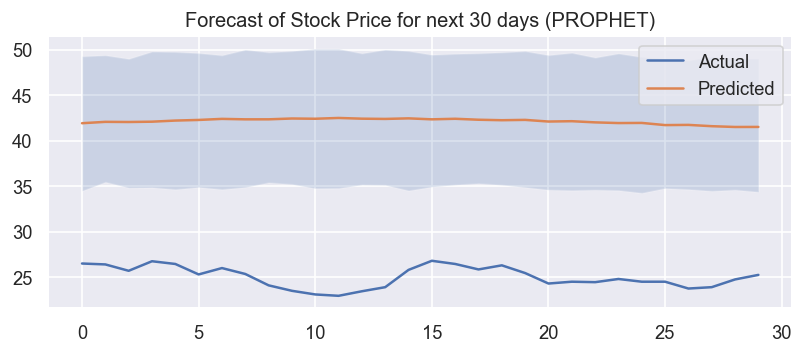

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-517.708, Time=0.87 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-520.649, Time=0.24 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-518.789, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-518.778, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-521.806, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.576 seconds


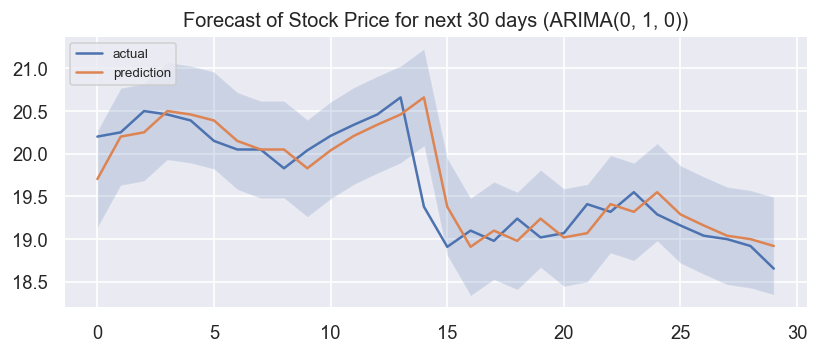

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -48.6115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6696.4      0.037808       1627.16           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6962.34     0.0312717       1183.76           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7035.95    0.00602059       317.999           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7064.46    0.00183491       298.458      0.4716           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        7076.5     0.0237961       452.886           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  19.629134   17.502184   20.100094    19.629134    19.629134   
1  2017-10-03  19.634083   17.495029   20.013374    19.634083    19.634083   
2  2017-10-04  19.639032   17.549530   20.026914    19.639032    19.639032   
3  2017-10-05  19.643981   17.432693   19.993366    19.643981    19.643981   
4  2017-10-06  19.648930   17.490519   20.057500    19.648930    19.648930   
5  2017-10-09  19.663778   17.485522   20.057920    19.663778    19.663778   
6  2017-10-10  19.668727   17.536377   20.020785    19.668727    19.668727   
7  2017-10-11  19.673676   17.564496   20.076441    19.673676    19.673676   
8  2017-10-12  19.678625   17.708181   20.059169    19.678625    19.678625   
9  2017-10-13  19.683574   17.575313   20.110036    19.683574    19.683574   
10 2017-10-16  19.698421   17.652775   20.184089    19.698421    19.698421   
11 2017-10-17  19.703370   17.828656   20.314636    19.703370   

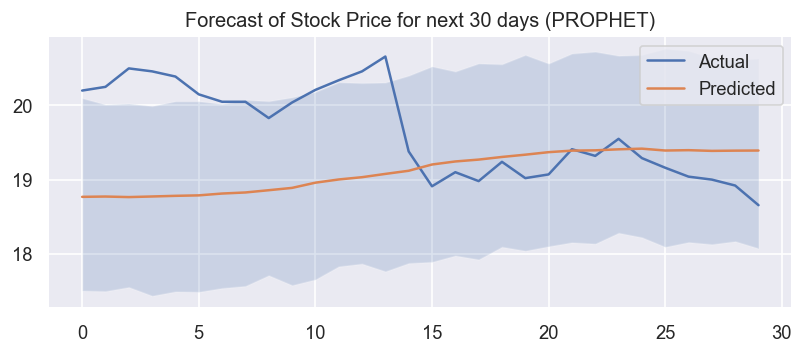

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6676.772, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6672.921, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6674.775, Time=0.11 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6674.770, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6673.050, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.723 seconds


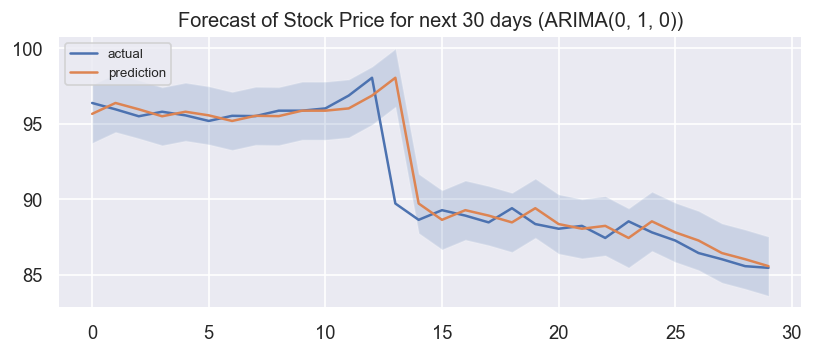

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -29.8058
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8342.69    0.00749426       1282.95      0.3265           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8389.78    0.00509087       653.283           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        8421.6     0.0113754       764.895           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8444.25      0.013819       218.535           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8460.92    0.00351481       290.831      0.3827      0.3827      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  93.195775   87.560813   95.845910    93.195775    93.195775   
1  2017-10-03  93.203983   87.683468   95.917625    93.203983    93.203983   
2  2017-10-04  93.212190   87.469195   95.869619    93.212190    93.212190   
3  2017-10-05  93.220397   87.249423   95.687604    93.220397    93.220397   
4  2017-10-06  93.228604   87.510219   96.206907    93.228604    93.228604   
5  2017-10-09  93.253225   86.968604   95.492789    93.253225    93.253225   
6  2017-10-10  93.261432   87.514304   95.867830    93.261432    93.261432   
7  2017-10-11  93.269639   87.789135   95.803768    93.269639    93.269639   
8  2017-10-12  93.277846   87.416755   95.586219    93.277846    93.277846   
9  2017-10-13  93.286053   87.554946   95.683585    93.286053    93.286053   
10 2017-10-16  93.310675   87.427657   95.739146    93.310675    93.310675   
11 2017-10-17  93.318882   87.584386   95.927494    93.318882   

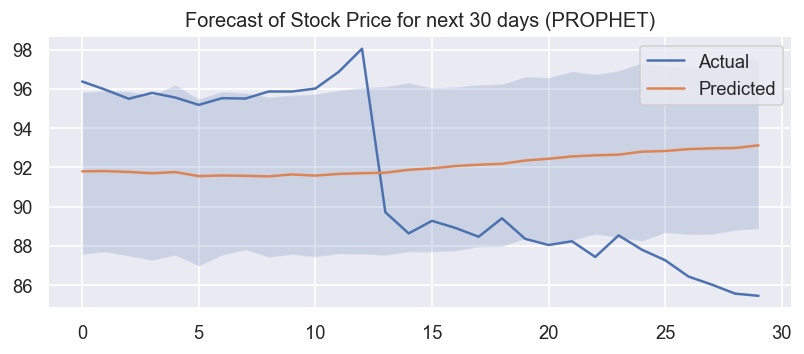

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6600.889, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6607.299, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6599.981, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6599.512, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6605.672, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6600.224, Time=0.26 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6597.243, Time=0.93 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6598.930, Time=1.60 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=6601.559, Time=0.41 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=6599.464, Time=0.34 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6602.750, Time=0.95 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=6598.509, Time=1.20 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=6595.688, Time=0.37 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=6598.573, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0]          

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


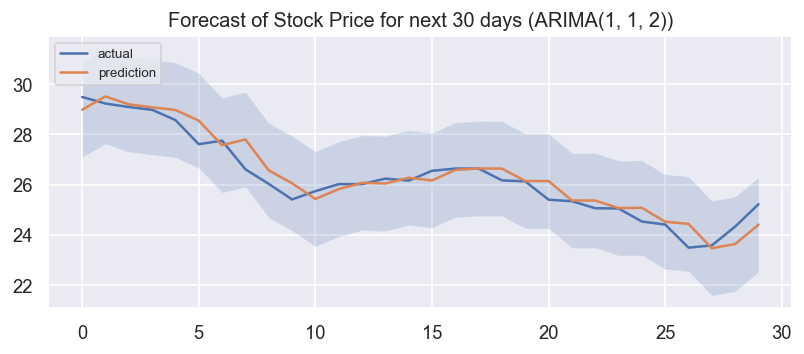

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -48.1522
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6644.56     0.0182514       3552.29      0.8495      0.8495      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7206.96      0.295706       1542.73           1           1      220   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7326.9    0.00664792       425.298      0.8129      0.8129      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7420.37     0.0601653       765.897           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     421       7447.53   0.000217109       468.374   6.287e-07       0.001      504  LS failed, Hessian reset 
     499        7466.2      0.010428    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  16.744199   12.853082   20.859530    16.744199    16.744199   
1  2017-10-03  16.689849   12.941323   20.977112    16.689849    16.689849   
2  2017-10-04  16.635500   12.892318   20.651424    16.635500    16.635500   
3  2017-10-05  16.581150   12.971857   21.101919    16.581150    16.581150   
4  2017-10-06  16.526801   12.779910   20.398929    16.526801    16.526801   
5  2017-10-09  16.363752   12.390481   19.666929    16.363752    16.363752   
6  2017-10-10  16.309403   12.488627   19.963083    16.309403    16.309403   
7  2017-10-11  16.255053   11.954873   19.826054    16.255053    16.255053   
8  2017-10-12  16.200704   11.643896   19.986814    16.200704    16.200704   
9  2017-10-13  16.146354   11.788883   19.937954    16.146354    16.146354   
10 2017-10-16  15.983306   11.625060   18.762609    15.983306    15.983306   
11 2017-10-17  15.928956   11.531853   19.211088    15.928956   

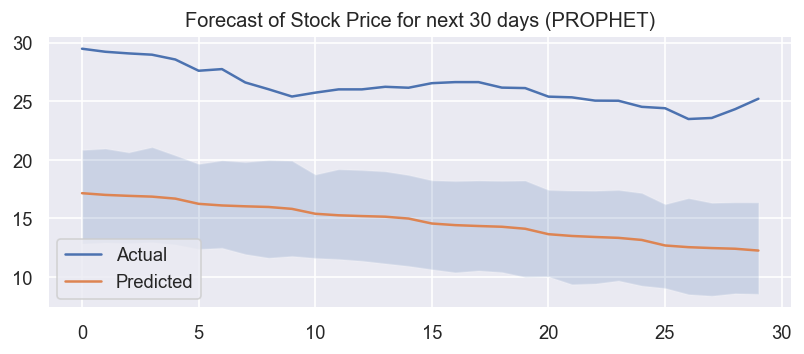

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2290.393, Time=0.79 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2292.735, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2290.438, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2290.475, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2291.897, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2291.713, Time=1.12 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2292.343, Time=0.60 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2292.434, Time=0.29 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2292.366, Time=0.18 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2298.058, Time=0.68 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2289.589, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2289.729, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2289.690, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2290.944, Time=0.37 sec
 ARIMA(1,1,2)(0,0,0)[0]          

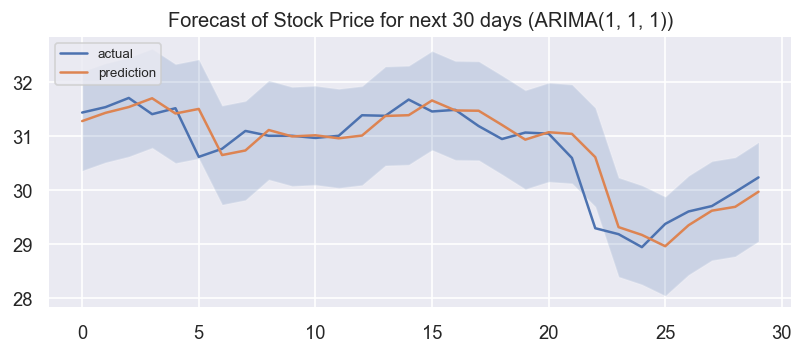

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -36.0929
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        7062.5     0.0128414       1725.36       0.751       0.751      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        7331.7    0.00457132       428.363           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7495.72     0.0300383       1394.96       1.136      0.1136      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7588.07    0.00556778       904.828      0.4477      0.4477      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7609.75     0.0307037       873.767           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  27.171331   25.927529   29.182348    27.171331    27.171331   
1  2017-10-03  27.168655   25.867177   29.074408    27.168655    27.168655   
2  2017-10-04  27.165980   25.771912   29.093146    27.165980    27.165980   
3  2017-10-05  27.163304   25.731008   29.115309    27.163304    27.163304   
4  2017-10-06  27.160628   25.695171   29.157724    27.160628    27.160628   
5  2017-10-09  27.152601   25.641774   28.962750    27.152601    27.152601   
6  2017-10-10  27.149925   25.653458   28.855533    27.149925    27.149925   
7  2017-10-11  27.147249   25.595911   28.945704    27.147249    27.147249   
8  2017-10-12  27.144573   25.634927   28.909378    27.144573    27.144573   
9  2017-10-13  27.141897   25.655572   28.849429    27.141897    27.141897   
10 2017-10-16  27.133870   25.645785   28.943479    27.133870    27.133870   
11 2017-10-17  27.131194   25.584986   28.800688    27.131194   

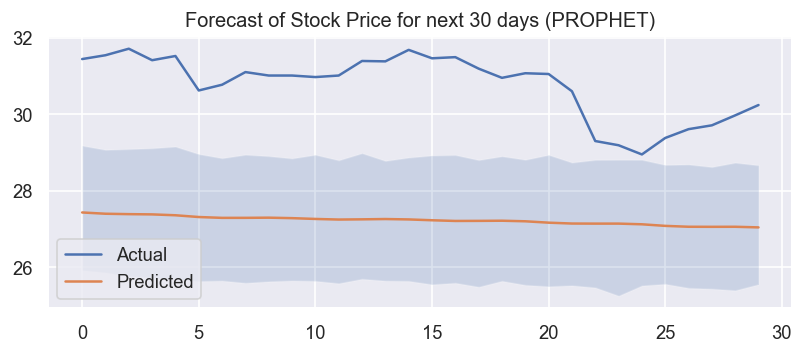

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1503.045, Time=0.91 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1504.935, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1506.886, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1506.883, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1503.512, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1503.813, Time=0.85 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1503.804, Time=1.48 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1506.472, Time=0.35 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1506.614, Time=0.20 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1510.561, Time=1.83 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=1501.608, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=1505.455, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=1505.458, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=1502.399, Time=0.40 sec
 ARIMA(1,1,2)(0,0,0)[0]          

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


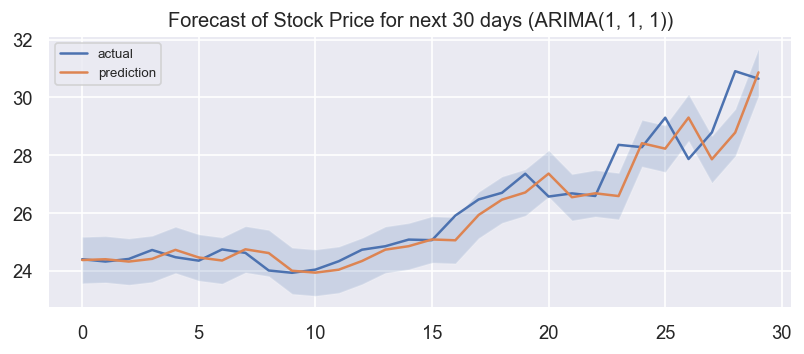

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -282.733
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6554.62     0.0141233       1173.86      0.2715           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6785.26     0.0585152        1254.3           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6848.57    0.00557463        1011.1           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        6879.4    0.00105481       462.281      0.3015      0.3015      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     480       6891.67   9.80772e-05       144.261   3.455e-07       0.001      598  LS failed, Hessian reset 
     499       6894.24    0.00193574    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.579322   16.971647   20.343888    17.579322    17.579322   
1  2017-10-03  17.593479   16.980889   20.216962    17.593479    17.593479   
2  2017-10-04  17.607636   16.909625   20.248350    17.607636    17.607636   
3  2017-10-05  17.621793   16.905188   20.357120    17.621793    17.621793   
4  2017-10-06  17.635951   16.945075   20.357327    17.635951    17.635951   
5  2017-10-09  17.678422   16.972616   20.314113    17.678422    17.678422   
6  2017-10-10  17.692580   16.883699   20.262972    17.692580    17.692580   
7  2017-10-11  17.706737   16.933438   20.497047    17.706737    17.706737   
8  2017-10-12  17.720894   16.844541   20.362170    17.720894    17.720894   
9  2017-10-13  17.735051   16.969452   20.366255    17.735051    17.735051   
10 2017-10-16  17.777523   16.970777   20.358091    17.777523    17.777523   
11 2017-10-17  17.791680   16.973452   20.489116    17.791680   

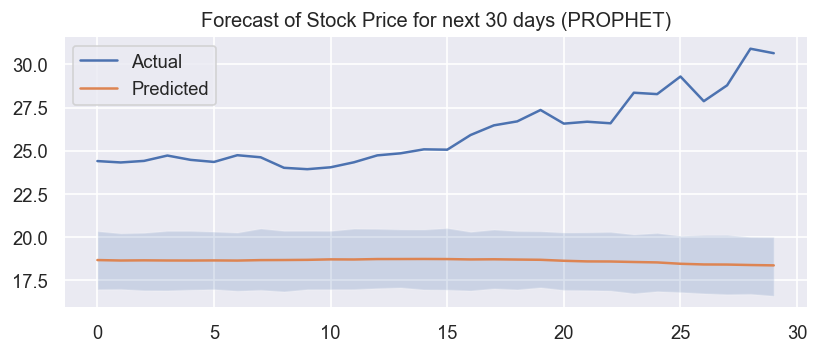

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3129.211, Time=1.14 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3097.403, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3124.189, Time=0.50 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3126.657, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3097.134, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3127.918, Time=1.02 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-3127.808, Time=1.56 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-3128.388, Time=0.40 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3128.369, Time=0.18 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-3125.332, Time=1.28 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3127.836, Time=0.23 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 6.985 seconds


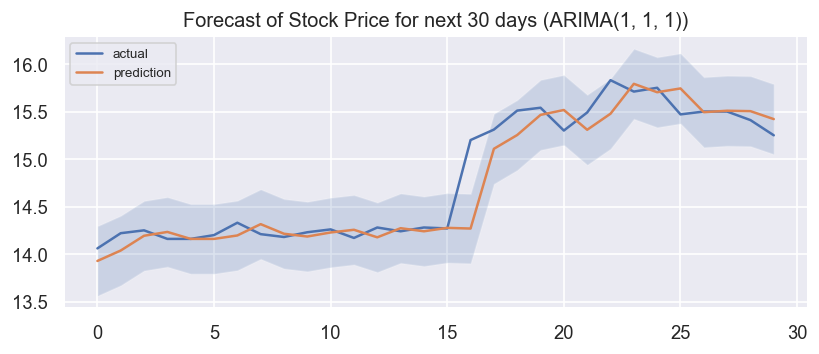

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -40.2134
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7953.46     0.0424861       8114.05     0.04341           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8260.88     0.0228192       2481.12           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8338.93     0.0132999        628.11           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8375.23    0.00233175       725.774           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8391.84    0.00140989       253.406           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  12.850842   12.124467   13.271612    12.850842    12.850842   
1  2017-10-03  12.850443   12.092030   13.270523    12.850443    12.850443   
2  2017-10-04  12.850043   12.157991   13.273042    12.850043    12.850043   
3  2017-10-05  12.849644   12.099420   13.189871    12.849644    12.849644   
4  2017-10-06  12.849245   12.092838   13.245574    12.849245    12.849245   
5  2017-10-09  12.848047   11.972328   13.151578    12.848047    12.848047   
6  2017-10-10  12.847647   12.020998   13.233289    12.847647    12.847647   
7  2017-10-11  12.847248   12.051960   13.182655    12.847248    12.847248   
8  2017-10-12  12.846848   12.009161   13.165609    12.846848    12.846848   
9  2017-10-13  12.846449   11.972832   13.174347    12.846449    12.846449   
10 2017-10-16  12.845251   12.031179   13.143226    12.845251    12.845251   
11 2017-10-17  12.844852   11.999512   13.177126    12.844852   

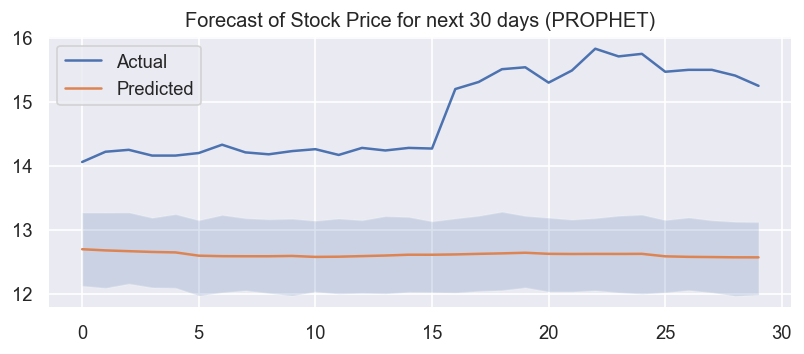

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7659.013, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7664.111, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7657.067, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7657.014, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7662.597, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=7659.012, Time=0.27 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7659.582, Time=1.20 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=7655.561, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=7657.560, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=7657.560, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=7655.610, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=7658.217, Time=0.37 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 2.995 seconds


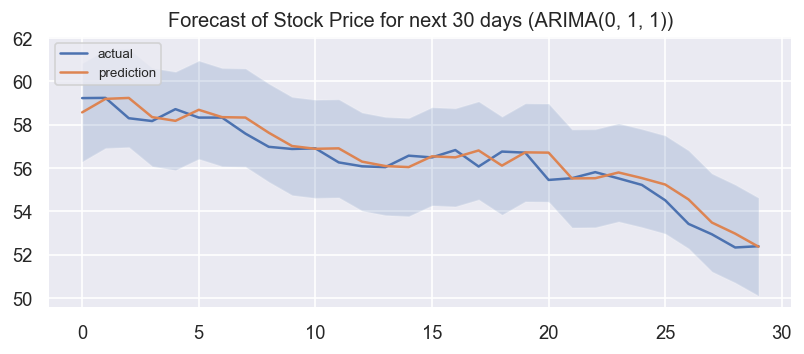

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -58.2015
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5378.73     0.0143313       1243.51      0.3616      0.3616      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5584.38      0.324097       1285.31           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     207       5607.43   0.000415332       339.282    2.08e-06       0.001      264  LS failed, Hessian reset 
     299       5640.88     0.0204029        626.11        0.36           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     355       5652.14   0.000567077       211.585   2.597e-06       0.001      472  LS failed, Hessian reset 
     399       5662.43    0.00239096       236.196      0.2449      0.2449      523   
    Iter      log pro

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  58.376790   52.598967   62.519858    58.376790    58.376790   
1  2017-10-03  58.411995   52.545068   62.873461    58.411995    58.411995   
2  2017-10-04  58.447200   52.479668   62.470218    58.447200    58.447200   
3  2017-10-05  58.482405   52.265053   62.552885    58.482405    58.482405   
4  2017-10-06  58.517610   52.747382   62.724300    58.517610    58.517610   
5  2017-10-09  58.623225   52.085478   62.619291    58.623225    58.623225   
6  2017-10-10  58.658430   52.132789   62.361803    58.658430    58.658430   
7  2017-10-11  58.693635   52.431379   62.220779    58.693635    58.693635   
8  2017-10-12  58.728840   52.319919   62.481558    58.728840    58.728840   
9  2017-10-13  58.764045   51.776324   62.319164    58.764045    58.764045   
10 2017-10-16  58.869660   52.051458   62.268929    58.869660    58.869660   
11 2017-10-17  58.904865   52.174366   62.206949    58.904865   

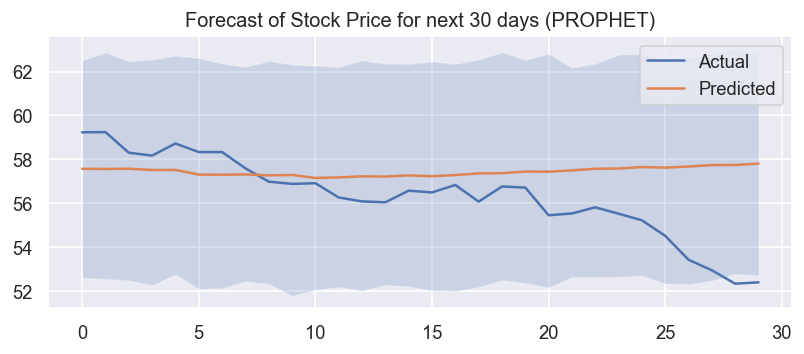

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9098.392, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9094.393, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9096.392, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9096.392, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9092.880, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.620 seconds


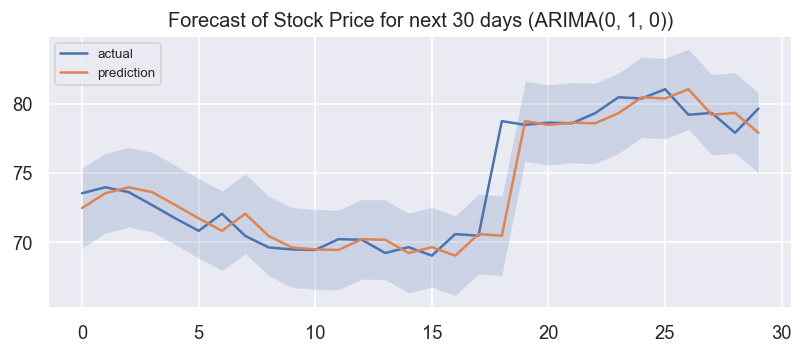

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -38.8339
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6182.3     0.0114065       608.694      0.5362      0.5362      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6247.03     0.0111434       369.392           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6271.84    0.00518223       225.373      0.9783      0.9783      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     305       6272.96   0.000110484       98.2607   5.504e-07       0.001      394  LS failed, Hessian reset 
     399       6277.07    0.00055959       59.4107       0.342           1      526   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6280.39    0.00957758    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  57.103531   52.199949   67.877197    57.103531    57.103531   
1  2017-10-03  57.081672   52.136821   67.485281    57.081672    57.081672   
2  2017-10-04  57.059813   51.731830   67.318032    57.059813    57.059813   
3  2017-10-05  57.037954   51.390673   66.983740    57.037954    57.037954   
4  2017-10-06  57.016095   50.936634   66.869129    57.016095    57.016095   
5  2017-10-09  56.950519   51.176975   67.093981    56.950519    56.950519   
6  2017-10-10  56.928660   50.716538   66.317344    56.928660    56.928660   
7  2017-10-11  56.906801   50.200361   66.983691    56.906801    56.906801   
8  2017-10-12  56.884942   51.047892   67.036048    56.884942    56.884942   
9  2017-10-13  56.863083   49.810648   66.627017    56.863083    56.863083   
10 2017-10-16  56.797506   49.936969   66.795802    56.797506    56.797506   
11 2017-10-17  56.775647   50.340405   66.995814    56.775647   

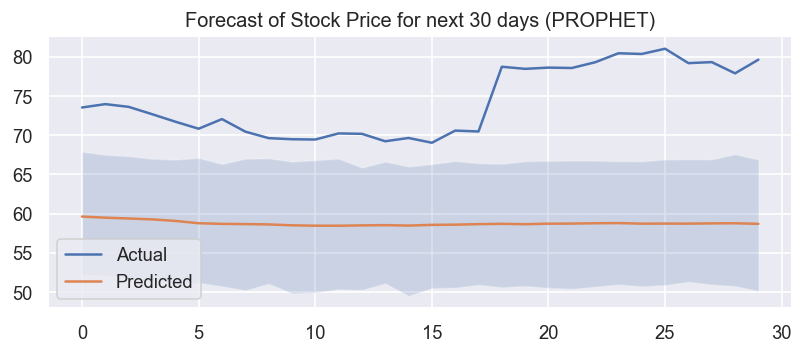

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5672.905, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5668.907, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5670.905, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5670.905, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5666.924, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.794 seconds


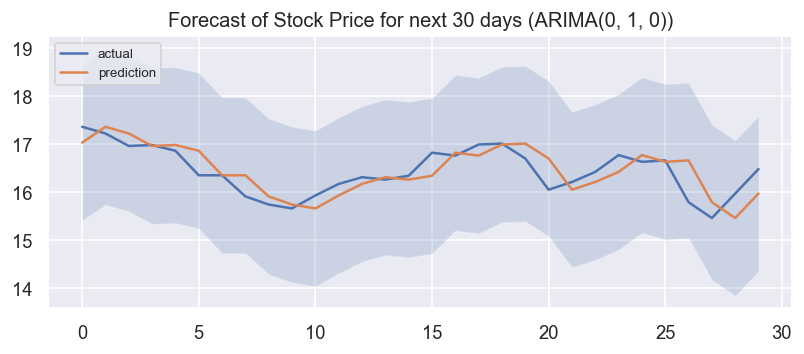

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -100.767
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5581.12     0.0307683       827.013           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       5591.29   0.000178609       163.437   8.405e-07       0.001      190  LS failed, Hessian reset 
     199       5666.36    0.00728606       297.847           1           1      286   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5782.36    0.00472878       551.413           1           1      399   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5827.02    0.00620945       298.339           1           1      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5855.61   0.000288871    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  11.730546    8.552503   14.920695    11.730546    11.730546   
1  2017-10-03  11.723530    8.871674   14.849621    11.723530    11.723530   
2  2017-10-04  11.716515    8.893972   14.761543    11.716515    11.716515   
3  2017-10-05  11.709499    8.749324   14.979693    11.709499    11.709499   
4  2017-10-06  11.702484    8.673086   14.885782    11.702484    11.702484   
5  2017-10-09  11.681438    8.679625   14.388056    11.681438    11.681438   
6  2017-10-10  11.674422    8.526293   14.609001    11.674422    11.674422   
7  2017-10-11  11.667407    8.766822   14.661190    11.667407    11.667407   
8  2017-10-12  11.660391    8.472417   14.505657    11.660391    11.660391   
9  2017-10-13  11.653376    8.640917   14.457583    11.653376    11.653376   
10 2017-10-16  11.632329    8.687211   14.555445    11.632329    11.632329   
11 2017-10-17  11.625314    8.845656   14.732324    11.625314   

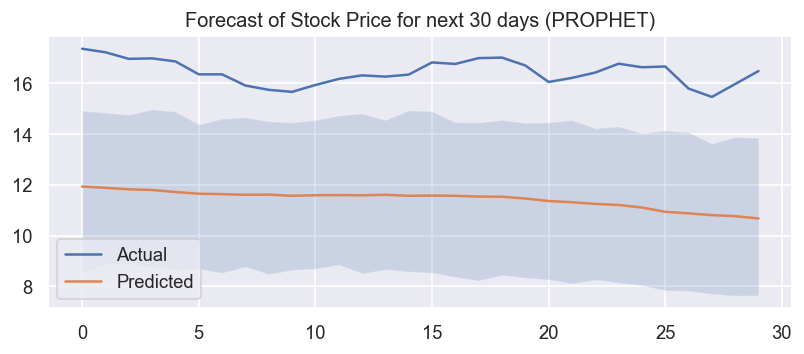

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7320.707, Time=0.97 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7321.818, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7323.349, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7323.320, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7319.823, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.518 seconds


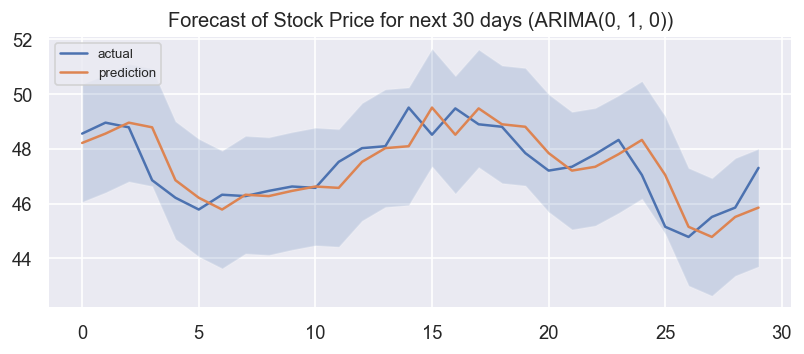

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -66.5021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6023.91    0.00685405       808.416           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6274.05        0.2121       2565.84           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6345.18      0.099223       618.929           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6374.97    0.00359299       148.237           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        6384.8    0.00255515       166.584      0.8958      0.8958      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  52.195969   45.633097   55.530793    52.195969    52.195969   
1  2017-10-03  52.197506   45.478981   55.964256    52.197506    52.197506   
2  2017-10-04  52.199043   45.834539   55.748351    52.199043    52.199043   
3  2017-10-05  52.200581   45.146229   55.670290    52.200581    52.200581   
4  2017-10-06  52.202118   45.704322   55.742019    52.202118    52.202118   
5  2017-10-09  52.206730   45.811167   55.783912    52.206730    52.206730   
6  2017-10-10  52.208268   45.589917   55.953385    52.208268    52.208268   
7  2017-10-11  52.209805   45.628815   56.028534    52.209805    52.209805   
8  2017-10-12  52.211342   45.741182   55.787957    52.211342    52.211342   
9  2017-10-13  52.212880   45.744878   56.410570    52.212880    52.212880   
10 2017-10-16  52.217492   45.865083   56.187894    52.217492    52.217492   
11 2017-10-17  52.219029   45.894015   56.491300    52.219029   

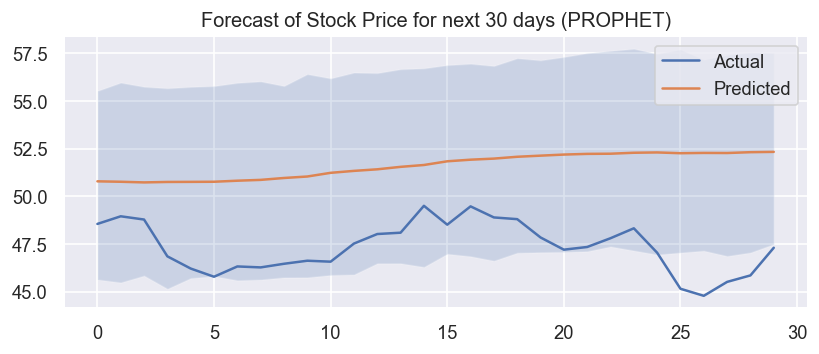

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6824.313, Time=0.74 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6833.111, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6833.599, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6833.517, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6831.273, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6824.150, Time=0.93 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=6833.724, Time=0.21 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=6822.673, Time=0.95 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=6832.717, Time=0.29 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=6812.915, Time=2.50 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6815.319, Time=2.18 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=6814.829, Time=3.12 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=6812.642, Time=1.89 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=6823.756, Time=1.77 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept

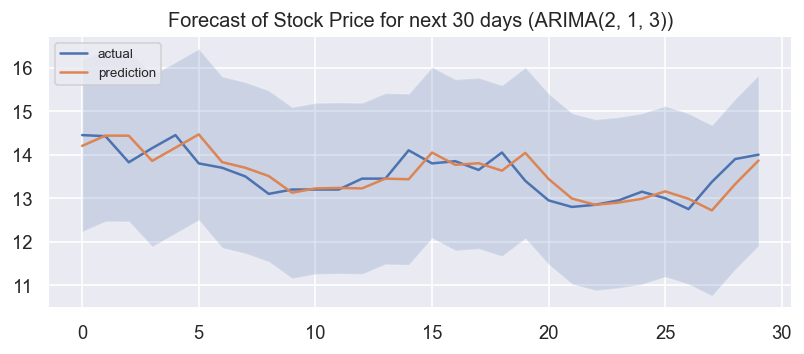

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -146.017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6711.25     0.0301421       475.409           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6770.83    0.00102287       129.753           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6794.93    0.00871985       867.563      0.8029      0.8029      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6806.42   0.000800121         188.8           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     418       6809.24   0.000148536       186.655   9.664e-07       0.001      543  LS failed, Hessian reset 
     499        6812.2   0.000178579    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.570535   16.232715   25.939800    22.570535    22.570535   
1  2017-10-03  22.544957   16.298711   26.129957    22.544957    22.544957   
2  2017-10-04  22.519380   16.098805   25.774647    22.519380    22.519380   
3  2017-10-05  22.493803   15.874100   25.599394    22.493803    22.493803   
4  2017-10-06  22.468225   15.912630   26.160469    22.468225    22.468225   
5  2017-10-09  22.391493   15.902264   25.430496    22.391493    22.391493   
6  2017-10-10  22.365916   15.768879   25.574449    22.365916    22.365916   
7  2017-10-11  22.340339   15.794842   25.493552    22.340339    22.340339   
8  2017-10-12  22.314761   15.853938   25.545089    22.314761    22.314761   
9  2017-10-13  22.289184   15.857283   25.399953    22.289184    22.289184   
10 2017-10-16  22.212452   15.672364   25.338742    22.212452    22.212452   
11 2017-10-17  22.186875   15.895418   25.738189    22.186875   

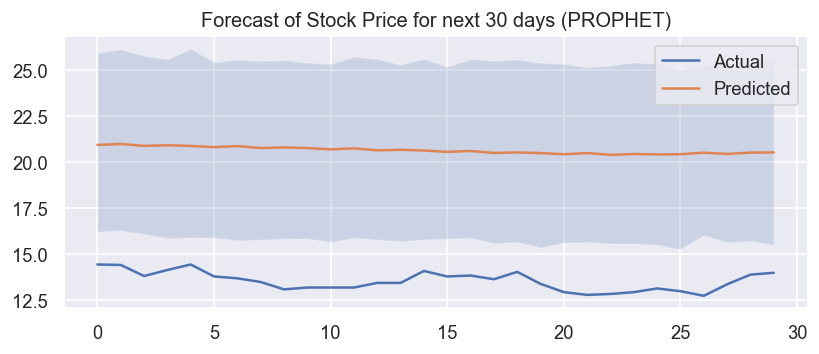

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4189.587, Time=0.51 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4214.354, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4187.791, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4188.773, Time=0.46 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4213.914, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4189.457, Time=0.20 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4191.036, Time=0.82 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4187.690, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=4189.315, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4189.463, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4188.692, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4190.850, Time=0.52 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.350 seconds


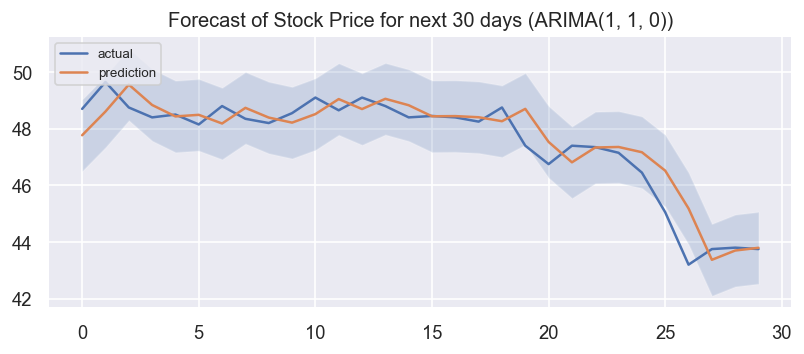

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -178.288
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7086.77     0.0117729       380.989           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7164.28     0.0111691       728.402      0.6914      0.6914      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7199.4     0.0152367       275.383           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7219.39    0.00522474       389.785      0.7551      0.7551      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     484       7233.97   0.000145645       281.177   2.838e-07       0.001      600  LS failed, Hessian reset 
     499       7235.53    0.00140512    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  39.726641   36.525057   42.004184    39.726641    39.726641   
1  2017-10-03  39.748994   36.258858   42.036702    39.748994    39.748994   
2  2017-10-04  39.771348   36.340783   42.094917    39.771348    39.771348   
3  2017-10-05  39.793702   36.216259   41.971957    39.793702    39.793702   
4  2017-10-06  39.816056   36.149834   41.994876    39.816056    39.816056   
5  2017-10-09  39.883117   36.022397   41.748317    39.883117    39.883117   
6  2017-10-10  39.905471   35.928663   41.778687    39.905471    39.905471   
7  2017-10-11  39.927825   35.774573   41.664466    39.927825    39.927825   
8  2017-10-12  39.950178   35.871401   42.061845    39.950178    39.950178   
9  2017-10-13  39.972532   36.184909   41.816814    39.972532    39.972532   
10 2017-10-16  40.039594   35.838499   41.893059    40.039594    40.039594   
11 2017-10-17  40.061947   35.838574   41.638586    40.061947   

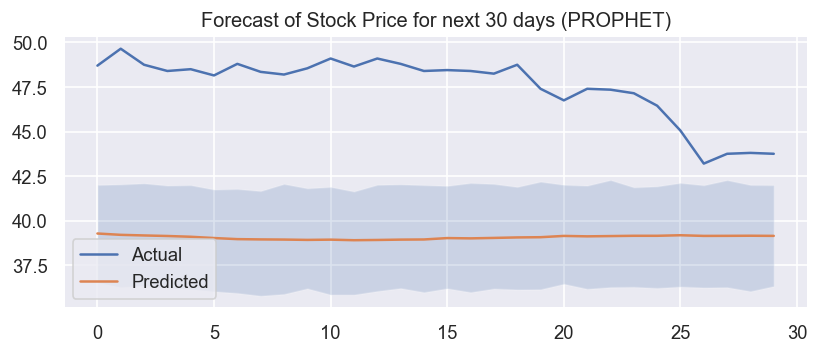

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2630.139, Time=0.30 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=23485.580, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.21 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=19517.527, Time=0.16 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2632.130, Time=0.84 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2632.134, Time=0.53 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=16099.740, Time=0.94 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.29 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2632.002, Time=0.78 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=2631.281, Time=0.79 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 4.878 seconds


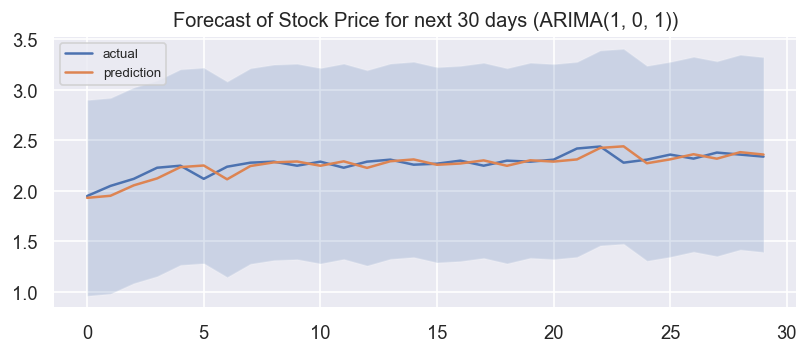

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -235.792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7775.74     0.0141173       1287.84           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7930.08    0.00542111       1205.51           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8208.31      0.121196       3901.39           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8373.37     0.0325873       2866.25           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        8597.9      0.187612       1941.02           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  1.551258    0.496945    3.506435     1.551258     1.551258   
1  2017-10-03  1.551010    0.441819    3.656904     1.551010     1.551010   
2  2017-10-04  1.550762    0.541226    3.436049     1.550762     1.550762   
3  2017-10-05  1.550514    0.562458    3.485416     1.550514     1.550514   
4  2017-10-06  1.550266    0.451000    3.516619     1.550266     1.550266   
5  2017-10-09  1.549522    0.467225    3.350871     1.549522     1.549522   
6  2017-10-10  1.549274    0.593286    3.510454     1.549274     1.549274   
7  2017-10-11  1.549025    0.596434    3.402745     1.549025     1.549025   
8  2017-10-12  1.548777    0.450728    3.473742     1.548777     1.548777   
9  2017-10-13  1.548529    0.564005    3.597475     1.548529     1.548529   
10 2017-10-16  1.547785    0.583476    3.505727     1.547785     1.547785   
11 2017-10-17  1.547537    0.552933    3.541500     1.547537     1.547537   

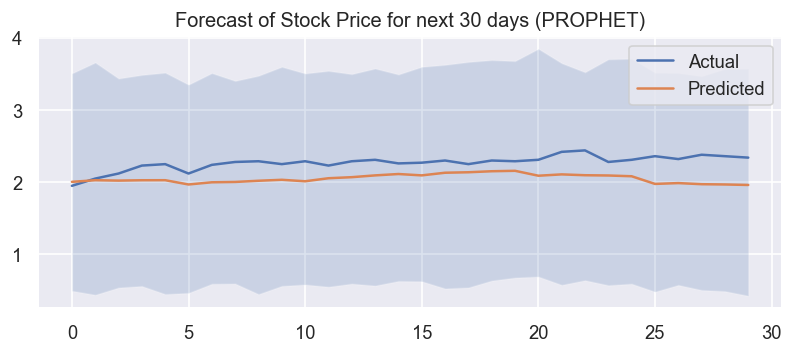

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3300.440, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3296.454, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3298.429, Time=0.19 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3298.429, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3297.471, Time=0.09 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.960 seconds


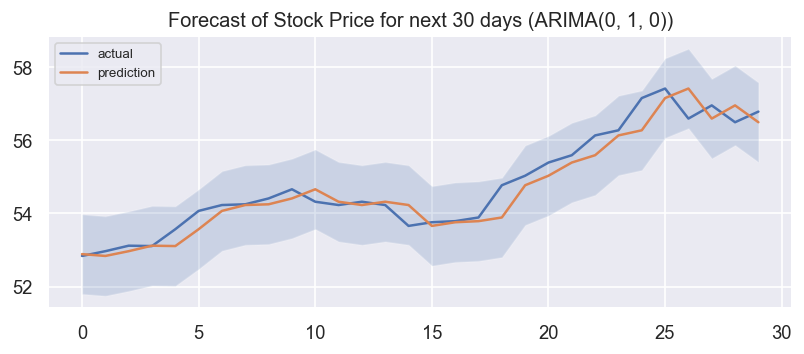

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -51.4565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7626.38     0.0219236        1759.9           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7806.66     0.0146933       1730.89           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7905.1    0.00846679       599.555           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7936.83   0.000281848       158.866           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7947.31    0.00348686       150.458           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  50.484355   46.232585   51.820659    50.484355    50.484355   
1  2017-10-03  50.500538   46.366781   51.743751    50.500538    50.500538   
2  2017-10-04  50.516721   46.247191   51.501781    50.516721    50.516721   
3  2017-10-05  50.532903   46.465699   51.625993    50.532903    50.532903   
4  2017-10-06  50.549086   46.346412   51.722273    50.549086    50.549086   
5  2017-10-09  50.597635   46.304520   51.704464    50.597635    50.597635   
6  2017-10-10  50.613818   46.457851   51.617411    50.613818    50.613818   
7  2017-10-11  50.630001   46.328193   51.601624    50.630001    50.630001   
8  2017-10-12  50.646183   46.416311   51.755088    50.646183    50.646183   
9  2017-10-13  50.662366   46.248391   51.649135    50.662366    50.662366   
10 2017-10-16  50.710915   46.545785   51.692763    50.710915    50.710915   
11 2017-10-17  50.727098   46.355036   51.912704    50.727098   

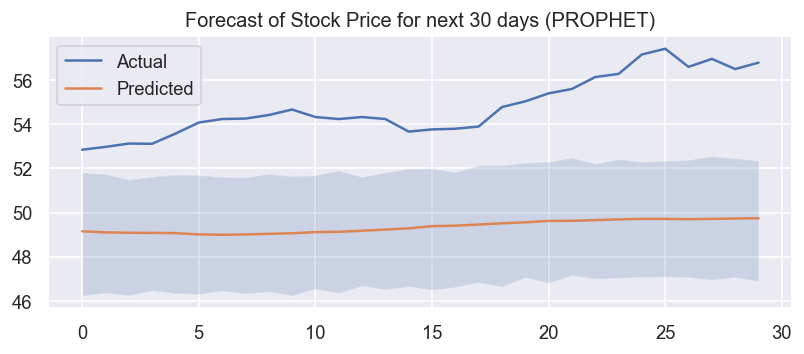

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2110.400, Time=0.73 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2113.232, Time=0.24 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2112.093, Time=0.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2112.323, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2111.759, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2110.960, Time=0.67 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2110.816, Time=0.87 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2109.386, Time=0.39 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=2110.109, Time=0.60 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=2103.612, Time=1.22 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=2103.431, Time=2.59 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2112.561, Time=1.38 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=2103.892, Time=3.07 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=2103.612, Time=2.37 sec
 ARIMA(2,1,3)(0,0,0)[0]          

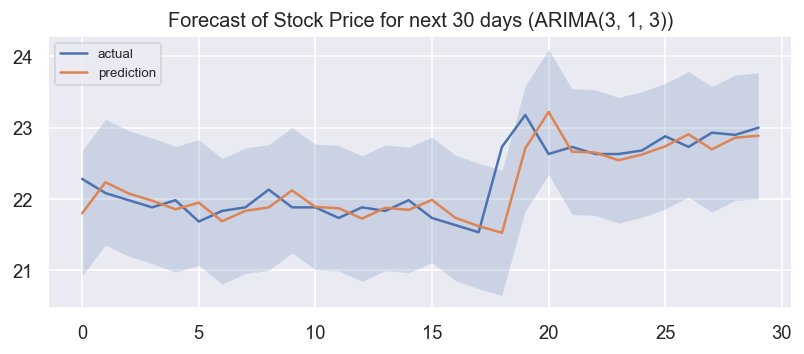

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -35.6718
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5785.52     0.0186513       1085.59           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5988.09     0.0545122       949.878           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6054.13    0.00241967       326.903      0.1318      0.3551      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6100.81    0.00430624       373.692           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6131.79     0.0122623        1524.9           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.217539   15.575446   19.264460    17.217539    17.217539   
1  2017-10-03  17.214852   15.669619   19.344232    17.214852    17.214852   
2  2017-10-04  17.212164   15.506077   19.299380    17.212164    17.212164   
3  2017-10-05  17.209477   15.624158   19.382872    17.209477    17.209477   
4  2017-10-06  17.206789   15.636058   19.465294    17.206789    17.206789   
5  2017-10-09  17.198727   15.532186   19.423604    17.198727    17.198727   
6  2017-10-10  17.196039   15.471668   19.333452    17.196039    17.196039   
7  2017-10-11  17.193352   15.382263   19.328454    17.193352    17.193352   
8  2017-10-12  17.190664   15.433100   19.261403    17.190664    17.190664   
9  2017-10-13  17.187977   15.420855   19.263793    17.187977    17.187977   
10 2017-10-16  17.179914   15.368458   19.230959    17.179914    17.179914   
11 2017-10-17  17.177226   15.211595   19.107598    17.177226   

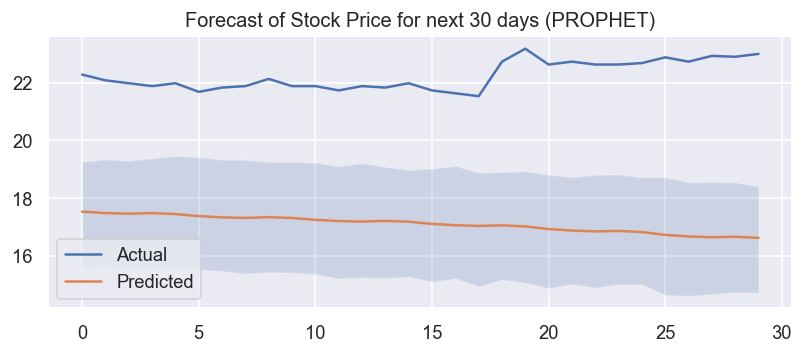

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4813.639, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4813.882, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4811.952, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4811.978, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4812.905, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4813.916, Time=0.16 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4815.924, Time=0.38 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4811.051, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=4813.007, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4812.711, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4811.079, Time=0.06 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4814.226, Time=0.38 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.507 seconds


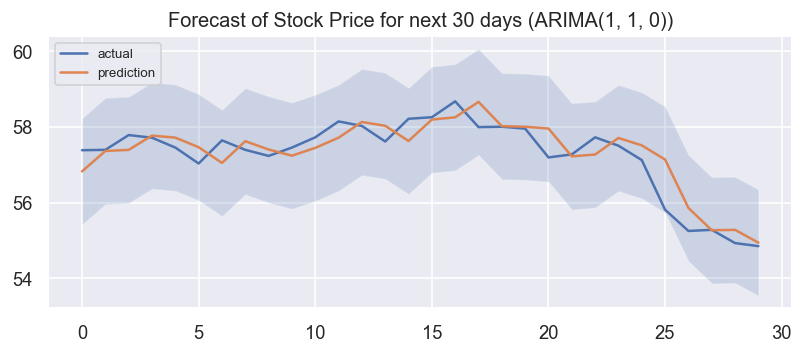

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -78.1014
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6477.32      0.175478       1751.38           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6565.96    0.00975171       586.389           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6616.1     0.0389743       798.061           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        6665.1    0.00126543       195.593      0.2777           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6674.88   0.000638054       123.705           1           1      594   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  52.490652   48.079512   55.735628    52.490652    52.490652   
1  2017-10-03  52.505835   47.195896   55.357117    52.505835    52.505835   
2  2017-10-04  52.521018   47.721437   55.776058    52.521018    52.521018   
3  2017-10-05  52.536201   47.357615   55.131851    52.536201    52.536201   
4  2017-10-06  52.551383   47.730556   55.453537    52.551383    52.551383   
5  2017-10-09  52.596932   47.532659   55.254998    52.596932    52.596932   
6  2017-10-10  52.612114   47.484876   55.005651    52.612114    52.612114   
7  2017-10-11  52.627297   47.534922   55.302322    52.627297    52.627297   
8  2017-10-12  52.642480   47.681729   55.390120    52.642480    52.642480   
9  2017-10-13  52.657663   47.863840   55.399957    52.657663    52.657663   
10 2017-10-16  52.703211   47.630495   55.453597    52.703211    52.703211   
11 2017-10-17  52.718394   47.548758   55.357976    52.718394   

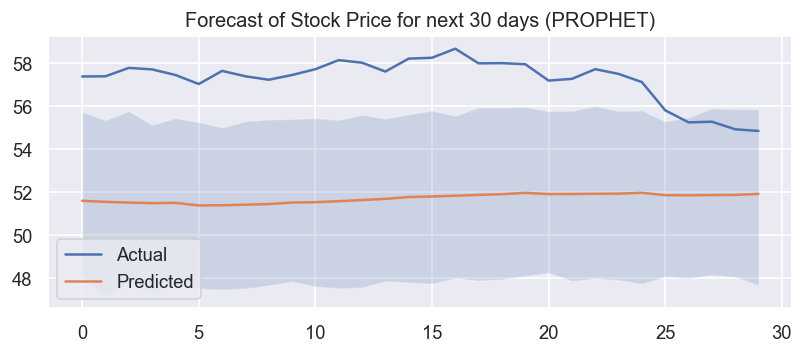

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8654.837, Time=0.45 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8662.133, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8653.113, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8652.887, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8660.749, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=8654.776, Time=0.22 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=8640.495, Time=1.00 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=8647.015, Time=1.12 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=8648.800, Time=0.99 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=8652.739, Time=0.30 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=8640.342, Time=1.26 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=8654.515, Time=0.17 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=8648.601, Time=0.89 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=8652.369, Time=0.23 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


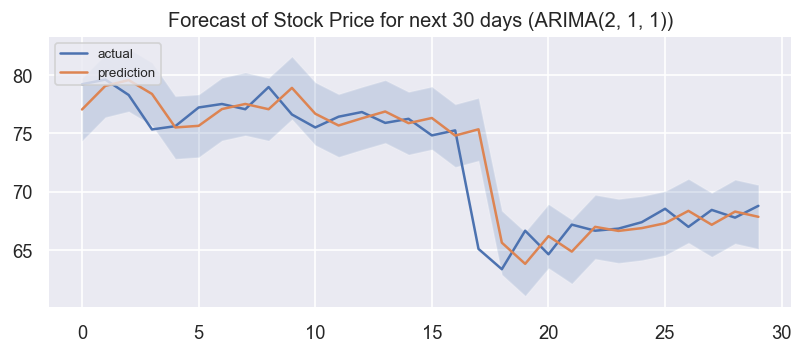

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -106.493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6663.76     0.0787583       5387.78           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6838.64     0.0334945       1149.28           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6888.09    7.7154e-05        59.706           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6898.41     0.0112684       677.131      0.3133           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6901.24   0.000186576        47.865           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  82.515490   72.879639   87.665059    82.515490    82.515490   
1  2017-10-03  82.586125   72.595698   87.186598    82.586125    82.586125   
2  2017-10-04  82.656760   73.236317   87.613642    82.656760    82.656760   
3  2017-10-05  82.727395   73.055800   87.611482    82.727395    82.727395   
4  2017-10-06  82.798030   73.295248   88.201072    82.798030    82.798030   
5  2017-10-09  83.009934   73.680396   88.086217    83.009934    83.009934   
6  2017-10-10  83.080569   74.070938   88.756963    83.080569    83.080569   
7  2017-10-11  83.151204   73.571793   87.925623    83.151204    83.151204   
8  2017-10-12  83.221839   73.804792   87.916910    83.221839    83.221839   
9  2017-10-13  83.292474   74.620196   88.917611    83.292474    83.292474   
10 2017-10-16  83.504379   74.590646   89.040413    83.504379    83.504379   
11 2017-10-17  83.575014   74.941303   89.019230    83.575014   

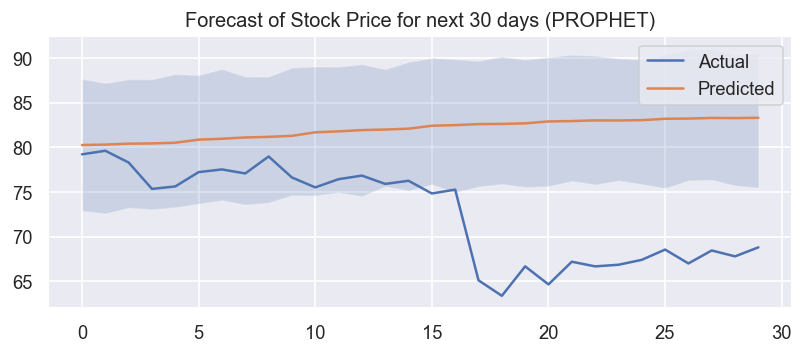

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7787.776, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7795.408, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7791.752, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7791.540, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7796.450, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=7789.659, Time=0.80 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7789.676, Time=0.43 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=7792.355, Time=0.27 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=7792.887, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=7786.097, Time=1.53 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=7787.947, Time=1.06 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=7787.611, Time=1.08 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=7788.266, Time=0.84 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=7787.908, Time=0.71 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept

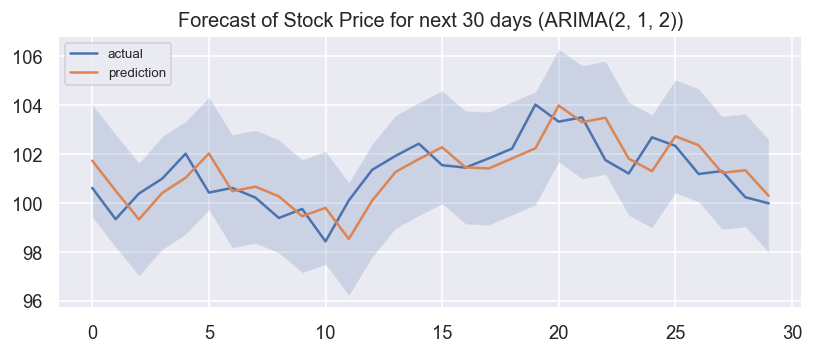

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -66.6432
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7230.32    0.00399332       1013.52      0.3334      0.3334      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        7273.3     0.0518479       740.808           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7294.44   0.000938153       112.486           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7307.49   0.000312581       334.741     0.06095     0.06095      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7314.55   9.31649e-05        69.539      0.1992      0.1992      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  101.402774   92.984809  107.349786   101.402774   101.402774   
1  2017-10-03  101.430588   93.857175  107.209672   101.430588   101.430588   
2  2017-10-04  101.458401   93.823366  107.219898   101.458401   101.458401   
3  2017-10-05  101.486215   93.291692  107.119911   101.486215   101.486215   
4  2017-10-06  101.514028   93.916853  107.660562   101.514028   101.514028   
5  2017-10-09  101.597469   92.837462  107.432456   101.597469   101.597469   
6  2017-10-10  101.625282   93.668909  107.651347   101.625282   101.625282   
7  2017-10-11  101.653096   93.826070  107.224343   101.653096   101.653096   
8  2017-10-12  101.680909   93.591001  107.702157   101.680909   101.680909   
9  2017-10-13  101.708723   93.511529  107.323964   101.708723   101.708723   
10 2017-10-16  101.792163   93.241652  107.042600   101.792163   101.792163   
11 2017-10-17  101.819977   93.660031  107.246332   

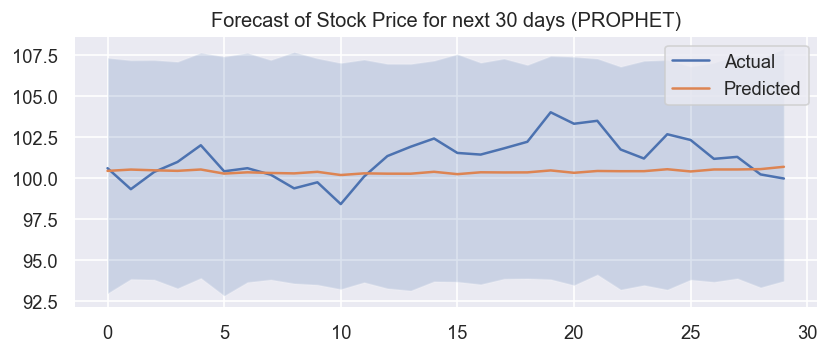

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3207.623, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3210.105, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3205.642, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3205.623, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3208.600, Time=0.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3207.623, Time=0.36 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3209.588, Time=0.62 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=3204.169, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3206.169, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=3206.168, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3204.185, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=3205.681, Time=0.57 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 2.816 seconds


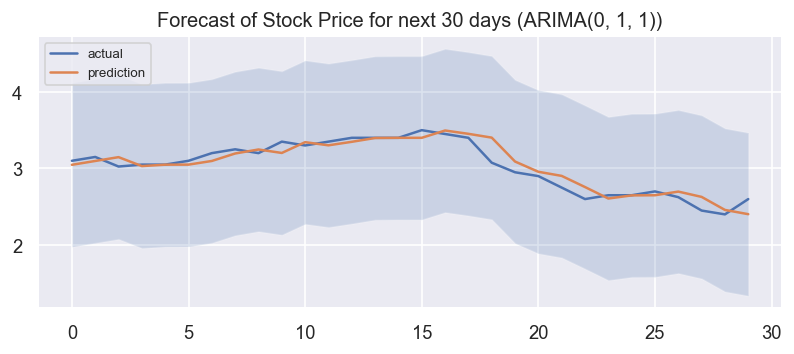

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -32.5879
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6291.45    0.00889243       350.313           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6482.94      0.144216       869.218      0.9818     0.09818      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6538.07      0.011299          1140           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6592.63     0.0043095       322.686           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6617.98     0.0103535       132.356           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  4.073337    3.102817    7.120987     4.073337     4.073337   
1  2017-10-03  4.068811    3.247602    6.993239     4.068811     4.068811   
2  2017-10-04  4.064285    3.084793    7.141669     4.064285     4.064285   
3  2017-10-05  4.059759    3.103319    7.118359     4.059759     4.059759   
4  2017-10-06  4.055232    3.091053    7.096969     4.055232     4.055232   
5  2017-10-09  4.041654    3.180083    6.987105     4.041654     4.041654   
6  2017-10-10  4.037128    3.071837    7.057281     4.037128     4.037128   
7  2017-10-11  4.032602    3.284869    7.135114     4.032602     4.032602   
8  2017-10-12  4.028076    3.207353    7.172295     4.028076     4.028076   
9  2017-10-13  4.023550    3.114904    7.148841     4.023550     4.023550   
10 2017-10-16  4.009971    3.347986    7.181169     4.009971     4.009971   
11 2017-10-17  4.005445    3.296384    7.301665     4.005445     4.005445   

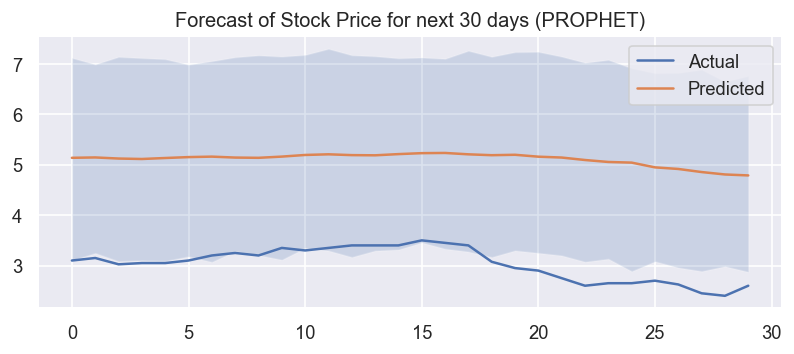

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=5537.618, Time=0.27 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=26954.079, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.17 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=22971.060, Time=0.16 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=5548.486, Time=0.26 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=5539.616, Time=0.39 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=19508.261, Time=0.48 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.29 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=5538.605, Time=0.39 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=5537.738, Time=0.65 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 3.088 seconds


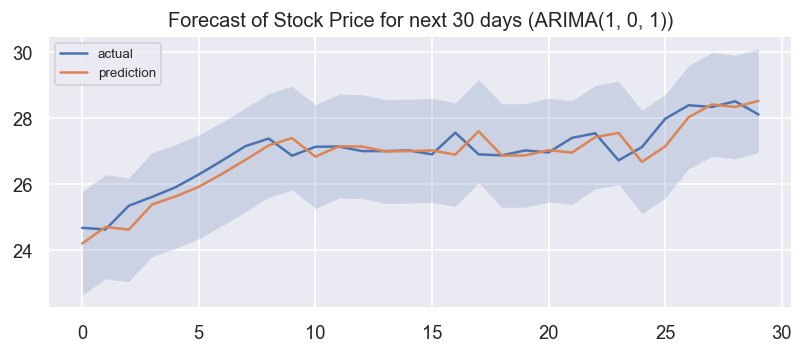

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -239.654
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7572.03     0.0054863        465.32       0.885       0.885      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7757.05     0.0262027       457.528           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7921.61      0.146113       2327.38       2.381      0.2381      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8020.35     0.0025279       428.747           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        8065.2    0.00026934       257.048           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  19.726394   17.042670   22.852754    19.726394    19.726394   
1  2017-10-03  19.735710   16.945927   22.491084    19.735710    19.735710   
2  2017-10-04  19.745026   17.011569   22.592820    19.745026    19.745026   
3  2017-10-05  19.754342   17.092365   22.517577    19.754342    19.754342   
4  2017-10-06  19.763658   17.308948   22.789638    19.763658    19.763658   
5  2017-10-09  19.791606   16.916418   22.474193    19.791606    19.791606   
6  2017-10-10  19.800922   16.801524   22.313439    19.800922    19.800922   
7  2017-10-11  19.810238   16.981918   22.486803    19.810238    19.810238   
8  2017-10-12  19.819554   16.938669   22.502164    19.819554    19.819554   
9  2017-10-13  19.828870   16.818956   22.312627    19.828870    19.828870   
10 2017-10-16  19.856817   16.681251   22.005921    19.856817    19.856817   
11 2017-10-17  19.866133   16.827029   22.361321    19.866133   

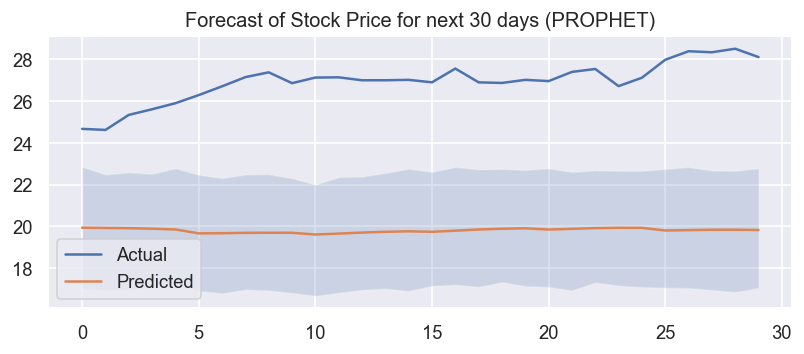

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=98.789, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=107.928, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=100.741, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=99.663, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=106.788, Time=0.17 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=88.005, Time=0.61 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=93.232, Time=0.16 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=89.916, Time=0.98 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=89.895, Time=1.29 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=88.572, Time=0.91 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=90.836, Time=0.29 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=91.676, Time=0.96 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=87.045, Time=0.22 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=97.832, Time=0.19 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=92.312, Time=0.3

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


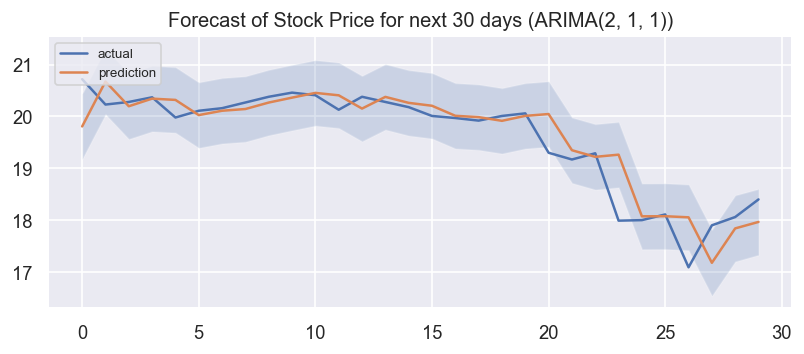

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -139.911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6078.4     0.0956835       1405.59           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        6276.7     0.0485079        481.75           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6370.22     0.0627257       1163.62           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6415.54     0.0399741       694.202      0.5352           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        6435.5    0.00970442       280.013           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.390069   16.022518   18.687255    17.390069    17.390069   
1  2017-10-03  17.399677   15.989804   18.706760    17.399677    17.399677   
2  2017-10-04  17.409285   15.958510   18.736522    17.409285    17.409285   
3  2017-10-05  17.418893   15.936301   18.676673    17.418893    17.418893   
4  2017-10-06  17.428501   15.971874   18.731177    17.428501    17.428501   
5  2017-10-09  17.457325   15.993642   18.747557    17.457325    17.457325   
6  2017-10-10  17.466933   16.003615   18.694795    17.466933    17.466933   
7  2017-10-11  17.476540   15.995995   18.838233    17.476540    17.476540   
8  2017-10-12  17.486148   16.014959   18.836675    17.486148    17.486148   
9  2017-10-13  17.495756   16.104687   18.787172    17.495756    17.495756   
10 2017-10-16  17.524580   16.173900   18.837401    17.524580    17.524580   
11 2017-10-17  17.534188   16.177526   18.895570    17.534188   

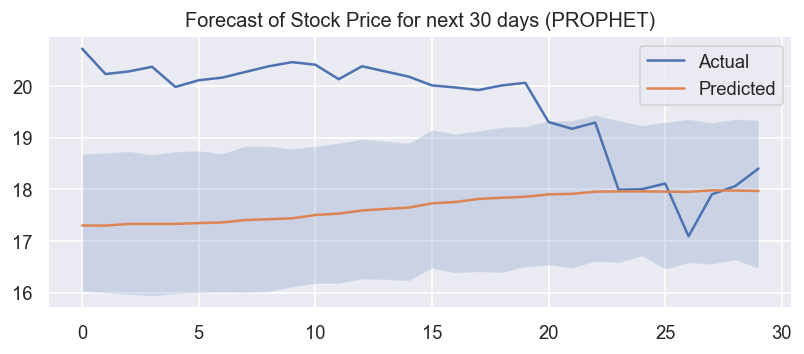

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2936.288, Time=0.75 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2933.640, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2934.989, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2934.939, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2931.717, Time=0.11 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.519 seconds


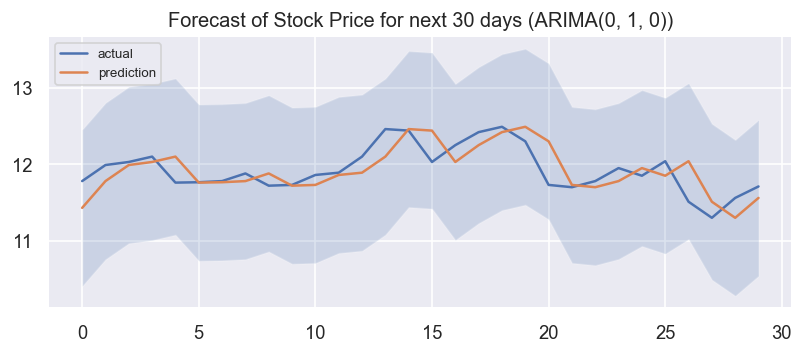

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -74.5201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5476.07      0.224727       2939.49           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5653.58     0.0194755       395.534           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5690.36      0.022251       556.237           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5744.83     0.0305491        1025.5      0.3758           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     443       5753.85   0.000223035       191.155   9.728e-07       0.001      555  LS failed, Hessian reset 
     499       5758.03    0.00047778    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  7.933728    4.479285    9.883144     7.933728     7.933728   
1  2017-10-03  7.916907    4.634857    9.873129     7.916907     7.916907   
2  2017-10-04  7.900086    4.545171    9.834830     7.900086     7.900086   
3  2017-10-05  7.883265    4.793040    9.890829     7.883265     7.883265   
4  2017-10-06  7.866444    4.534998    9.994819     7.866444     7.866444   
5  2017-10-09  7.815982    4.764157    9.863299     7.815982     7.815982   
6  2017-10-10  7.799161    4.801354    9.815709     7.799161     7.799161   
7  2017-10-11  7.782340    4.315334    9.774459     7.782340     7.782340   
8  2017-10-12  7.765519    4.465339    9.787177     7.765519     7.765519   
9  2017-10-13  7.748699    4.185236    9.831793     7.748699     7.748699   
10 2017-10-16  7.698236    4.336944    9.590883     7.698236     7.698236   
11 2017-10-17  7.681415    4.434992    9.675238     7.681415     7.681415   

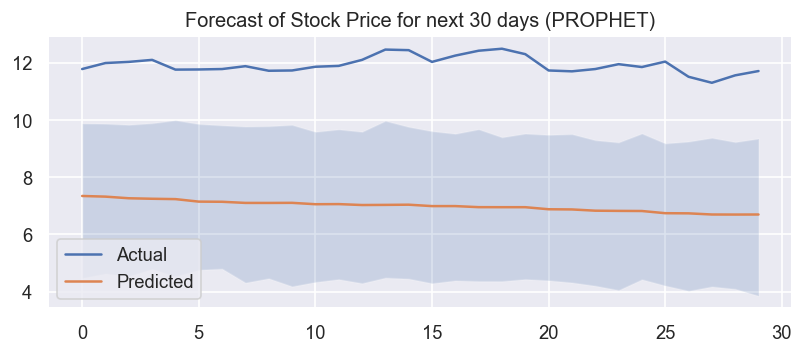

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7649.861, Time=1.01 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7649.781, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7649.727, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7649.611, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7647.806, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.474 seconds


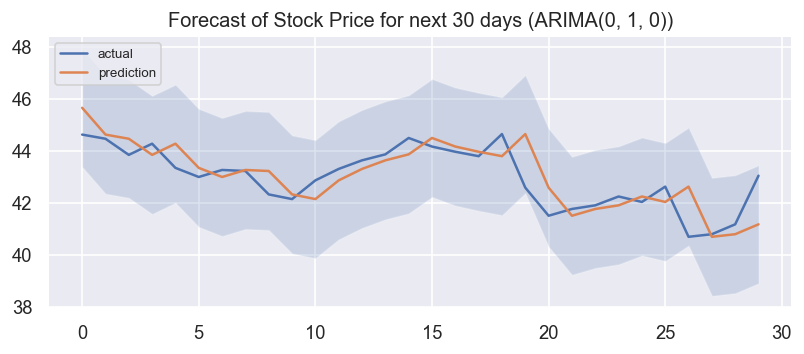

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -21.5342
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6245.2     0.0116061       247.376           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6450.29    0.00396248       770.831      0.2245           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       6496.62   0.000156729       226.256   7.868e-07       0.001      332  LS failed, Hessian reset 
     299        6508.9    0.00553397       280.647           1           1      387   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6528.88     0.0183333        600.51      0.3347      0.3347      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6557.07    0.00312919    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  35.274135   30.889340   40.875457    35.274135    35.274135   
1  2017-10-03  35.254563   30.330685   40.559536    35.254563    35.254563   
2  2017-10-04  35.234992   30.438226   40.519183    35.234992    35.234992   
3  2017-10-05  35.215420   30.161502   40.784292    35.215420    35.215420   
4  2017-10-06  35.195849   30.016068   40.185707    35.195849    35.195849   
5  2017-10-09  35.137134   29.691650   39.916055    35.137134    35.137134   
6  2017-10-10  35.117563   29.540442   39.831466    35.117563    35.117563   
7  2017-10-11  35.097991   29.561400   40.243878    35.097991    35.097991   
8  2017-10-12  35.078420   29.653035   39.328366    35.078420    35.078420   
9  2017-10-13  35.058848   29.089754   39.931703    35.058848    35.058848   
10 2017-10-16  35.000134   29.640940   39.536511    35.000134    35.000134   
11 2017-10-17  34.980563   29.536642   39.582689    34.980563   

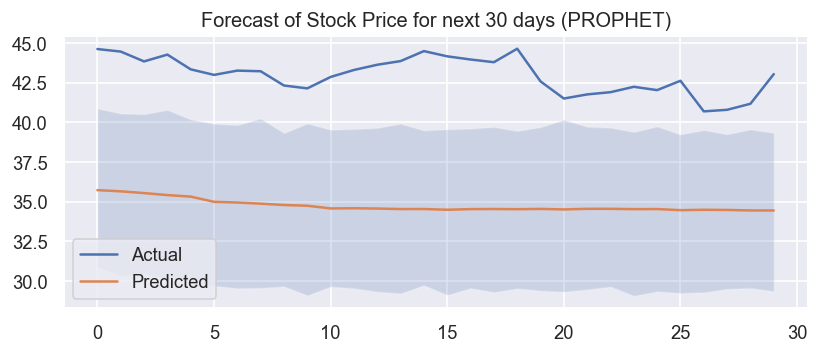

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2934.470, Time=0.55 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3057.895, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2995.055, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3012.739, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3055.912, Time=0.22 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2899.732, Time=0.57 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2897.748, Time=0.28 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=2899.720, Time=0.30 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=2866.075, Time=2.29 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=2857.160, Time=2.20 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2890.504, Time=0.92 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=2858.695, Time=3.49 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=2861.468, Time=2.38 sec
 ARIMA(3,1,2)(0,0,0)[0]             : AIC=2855.196, Time=0.54 sec
 ARIMA(2,1,2)(0,0,0)[0]          

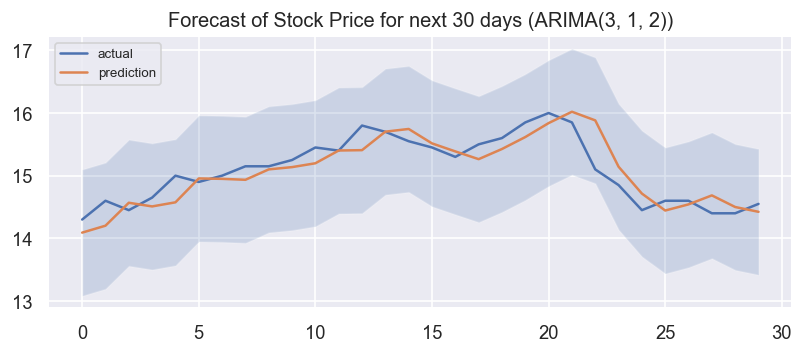

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -76.3105
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7061.33    0.00439809       768.773           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        7159.8     0.0614649       1096.67           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7178.22    0.00065348       418.652      0.4429      0.4429      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7195.26     0.0127356        1089.2      0.4501      0.4501      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     478       7205.54   5.62852e-05       113.928   3.934e-07       0.001      591  LS failed, Hessian reset 
     499       7206.18    0.00371612    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  12.105579   10.899565   14.528093    12.105579    12.105579   
1  2017-10-03  12.107586   10.862488   14.483544    12.107586    12.107586   
2  2017-10-04  12.109593   10.975364   14.574434    12.109593    12.109593   
3  2017-10-05  12.111600   10.976828   14.399925    12.111600    12.111600   
4  2017-10-06  12.113607   11.018615   14.784547    12.113607    12.113607   
5  2017-10-09  12.119628   11.181468   14.744490    12.119628    12.119628   
6  2017-10-10  12.121635   11.276996   14.812015    12.121635    12.121635   
7  2017-10-11  12.123641   11.204157   14.887965    12.123641    12.123641   
8  2017-10-12  12.125648   11.280722   14.940952    12.125648    12.125648   
9  2017-10-13  12.127655   11.285993   14.828037    12.127655    12.127655   
10 2017-10-16  12.133676   11.440851   15.088813    12.133676    12.133676   
11 2017-10-17  12.135683   11.351649   15.053946    12.135683   

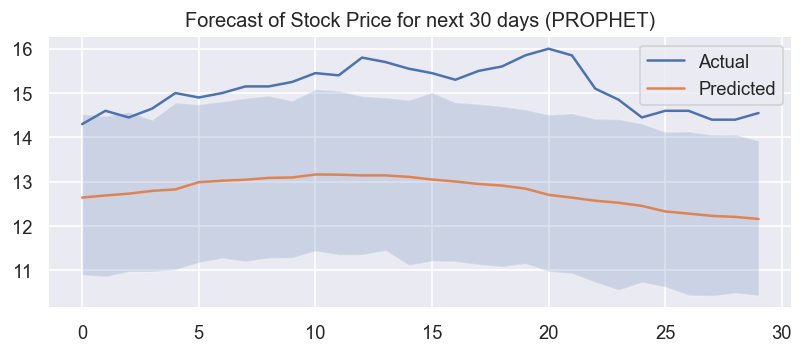

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3268.407, Time=0.95 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3267.631, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3268.080, Time=0.22 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3268.142, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3266.015, Time=0.09 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.639 seconds


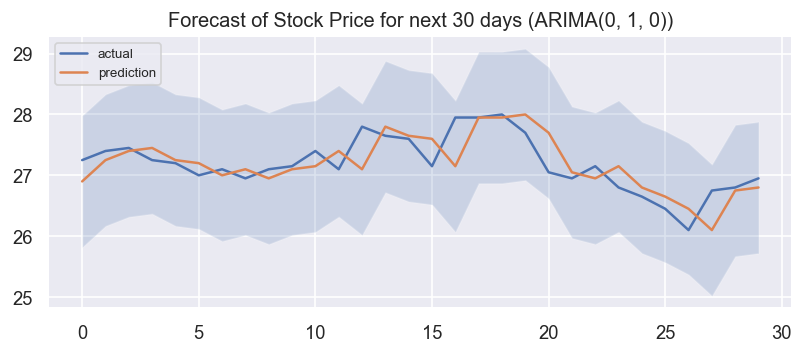

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -64.8786
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6533.98    0.00952978       1422.86      0.2145           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6647.25    0.00289113       336.618       4.449      0.4449      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6786.77      0.181199       999.093           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6824.92    0.00854394       794.162           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     402       6825.89   0.000444875       378.713   2.011e-06       0.001      503  LS failed, Hessian reset 
     499       6837.86   0.000615846    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  28.245449   25.768057   30.473276    28.245449    28.245449   
1  2017-10-03  28.250146   25.954479   30.504264    28.250146    28.250146   
2  2017-10-04  28.254842   25.892997   30.446565    28.254842    28.254842   
3  2017-10-05  28.259539   25.835642   30.216491    28.259539    28.259539   
4  2017-10-06  28.264236   25.891343   30.186726    28.264236    28.264236   
5  2017-10-09  28.278327   25.942733   30.226732    28.278327    28.278327   
6  2017-10-10  28.283024   25.920862   30.264765    28.283024    28.283024   
7  2017-10-11  28.287721   25.794997   30.185640    28.287721    28.287721   
8  2017-10-12  28.292418   25.893311   30.313252    28.292418    28.292418   
9  2017-10-13  28.297115   25.864293   30.094483    28.297115    28.297115   
10 2017-10-16  28.311206   25.769724   30.174695    28.311206    28.311206   
11 2017-10-17  28.315903   25.822828   30.339338    28.315903   

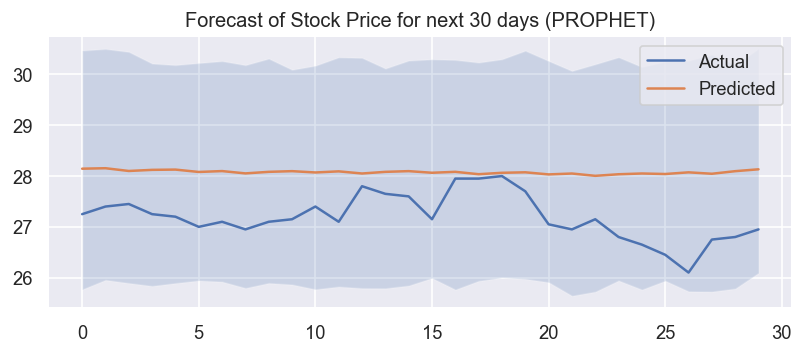

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7591.812, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7598.292, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7590.788, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7591.298, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7599.883, Time=0.04 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=7590.776, Time=0.16 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=7591.920, Time=0.23 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=7592.600, Time=1.38 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=7588.923, Time=0.82 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=7572.941, Time=1.69 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=7571.230, Time=0.97 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7592.246, Time=1.12 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=7572.935, Time=2.10 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=7590.222, Time=0.83 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept

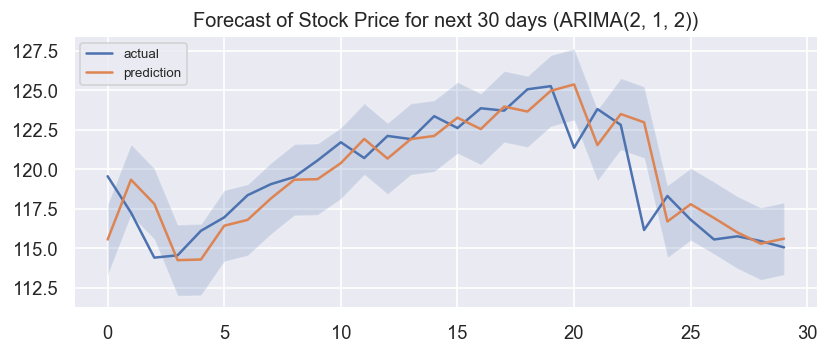

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -154.385
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        7445.2     0.0188522       1263.62           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7601.06     0.0157701        800.74           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7641.49    0.00443289       602.148           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7652.81   0.000301577       205.974           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     426       7655.53   0.000174287       125.491   1.788e-06       0.001      523  LS failed, Hessian reset 
     499       7658.97   0.000794958    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  110.878662  105.799097  118.678858   110.878662   110.878662   
1  2017-10-03  110.949254  105.852144  118.501523   110.949254   110.949254   
2  2017-10-04  111.019846  106.248751  118.548005   111.019846   111.019846   
3  2017-10-05  111.090438  106.707032  118.631284   111.090438   111.090438   
4  2017-10-06  111.161030  106.765135  119.205470   111.161030   111.161030   
5  2017-10-09  111.372805  106.554925  118.799761   111.372805   111.372805   
6  2017-10-10  111.443397  106.260159  119.058405   111.443397   111.443397   
7  2017-10-11  111.513989  106.996496  119.012977   111.513989   111.513989   
8  2017-10-12  111.584581  107.300930  119.651730   111.584581   111.584581   
9  2017-10-13  111.655173  107.046263  119.442125   111.655173   111.655173   
10 2017-10-16  111.866949  107.461159  119.382904   111.866949   111.866949   
11 2017-10-17  111.937541  107.682168  119.172779   

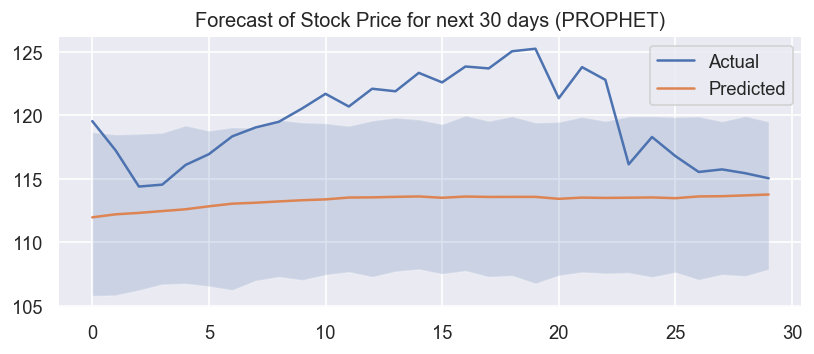

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2874.679, Time=0.81 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2879.851, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2879.190, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2879.310, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2879.671, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2876.514, Time=0.92 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2876.518, Time=1.09 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2879.670, Time=0.25 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2879.521, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2878.453, Time=1.21 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2874.551, Time=0.28 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2879.239, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2879.121, Time=0.07 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2876.413, Time=0.38 sec
 ARIMA(1,1,2)(0,0,0)[0]          

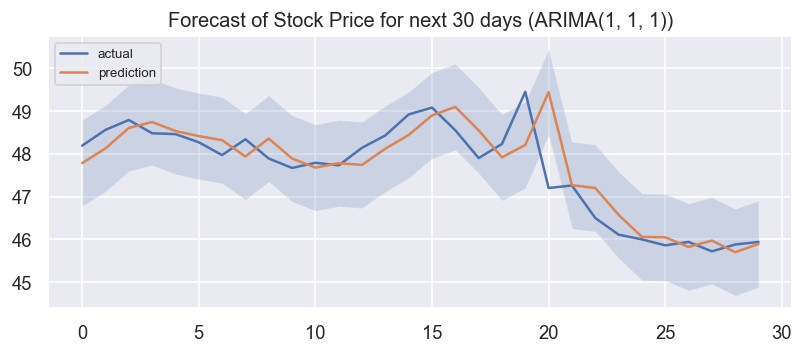

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -55.9657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8127.72      0.171674       4601.29           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8392.33     0.0132002       815.962           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8420.86   0.000550197       241.094        0.75        0.75      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8475.12     0.0690212       2808.64           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     444        8495.8    9.7492e-05       366.001   3.209e-07       0.001      554  LS failed, Hessian reset 
     499       8506.06    0.00226621    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  50.207740   47.607593   51.601474    50.207740    50.207740   
1  2017-10-03  50.216892   47.728022   51.785384    50.216892    50.216892   
2  2017-10-04  50.226043   47.572373   51.578700    50.226043    50.226043   
3  2017-10-05  50.235195   47.690399   51.532637    50.235195    50.235195   
4  2017-10-06  50.244347   47.474310   51.440760    50.244347    50.244347   
5  2017-10-09  50.271803   47.466354   51.473198    50.271803    50.271803   
6  2017-10-10  50.280955   47.685848   51.518524    50.280955    50.280955   
7  2017-10-11  50.290107   47.615385   51.531943    50.290107    50.290107   
8  2017-10-12  50.299258   47.515788   51.480885    50.299258    50.299258   
9  2017-10-13  50.308410   47.441971   51.377778    50.308410    50.308410   
10 2017-10-16  50.335866   47.529326   51.487468    50.335866    50.335866   
11 2017-10-17  50.345018   47.495156   51.457304    50.345018   

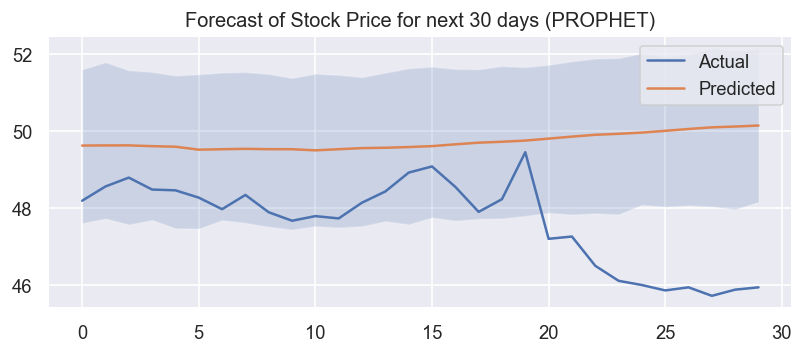

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6426.290, Time=0.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6424.041, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6424.486, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6424.440, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6422.084, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.020 seconds


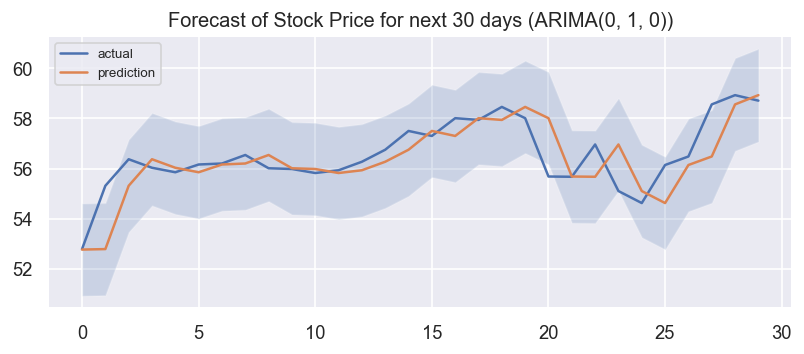

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -316.35
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6655.93    0.00430416       569.213      0.4743      0.4743      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6914.94     0.0125923       1151.07           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7003.91    0.00573172       425.663       0.601       0.601      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7074.21     0.0068305       798.062      0.1953      0.7768      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7110.64    0.00308625       564.347           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  48.803373   44.064193   51.194676    48.803373    48.803373   
1  2017-10-03  48.805418   43.602351   50.939146    48.805418    48.805418   
2  2017-10-04  48.807463   43.755096   50.543781    48.807463    48.807463   
3  2017-10-05  48.809508   43.945048   50.979801    48.809508    48.809508   
4  2017-10-06  48.811553   43.707408   51.021149    48.811553    48.811553   
5  2017-10-09  48.817688   43.680003   50.953132    48.817688    48.817688   
6  2017-10-10  48.819733   43.999664   50.877140    48.819733    48.819733   
7  2017-10-11  48.821778   44.247331   50.788101    48.821778    48.821778   
8  2017-10-12  48.823823   43.961265   50.854488    48.823823    48.823823   
9  2017-10-13  48.825869   44.158294   51.212944    48.825869    48.825869   
10 2017-10-16  48.832004   43.897799   50.823227    48.832004    48.832004   
11 2017-10-17  48.834049   43.876437   51.055359    48.834049   

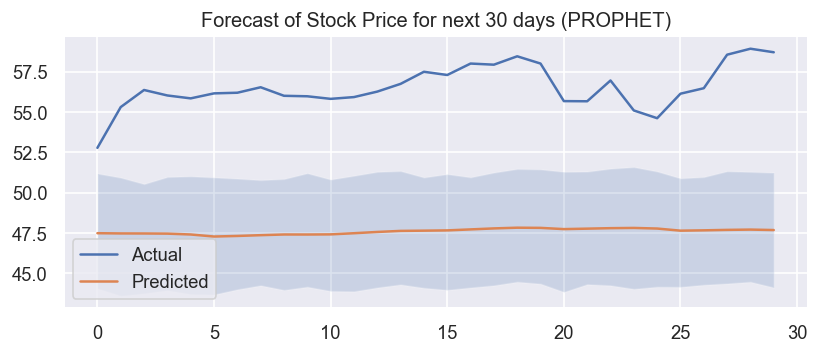

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2100.409, Time=0.96 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2097.609, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2098.448, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2098.433, Time=0.44 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2095.614, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.850 seconds


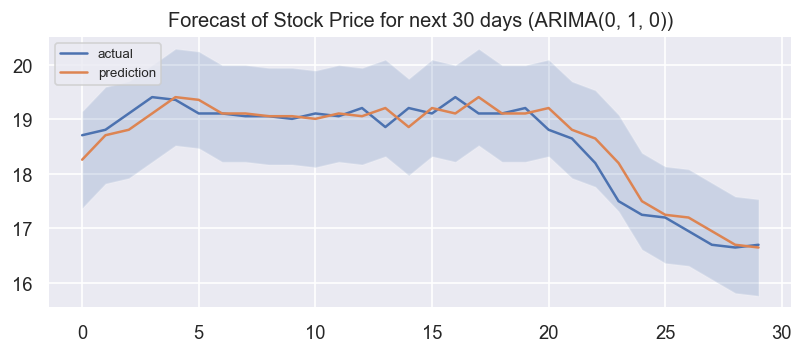

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -109.095
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6343.29    0.00955356       1266.82      0.7486      0.7486      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6699.88     0.0569549       1537.67           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6825.45    0.00741923       404.093      0.7497      0.7497      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6883.45     0.0116941       925.754           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6919.08    0.00111072       150.189           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  16.653166   15.924050   19.385135    16.653166    16.653166   
1  2017-10-03  16.658079   15.884437   19.296015    16.658079    16.658079   
2  2017-10-04  16.662992   16.018740   19.315063    16.662992    16.662992   
3  2017-10-05  16.667906   16.034940   19.359982    16.667906    16.667906   
4  2017-10-06  16.672819   15.801690   19.195851    16.672819    16.672819   
5  2017-10-09  16.687559   15.851788   19.151021    16.687559    16.687559   
6  2017-10-10  16.692472   15.963961   19.302849    16.692472    16.692472   
7  2017-10-11  16.697386   15.955021   19.261290    16.697386    16.697386   
8  2017-10-12  16.702299   15.767208   19.350420    16.702299    16.702299   
9  2017-10-13  16.707212   15.839417   19.238770    16.707212    16.707212   
10 2017-10-16  16.721953   15.882639   19.157020    16.721953    16.721953   
11 2017-10-17  16.726866   15.906674   19.191451    16.726866   

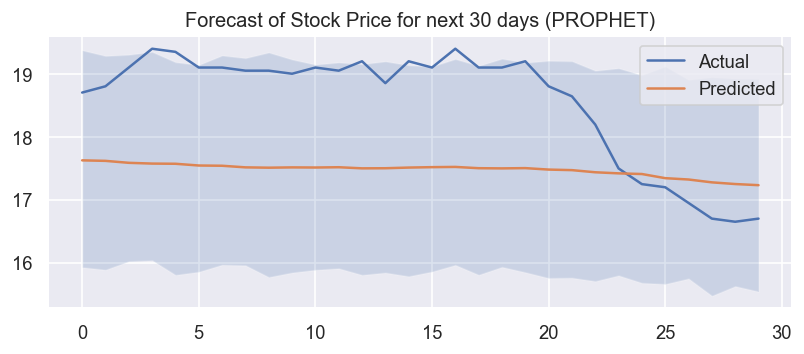

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9605.862, Time=0.67 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9604.194, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9605.885, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9605.872, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9604.052, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.068 seconds


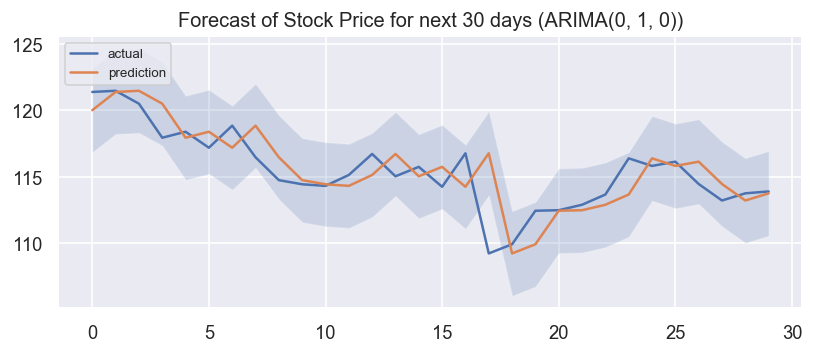

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -138.247
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6941.21     0.0234241       873.121           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7027.46     0.0285704        1656.3           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7075.74    0.00329216       143.042           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357       7079.09   5.65858e-05       105.161   5.898e-07       0.001      467  LS failed, Hessian reset 
     399        7080.5   0.000275979       84.0043           1           1      516   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7081.61   0.000150036    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  89.980439   83.951096  100.839952    89.980439    89.980439   
1  2017-10-03  89.971689   83.989948  101.021466    89.971689    89.971689   
2  2017-10-04  89.962938   83.298798  100.156143    89.962938    89.962938   
3  2017-10-05  89.954188   83.693328  100.146087    89.954188    89.954188   
4  2017-10-06  89.945437   84.307324   99.953156    89.945437    89.945437   
5  2017-10-09  89.919186   83.115075   99.398567    89.919186    89.919186   
6  2017-10-10  89.910436   82.777637   99.390065    89.910436    89.910436   
7  2017-10-11  89.901685   82.634496   99.188810    89.901685    89.901685   
8  2017-10-12  89.892935   82.304189   99.007927    89.892935    89.892935   
9  2017-10-13  89.884185   82.422053   98.465130    89.884185    89.884185   
10 2017-10-16  89.857934   81.621990   97.836583    89.857934    89.857934   
11 2017-10-17  89.849183   81.345773   98.180847    89.849183   

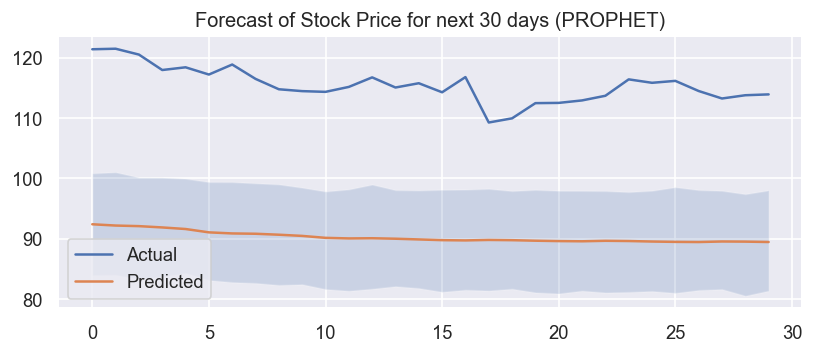

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2081.361, Time=1.45 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2083.184, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2084.470, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2084.452, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2083.976, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2083.359, Time=1.38 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2084.944, Time=0.64 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2086.017, Time=0.37 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2086.057, Time=0.20 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2084.340, Time=1.80 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2083.481, Time=0.28 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 6.880 seconds


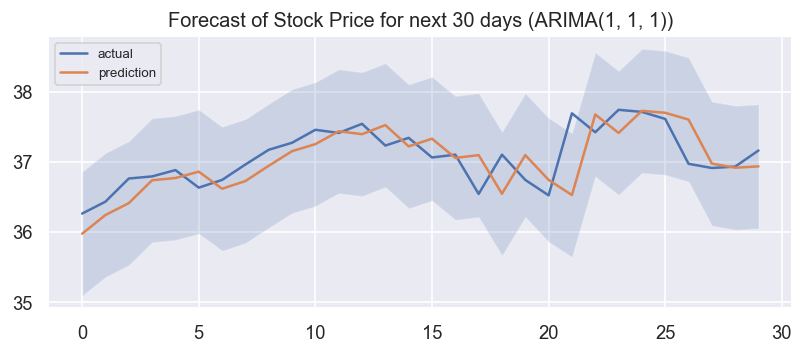

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -21.2145
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7528.41      0.112548       2306.52           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7763.41     0.0179069       2904.32           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7848.86    0.00685208       720.206           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7952.24    0.00776866       957.855      0.5677      0.5677      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7973.62     0.0164476       1831.74           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  33.766253   32.692372   35.801093    33.766253    33.766253   
1  2017-10-03  33.772623   32.759453   35.878504    33.772623    33.772623   
2  2017-10-04  33.778993   32.661077   35.981358    33.778993    33.778993   
3  2017-10-05  33.785363   32.749824   35.835196    33.785363    33.785363   
4  2017-10-06  33.791733   32.702610   35.673436    33.791733    33.791733   
5  2017-10-09  33.810843   32.763317   35.808732    33.810843    33.810843   
6  2017-10-10  33.817214   32.732542   35.802752    33.817214    33.817214   
7  2017-10-11  33.823584   32.664719   35.760227    33.823584    33.823584   
8  2017-10-12  33.829954   32.782449   35.776480    33.829954    33.829954   
9  2017-10-13  33.836324   32.806187   35.883870    33.836324    33.836324   
10 2017-10-16  33.855434   32.723160   35.993994    33.855434    33.855434   
11 2017-10-17  33.861804   32.683536   35.979180    33.861804   

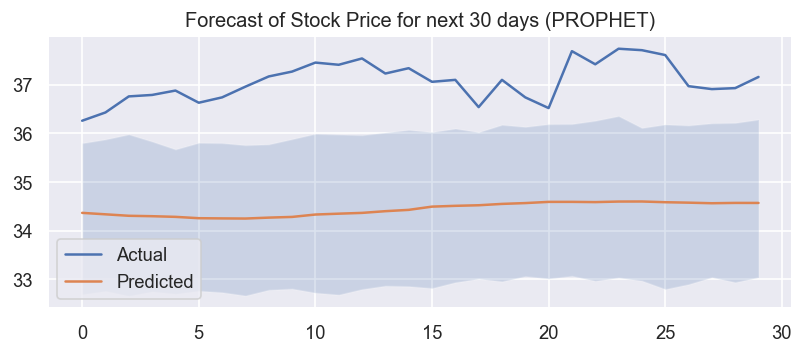

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5639.798, Time=0.62 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5644.977, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5642.147, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5642.001, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5645.107, Time=0.06 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5644.766, Time=0.97 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=5641.719, Time=1.16 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=5643.373, Time=0.28 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5643.488, Time=0.23 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=5642.801, Time=1.62 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=5640.629, Time=0.47 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 5.884 seconds


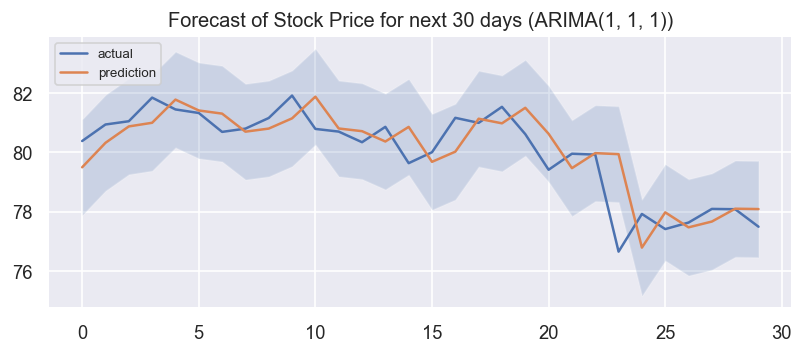

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -86.8374
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8310.77    0.00410743       1273.94           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        8664.9    0.00268076       3428.42      0.5596      0.5596      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        8735.6    0.00113673       1210.53      0.4618      0.4618      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8748.01     0.0146752       1107.15           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8765.17    0.00020752       184.103           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  78.907589   74.433139   80.107445    78.907589    78.907589   
1  2017-10-03  78.920448   74.314491   80.079823    78.920448    78.920448   
2  2017-10-04  78.933308   74.733460   80.222561    78.933308    78.933308   
3  2017-10-05  78.946168   74.495467   80.269199    78.946168    78.946168   
4  2017-10-06  78.959028   74.677426   80.180873    78.959028    78.959028   
5  2017-10-09  78.997608   74.491353   79.944012    78.997608    78.997608   
6  2017-10-10  79.010468   74.530987   80.356563    79.010468    79.010468   
7  2017-10-11  79.023328   74.723323   80.158797    79.023328    79.023328   
8  2017-10-12  79.036188   74.727989   80.252139    79.036188    79.036188   
9  2017-10-13  79.049047   74.790520   80.337099    79.049047    79.049047   
10 2017-10-16  79.087627   74.695475   80.472406    79.087627    79.087627   
11 2017-10-17  79.100487   74.521649   80.324927    79.100487   

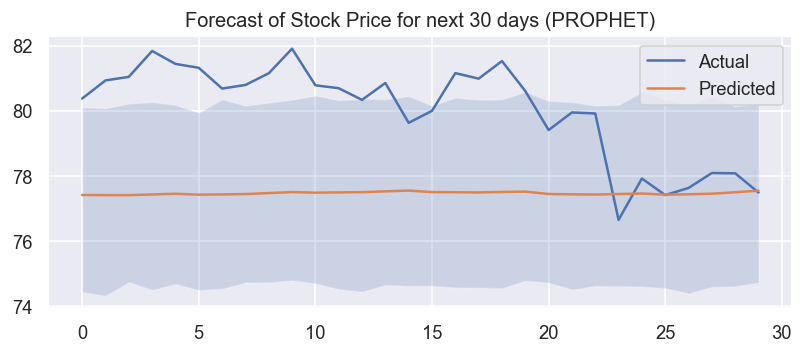

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5758.146, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5754.146, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5756.146, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5756.146, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5752.181, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.747 seconds


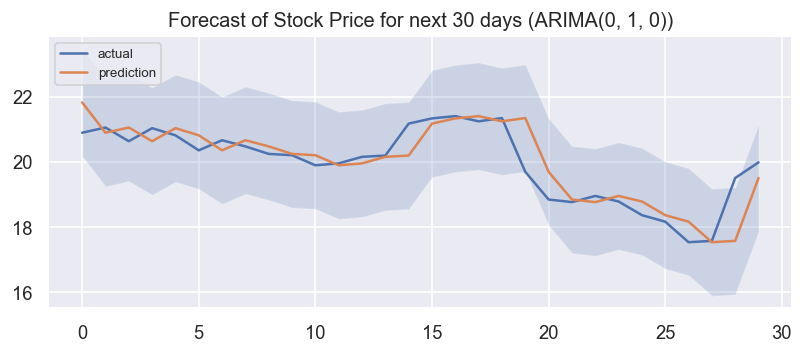

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -84.8956
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6908.04      0.228741       4604.57           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7135.52    0.00329199       242.846      0.2621           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7156.91    0.00459725       584.921           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7168.67     0.0348323       652.046           1           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     405       7169.03   0.000282583       260.136   2.434e-06       0.001      522  LS failed, Hessian reset 
     497       7173.63   9.28596e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  18.397040   14.231230   22.421045    18.397040    18.397040   
1  2017-10-03  18.355549   13.861237   22.161950    18.355549    18.355549   
2  2017-10-04  18.314058   14.120147   21.580343    18.314058    18.314058   
3  2017-10-05  18.272566   13.941395   21.789379    18.272566    18.272566   
4  2017-10-06  18.231075   13.997138   22.118439    18.231075    18.231075   
5  2017-10-09  18.106602   13.704860   21.814811    18.106602    18.106602   
6  2017-10-10  18.065111   13.652105   21.762040    18.065111    18.065111   
7  2017-10-11  18.023620   13.334588   21.405175    18.023620    18.023620   
8  2017-10-12  17.982129   13.389617   21.429198    17.982129    17.982129   
9  2017-10-13  17.940638   13.312202   21.733011    17.940638    17.940638   
10 2017-10-16  17.816165   13.570517   21.057384    17.816165    17.816165   
11 2017-10-17  17.774674   13.320211   21.242223    17.774674   

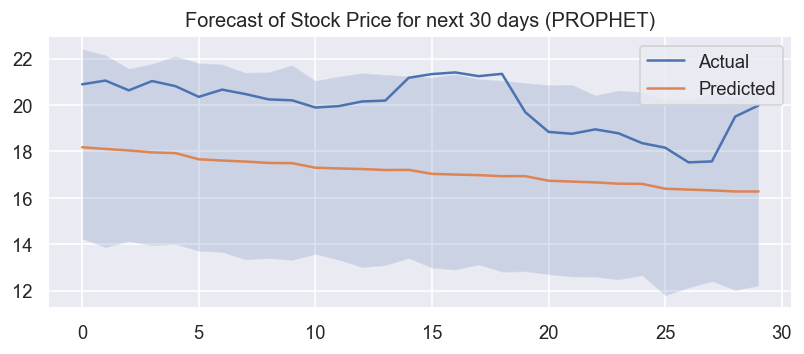

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3736.730, Time=0.52 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3735.139, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3734.735, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3734.731, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3733.508, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.223 seconds


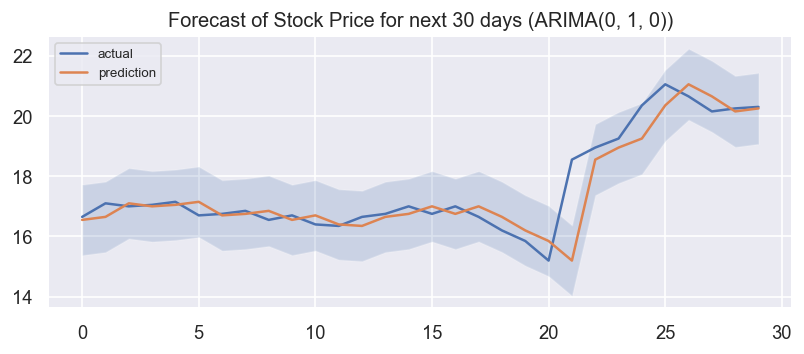

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -187.36
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6777.53     0.0574718        1332.2           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        6975.7     0.0168565       200.117           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7037.35    0.00196109       1397.72      0.6188      0.6188      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7078.92    0.00827221        532.31           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7110.64     0.0243684       676.806           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.902274   14.944550   19.427318    17.902274    17.902274   
1  2017-10-03  17.899770   14.806143   19.345830    17.899770    17.899770   
2  2017-10-04  17.897266   14.779807   19.393614    17.897266    17.897266   
3  2017-10-05  17.894762   14.874472   19.571478    17.894762    17.894762   
4  2017-10-06  17.892258   14.987893   19.391340    17.892258    17.892258   
5  2017-10-09  17.884745   14.925707   19.566995    17.884745    17.884745   
6  2017-10-10  17.882241   14.779053   19.444215    17.882241    17.882241   
7  2017-10-11  17.879737   14.927483   19.425885    17.879737    17.879737   
8  2017-10-12  17.877233   14.961067   19.287468    17.877233    17.877233   
9  2017-10-13  17.874729   14.965087   19.553236    17.874729    17.874729   
10 2017-10-16  17.867217   14.914355   19.314798    17.867217    17.867217   
11 2017-10-17  17.864713   14.835326   19.431832    17.864713   

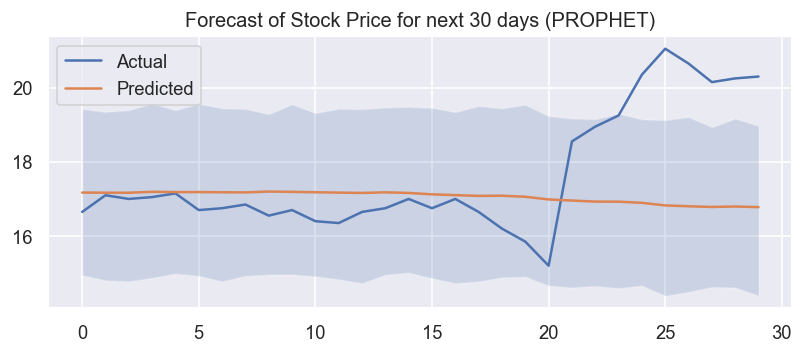

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1154.504, Time=0.49 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1130.350, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1153.011, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1154.854, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1131.881, Time=0.10 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1155.267, Time=0.36 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1154.465, Time=1.47 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=-1154.764, Time=0.47 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-1152.948, Time=1.28 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-1156.632, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1156.257, Time=0.09 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-1155.837, Time=0.34 sec
 ARIMA(0,1,3)(0,0,0)[0]             : AIC=-1156.156, Time=0.19 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1155.872, Time=0.15 sec
 ARIMA(1,1,3)(0,0,0

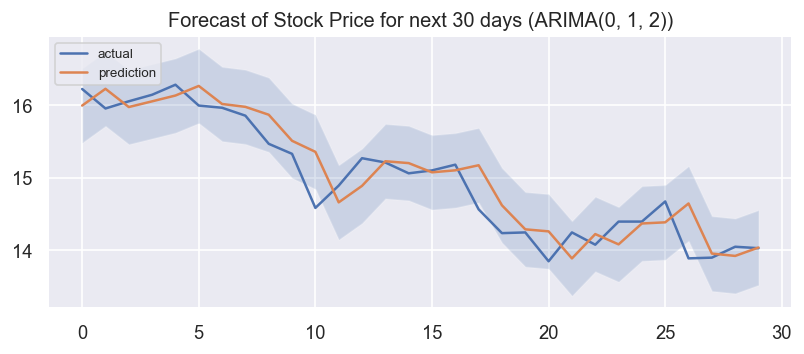

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -194.939
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6649.82     0.0630291       1759.54           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6988.97     0.0123391       788.034           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7074.58    0.00266415       251.402           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     308       7076.68   0.000135848       212.553   2.956e-07       0.001      415  LS failed, Hessian reset 
     399       7084.75    0.00239657       127.991       4.428      0.4428      521   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     496        7097.3   0.000151098    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  13.781573   12.803423   14.836908    13.781573    13.781573   
1  2017-10-03  13.791510   12.864282   14.884543    13.791510    13.791510   
2  2017-10-04  13.801448   12.789197   14.910144    13.801448    13.801448   
3  2017-10-05  13.811385   12.880019   14.828927    13.811385    13.811385   
4  2017-10-06  13.821323   12.885803   14.928659    13.821323    13.821323   
5  2017-10-09  13.851135   12.806739   14.864806    13.851135    13.851135   
6  2017-10-10  13.861072   12.784395   14.940451    13.861072    13.861072   
7  2017-10-11  13.871010   12.741681   14.840660    13.871010    13.871010   
8  2017-10-12  13.880947   12.858911   14.874450    13.880947    13.880947   
9  2017-10-13  13.890885   12.835534   14.849260    13.890885    13.890885   
10 2017-10-16  13.920697   12.838741   14.923226    13.920697    13.920697   
11 2017-10-17  13.930635   12.916079   14.990360    13.930635   

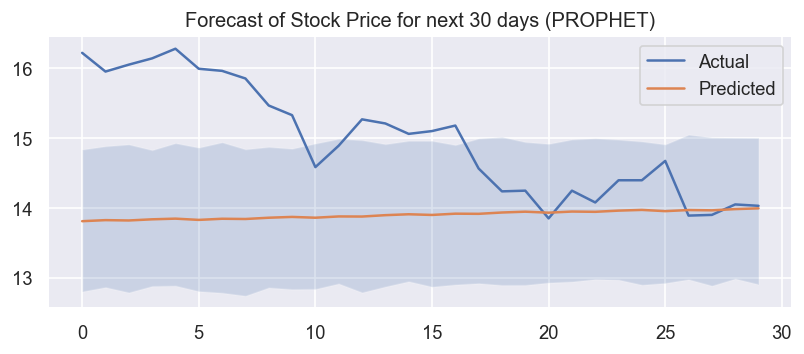

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6829.785, Time=0.69 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6827.753, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6829.533, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6829.526, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6829.359, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.256 seconds


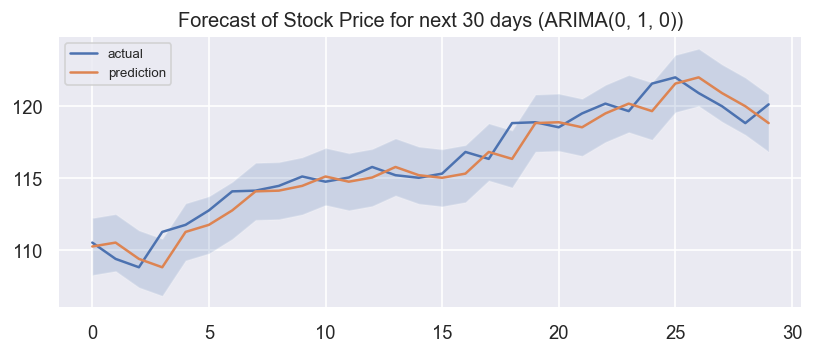

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -106.658
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7097.76     0.0246913       5658.61      0.1622           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7221.11      0.108386        1351.9           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7300.59     0.0758267       614.342      0.9877     0.09877      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7355.73   0.000846079       307.183      0.1334      0.6847      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7375.04    0.00157806       166.195      0.3304      0.3304      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  94.572101   87.086556   98.819735    94.572101    94.572101   
1  2017-10-03  94.607740   87.205176   98.571200    94.607740    94.607740   
2  2017-10-04  94.643380   87.013852   98.476569    94.643380    94.643380   
3  2017-10-05  94.679019   86.948376   98.119435    94.679019    94.679019   
4  2017-10-06  94.714659   86.775236   98.811101    94.714659    94.714659   
5  2017-10-09  94.821577   86.149086   98.026138    94.821577    94.821577   
6  2017-10-10  94.857216   86.183989   97.843589    94.857216    94.857216   
7  2017-10-11  94.892856   86.232820   98.134495    94.892856    94.892856   
8  2017-10-12  94.928495   86.121057   98.252081    94.928495    94.928495   
9  2017-10-13  94.964134   85.684891   97.620735    94.964134    94.964134   
10 2017-10-16  95.071053   86.616100   97.940809    95.071053    95.071053   
11 2017-10-17  95.106692   86.329664   97.844641    95.106692   

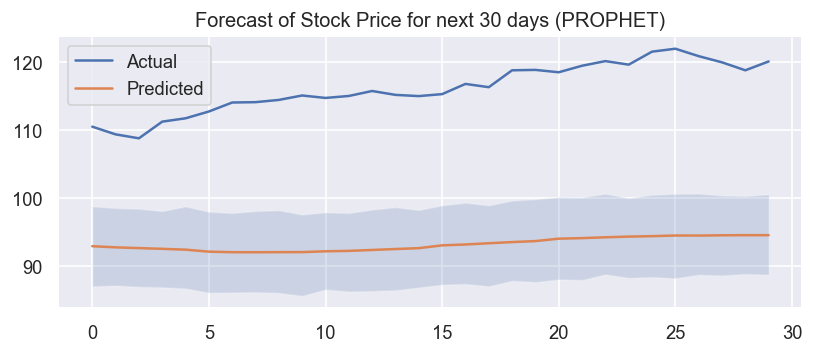

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2707.339, Time=1.12 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2704.982, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2706.784, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2706.779, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2703.018, Time=0.12 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.774 seconds


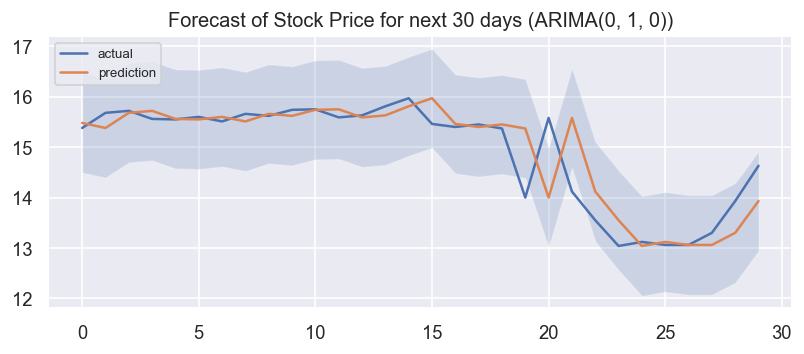

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -107.45
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          6259     0.0356407       1948.72      0.2797     0.02797      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6456.25     0.0010636       345.397           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6496.32     0.0101342       612.897      0.3086           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       6504.72   0.000172297       168.845   1.069e-06       0.001      444  LS failed, Hessian reset 
     399       6508.78    0.00469179       97.0175           1           1      504   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6527.14    0.00216418     

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  24.799832   20.593292   26.773140    24.799832    24.799832   
1  2017-10-03  24.799492   20.937379   26.856301    24.799492    24.799492   
2  2017-10-04  24.799152   20.936718   26.811449    24.799152    24.799152   
3  2017-10-05  24.798813   20.756596   27.000961    24.798813    24.798813   
4  2017-10-06  24.798473   20.851418   26.750478    24.798473    24.798473   
5  2017-10-09  24.797454   20.750171   26.948126    24.797454    24.797454   
6  2017-10-10  24.797114   20.792377   26.971677    24.797114    24.797114   
7  2017-10-11  24.796775   21.032475   26.995860    24.796775    24.796775   
8  2017-10-12  24.796435   20.984184   27.078998    24.796435    24.796435   
9  2017-10-13  24.796095   20.976540   27.159977    24.796095    24.796095   
10 2017-10-16  24.795076   21.378646   27.229156    24.795076    24.795076   
11 2017-10-17  24.794737   21.231381   27.308734    24.794737   

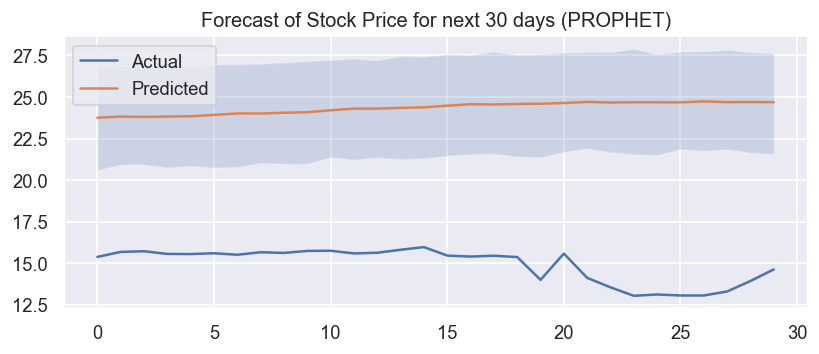

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7100.533, Time=0.43 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7114.626, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7108.246, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7107.331, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7121.361, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=7102.502, Time=1.35 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7102.501, Time=0.83 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=7102.256, Time=0.30 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=7102.891, Time=0.17 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=7104.424, Time=0.76 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=7110.828, Time=0.09 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 4.479 seconds


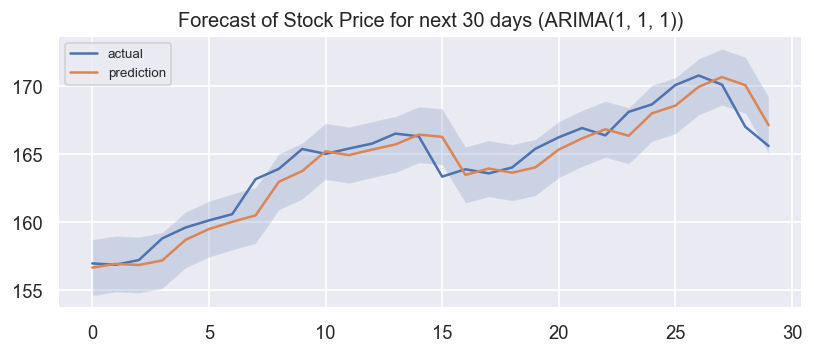

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -30.6287
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8975.09     0.0197537       2447.15           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9106.27    0.00836399       531.151           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9150.16   0.000814127       1731.05      0.5759      0.5759      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9175.89    0.00374275       575.951      0.1254      0.9949      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       9188.97   0.000906164       453.191       3.551      0.3551      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  149.091176  142.241154  153.136034   149.091176   149.091176   
1  2017-10-03  149.160553  142.239515  152.939842   149.160553   149.160553   
2  2017-10-04  149.229930  142.671994  152.758138   149.229930   149.229930   
3  2017-10-05  149.299307  142.076914  152.240021   149.299307   149.299307   
4  2017-10-06  149.368684  142.224636  152.766290   149.368684   149.368684   
5  2017-10-09  149.576815  142.621761  152.712285   149.576815   149.576815   
6  2017-10-10  149.646192  142.220197  152.794673   149.646192   149.646192   
7  2017-10-11  149.715569  142.231455  152.786917   149.715569   149.715569   
8  2017-10-12  149.784946  142.272849  152.687976   149.784946   149.784946   
9  2017-10-13  149.854323  142.287433  152.941309   149.854323   149.854323   
10 2017-10-16  150.062453  142.806508  152.762251   150.062453   150.062453   
11 2017-10-17  150.131830  142.709851  153.085676   

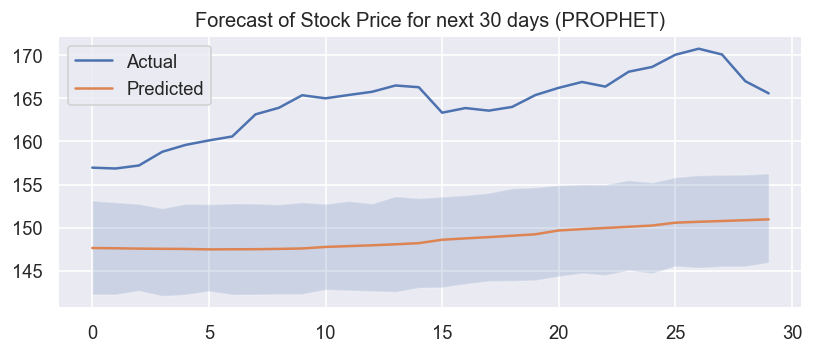

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6099.352, Time=1.27 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6108.466, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6110.461, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6110.461, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6106.706, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6098.835, Time=1.18 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=6109.813, Time=0.20 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=6100.782, Time=1.02 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6100.803, Time=1.70 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6098.864, Time=1.31 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=6107.749, Time=0.29 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=4.59 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=6097.287, Time=0.42 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=6097.827, Time=0.38 sec
 ARIMA(2,1,0)(0,0,0)[0]             : 

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


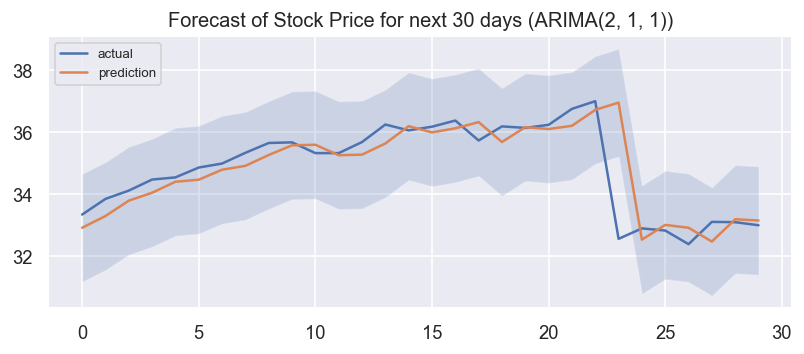

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -129.82
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6701.78     0.0357871       2635.01      0.3594           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6906.11     0.0561631       793.765           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6983.36    0.00518894       434.712      0.3262     0.03262      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     386       7023.25   0.000255938        342.61   1.407e-06       0.001      504  LS failed, Hessian reset 
     399       7026.36   0.000388896       158.613      0.7976      0.7976      517   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     462       7032.67   8.72816e-05     

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  30.334291   26.100217   32.650879    30.334291    30.334291   
1  2017-10-03  30.342736   25.927229   32.576275    30.342736    30.342736   
2  2017-10-04  30.351181   26.043176   32.598741    30.351181    30.351181   
3  2017-10-05  30.359626   26.348471   32.724917    30.359626    30.359626   
4  2017-10-06  30.368070   25.692652   32.351236    30.368070    30.368070   
5  2017-10-09  30.393405   25.701489   32.459491    30.393405    30.393405   
6  2017-10-10  30.401850   25.757878   32.285135    30.401850    30.401850   
7  2017-10-11  30.410295   25.852155   32.508946    30.410295    30.410295   
8  2017-10-12  30.418739   25.778759   32.249173    30.418739    30.418739   
9  2017-10-13  30.427184   25.810525   32.433531    30.427184    30.427184   
10 2017-10-16  30.452519   26.081062   32.227250    30.452519    30.452519   
11 2017-10-17  30.460963   26.133188   32.416940    30.460963   

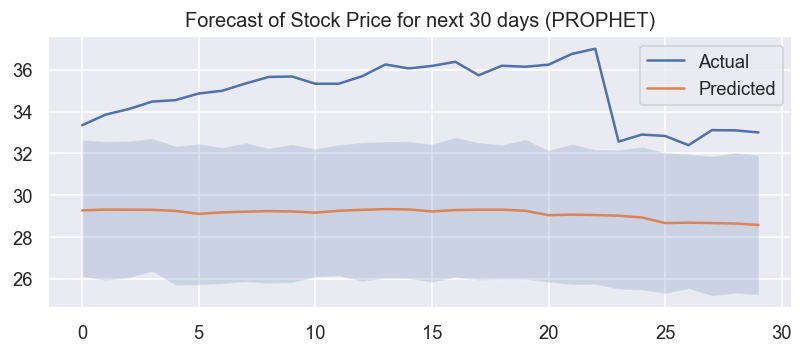

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5428.739, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5424.822, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5426.795, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5426.795, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5425.541, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.738 seconds


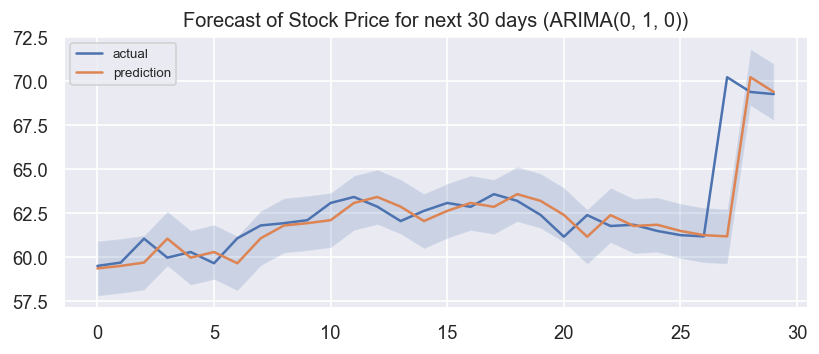

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -79.8488
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6715.25      0.163546       1549.72           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        7035.7     0.0284384       405.898           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7113.06    0.00417424       394.409           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7163.29   0.000218023       153.967      0.2875           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7177.14    0.00755177       468.078           1           1      591   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  46.263734   43.776296   50.157877    46.263734    46.263734   
1  2017-10-03  46.288653   43.726931   50.352098    46.288653    46.288653   
2  2017-10-04  46.313572   43.856780   50.420233    46.313572    46.313572   
3  2017-10-05  46.338491   43.865091   50.064900    46.338491    46.338491   
4  2017-10-06  46.363410   43.813233   50.184452    46.363410    46.363410   
5  2017-10-09  46.438167   43.758196   50.149219    46.438167    46.438167   
6  2017-10-10  46.463086   43.690127   50.242050    46.463086    46.463086   
7  2017-10-11  46.488005   43.895999   50.146786    46.488005    46.488005   
8  2017-10-12  46.512924   43.589116   50.012964    46.512924    46.512924   
9  2017-10-13  46.537843   43.682062   50.117147    46.537843    46.537843   
10 2017-10-16  46.612600   43.375802   50.124052    46.612600    46.612600   
11 2017-10-17  46.637520   43.867648   50.046962    46.637520   

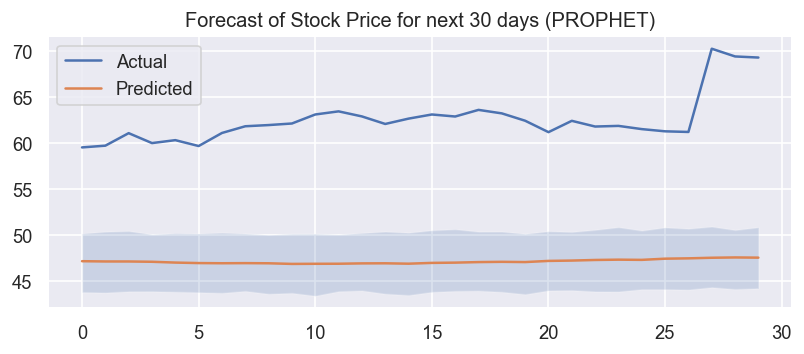

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3076.555, Time=0.45 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3077.597, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3074.572, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3074.650, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3075.666, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3076.511, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3077.841, Time=0.95 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3072.634, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=3074.573, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3074.618, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=3072.713, Time=0.07 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=3075.903, Time=0.40 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.109 seconds


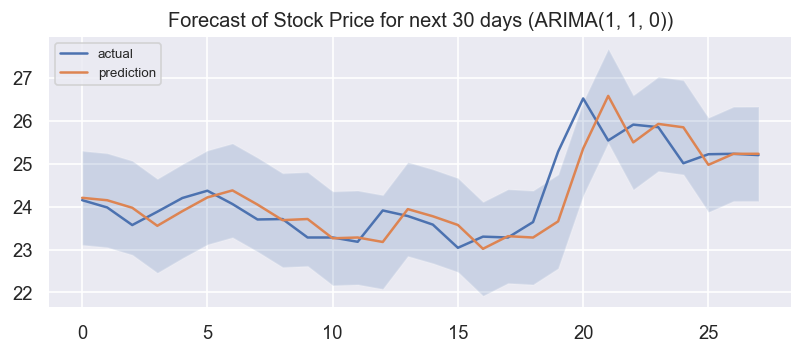

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -104.584
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5923.19     0.0285925       520.356           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6179.26      0.118653       2070.98           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6254.54    0.00371897       325.053           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6306.43     0.0197566       243.181           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6359.54    0.00133846       467.727      0.1658     0.01658      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  20.085444   17.005235   21.694862    20.085444    20.085444   
1  2017-10-03  20.093478   17.032345   21.811066    20.093478    20.093478   
2  2017-10-04  20.101513   16.970466   21.796559    20.101513    20.101513   
3  2017-10-05  20.109547   17.023789   21.919885    20.109547    20.109547   
4  2017-10-06  20.117582   17.177444   21.769408    20.117582    20.117582   
5  2017-10-09  20.141685   17.233081   21.886398    20.141685    20.141685   
6  2017-10-10  20.149719   17.092379   21.739234    20.149719    20.149719   
7  2017-10-11  20.157754   17.174836   21.981170    20.157754    20.157754   
8  2017-10-12  20.165788   17.129437   21.884063    20.165788    20.165788   
9  2017-10-13  20.173823   17.144551   22.111631    20.173823    20.173823   
10 2017-10-16  20.197926   17.308116   22.204178    20.197926    20.197926   
11 2017-10-17  20.205961   17.240619   22.124673    20.205961   

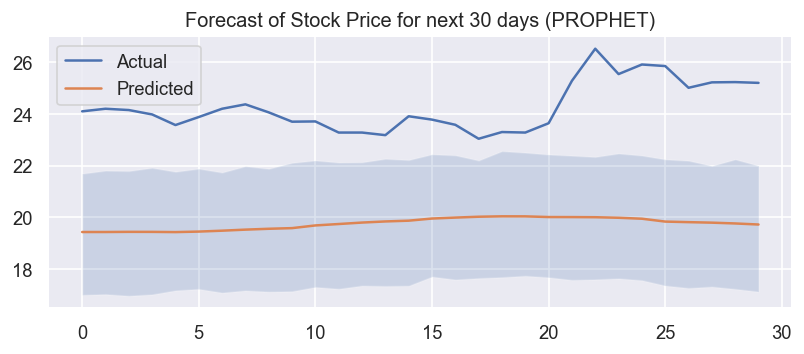

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7879.332, Time=0.60 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7877.418, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7878.860, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7878.866, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7875.565, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.121 seconds


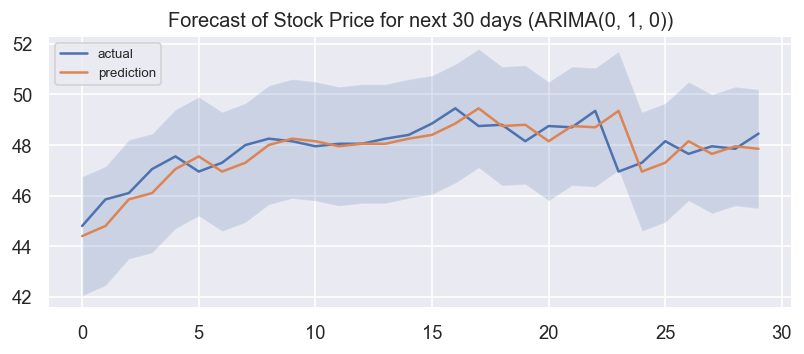

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -229.144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6585.18     0.0224267       634.244           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6721.28     0.0303083       375.975           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     267        6754.7   0.000135459       210.343   9.728e-07       0.001      367  LS failed, Hessian reset 
     299       6770.34    0.00144997       288.572      0.6649      0.6649      406   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6797.26    0.00184129       91.6329           1           1      532   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6812.13    0.00643559    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  36.662283   30.756263   40.196578    36.662283    36.662283   
1  2017-10-03  36.659054   30.394780   39.941020    36.659054    36.659054   
2  2017-10-04  36.655825   30.443517   40.025656    36.655825    36.655825   
3  2017-10-05  36.652596   30.623813   39.883305    36.652596    36.652596   
4  2017-10-06  36.649367   30.433386   39.806461    36.649367    36.649367   
5  2017-10-09  36.639679   29.932947   39.902042    36.639679    36.639679   
6  2017-10-10  36.636450   30.405469   39.999567    36.636450    36.636450   
7  2017-10-11  36.633221   30.334284   39.745231    36.633221    36.633221   
8  2017-10-12  36.629992   30.439207   39.629341    36.629992    36.629992   
9  2017-10-13  36.626763   30.227902   39.872318    36.626763    36.626763   
10 2017-10-16  36.617075   30.475076   39.623951    36.617075    36.617075   
11 2017-10-17  36.613846   30.763261   40.164422    36.613846   

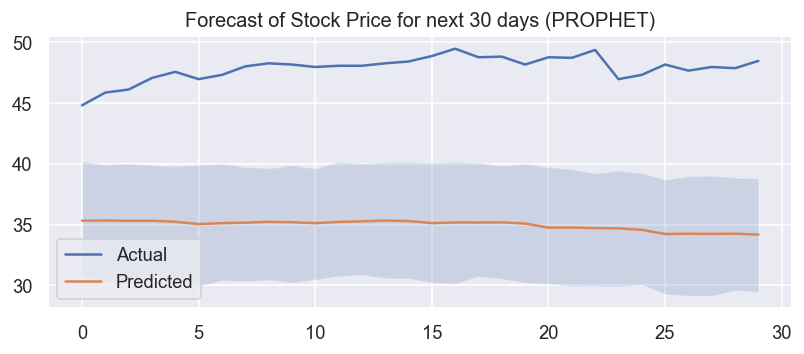

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3012.292, Time=1.06 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3008.951, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3010.496, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3010.507, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3007.352, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.634 seconds


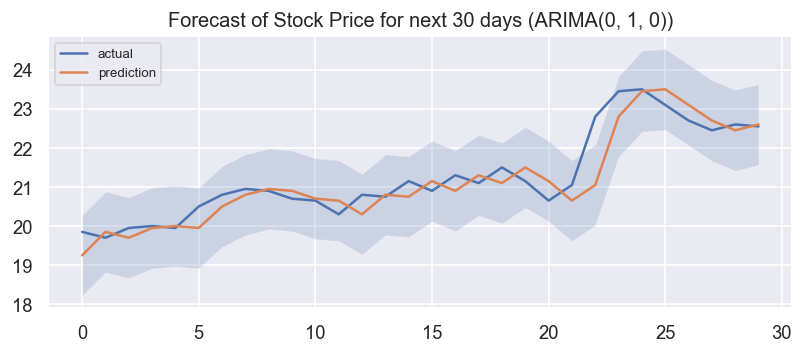

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -246.093
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5790.01     0.0785681       5336.24           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6164.84      0.120116       1172.27           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6254.3    0.00900214       1202.82      0.6009      0.6009      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6270.46     0.0135834       234.147           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6280.81   0.000570195       179.428      0.6206      0.6206      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  14.909507   12.435374   17.530930    14.909507    14.909507   
1  2017-10-03  14.915187   12.597447   17.636278    14.915187    14.915187   
2  2017-10-04  14.920868   12.561654   17.530394    14.920868    14.920868   
3  2017-10-05  14.926549   12.242873   17.696432    14.926549    14.926549   
4  2017-10-06  14.932229   12.212151   17.437370    14.932229    14.932229   
5  2017-10-09  14.949272   12.292483   17.274241    14.949272    14.949272   
6  2017-10-10  14.954952   12.380220   17.297274    14.954952    14.954952   
7  2017-10-11  14.960633   12.291081   17.455452    14.960633    14.960633   
8  2017-10-12  14.966314   12.311262   17.284412    14.966314    14.966314   
9  2017-10-13  14.971994   12.238642   17.224700    14.971994    14.971994   
10 2017-10-16  14.989036   12.078927   17.099131    14.989036    14.989036   
11 2017-10-17  14.994717   11.947453   17.176526    14.994717   

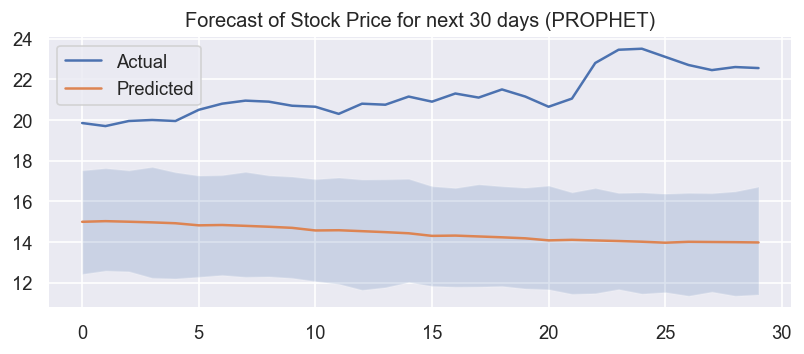

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3879.845, Time=0.56 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3898.258, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3883.247, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3881.866, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3896.622, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3881.730, Time=0.88 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3877.445, Time=1.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3880.250, Time=0.29 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3883.844, Time=0.75 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3873.308, Time=1.18 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3881.247, Time=0.40 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3867.844, Time=1.68 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=3868.583, Time=2.90 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3873.405, Time=2.57 sec
 ARIMA(2,1,3)(0,0,0)[0]          

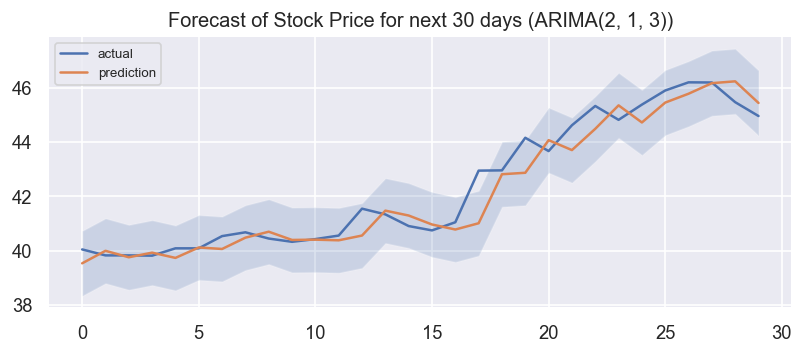

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -275.71
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6124.41     0.0995052       4625.58       0.257           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6549.12    0.00118694       407.988      0.4519      0.4519      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6652.8    0.00848579       563.299      0.3687           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6729.03   0.000818859       690.406      0.2186           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6798.88      0.846267        4900.7           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  30.287291   29.078685   33.808693    30.287291    30.287291   
1  2017-10-03  30.303090   29.004295   33.788878    30.303090    30.303090   
2  2017-10-04  30.318889   28.986716   33.730715    30.318889    30.318889   
3  2017-10-05  30.334688   29.196102   33.639900    30.334688    30.334688   
4  2017-10-06  30.350486   28.862820   33.627803    30.350486    30.350486   
5  2017-10-09  30.397883   28.880052   33.621795    30.397883    30.397883   
6  2017-10-10  30.413681   28.560882   33.479930    30.413681    30.413681   
7  2017-10-11  30.429480   28.896146   33.544429    30.429480    30.429480   
8  2017-10-12  30.445279   28.974979   33.495998    30.445279    30.445279   
9  2017-10-13  30.461077   28.692043   33.510363    30.461077    30.461077   
10 2017-10-16  30.508474   28.915048   33.425673    30.508474    30.508474   
11 2017-10-17  30.524272   28.925325   33.410784    30.524272   

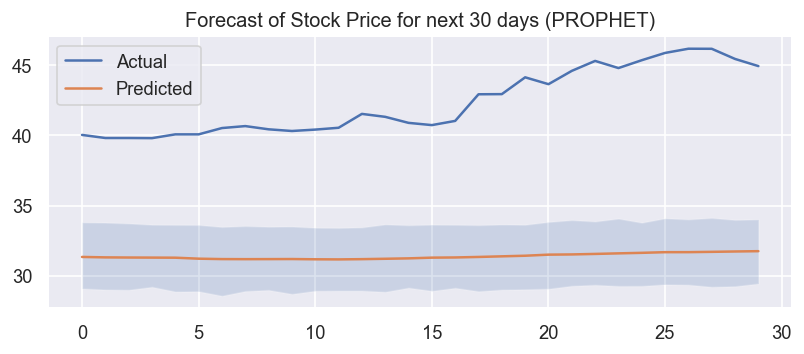

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6134.591, Time=0.58 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6141.575, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6141.669, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6141.414, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6140.951, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6133.625, Time=0.69 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=6133.279, Time=0.16 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=6135.093, Time=0.23 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=6135.139, Time=1.02 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=6132.899, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=6141.114, Time=0.05 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=6134.738, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=6133.414, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=6134.420, Time=0.19 sec
 ARIMA(3,1,1)(0,0,0)[0]          

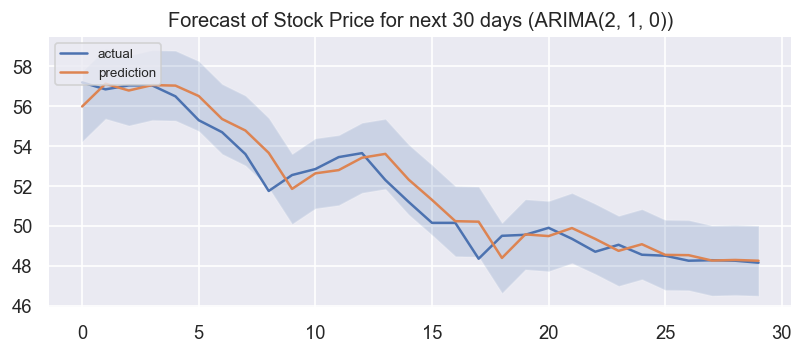

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -19.525
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7407.54     0.0441701       1662.32           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7749.91     0.0051556       337.689           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7804.05    0.00503424       702.003        9.85       0.985      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     383       7823.61   0.000252689       112.893   1.387e-06       0.001      468  LS failed, Hessian reset 
     399       7825.14    0.00082287        472.25           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7849.13    0.00270892     

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  49.586632   46.446732   52.982120    49.586632    49.586632   
1  2017-10-03  49.566031   46.636492   53.071693    49.566031    49.566031   
2  2017-10-04  49.545430   46.665039   53.242202    49.545430    49.545430   
3  2017-10-05  49.524829   46.302024   53.006085    49.524829    49.524829   
4  2017-10-06  49.504228   46.309499   53.195883    49.504228    49.504228   
5  2017-10-09  49.442424   45.918468   53.126914    49.442424    49.442424   
6  2017-10-10  49.421823   46.374502   53.016894    49.421823    49.421823   
7  2017-10-11  49.401222   46.101640   52.932354    49.401222    49.401222   
8  2017-10-12  49.380621   45.992067   52.706523    49.380621    49.380621   
9  2017-10-13  49.360020   45.951230   52.933814    49.360020    49.360020   
10 2017-10-16  49.298217   45.902881   52.892328    49.298217    49.298217   
11 2017-10-17  49.277615   46.177951   52.860789    49.277615   

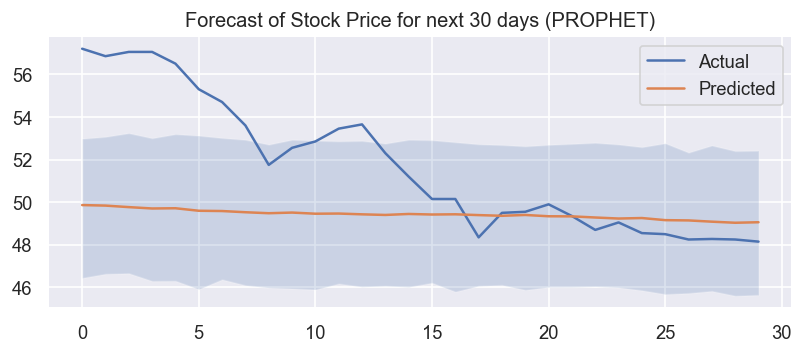

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5934.528, Time=1.11 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5935.989, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5937.070, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5937.033, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5934.088, Time=0.06 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.626 seconds


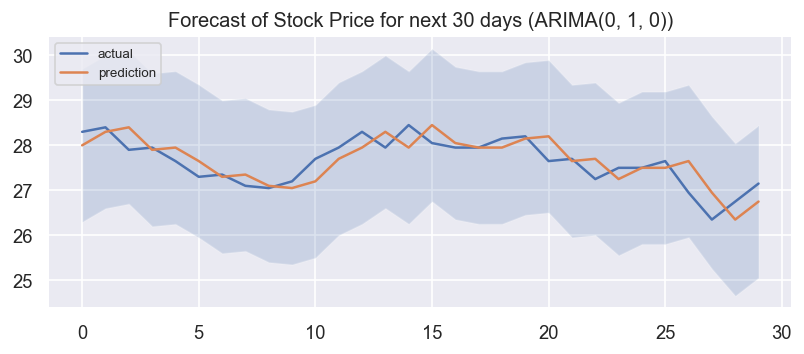

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -51.7946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6438.11     0.0128481       633.491           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6630.76     0.0251867       625.904           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6685.63    0.00142303       318.501      0.1565           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     331       6693.52   0.000838536       573.964   6.569e-06       0.001      425  LS failed, Hessian reset 
     399       6701.15    0.00187072       605.249       0.244       0.244      502   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6719.06    0.00141751    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  23.766867   21.691730   27.707536    23.766867    23.766867   
1  2017-10-03  23.765136   21.653587   27.721113    23.765136    23.765136   
2  2017-10-04  23.763405   21.665466   27.629074    23.763405    23.763405   
3  2017-10-05  23.761674   21.795704   27.443533    23.761674    23.761674   
4  2017-10-06  23.759942   21.452331   27.323170    23.759942    23.759942   
5  2017-10-09  23.754749   21.501438   27.324007    23.754749    23.754749   
6  2017-10-10  23.753018   21.667861   27.417844    23.753018    23.753018   
7  2017-10-11  23.751286   21.221611   27.395225    23.751286    23.751286   
8  2017-10-12  23.749555   21.371377   27.467903    23.749555    23.749555   
9  2017-10-13  23.747824   21.357938   27.229911    23.747824    23.747824   
10 2017-10-16  23.742630   21.311685   27.067833    23.742630    23.742630   
11 2017-10-17  23.740899   21.222082   27.251051    23.740899   

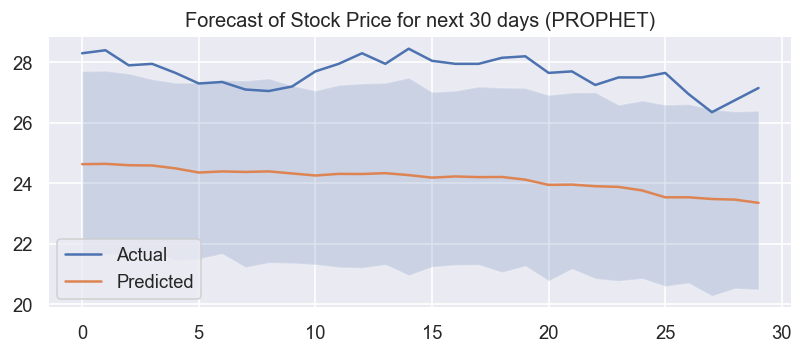

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5540.118, Time=0.61 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5540.968, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5541.090, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5540.926, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5542.968, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5539.377, Time=0.61 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5538.112, Time=0.17 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=5539.428, Time=0.23 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=5541.284, Time=0.86 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=5540.666, Time=0.08 sec

Best model:  ARIMA(2,1,0)(0,0,0)[0] intercept
Total fit time: 3.155 seconds


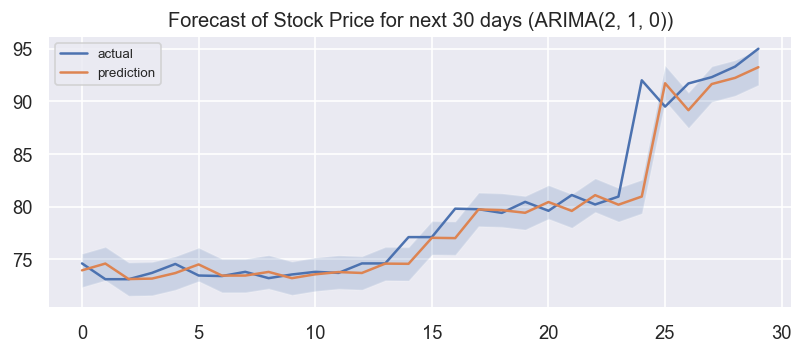

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -89.1475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7381.14      0.113335       1339.97           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7462.77     0.0844134        1253.7           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7598.96     0.0531322       1025.83           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7801.17     0.0260455       459.971       0.135           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7839.26    0.00520591       366.255           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  66.884393   64.169131   70.280939    66.884393    66.884393   
1  2017-10-03  66.919314   64.530354   70.122996    66.919314    66.919314   
2  2017-10-04  66.954235   64.122415   70.193938    66.954235    66.954235   
3  2017-10-05  66.989156   64.159814   70.270072    66.989156    66.989156   
4  2017-10-06  67.024077   64.018523   69.921019    67.024077    67.024077   
5  2017-10-09  67.128839   64.001551   70.317647    67.128839    67.128839   
6  2017-10-10  67.163760   64.017421   70.047709    67.163760    67.163760   
7  2017-10-11  67.198681   63.996188   70.024584    67.198681    67.198681   
8  2017-10-12  67.233602   64.060875   69.911264    67.233602    67.233602   
9  2017-10-13  67.268523   64.028170   70.082004    67.268523    67.268523   
10 2017-10-16  67.373286   64.187168   69.983406    67.373286    67.373286   
11 2017-10-17  67.408207   64.214386   70.185344    67.408207   

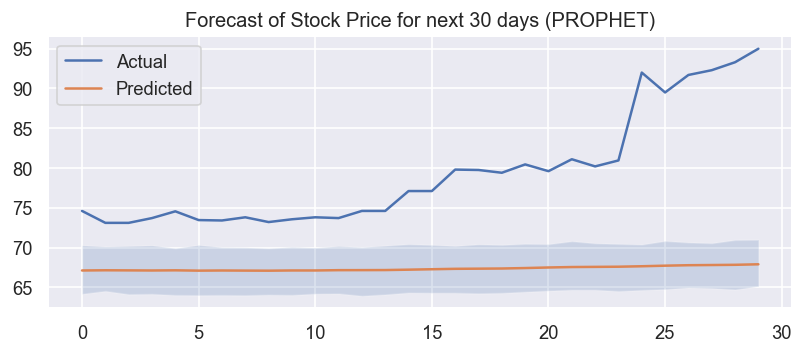

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4273.402, Time=0.67 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4220.619, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4272.323, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4274.435, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4222.004, Time=0.13 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-4272.987, Time=0.38 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-4270.842, Time=0.64 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4275.573, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4274.486, Time=0.38 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-4274.098, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4273.506, Time=0.12 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-4274.312, Time=0.52 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 3.833 seconds


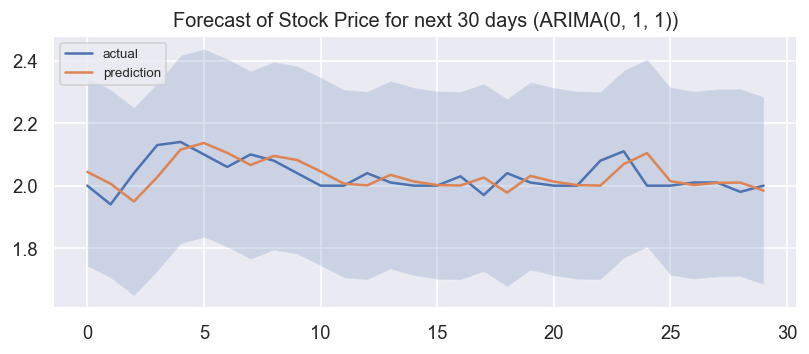

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -53.5629
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6727.76      0.100664       1155.21           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7027.66     0.0700922       1804.02           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7167.03     0.0144476        575.24           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7236.24     0.0275479       455.597           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7301.32   0.000790864       314.653           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  2.383638    1.774021    2.740997     2.383638     2.383638   
1  2017-10-03  2.384582    1.800038    2.782783     2.384582     2.384582   
2  2017-10-04  2.385527    1.753984    2.728681     2.385527     2.385527   
3  2017-10-05  2.386471    1.787926    2.738939     2.386471     2.386471   
4  2017-10-06  2.387415    1.771625    2.747891     2.387415     2.387415   
5  2017-10-09  2.390247    1.762375    2.754745     2.390247     2.390247   
6  2017-10-10  2.391192    1.771260    2.715488     2.391192     2.391192   
7  2017-10-11  2.392136    1.775555    2.732201     2.392136     2.392136   
8  2017-10-12  2.393080    1.819413    2.784944     2.393080     2.393080   
9  2017-10-13  2.394024    1.792507    2.765444     2.394024     2.394024   
10 2017-10-16  2.396857    1.788312    2.741153     2.396857     2.396857   
11 2017-10-17  2.397801    1.769104    2.760329     2.397801     2.397801   

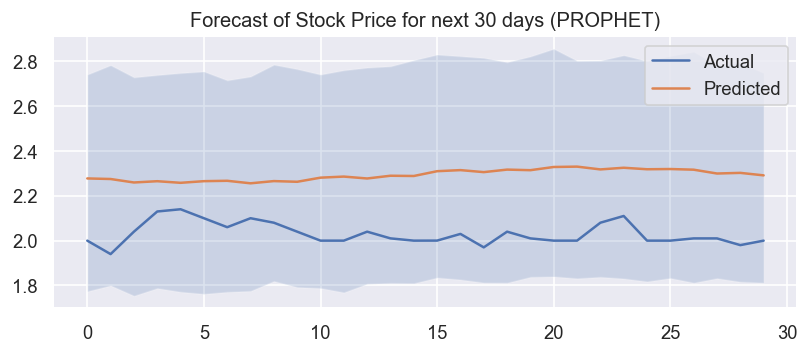

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2218.465, Time=0.81 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2222.861, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2223.481, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2223.349, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2220.866, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2221.803, Time=0.24 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2221.441, Time=0.43 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2219.445, Time=0.32 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2219.804, Time=0.19 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2213.985, Time=1.99 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=2220.897, Time=0.55 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=2216.229, Time=2.84 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=2220.997, Time=1.79 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=2223.802, Time=0.37 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept

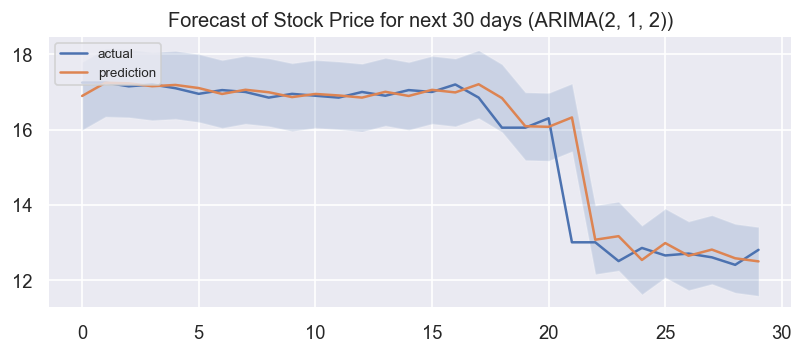

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -281.516
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6476.4     0.0560331       2146.09      0.4287           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6714.71     0.0506048       1498.12           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6828.63    0.00253516       277.482      0.6297      0.6297      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6888.75    0.00133071       644.654      0.3234      0.3234      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     481       6916.42   8.49757e-05       164.034   4.366e-07       0.001      611  LS failed, Hessian reset 
     499       6918.74   0.000611804    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  18.360168   15.993473   19.262666    18.360168    18.360168   
1  2017-10-03  18.359327   16.027730   19.091818    18.359327    18.359327   
2  2017-10-04  18.358487   15.883261   19.096861    18.358487    18.358487   
3  2017-10-05  18.357646   15.889322   19.207555    18.357646    18.357646   
4  2017-10-06  18.356806   16.012318   19.107669    18.356806    18.356806   
5  2017-10-09  18.354284   15.905579   19.098610    18.354284    18.354284   
6  2017-10-10  18.353444   15.919709   19.035034    18.353444    18.353444   
7  2017-10-11  18.352603   15.826315   19.061262    18.352603    18.352603   
8  2017-10-12  18.351762   15.882842   19.079014    18.351762    18.351762   
9  2017-10-13  18.350922   15.795854   18.986418    18.350922    18.350922   
10 2017-10-16  18.348400   15.783014   19.118662    18.348400    18.348400   
11 2017-10-17  18.347560   15.826270   18.981597    18.347560   

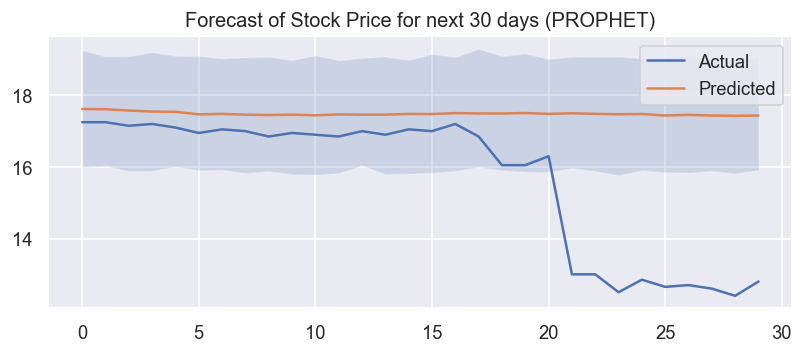

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4047.892, Time=0.85 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4057.769, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4058.813, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4058.728, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4058.352, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4047.486, Time=0.82 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4056.080, Time=0.19 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4048.966, Time=0.99 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4049.663, Time=1.42 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4047.570, Time=1.66 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=4051.255, Time=0.26 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=4050.965, Time=1.63 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4049.419, Time=0.30 sec

Best model:  ARIMA(2,1,1)(0,0,0)[0] intercept
Total fit time: 8.781 seconds


/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


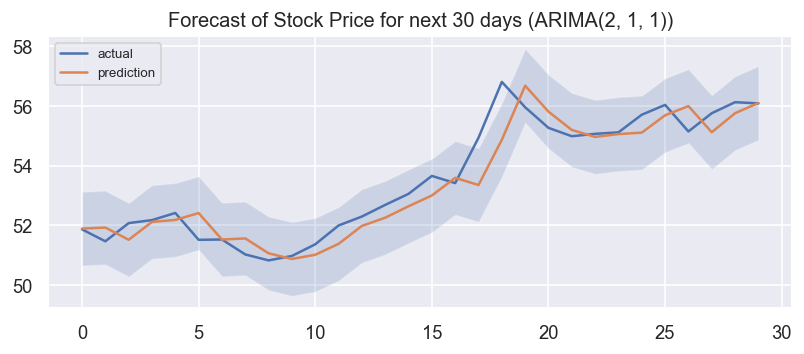

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -21.9748
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7989.84     0.0279194       2578.86           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8311.35     0.0721791       1636.59           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        8403.1    0.00109642       972.225      0.3081      0.3081      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8448.99     0.0057045       489.807      0.2693           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8469.07    0.00483362       239.452           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  54.987189   52.318903   57.635630    54.987189    54.987189   
1  2017-10-03  54.985959   52.495654   57.666355    54.985959    54.985959   
2  2017-10-04  54.984729   52.588231   57.728616    54.984729    54.984729   
3  2017-10-05  54.983499   52.739305   57.945751    54.983499    54.983499   
4  2017-10-06  54.982269   52.745440   57.778264    54.982269    54.982269   
5  2017-10-09  54.978578   52.775427   57.771827    54.978578    54.978578   
6  2017-10-10  54.977348   52.805049   58.202409    54.977348    54.977348   
7  2017-10-11  54.976117   52.844247   58.096940    54.976117    54.976117   
8  2017-10-12  54.974887   52.880969   57.972553    54.974887    54.974887   
9  2017-10-13  54.973657   52.792391   57.977844    54.973657    54.973657   
10 2017-10-16  54.969966   52.944518   58.131232    54.969966    54.969966   
11 2017-10-17  54.968736   52.968893   58.061159    54.968736   

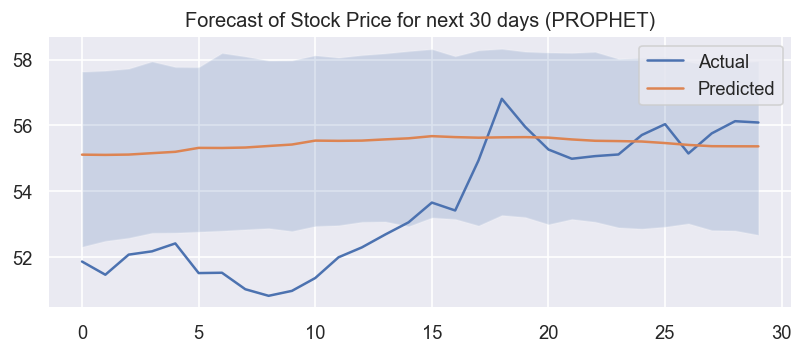

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1574.597, Time=0.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1575.363, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1576.149, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1576.062, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1575.744, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1575.995, Time=0.86 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1575.979, Time=1.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1574.734, Time=0.32 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1574.833, Time=0.19 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1577.955, Time=1.91 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=1574.906, Time=0.22 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 5.902 seconds


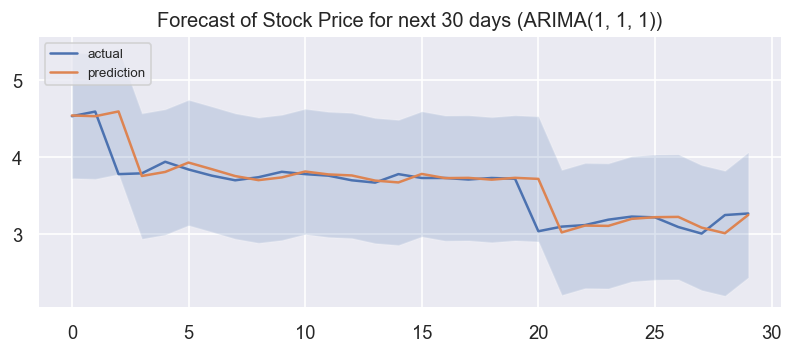

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -110.638
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7120.23     0.0398887       3591.28           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7907.03     0.0155039       1874.53           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8187.41    0.00284897       581.015           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8355.03     0.0261969       978.128           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8406.48     0.0230973       1593.57           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  3.266284    1.550066    4.673592     3.266284     3.266284   
1  2017-10-03  3.261888    1.680684    4.471269     3.261888     3.261888   
2  2017-10-04  3.257493    1.596690    4.507364     3.257493     3.257493   
3  2017-10-05  3.253097    1.576296    4.581665     3.253097     3.253097   
4  2017-10-06  3.248702    1.663207    4.566691     3.248702     3.248702   
5  2017-10-09  3.235515    1.669314    4.585859     3.235515     3.235515   
6  2017-10-10  3.231119    1.701925    4.594615     3.231119     3.231119   
7  2017-10-11  3.226724    1.646897    4.528551     3.226724     3.226724   
8  2017-10-12  3.222328    1.636354    4.610038     3.222328     3.222328   
9  2017-10-13  3.217933    1.607187    4.718627     3.217933     3.217933   
10 2017-10-16  3.204746    1.669829    4.646296     3.204746     3.204746   
11 2017-10-17  3.200350    1.605749    4.553165     3.200350     3.200350   

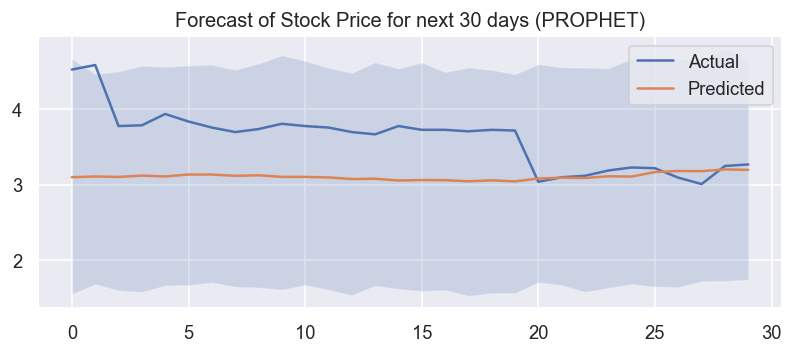

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=12713.075, Time=0.84 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=12716.629, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=12718.397, Time=0.11 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=12718.386, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=12717.262, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=12713.963, Time=0.83 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=12713.986, Time=1.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=12718.938, Time=0.29 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=12718.946, Time=0.17 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=2.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=12714.840, Time=0.24 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 5.909 seconds


/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


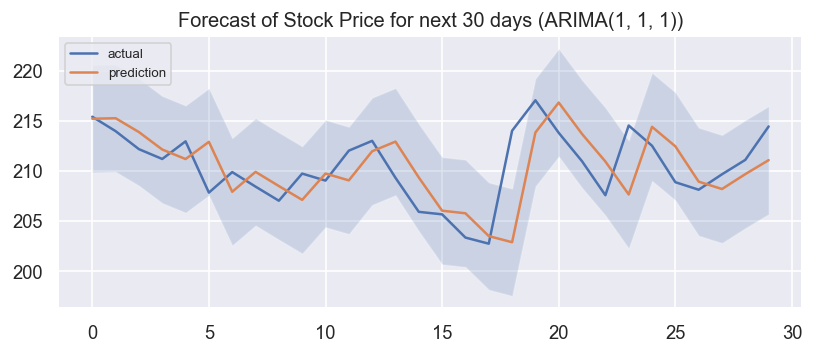

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -38.4789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7170.59    0.00786084       684.324           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7488.85       0.20551        5696.3           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7574.08    0.00458807        290.06           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7616.73     0.0173733       812.793           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        7624.9    0.00268978        423.55      0.4415           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  250.956763  233.179748  265.176274   250.956763   250.956763   
1  2017-10-03  250.956678  235.027656  266.733926   250.956678   250.956678   
2  2017-10-04  250.956594  235.122911  265.401699   250.956594   250.956594   
3  2017-10-05  250.956509  234.542360  263.759374   250.956509   250.956509   
4  2017-10-06  250.956424  234.287627  265.696791   250.956424   250.956424   
5  2017-10-09  250.956170  234.122236  265.526988   250.956170   250.956170   
6  2017-10-10  250.956085  234.835109  266.223773   250.956085   250.956085   
7  2017-10-11  250.956001  235.630810  266.286095   250.956001   250.956001   
8  2017-10-12  250.955916  234.877974  266.055102   250.955916   250.955916   
9  2017-10-13  250.955831  235.680140  267.077409   250.955831   250.955831   
10 2017-10-16  250.955577  235.524418  267.443625   250.955577   250.955577   
11 2017-10-17  250.955492  235.925620  267.196367   

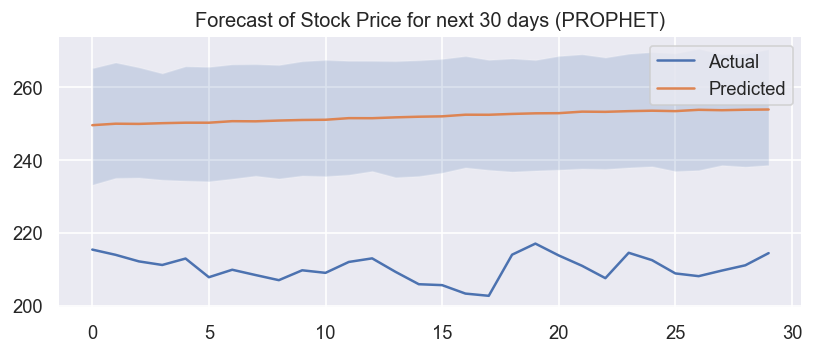

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6298.964, Time=0.91 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6299.794, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6298.298, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6298.131, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6297.797, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.415 seconds


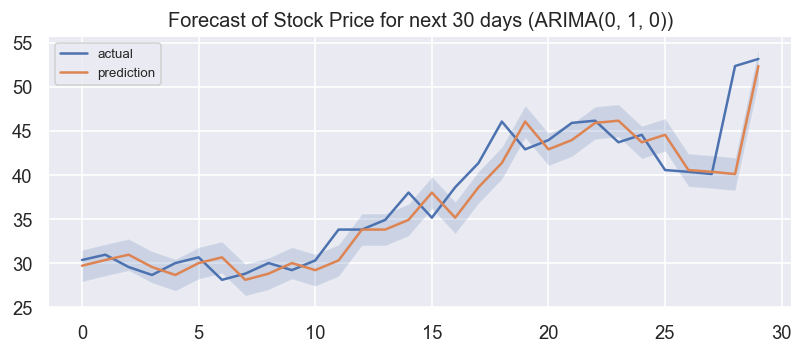

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -166.197
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       4822.91     0.0306626       823.115           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       4913.32    0.00858955        168.01           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       4937.25   0.000168213       87.9252   1.908e-06       0.001      363  LS failed, Hessian reset 
     299       4937.89    0.00163878       288.516       0.536       0.536      379   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     338       4946.23    0.00178364       143.167   7.654e-06       0.001      452  LS failed, Hessian reset 
     399       4951.29    0.00218445       98.4423           1           1      529   
    Iter      log pro

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  15.616554   12.337967   21.722661    15.616554    15.616554   
1  2017-10-03  15.612547   12.136161   21.662373    15.612547    15.612547   
2  2017-10-04  15.608539   12.155630   21.656169    15.608539    15.608539   
3  2017-10-05  15.604532   12.011241   21.342562    15.604532    15.604532   
4  2017-10-06  15.600524   12.316431   21.558142    15.600524    15.600524   
5  2017-10-09  15.588502   11.772886   21.255305    15.588502    15.588502   
6  2017-10-10  15.584494   11.987363   21.257651    15.584494    15.584494   
7  2017-10-11  15.580487   11.336965   21.215865    15.580487    15.580487   
8  2017-10-12  15.576480   11.364604   21.227774    15.576480    15.576480   
9  2017-10-13  15.572472   11.571281   21.197401    15.572472    15.572472   
10 2017-10-16  15.560450   11.685946   21.006282    15.560450    15.560450   
11 2017-10-17  15.556442   11.937359   21.228459    15.556442   

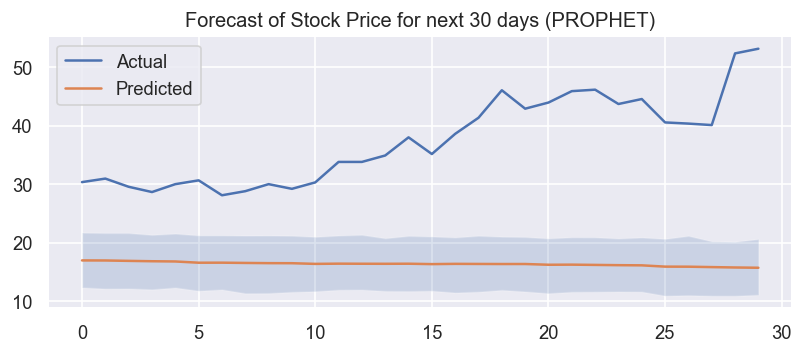

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6245.051, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6249.428, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6243.932, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6243.567, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6247.439, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6244.403, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6245.906, Time=0.94 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=6241.576, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=6243.060, Time=0.10 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=6242.413, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=6241.941, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=6243.916, Time=0.33 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 2.590 seconds


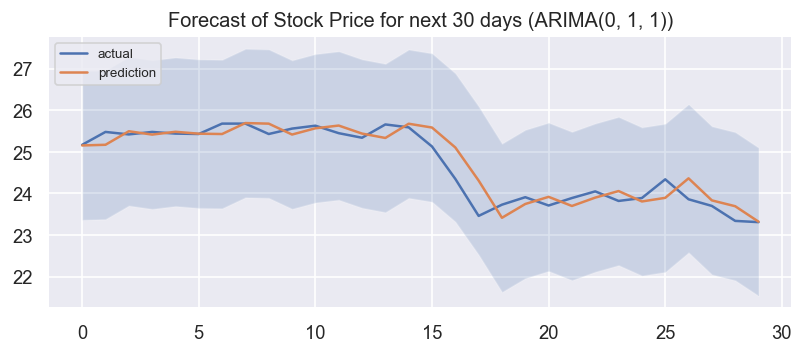

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -43.7264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5267.01     0.0277874       1214.39           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5647.06    0.00873024       387.514           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5785.59    0.00651809       224.479      0.0793      0.6889      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5981.35     0.0206277       1766.59       0.186           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6106.51     0.0536957       1730.69           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  20.412936   15.454942   22.220079    20.412936    20.412936   
1  2017-10-03  20.412943   15.185612   22.248651    20.412943    20.412943   
2  2017-10-04  20.412950   15.453139   22.240870    20.412950    20.412950   
3  2017-10-05  20.412957   15.238010   22.173270    20.412957    20.412957   
4  2017-10-06  20.412964   15.028651   22.269439    20.412964    20.412964   
5  2017-10-09  20.412984   15.333526   22.043639    20.412984    20.412984   
6  2017-10-10  20.412991   15.168288   22.001987    20.412991    20.412991   
7  2017-10-11  20.412998   15.104900   22.021642    20.412998    20.412998   
8  2017-10-12  20.413005   15.184877   22.088093    20.413005    20.413005   
9  2017-10-13  20.413012   15.136771   22.243955    20.413012    20.413012   
10 2017-10-16  20.413032   15.340190   22.267026    20.413032    20.413032   
11 2017-10-17  20.413039   15.228806   22.182500    20.413039   

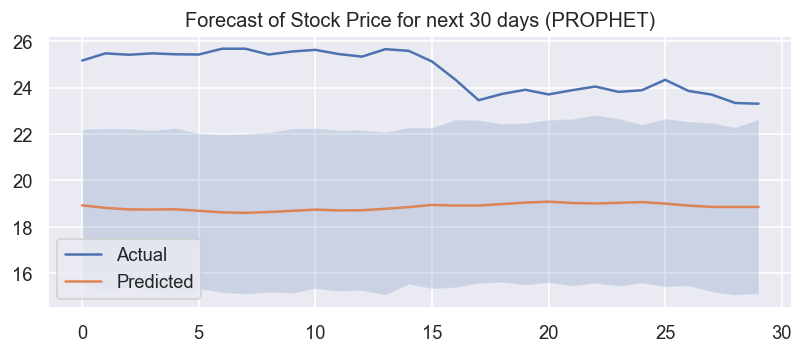

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8657.448, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8656.054, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8656.173, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8656.238, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8654.110, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.554 seconds


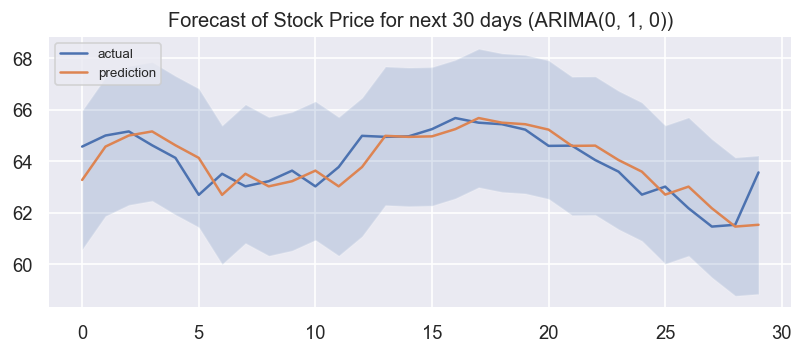

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -99.196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6461.79     0.0157818       697.813           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6598.08     0.0978509       706.468           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6678.26     0.0104197       655.531           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6703.67    0.00562715       153.862           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6726.42     0.0023235       199.499           1           1      588   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  56.409705   51.038937   62.423461    56.409705    56.409705   
1  2017-10-03  56.390148   51.210278   62.322695    56.390148    56.390148   
2  2017-10-04  56.370591   50.602939   62.331715    56.370591    56.370591   
3  2017-10-05  56.351034   50.228579   61.842583    56.351034    56.351034   
4  2017-10-06  56.331477   50.401413   62.110285    56.331477    56.331477   
5  2017-10-09  56.272807   49.892828   61.424257    56.272807    56.272807   
6  2017-10-10  56.253250   49.836521   60.672339    56.253250    56.253250   
7  2017-10-11  56.233693   49.376948   61.326965    56.233693    56.233693   
8  2017-10-12  56.214136   49.550577   61.093572    56.214136    56.214136   
9  2017-10-13  56.194579   49.693647   60.669129    56.194579    56.194579   
10 2017-10-16  56.135908   49.532907   60.455650    56.135908    56.135908   
11 2017-10-17  56.116351   49.519421   60.469495    56.116351   

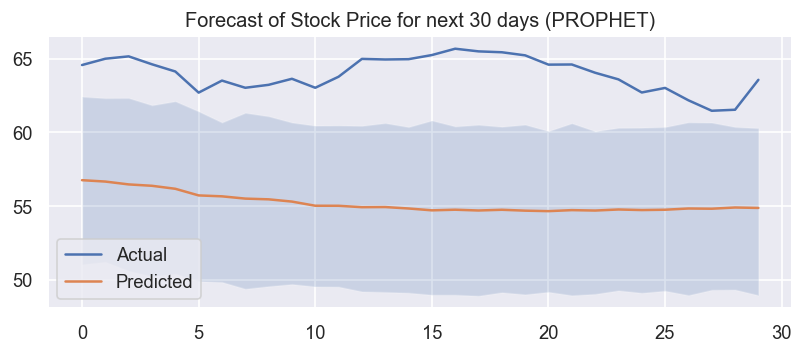

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6490.623, Time=0.98 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6499.298, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6491.986, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6492.352, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6503.182, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=6492.623, Time=0.67 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=6492.623, Time=0.99 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=6493.217, Time=0.30 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=6492.642, Time=0.18 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=6493.968, Time=1.32 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=6494.954, Time=0.19 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 5.219 seconds


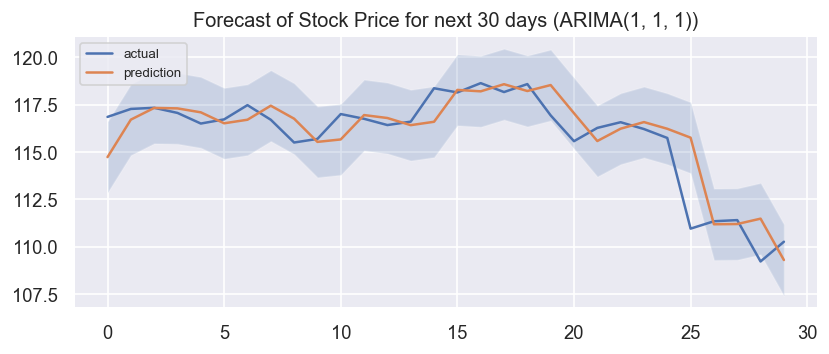

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -101.677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7378.02     0.0158367       870.943           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7496.12    0.00256664       374.001      0.7904      0.7904      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7551.22    0.00370928        410.91           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7609.77     0.0516439        590.86           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7650.48    0.00797644       826.795      0.7017      0.7017      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  103.517184   97.171341  109.030938   103.517184   103.517184   
1  2017-10-03  103.576433   96.414258  109.033532   103.576433   103.576433   
2  2017-10-04  103.635681   96.854747  109.073275   103.635681   103.635681   
3  2017-10-05  103.694930   96.830240  109.004982   103.694930   103.694930   
4  2017-10-06  103.754178   97.265658  109.020617   103.754178   103.754178   
5  2017-10-09  103.931923   96.697174  109.664977   103.931923   103.931923   
6  2017-10-10  103.991172   96.601560  109.018623   103.991172   103.991172   
7  2017-10-11  104.050420   97.480712  108.734819   104.050420   104.050420   
8  2017-10-12  104.109669   97.097845  109.464874   104.109669   104.109669   
9  2017-10-13  104.168917   97.095943  108.954577   104.168917   104.168917   
10 2017-10-16  104.346663   97.719606  109.542169   104.346663   104.346663   
11 2017-10-17  104.405911   97.585729  109.742563   

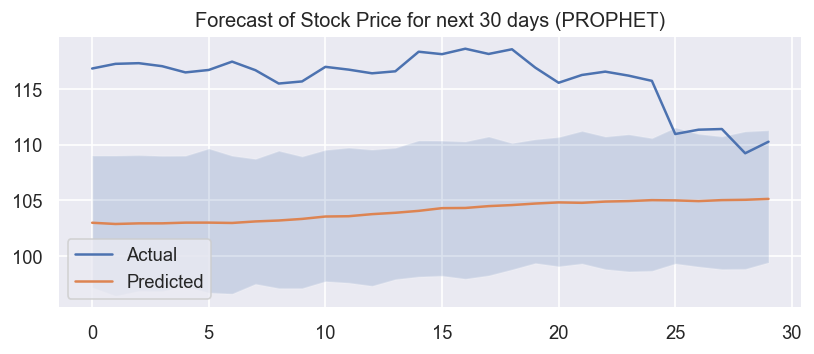

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5930.478, Time=0.64 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5928.076, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5928.604, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5928.646, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5928.697, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.205 seconds


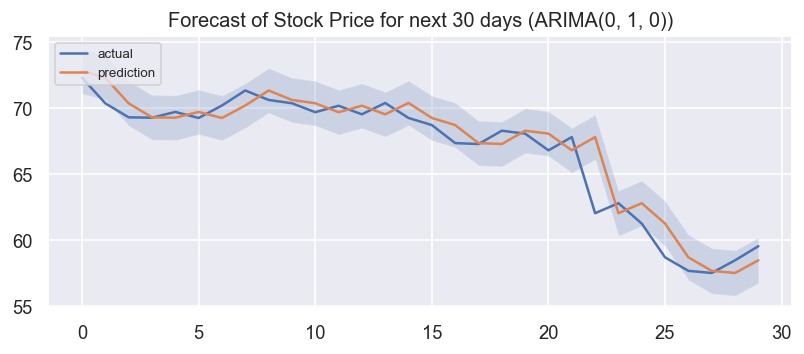

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -59.1098
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7243.19    0.00299247       367.158           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7273.68     0.0288035       587.619           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7288.96    0.00200194       201.482           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     369       7290.56   0.000185325       112.089   2.093e-06       0.001      488  LS failed, Hessian reset 
     399       7290.64   0.000163501       70.0209           1           1      525   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     480       7291.43   0.000122555    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  80.145405   74.984336   85.645331    80.145405    80.145405   
1  2017-10-03  80.168900   74.541549   85.712212    80.168900    80.168900   
2  2017-10-04  80.192395   74.531471   85.720206    80.192395    80.192395   
3  2017-10-05  80.215889   74.574277   86.067217    80.215889    80.215889   
4  2017-10-06  80.239384   74.592368   86.301554    80.239384    80.239384   
5  2017-10-09  80.309868   74.633268   85.787288    80.309868    80.309868   
6  2017-10-10  80.333363   74.963519   86.594348    80.333363    80.333363   
7  2017-10-11  80.356857   74.427302   86.046620    80.356857    80.356857   
8  2017-10-12  80.380352   74.872217   86.097994    80.380352    80.380352   
9  2017-10-13  80.403847   74.775159   86.248709    80.403847    80.403847   
10 2017-10-16  80.474331   74.902393   86.004379    80.474331    80.474331   
11 2017-10-17  80.497825   74.948295   86.476751    80.497825   

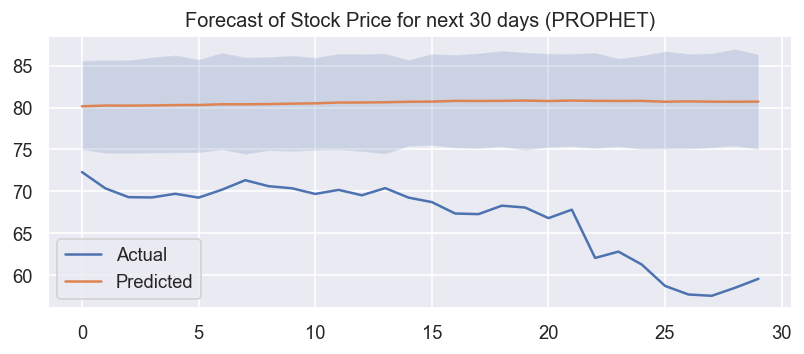

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-218.468, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-217.201, Time=0.55 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-220.275, Time=0.51 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-220.376, Time=0.70 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-217.655, Time=0.26 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-218.568, Time=0.76 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-218.142, Time=2.23 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-220.951, Time=0.22 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-219.032, Time=0.32 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-219.119, Time=0.32 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-220.852, Time=0.27 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-218.530, Time=0.86 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 7.675 seconds


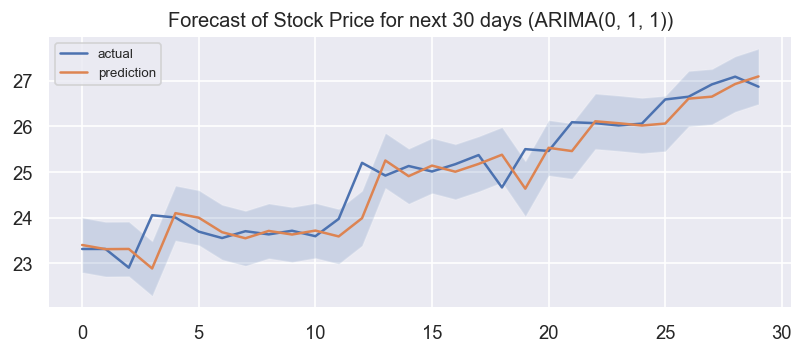

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -87.9816
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6244.35     0.0456944        1645.5           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6385.94     0.0216242       655.297           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6445.88    0.00237515       655.005      0.3376      0.3376      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6471.58     0.0311894       304.313           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     422       6478.09   0.000195246       249.257   9.579e-07       0.001      573  LS failed, Hessian reset 
     465       6490.01   0.000318958    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  17.671819   15.629349   19.070181    17.671819    17.671819   
1  2017-10-03  17.674380   15.555320   19.158326    17.674380    17.674380   
2  2017-10-04  17.676941   15.506678   19.046276    17.676941    17.676941   
3  2017-10-05  17.679501   15.463098   19.029378    17.679501    17.679501   
4  2017-10-06  17.682062   15.477411   19.210205    17.682062    17.682062   
5  2017-10-09  17.689744   15.564577   19.053996    17.689744    17.689744   
6  2017-10-10  17.692305   15.428011   19.068447    17.692305    17.692305   
7  2017-10-11  17.694865   15.351485   19.019018    17.694865    17.694865   
8  2017-10-12  17.697426   15.371706   18.929752    17.697426    17.697426   
9  2017-10-13  17.699986   15.468571   18.980414    17.699986    17.699986   
10 2017-10-16  17.707668   15.425425   18.968770    17.707668    17.707668   
11 2017-10-17  17.710229   15.382400   18.851785    17.710229   

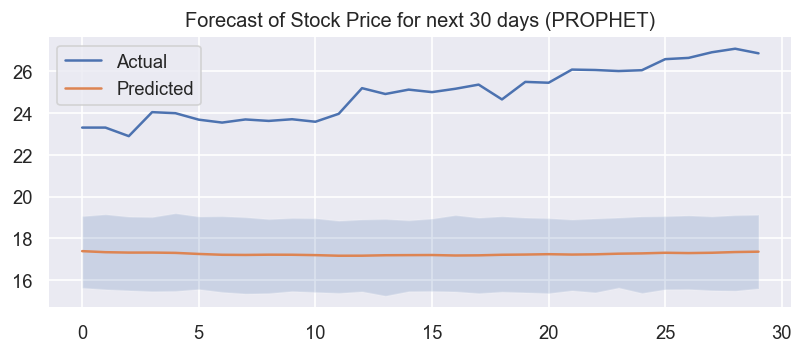

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5219.737, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5215.979, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5217.735, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5217.737, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5214.905, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.693 seconds


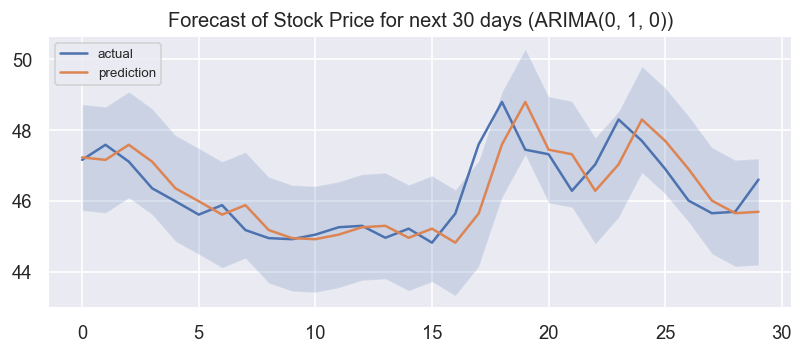

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -47.7738
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          6505    0.00815567       562.821      0.8264      0.8264      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6550.33    0.00136568       225.355      0.4535      0.4535      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6565.74    0.00106406       74.8865           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     370       6570.19   0.000245746       215.889   4.326e-07       0.001      483  LS failed, Hessian reset 
     399       6573.55   0.000104235       103.073      0.3355      0.3355      520   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     488       6577.45    0.00024856    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  42.556267   38.810525   47.766082    42.556267    42.556267   
1  2017-10-03  42.555153   39.004336   47.248942    42.555153    42.555153   
2  2017-10-04  42.554039   38.955330   47.696288    42.554039    42.554039   
3  2017-10-05  42.552925   38.941194   47.234420    42.552925    42.552925   
4  2017-10-06  42.551811   38.735888   47.263752    42.551811    42.551811   
5  2017-10-09  42.548469   38.300548   46.910995    42.548469    42.548469   
6  2017-10-10  42.547355   38.620626   46.806437    42.547355    42.547355   
7  2017-10-11  42.546241   38.425416   46.981731    42.546241    42.546241   
8  2017-10-12  42.545127   38.600130   47.039275    42.545127    42.545127   
9  2017-10-13  42.544013   38.217737   46.859406    42.544013    42.544013   
10 2017-10-16  42.540671   38.251485   47.018306    42.540671    42.540671   
11 2017-10-17  42.539557   38.176939   46.890335    42.539557   

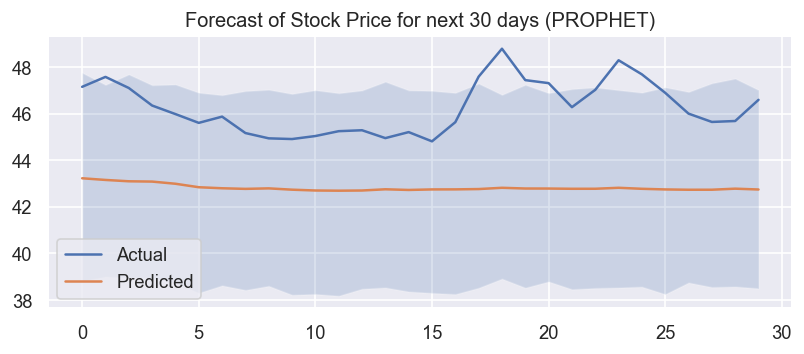

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=10128.414, Time=0.66 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=10125.677, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=10127.501, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=10127.495, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=10124.938, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.026 seconds


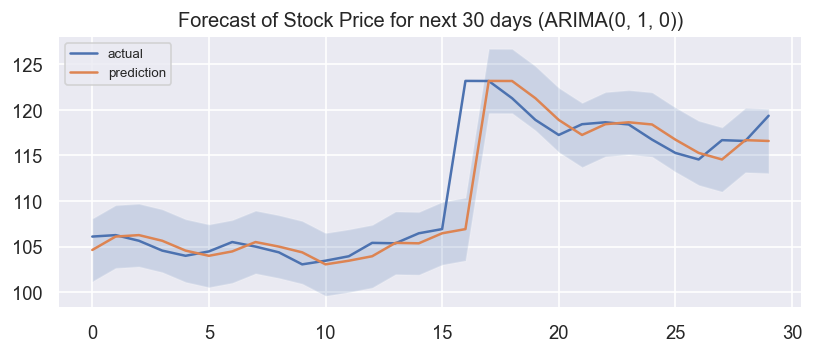

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -49.0877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6829.05     0.0606521        3047.2           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6925.52     0.0397931       894.839      0.4783           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6935.19   0.000522896       121.449      0.2402      0.8395      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       6936.27   0.000203604       319.555   4.612e-07       0.001      431  LS failed, Hessian reset 
     399       6939.78     0.0199854       295.373      0.8769      0.8769      515   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     490       6945.27   0.000235279    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  70.644559   61.205867   80.807344    70.644559    70.644559   
1  2017-10-03  70.586529   60.588344   80.493243    70.586529    70.586529   
2  2017-10-04  70.528499   60.407417   80.690199    70.528499    70.528499   
3  2017-10-05  70.470469   60.416562   80.545046    70.470469    70.470469   
4  2017-10-06  70.412439   59.967862   80.188946    70.412439    70.412439   
5  2017-10-09  70.238349   60.153394   79.908802    70.238349    70.238349   
6  2017-10-10  70.180319   59.119613   78.758447    70.180319    70.180319   
7  2017-10-11  70.122289   58.872337   78.233370    70.122289    70.122289   
8  2017-10-12  70.064259   59.466576   78.953026    70.064259    70.064259   
9  2017-10-13  70.006229   59.159939   79.391552    70.006229    70.006229   
10 2017-10-16  69.832139   58.761233   78.407632    69.832139    69.832139   
11 2017-10-17  69.774109   59.266903   79.260797    69.774109   

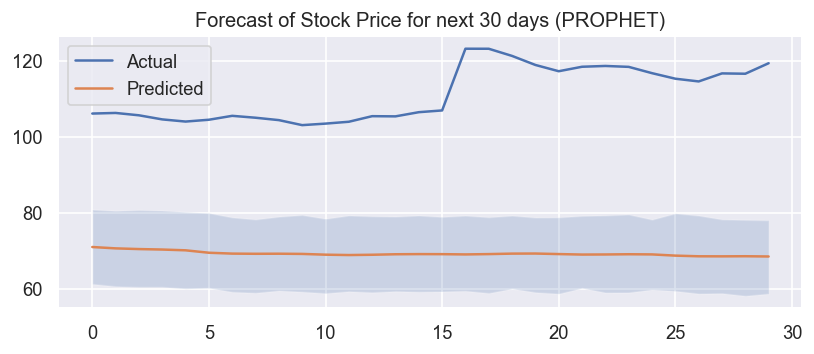

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3507.627, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3503.788, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3505.629, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3505.625, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3502.011, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.846 seconds


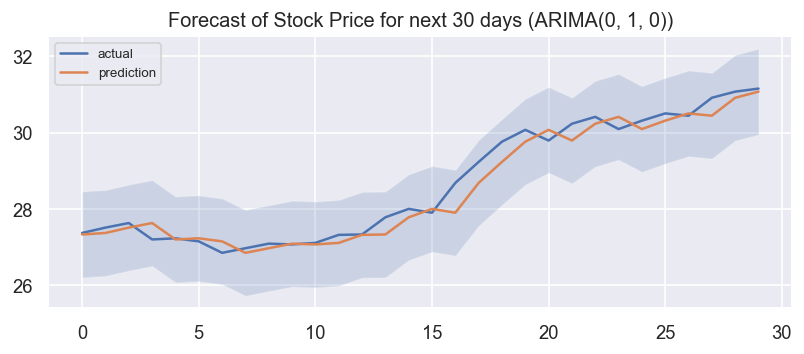

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -295.752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7072.02     0.0104013       1131.99      0.9192     0.09192      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7307.89      0.117642       2932.61           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7420.85    0.00197235       1076.24           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7478.93    0.00507694       774.879      0.9584      0.9584      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7528.91     0.0145912       891.186           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.992082   20.666630   24.673196    22.992082    22.992082   
1  2017-10-03  22.998012   20.669186   24.806174    22.998012    22.998012   
2  2017-10-04  23.003942   20.534629   24.598653    23.003942    23.003942   
3  2017-10-05  23.009872   20.445578   24.624871    23.009872    23.009872   
4  2017-10-06  23.015802   20.332560   24.558134    23.015802    23.015802   
5  2017-10-09  23.033591   20.289473   24.324186    23.033591    23.033591   
6  2017-10-10  23.039521   20.334868   24.520257    23.039521    23.039521   
7  2017-10-11  23.045451   20.190368   24.401313    23.045451    23.045451   
8  2017-10-12  23.051381   20.227792   24.471415    23.051381    23.051381   
9  2017-10-13  23.057311   20.453533   24.386268    23.057311    23.057311   
10 2017-10-16  23.075101   20.002405   24.303295    23.075101    23.075101   
11 2017-10-17  23.081031   20.365707   24.396429    23.081031   

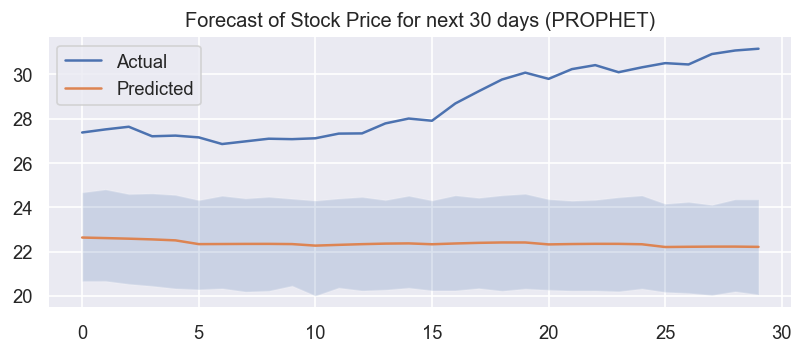

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=12662.688, Time=0.55 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=12661.098, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=12662.539, Time=0.11 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=12662.509, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=12659.210, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.927 seconds


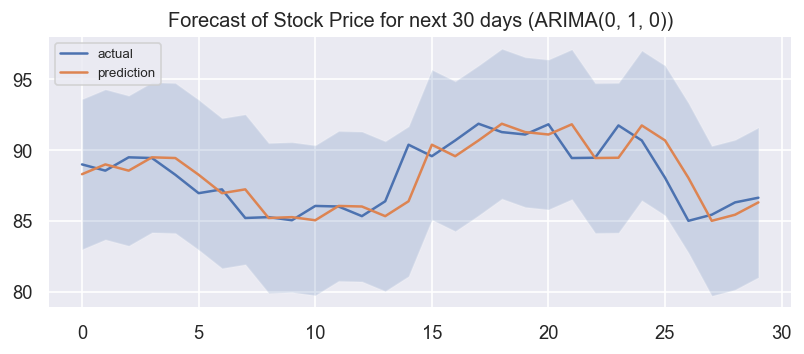

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -102.281
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6850.99    0.00354316       627.559           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        6944.1    0.00176329       430.419      0.7942      0.7942      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7037.1    0.00172814       639.712      0.6008      0.6008      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7078.96     0.0093808       122.688           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7090.81     0.0132274       253.194           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  71.777603   61.031971   81.779217    71.777603    71.777603   
1  2017-10-03  71.719103   60.549488   81.970972    71.719103    71.719103   
2  2017-10-04  71.660602   60.739743   81.145115    71.660602    71.660602   
3  2017-10-05  71.602102   59.744178   81.550833    71.602102    71.602102   
4  2017-10-06  71.543602   59.255211   80.493768    71.543602    71.543602   
5  2017-10-09  71.368101   58.912016   80.528129    71.368101    71.368101   
6  2017-10-10  71.309601   58.644092   79.936031    71.309601    71.309601   
7  2017-10-11  71.251100   58.450219   79.695966    71.251100    71.251100   
8  2017-10-12  71.192600   57.658810   80.070042    71.192600    71.192600   
9  2017-10-13  71.134100   57.839885   79.490330    71.134100    71.134100   
10 2017-10-16  70.958599   57.861879   79.850476    70.958599    70.958599   
11 2017-10-17  70.900098   57.972226   79.512653    70.900098   

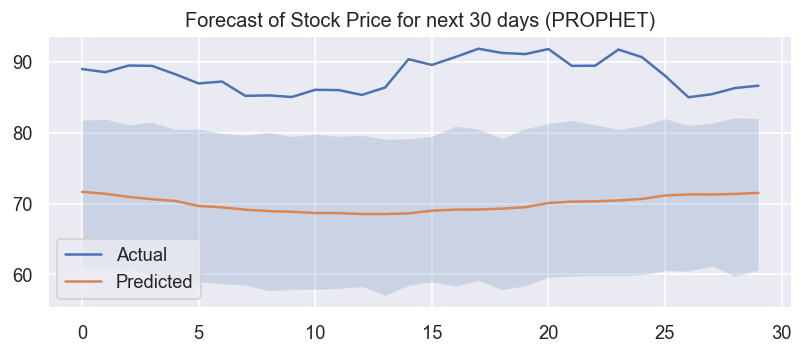

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2273.566, Time=0.89 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2272.955, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2274.946, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2274.947, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2272.138, Time=0.11 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.542 seconds


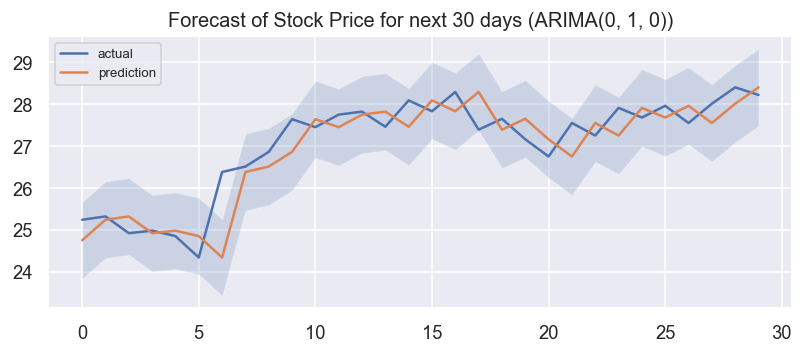

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -102.66
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5069.01      0.016636        1439.6      0.2037      0.2037      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5175.08     0.0267006        236.78           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5262.37     0.0151242       846.794           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5351.76     0.0374318       1172.67           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5483.27      0.143441       1265.14       2.913      0.2913      580   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  19.789094   17.030482   22.010195    19.789094    19.789094   
1  2017-10-03  19.802630   16.695169   21.810203    19.802630    19.802630   
2  2017-10-04  19.816167   16.599991   21.694932    19.816167    19.816167   
3  2017-10-05  19.829703   16.708196   21.760941    19.829703    19.829703   
4  2017-10-06  19.843240   16.874451   21.766741    19.843240    19.843240   
5  2017-10-09  19.883849   16.679965   21.838186    19.883849    19.883849   
6  2017-10-10  19.897386   16.567213   21.537596    19.897386    19.897386   
7  2017-10-11  19.910922   16.625645   21.753525    19.910922    19.910922   
8  2017-10-12  19.924458   16.691468   21.721927    19.924458    19.924458   
9  2017-10-13  19.937995   16.422186   21.591782    19.937995    19.937995   
10 2017-10-16  19.978604   16.539753   21.651099    19.978604    19.978604   
11 2017-10-17  19.992141   16.416664   21.596050    19.992141   

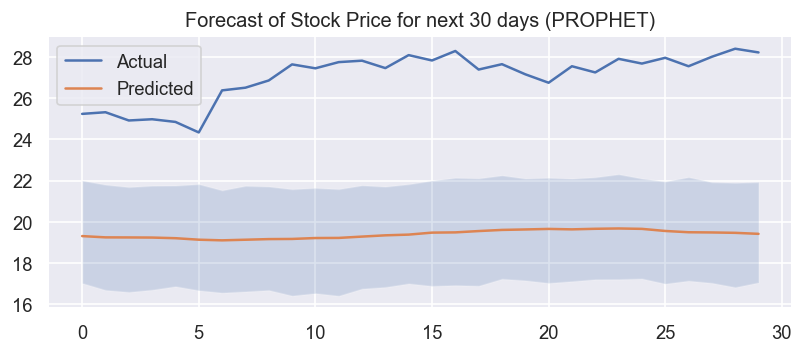

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3396.716, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3394.383, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3394.718, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3394.716, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3393.422, Time=0.10 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.788 seconds


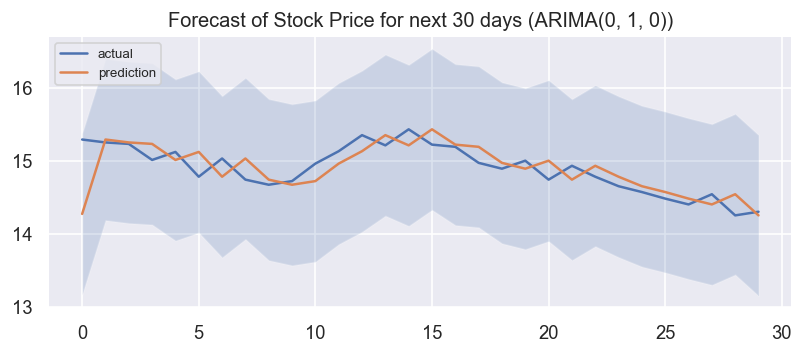

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -66.687
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6733.98      0.189483       5371.95           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7009.98      0.050845       820.143           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7075.01    0.00237118       406.931      0.3697      0.3697      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7109.27     0.0159286       663.302           1           1      476   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7123.86    0.00595029       355.446       4.954      0.4954      584   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  11.064884    8.872971   13.177722    11.064884    11.064884   
1  2017-10-03  11.059367    9.022397   13.133682    11.059367    11.059367   
2  2017-10-04  11.053849    8.626861   12.942152    11.053849    11.053849   
3  2017-10-05  11.048331    8.848334   12.994927    11.048331    11.048331   
4  2017-10-06  11.042814    8.777181   12.990851    11.042814    11.042814   
5  2017-10-09  11.026260    8.662094   12.973672    11.026260    11.026260   
6  2017-10-10  11.020743    8.776895   12.860748    11.020743    11.020743   
7  2017-10-11  11.015225    8.523479   12.875917    11.015225    11.015225   
8  2017-10-12  11.009707    8.579249   12.841253    11.009707    11.009707   
9  2017-10-13  11.004190    8.507070   12.768256    11.004190    11.004190   
10 2017-10-16  10.987637    8.255051   12.604158    10.987637    10.987637   
11 2017-10-17  10.982119    8.405928   12.747830    10.982119   

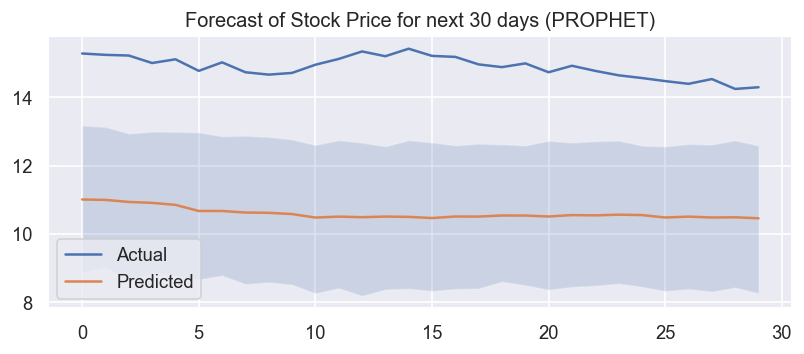

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2155.277, Time=0.88 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2158.280, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2154.801, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2155.124, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2156.442, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2154.179, Time=0.27 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=2156.117, Time=0.37 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2156.156, Time=0.86 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=2157.557, Time=1.15 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=2152.329, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2152.955, Time=0.08 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=2154.268, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2154.306, Time=0.45 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2153.427, Time=0.27 sec
 ARIMA(3,1,1)(0,0,0)[0]          

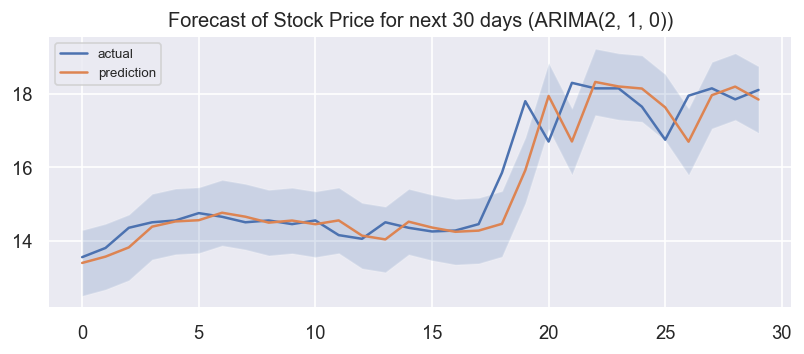

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -200.946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5582.61     0.0249094       306.646           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5650.56    0.00155915       158.528       0.647       0.647      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     289       5667.67   0.000568691       340.169   2.965e-06       0.001      387  LS failed, Hessian reset 
     299       5672.06     0.0034456       126.707      0.9006      0.9006      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5689.78     0.0124661        214.08           1           1      523   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5692.86    0.00461062    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  10.759541    7.304280   12.159872    10.759541    10.759541   
1  2017-10-03  10.755138    7.457600   12.338995    10.755138    10.755138   
2  2017-10-04  10.750734    7.352359   12.318919    10.750734    10.750734   
3  2017-10-05  10.746330    7.236275   12.299639    10.746330    10.746330   
4  2017-10-06  10.741926    7.367528   12.349904    10.741926    10.741926   
5  2017-10-09  10.728715    7.370683   12.207152    10.728715    10.728715   
6  2017-10-10  10.724311    7.512675   12.380611    10.724311    10.724311   
7  2017-10-11  10.719908    7.340640   12.349147    10.719908    10.719908   
8  2017-10-12  10.715504    7.323407   12.405055    10.715504    10.715504   
9  2017-10-13  10.711100    7.365256   12.348106    10.711100    10.711100   
10 2017-10-16  10.697889    7.395603   12.399083    10.697889    10.697889   
11 2017-10-17  10.693485    7.511905   12.460355    10.693485   

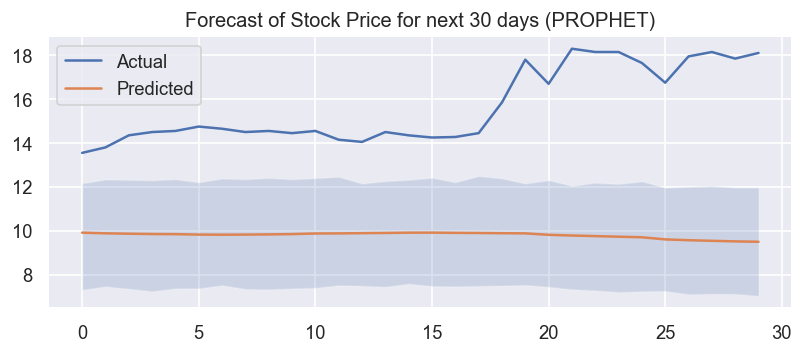

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-346.592, Time=0.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-332.877, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-345.619, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-344.974, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-324.252, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-347.993, Time=0.93 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-345.082, Time=0.32 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-345.664, Time=1.23 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-346.763, Time=1.74 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-347.957, Time=1.38 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-344.759, Time=0.23 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-344.464, Time=2.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-338.069, Time=0.34 sec

Best model:  ARIMA(2,1,1)(0,0,0)[0] intercept
Total fit time: 9.836 seconds


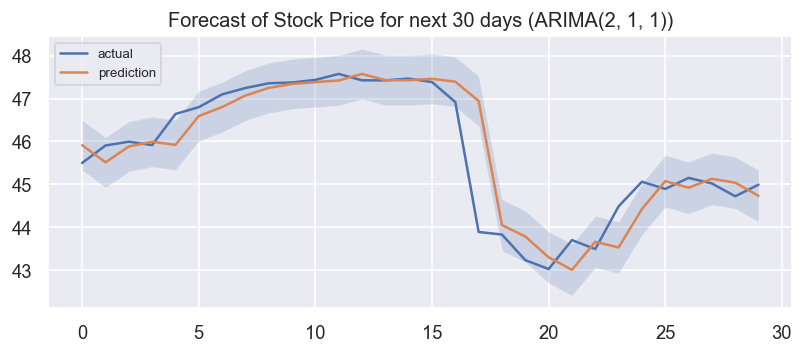

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -95.5732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8708.84    0.00528633       1864.52      0.4455      0.4455      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8734.26    0.00557131       433.147           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8743.57   0.000556158       171.226           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     360       8747.91   5.33514e-05       243.394   2.275e-07       0.001      454  LS failed, Hessian reset 
     399       8749.39     0.0016966       314.937      0.7962      0.7962      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     418       8749.89   3.81367e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  40.498157   38.378523   41.897080    40.498157    40.498157   
1  2017-10-03  40.519345   38.281547   41.950668    40.519345    40.519345   
2  2017-10-04  40.540533   38.224582   41.871010    40.540533    40.540533   
3  2017-10-05  40.561721   38.372782   41.971760    40.561721    40.561721   
4  2017-10-06  40.582909   38.201780   41.846209    40.582909    40.582909   
5  2017-10-09  40.646473   38.218940   41.834935    40.646473    40.646473   
6  2017-10-10  40.667661   38.126678   41.914339    40.667661    40.667661   
7  2017-10-11  40.688849   38.237237   41.814663    40.688849    40.688849   
8  2017-10-12  40.710036   38.141542   41.900140    40.710036    40.710036   
9  2017-10-13  40.731224   38.228033   41.899730    40.731224    40.731224   
10 2017-10-16  40.794788   38.267038   41.957755    40.794788    40.794788   
11 2017-10-17  40.815976   38.482856   41.922830    40.815976   

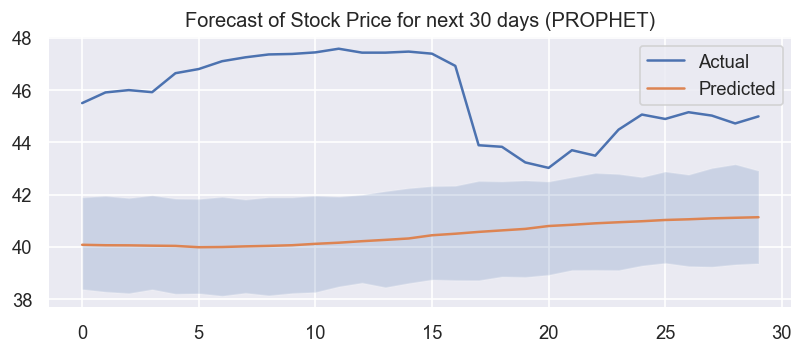

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3887.062, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3892.260, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3886.270, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3886.307, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3895.416, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3888.221, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3888.774, Time=0.87 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3889.982, Time=0.07 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0] intercept
Total fit time: 2.332 seconds


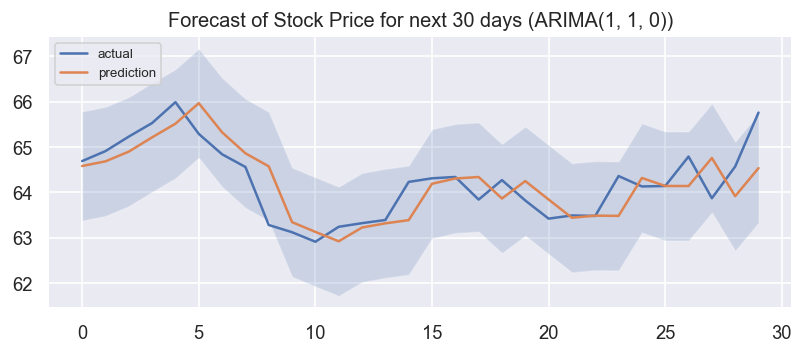

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -39.7813
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8198.62     0.0802984       523.701           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8302.09    0.00436353       350.098           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8335.24    0.00766495       1665.47      0.3325           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8363.07    0.00688817       148.003           1           1      485   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8382.87    0.00206039       281.261           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  65.451625   62.547432   68.034534    65.451625    65.451625   
1  2017-10-03  65.469524   62.355506   68.055339    65.469524    65.469524   
2  2017-10-04  65.487423   62.515926   68.254387    65.487423    65.487423   
3  2017-10-05  65.505322   62.619421   68.078121    65.505322    65.505322   
4  2017-10-06  65.523222   62.806415   68.285640    65.523222    65.523222   
5  2017-10-09  65.576919   62.484703   68.229624    65.576919    65.576919   
6  2017-10-10  65.594818   62.474379   68.433331    65.594818    65.594818   
7  2017-10-11  65.612717   62.593892   68.403104    65.612717    65.612717   
8  2017-10-12  65.630616   62.697275   68.422664    65.630616    65.630616   
9  2017-10-13  65.648515   62.925508   68.543103    65.648515    65.648515   
10 2017-10-16  65.702213   62.840935   68.196846    65.702213    65.702213   
11 2017-10-17  65.720112   62.725151   68.569541    65.720112   

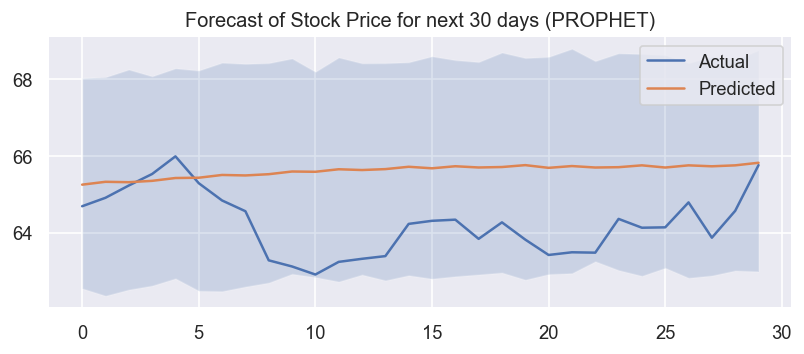

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=8724.920, Time=0.69 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=8724.639, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=8726.562, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=8726.555, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=8724.487, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.052 seconds


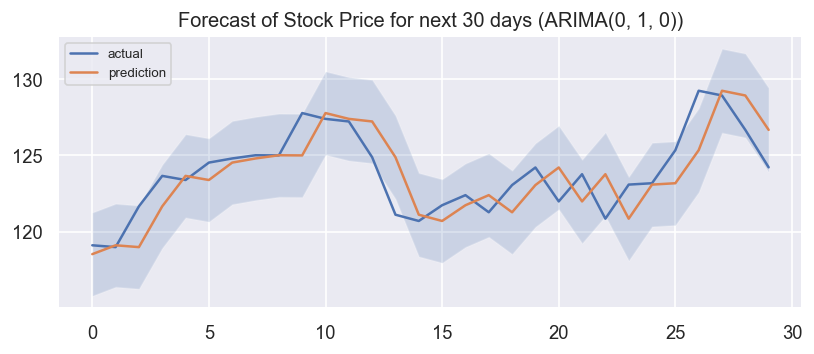

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -151.367
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6876.95     0.0835163       5596.32           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6969.88    0.00304916       247.147      0.5145      0.5145      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7029.04    0.00367756       696.292      0.5453      0.5453      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        7041.3    0.00053383       197.091      0.4842      0.4842      482   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     424       7043.54   0.000143091       198.711   1.179e-06       0.001      556  LS failed, Hessian reset 
     499       7045.98   7.97438e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  102.460718   92.226422  109.036877   102.460718   102.460718   
1  2017-10-03  102.494489   91.743360  108.241742   102.494489   102.494489   
2  2017-10-04  102.528259   91.457636  108.546132   102.528259   102.528259   
3  2017-10-05  102.562029   92.275965  108.413654   102.562029   102.562029   
4  2017-10-06  102.595799   92.239138  107.689867   102.595799   102.595799   
5  2017-10-09  102.697110   91.762946  107.346761   102.697110   102.697110   
6  2017-10-10  102.730880   91.020166  107.461334   102.730880   102.730880   
7  2017-10-11  102.764650   91.516626  107.973033   102.764650   102.764650   
8  2017-10-12  102.798421   91.668544  107.005164   102.798421   102.798421   
9  2017-10-13  102.832191   92.046844  108.614670   102.832191   102.832191   
10 2017-10-16  102.933502   92.241798  108.191216   102.933502   102.933502   
11 2017-10-17  102.967272   92.448163  108.573516   

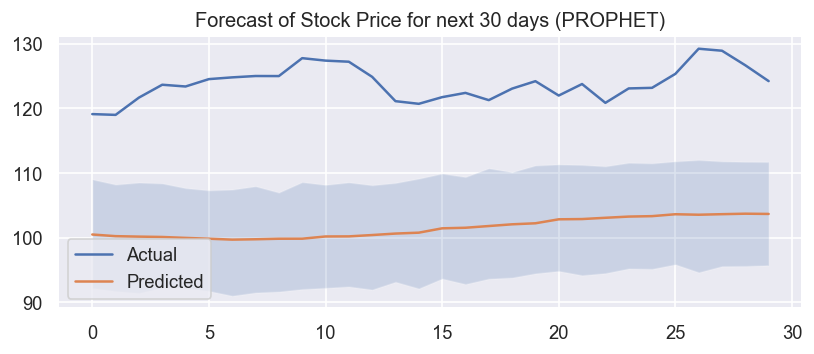

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2503.142, Time=0.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2516.975, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2507.637, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2506.840, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2515.359, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2505.064, Time=1.29 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2505.167, Time=0.40 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2505.844, Time=0.43 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2506.638, Time=0.18 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2507.107, Time=0.96 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2501.677, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2505.284, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2506.073, Time=0.06 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2503.604, Time=0.33 sec
 ARIMA(1,1,2)(0,0,0)[0]          

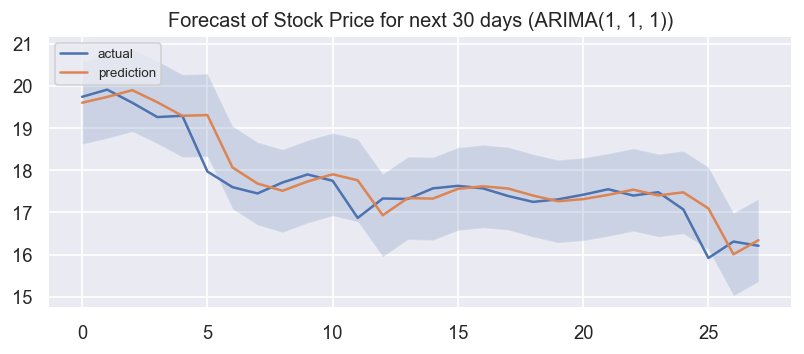

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -83.5002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6433.57    0.00964604       703.081           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6541.85     0.0471872       664.058           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6564.76     0.0212832        952.74           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6586.15   0.000689504       189.273           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     471       6602.73   0.000116891        127.23   2.709e-07       0.001      590  LS failed, Hessian reset 
     499       6609.36      0.031276    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  19.957134   17.251724   21.503011    19.957134    19.957134   
1  2017-10-03  19.944576   17.290348   21.602495    19.944576    19.944576   
2  2017-10-04  19.932017   17.361314   21.717786    19.932017    19.932017   
3  2017-10-05  19.919459   17.097925   21.616280    19.919459    19.919459   
4  2017-10-06  19.906900   17.066631   21.500838    19.906900    19.906900   
5  2017-10-09  19.869225   17.196319   21.462754    19.869225    19.869225   
6  2017-10-10  19.856667   16.963838   21.348189    19.856667    19.856667   
7  2017-10-11  19.844108   17.009250   21.193961    19.844108    19.844108   
8  2017-10-12  19.831550   16.931118   21.310314    19.831550    19.831550   
9  2017-10-13  19.818992   16.878537   21.425539    19.818992    19.818992   
10 2017-10-16  19.781316   16.885571   21.074702    19.781316    19.781316   
11 2017-10-17  19.768758   17.026735   21.231696    19.768758   

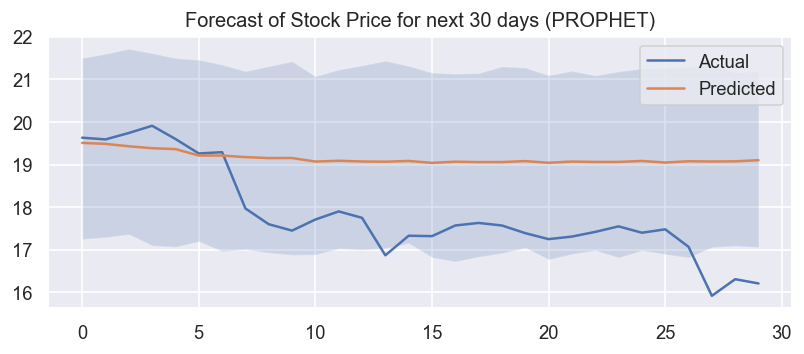

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4180.142, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4183.779, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4178.441, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4178.303, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4182.251, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4180.118, Time=0.28 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4181.526, Time=0.78 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4176.828, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4178.676, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=4178.652, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4176.963, Time=0.11 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=4180.059, Time=0.36 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 2.702 seconds


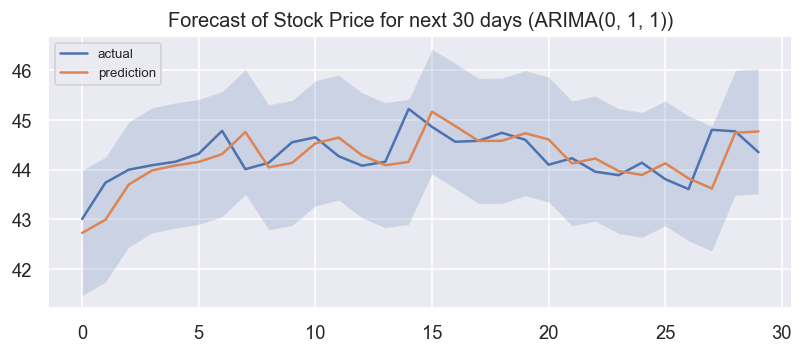

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -58.2787
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7273.17      0.054618       1863.81           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7667.73     0.0184021       424.496           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7875.97     0.0280279         482.7           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7910.35    0.00212959       546.732     0.09416           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7934.63    0.00320132       344.753      0.3648      0.3648      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  44.176738   40.948744   45.490637    44.176738    44.176738   
1  2017-10-03  44.172878   40.804534   45.632098    44.172878    44.172878   
2  2017-10-04  44.169019   40.646776   45.492391    44.169019    44.169019   
3  2017-10-05  44.165160   40.699329   45.446806    44.165160    44.165160   
4  2017-10-06  44.161301   40.677642   45.295401    44.161301    44.161301   
5  2017-10-09  44.149723   40.444304   45.094776    44.149723    44.149723   
6  2017-10-10  44.145864   40.517081   45.149921    44.145864    44.145864   
7  2017-10-11  44.142004   40.597851   45.485246    44.142004    44.142004   
8  2017-10-12  44.138145   40.631953   45.366755    44.138145    44.138145   
9  2017-10-13  44.134286   40.516564   45.344438    44.134286    44.134286   
10 2017-10-16  44.122708   40.622767   45.156349    44.122708    44.122708   
11 2017-10-17  44.118849   40.655146   45.361385    44.118849   

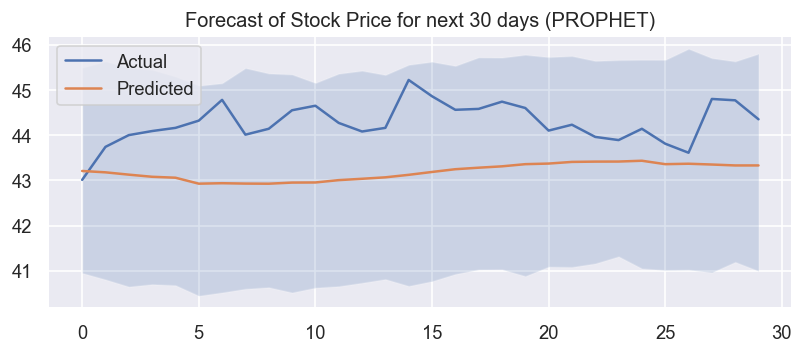

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-622.574, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-622.578, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-624.549, Time=0.23 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-624.565, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-619.275, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-622.573, Time=0.34 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-622.276, Time=0.70 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-620.853, Time=0.12 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0] intercept
Total fit time: 2.146 seconds


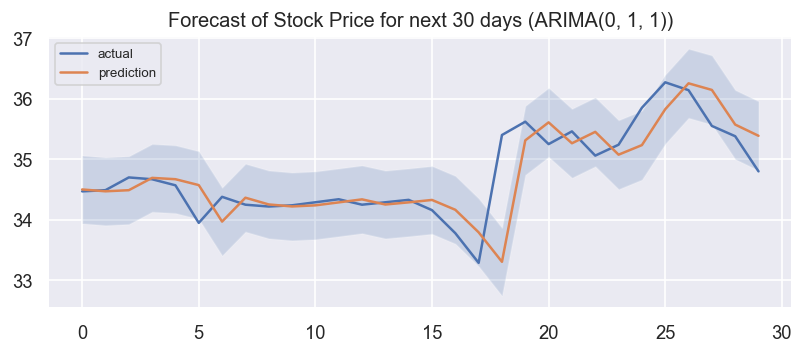

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -68.6475
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7972.36     0.0475393       5890.07      0.3865           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8071.94     0.0129012       1956.25           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8120.45    0.00960766       1126.74           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8130.37    0.00437711       633.519           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     440       8133.25     0.0001544        516.51    2.22e-07       0.001      552  LS failed, Hessian reset 
     499       8135.07   0.000244569    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  31.479511   29.511068   32.872072    31.479511    31.479511   
1  2017-10-03  31.487335   29.612405   32.776922    31.487335    31.487335   
2  2017-10-04  31.495159   29.678087   32.964073    31.495159    31.495159   
3  2017-10-05  31.502983   29.561488   32.784137    31.502983    31.502983   
4  2017-10-06  31.510807   29.617156   32.836458    31.510807    31.510807   
5  2017-10-09  31.534279   29.503847   32.735863    31.534279    31.534279   
6  2017-10-10  31.542103   29.627134   32.792950    31.542103    31.542103   
7  2017-10-11  31.549927   29.659846   32.800980    31.549927    31.549927   
8  2017-10-12  31.557751   29.655915   32.711412    31.557751    31.557751   
9  2017-10-13  31.565575   29.622967   32.768956    31.565575    31.565575   
10 2017-10-16  31.589047   29.522283   32.847874    31.589047    31.589047   
11 2017-10-17  31.596871   29.601491   32.791212    31.596871   

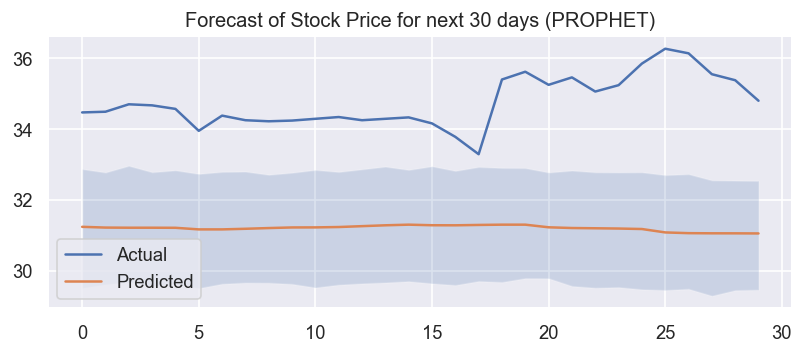

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3638.354, Time=0.99 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3638.743, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3639.310, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3639.261, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3636.887, Time=0.16 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.747 seconds


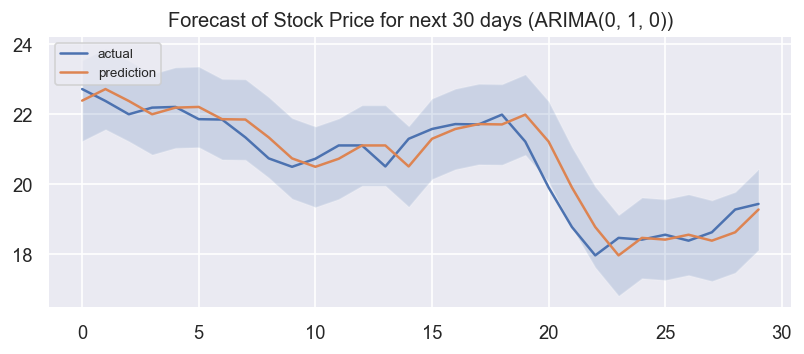

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -35.7067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5836.71    0.00403837        297.63           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5907.35     0.0217377       478.753           1           1      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6034.47     0.0365372        455.87           1           1      327   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     387       6074.63   0.000171303       180.905   1.052e-06       0.001      468  LS failed, Hessian reset 
     399       6077.23     0.0100097       492.507           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        6100.8     0.0115593    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.253690   19.483900   24.483017    22.253690    22.253690   
1  2017-10-03  22.249695   19.421631   24.388845    22.249695    22.249695   
2  2017-10-04  22.245701   19.417131   24.412850    22.245701    22.245701   
3  2017-10-05  22.241707   19.521155   24.516483    22.241707    22.241707   
4  2017-10-06  22.237713   19.599963   24.553259    22.237713    22.237713   
5  2017-10-09  22.225730   19.088776   24.310900    22.225730    22.225730   
6  2017-10-10  22.221736   19.388478   24.551335    22.221736    22.221736   
7  2017-10-11  22.217742   19.285661   24.292361    22.217742    22.217742   
8  2017-10-12  22.213747   19.243547   24.433595    22.213747    22.213747   
9  2017-10-13  22.209753   19.416169   24.321846    22.209753    22.209753   
10 2017-10-16  22.197770   19.226208   24.380257    22.197770    22.197770   
11 2017-10-17  22.193776   19.386333   24.402739    22.193776   

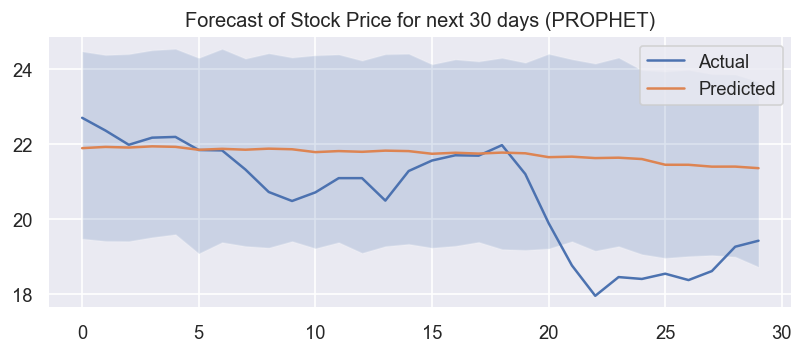

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9944.034, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9941.804, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9942.034, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9942.035, Time=0.16 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9939.981, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.578 seconds


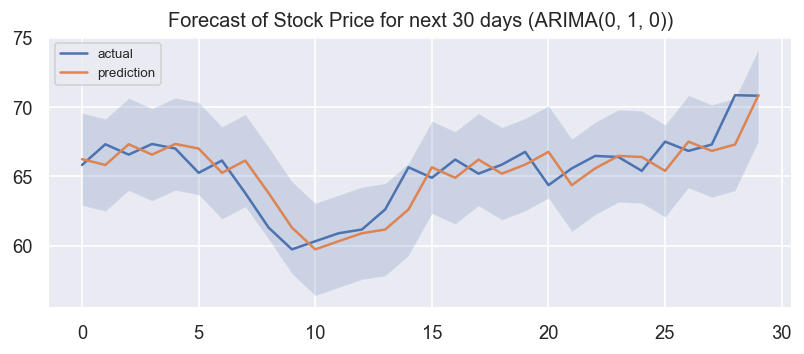

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -60.0762
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7471.77     0.0079844       762.328       1.627      0.1627      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7883.14    0.00921362       2717.56           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7992.99    0.00236388       2148.44      0.5996      0.5996      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     315       7998.55   0.000473857       352.008   1.841e-06       0.001      410  LS failed, Hessian reset 
     399       8029.88    0.00274412       388.416           1           1      498   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8058.03    0.00107684    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  53.037622   45.134311   58.322645    53.037622    53.037622   
1  2017-10-03  52.941910   45.812918   58.293796    52.941910    52.941910   
2  2017-10-04  52.846199   45.413924   58.111727    52.846199    52.846199   
3  2017-10-05  52.750487   45.240703   58.366436    52.750487    52.750487   
4  2017-10-06  52.654776   44.715425   58.023390    52.654776    52.654776   
5  2017-10-09  52.367641   44.829534   57.507671    52.367641    52.367641   
6  2017-10-10  52.271930   44.377225   57.118159    52.271930    52.271930   
7  2017-10-11  52.176218   43.708235   57.512188    52.176218    52.176218   
8  2017-10-12  52.080507   44.647551   57.715392    52.080507    52.080507   
9  2017-10-13  51.984795   44.995705   57.944857    51.984795    51.984795   
10 2017-10-16  51.697661   44.274037   57.669093    51.697661    51.697661   
11 2017-10-17  51.601950   43.923535   57.763331    51.601950   

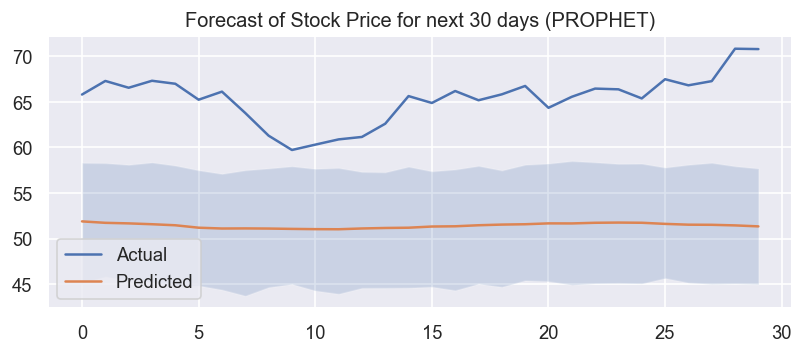

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=335.955, Time=0.51 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=25970.195, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.33 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=inf, Time=0.16 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=341.337, Time=0.56 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=335.491, Time=0.73 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=18267.224, Time=0.31 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=339.644, Time=1.12 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=337.074, Time=0.94 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=15270.149, Time=0.63 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=339.445, Time=1.19 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=335.611, Time=0.71 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0]          
Total fit time: 7.214 seconds


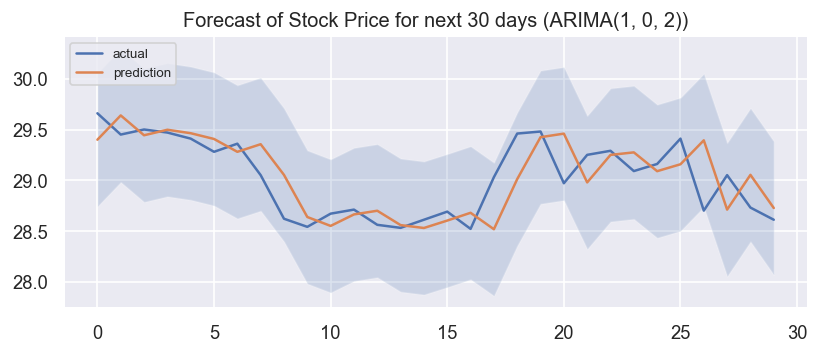

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -6.5332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8391.13     0.0054201       2288.16      0.2111           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8422.91    0.00454972        863.67      0.4133      0.4133      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8446.45    0.00709158       603.899      0.7362      0.7362      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8467.65    0.00328723       122.868           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8475.15   0.000811866        193.14       0.234           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  29.173554   27.047613   29.744160    29.173554    29.173554   
1  2017-10-03  29.178256   27.019866   29.678326    29.178256    29.178256   
2  2017-10-04  29.182958   27.071975   29.693304    29.182958    29.182958   
3  2017-10-05  29.187661   27.112277   29.687352    29.187661    29.187661   
4  2017-10-06  29.192363   27.138581   29.781968    29.192363    29.192363   
5  2017-10-09  29.206470   27.225908   29.796587    29.206470    29.206470   
6  2017-10-10  29.211172   27.185909   29.905518    29.211172    29.211172   
7  2017-10-11  29.215874   27.246460   29.838848    29.215874    29.215874   
8  2017-10-12  29.220576   27.296112   29.969408    29.220576    29.220576   
9  2017-10-13  29.225279   27.134726   29.864699    29.225279    29.225279   
10 2017-10-16  29.239385   27.366581   29.916779    29.239385    29.239385   
11 2017-10-17  29.244088   27.272030   29.962570    29.244088   

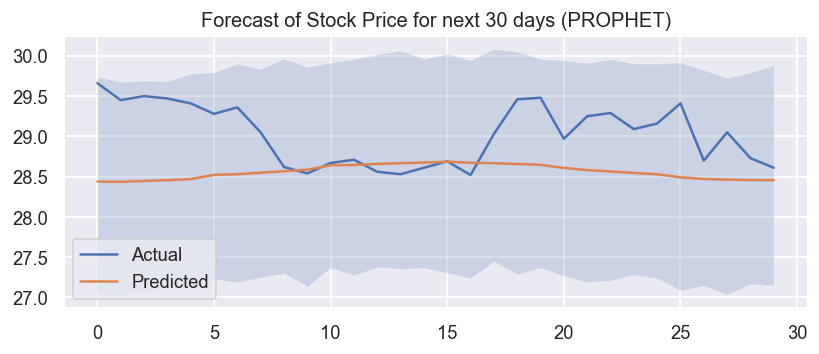

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4571.031, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4572.673, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4569.592, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4569.801, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4571.159, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4570.400, Time=0.32 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4571.211, Time=0.79 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4568.040, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=4568.831, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4569.455, Time=0.35 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4568.252, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4569.673, Time=0.15 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.793 seconds


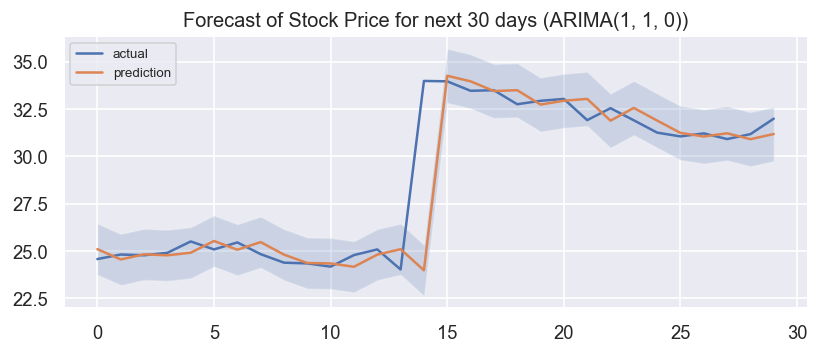

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -31.4954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6428.79      0.208312        7308.9           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6770.27     0.0122623       1575.84      0.4898      0.4898      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6870.64    0.00208272       192.163      0.6165      0.6165      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6918.78    0.00502259       286.935           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6949.69    0.00444471       340.865      0.1282           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.245392   19.706428   26.159790    22.245392    22.245392   
1  2017-10-03  22.229899   19.532758   26.131092    22.229899    22.229899   
2  2017-10-04  22.214406   19.411292   25.972039    22.214406    22.214406   
3  2017-10-05  22.198913   19.485420   25.722195    22.198913    22.198913   
4  2017-10-06  22.183420   19.317634   25.755517    22.183420    22.183420   
5  2017-10-09  22.136942   19.202969   25.798665    22.136942    22.136942   
6  2017-10-10  22.121449   18.922868   25.550662    22.121449    22.121449   
7  2017-10-11  22.105956   18.975999   25.459792    22.105956    22.105956   
8  2017-10-12  22.090463   19.051059   25.678454    22.090463    22.090463   
9  2017-10-13  22.074970   19.048500   25.628422    22.074970    22.074970   
10 2017-10-16  22.028491   18.879507   25.163732    22.028491    22.028491   
11 2017-10-17  22.012998   19.047486   25.435136    22.012998   

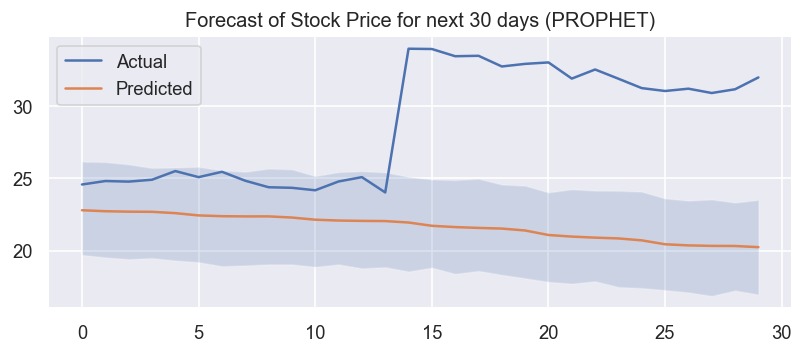

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5593.832, Time=0.72 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5635.314, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5630.105, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5628.497, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5633.740, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5594.645, Time=0.74 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=5594.389, Time=0.84 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=5602.959, Time=0.30 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5608.091, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=5595.386, Time=1.43 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=5593.080, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=5626.981, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=5628.576, Time=0.06 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=5593.527, Time=0.25 sec
 ARIMA(1,1,2)(0,0,0)[0]          

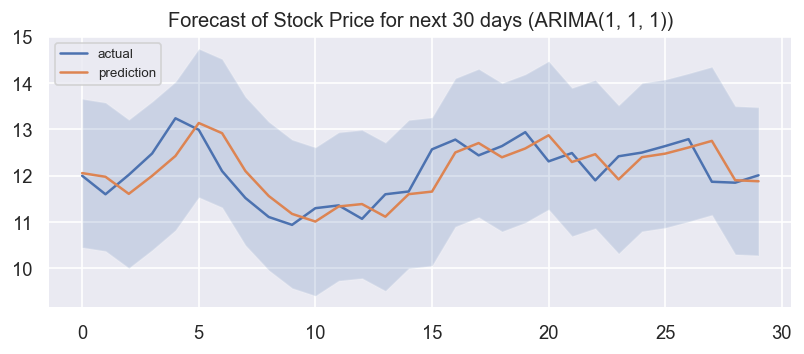

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -95.5063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6841.59     0.0453985       1800.59           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6983.83    0.00102251       462.541      0.6097      0.6097      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7044.57      0.057149       717.466           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     335       7062.16   0.000164932       318.106   4.322e-07       0.001      422  LS failed, Hessian reset 
     399        7082.5    0.00108588       473.787      0.3621           1      496   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7098.37     0.0168285    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  11.119779    9.458973   14.517539    11.119779    11.119779   
1  2017-10-03  11.128990    9.487843   14.567028    11.128990    11.128990   
2  2017-10-04  11.138201    9.671828   14.763079    11.138201    11.138201   
3  2017-10-05  11.147412    9.633391   14.777089    11.147412    11.147412   
4  2017-10-06  11.156623    9.545047   14.701412    11.156623    11.156623   
5  2017-10-09  11.184255    9.351724   14.301125    11.184255    11.184255   
6  2017-10-10  11.193466    9.350286   14.624646    11.193466    11.193466   
7  2017-10-11  11.202677    9.451748   14.289889    11.202677    11.202677   
8  2017-10-12  11.211888    9.527301   14.352897    11.211888    11.211888   
9  2017-10-13  11.221099    9.411637   14.512967    11.221099    11.221099   
10 2017-10-16  11.248731    9.058333   14.314853    11.248731    11.248731   
11 2017-10-17  11.257942    9.296382   14.396031    11.257942   

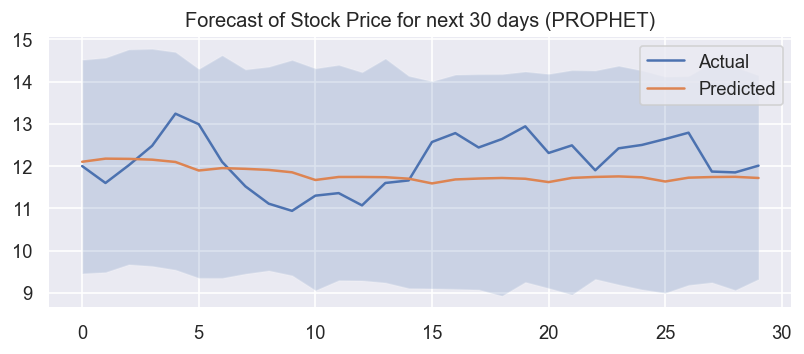

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3502.950, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3499.009, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3500.951, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3500.949, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3499.795, Time=0.10 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.017 seconds


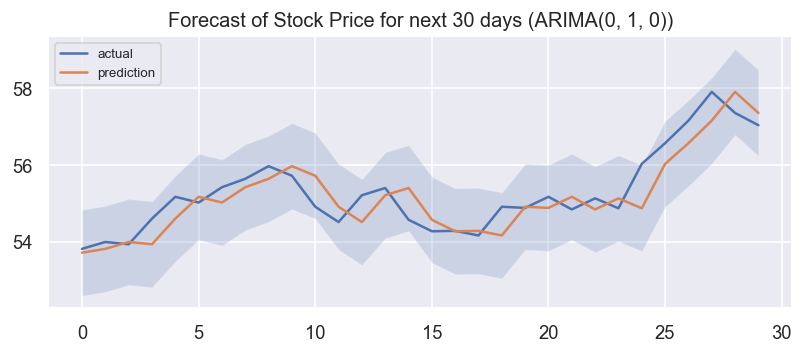

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -50.0578
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7919.03     0.0363786       987.076           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8395.17     0.0140657       2095.58       0.216           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8656.12    0.00166102       1200.52      0.9164      0.9164      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8812.12    0.00957234       1020.79      0.9969      0.9969      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8867.74    0.00478527       623.196           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  57.311063   55.303120   59.327829    57.311063    57.311063   
1  2017-10-03  57.315283   55.411353   59.201013    57.315283    57.315283   
2  2017-10-04  57.319503   55.441096   59.345702    57.319503    57.319503   
3  2017-10-05  57.323723   55.409080   59.227977    57.323723    57.323723   
4  2017-10-06  57.327943   55.545889   59.199328    57.327943    57.327943   
5  2017-10-09  57.340604   55.429554   59.356318    57.340604    57.340604   
6  2017-10-10  57.344824   55.384137   59.401877    57.344824    57.344824   
7  2017-10-11  57.349044   55.597891   59.223625    57.349044    57.349044   
8  2017-10-12  57.353264   55.464767   59.208693    57.353264    57.353264   
9  2017-10-13  57.357485   55.397422   59.344717    57.357485    57.357485   
10 2017-10-16  57.370145   55.634216   59.509317    57.370145    57.370145   
11 2017-10-17  57.374365   55.504768   59.428111    57.374365   

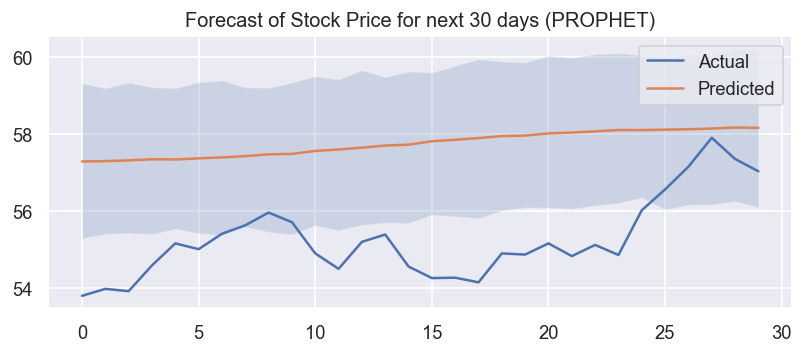

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2255.510, Time=0.63 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2265.342, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2257.525, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2258.170, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2263.825, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2257.293, Time=1.19 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2257.281, Time=0.78 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2256.436, Time=0.28 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2255.993, Time=0.17 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2258.122, Time=1.85 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=2254.032, Time=0.32 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=2256.710, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=2256.066, Time=0.15 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=2255.806, Time=0.39 sec
 ARIMA(1,1,2)(0,0,0)[0]          

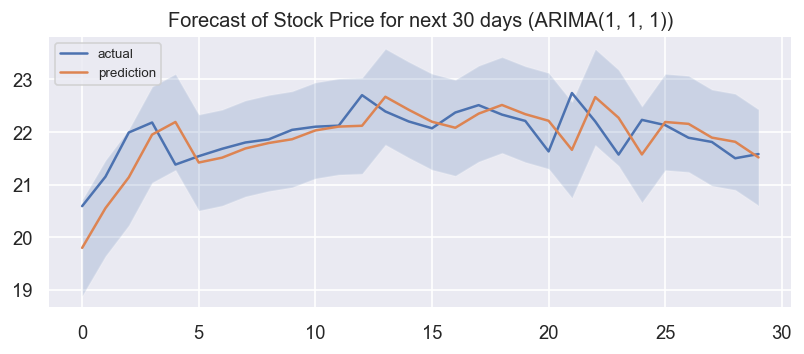

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -77.4914
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       4604.74     0.0591942       353.764      0.4054           1      110   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     189       4747.83   0.000317148        161.52    2.05e-06       0.001      251  LS failed, Hessian reset 
     199       4756.74     0.0670705       415.917       0.989       0.989      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       4807.45        0.2558       497.263           1           1      380   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       4853.55    0.00306102           211           1           1      501   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     483       4868.98   0.000245548    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  18.111502   15.360330   19.857468    18.111502    18.111502   
1  2017-10-03  18.118296   15.488499   20.156846    18.118296    18.118296   
2  2017-10-04  18.125090   15.333734   19.871478    18.125090    18.125090   
3  2017-10-05  18.131884   15.339002   20.079882    18.131884    18.131884   
4  2017-10-06  18.138679   15.317246   20.014888    18.138679    18.138679   
5  2017-10-09  18.159062   15.353735   20.096774    18.159062    18.159062   
6  2017-10-10  18.165856   15.546761   20.020060    18.165856    18.165856   
7  2017-10-11  18.172650   15.425854   20.061221    18.172650    18.172650   
8  2017-10-12  18.179445   15.450651   19.947914    18.179445    18.179445   
9  2017-10-13  18.186239   15.666524   20.068919    18.186239    18.186239   
10 2017-10-16  18.206622   15.474916   20.025003    18.206622    18.206622   
11 2017-10-17  18.213416   15.691586   20.049872    18.213416   

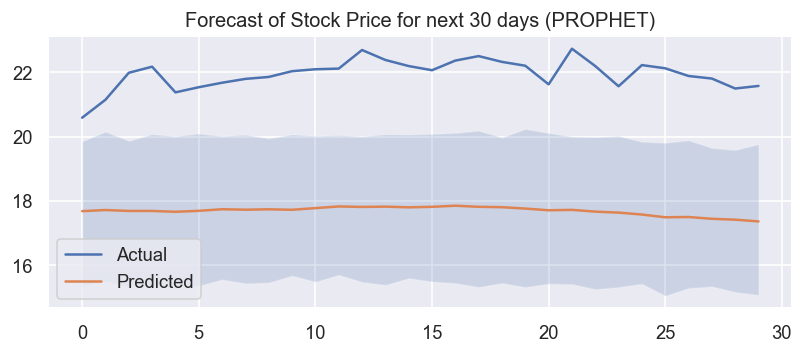

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2173.769, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2171.791, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2172.334, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2172.385, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2169.795, Time=0.09 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.001 seconds


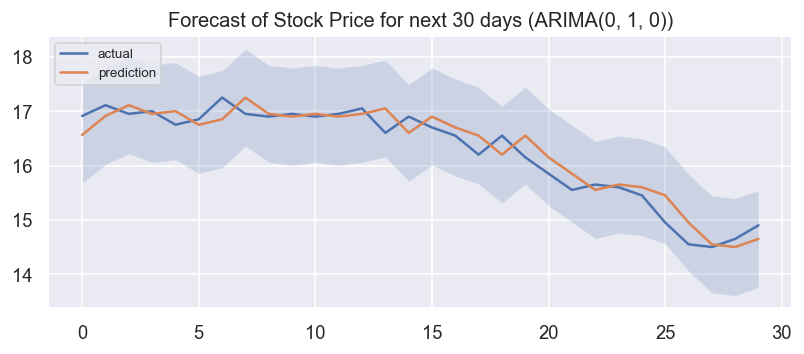

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -30.4225
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6048.25     0.0311923       601.159           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6070.61     0.0155308       382.278           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6082.14    0.00469727       81.6602           1           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6089.22     0.0118845       168.725       0.648       0.648      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6093.24    0.00316569       147.312           1           1      603   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  24.002795   20.581084   26.230119    24.002795    24.002795   
1  2017-10-03  24.008238   20.459020   26.476070    24.008238    24.008238   
2  2017-10-04  24.013680   20.427303   26.304838    24.013680    24.013680   
3  2017-10-05  24.019123   20.746772   26.603779    24.019123    24.019123   
4  2017-10-06  24.024566   20.551266   26.381689    24.024566    24.024566   
5  2017-10-09  24.040893   20.699655   26.480045    24.040893    24.040893   
6  2017-10-10  24.046336   20.934635   26.400362    24.046336    24.046336   
7  2017-10-11  24.051779   20.540327   26.484603    24.051779    24.051779   
8  2017-10-12  24.057221   20.906689   26.363296    24.057221    24.057221   
9  2017-10-13  24.062664   20.734698   26.732435    24.062664    24.062664   
10 2017-10-16  24.078992   20.727430   26.460412    24.078992    24.078992   
11 2017-10-17  24.084434   20.906069   26.456733    24.084434   

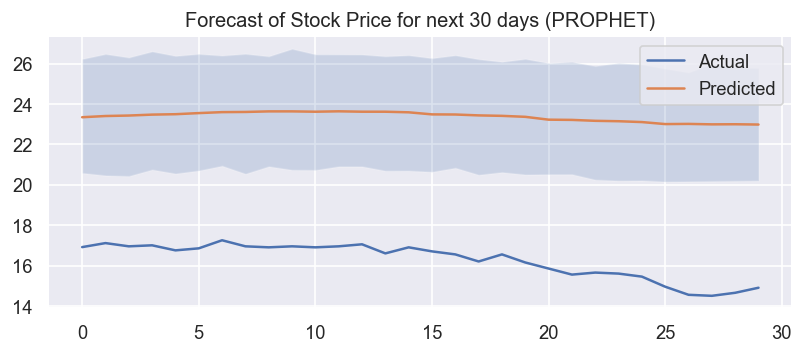

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7152.779, Time=0.88 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7152.566, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7152.081, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7151.902, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7150.649, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.434 seconds


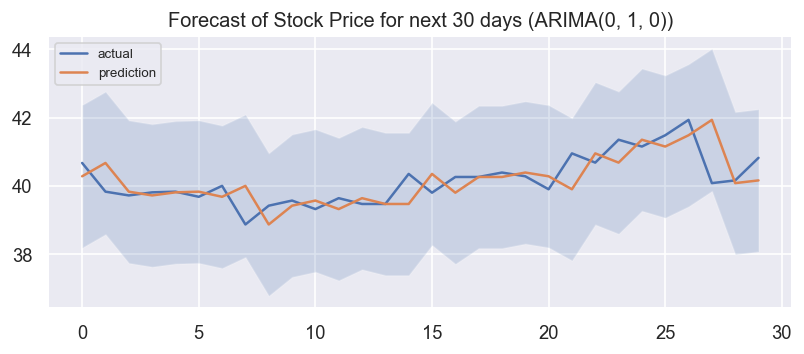

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -37.2657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6387.65     0.0210906       1642.13      0.4862      0.4862      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6665.61     0.0488389       2013.66      0.3248           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6723.39     0.0465127       267.964           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6765.99    0.00138246       219.202      0.4432      0.4432      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6777.49    0.00172497       512.694           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  43.002444   36.688168   45.012076    43.002444    43.002444   
1  2017-10-03  43.016407   36.754248   45.187865    43.016407    43.016407   
2  2017-10-04  43.030370   36.680271   45.313110    43.030370    43.030370   
3  2017-10-05  43.044333   36.423232   44.635583    43.044333    43.044333   
4  2017-10-06  43.058296   36.467779   45.123109    43.058296    43.058296   
5  2017-10-09  43.100185   36.669690   45.420458    43.100185    43.100185   
6  2017-10-10  43.114148   36.619655   44.986350    43.114148    43.114148   
7  2017-10-11  43.128111   36.480720   45.186443    43.128111    43.128111   
8  2017-10-12  43.142074   36.534999   45.051286    43.142074    43.142074   
9  2017-10-13  43.156037   36.645758   44.777841    43.156037    43.156037   
10 2017-10-16  43.197926   36.690728   45.478852    43.197926    43.197926   
11 2017-10-17  43.211889   36.947263   45.492378    43.211889   

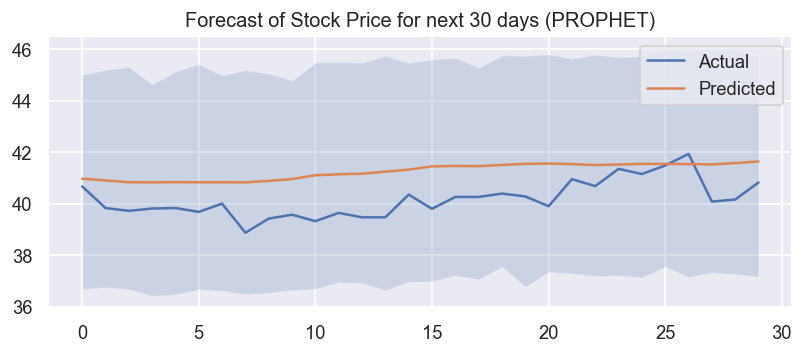

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5330.426, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5326.541, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5327.917, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5327.928, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5324.830, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.941 seconds


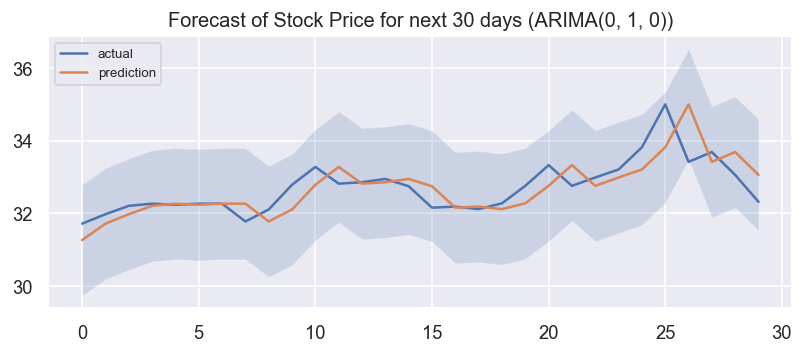

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -33.5034
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5666.78     0.0362387       669.547           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5848.44      0.130892       565.305           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5916.94    0.00171154       260.504           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5952.15    0.00122741       147.785           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     496       5989.74   0.000865417       127.348   3.084e-06       0.001      617  LS failed, Hessian reset 
     499       5990.03    0.00186936    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  33.835732   29.926325   38.016673    33.835732    33.835732   
1  2017-10-03  33.837348   29.995109   38.220409    33.837348    33.837348   
2  2017-10-04  33.838963   30.188714   38.236832    33.838963    33.838963   
3  2017-10-05  33.840579   29.867847   38.596407    33.840579    33.840579   
4  2017-10-06  33.842195   30.121034   38.498379    33.842195    33.842195   
5  2017-10-09  33.847042   30.319561   38.674559    33.847042    33.847042   
6  2017-10-10  33.848658   30.491298   38.534210    33.848658    33.848658   
7  2017-10-11  33.850273   30.474422   38.534785    33.850273    33.850273   
8  2017-10-12  33.851889   30.743434   38.844757    33.851889    33.851889   
9  2017-10-13  33.853505   30.914610   39.141465    33.853505    33.853505   
10 2017-10-16  33.858352   30.737655   39.298754    33.858352    33.858352   
11 2017-10-17  33.859967   31.198910   39.064782    33.859967   

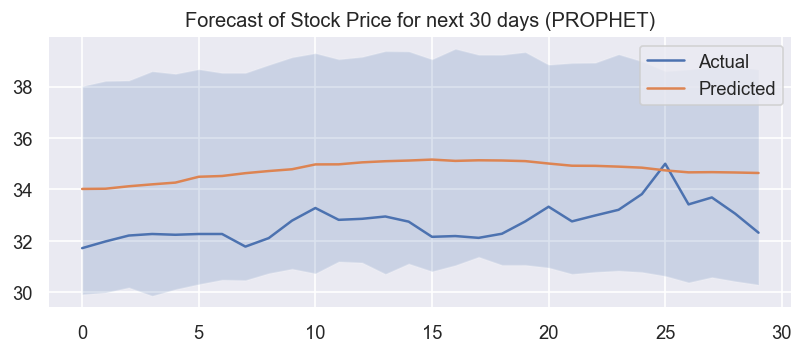

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9885.250, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9890.982, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9883.251, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9883.282, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9889.548, Time=0.04 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=9885.250, Time=0.16 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=9887.251, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=9881.756, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=9883.756, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=9883.756, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=9881.791, Time=0.06 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=9885.756, Time=0.09 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 1.347 seconds


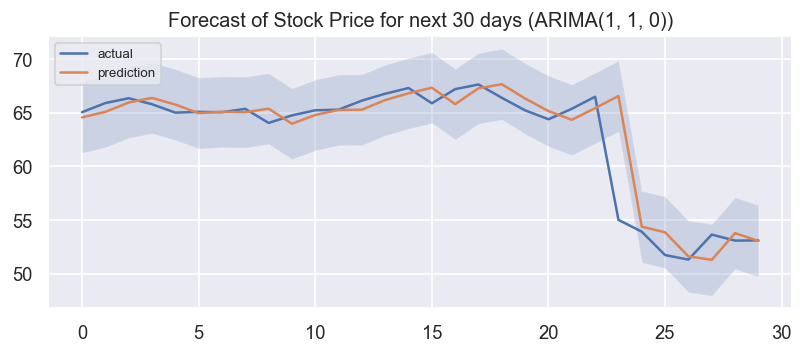

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -34.3766
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5156.26    0.00933108       517.698      0.4817      0.4817      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5262.58      0.193364       383.729           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5337.97     0.0128418       180.548           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5387.21    0.00495837       394.533           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5407.39    0.00429981       755.417     0.01361           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  54.624056   45.772925   63.756939    54.624056    54.624056   
1  2017-10-03  54.610188   45.377048   63.051490    54.610188    54.610188   
2  2017-10-04  54.596320   44.956861   63.082099    54.596320    54.596320   
3  2017-10-05  54.582452   45.559098   62.899310    54.582452    54.582452   
4  2017-10-06  54.568584   44.370436   62.352797    54.568584    54.568584   
5  2017-10-09  54.526980   44.781504   62.125958    54.526980    54.526980   
6  2017-10-10  54.513112   44.855754   62.484564    54.513112    54.513112   
7  2017-10-11  54.499243   44.735203   62.124758    54.499243    54.499243   
8  2017-10-12  54.485375   44.016438   61.624303    54.485375    54.485375   
9  2017-10-13  54.471507   44.803479   61.910365    54.471507    54.471507   
10 2017-10-16  54.429903   44.365958   62.211033    54.429903    54.429903   
11 2017-10-17  54.416035   44.243849   61.947823    54.416035   

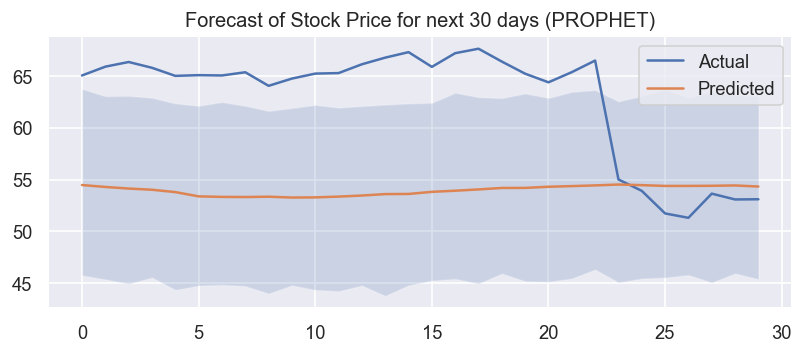

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7710.795, Time=0.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7708.052, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7709.387, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7709.406, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7706.753, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.978 seconds


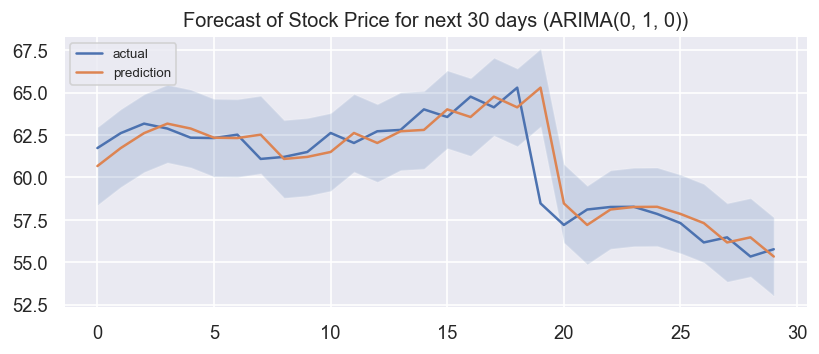

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -40.5758
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5980.87     0.0543728       3483.61      0.1582      0.9318      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6216.07      0.145906        1284.1           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6322.78    0.00738848       545.396           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6343.19     0.0125995       300.245           1           1      478   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     464       6348.58   0.000499766       125.296   6.037e-06       0.001      596  LS failed, Hessian reset 
     499       6349.76     0.0102238    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  58.709525   51.271282   61.035523    58.709525    58.709525   
1  2017-10-03  58.719545   51.305994   60.970444    58.719545    58.719545   
2  2017-10-04  58.729565   51.306280   61.513277    58.729565    58.729565   
3  2017-10-05  58.739586   51.399467   60.952200    58.739586    58.739586   
4  2017-10-06  58.749606   51.199794   61.395043    58.749606    58.749606   
5  2017-10-09  58.779667   51.716231   61.252228    58.779667    58.779667   
6  2017-10-10  58.789687   51.466491   61.034053    58.789687    58.789687   
7  2017-10-11  58.799708   51.624386   61.699379    58.799708    58.799708   
8  2017-10-12  58.809728   51.600720   61.322239    58.809728    58.809728   
9  2017-10-13  58.819748   51.584003   61.352839    58.819748    58.819748   
10 2017-10-16  58.849809   51.796725   61.359246    58.849809    58.849809   
11 2017-10-17  58.859829   51.936769   61.966333    58.859829   

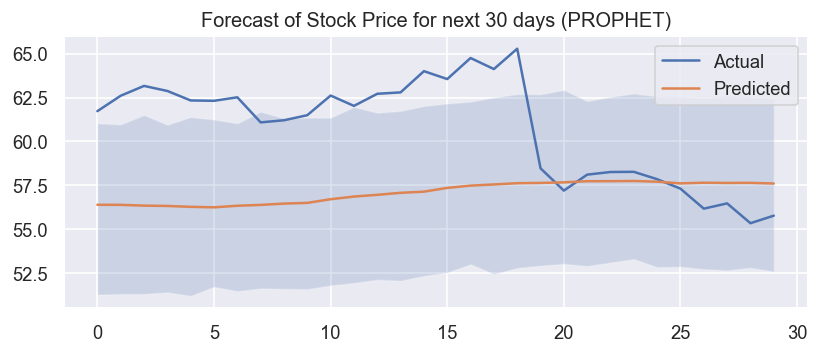

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3333.919, Time=0.81 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3337.364, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3337.724, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3337.508, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3337.763, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3324.042, Time=0.99 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3329.982, Time=0.16 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3325.792, Time=0.97 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3325.810, Time=0.82 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3324.150, Time=0.37 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3326.551, Time=0.32 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3327.747, Time=0.97 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=3325.479, Time=0.29 sec

Best model:  ARIMA(2,1,1)(0,0,0)[0] intercept
Total fit time: 6.295 seconds


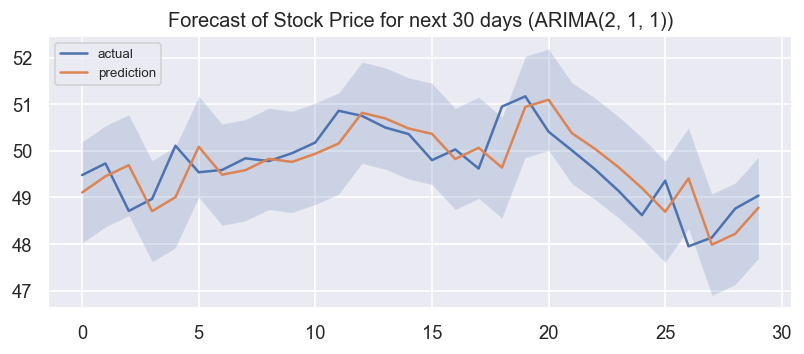

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -86.2678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       8423.45    0.00315371       1564.76           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8584.92     0.0196991       2358.41           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8664.05     0.0230575       788.944           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8703.53    0.00139002       519.102           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       8721.44   0.000656626       614.003      0.5529      0.5529      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  49.617349   46.878970   50.486185    49.617349    49.617349   
1  2017-10-03  49.635295   46.887478   50.544807    49.635295    49.635295   
2  2017-10-04  49.653242   46.747155   50.451499    49.653242    49.653242   
3  2017-10-05  49.671188   46.834040   50.407305    49.671188    49.671188   
4  2017-10-06  49.689134   46.886131   50.477778    49.689134    49.689134   
5  2017-10-09  49.742973   46.677190   50.112421    49.742973    49.742973   
6  2017-10-10  49.760920   46.845919   50.386348    49.760920    49.760920   
7  2017-10-11  49.778866   46.718824   50.244632    49.778866    49.778866   
8  2017-10-12  49.796812   46.689919   50.155983    49.796812    49.796812   
9  2017-10-13  49.814759   46.700108   50.363621    49.814759    49.814759   
10 2017-10-16  49.868598   46.635047   50.151187    49.868598    49.868598   
11 2017-10-17  49.886544   46.740233   50.279352    49.886544   

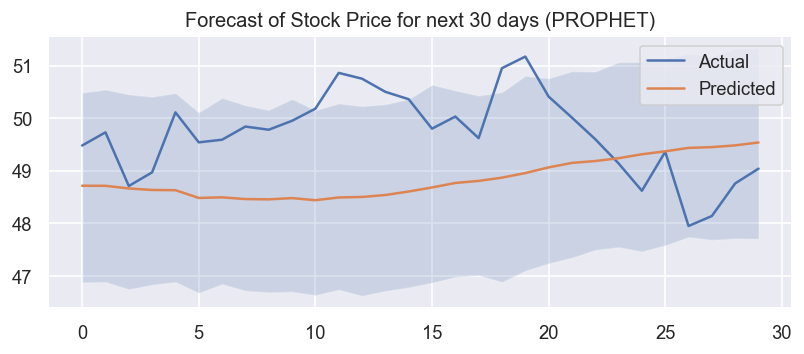

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4685.208, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4689.675, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4683.208, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4683.217, Time=0.14 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4687.781, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4685.208, Time=0.17 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4687.208, Time=0.34 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4681.326, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=4683.326, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4683.326, Time=0.22 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4681.335, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4685.325, Time=0.13 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 1.854 seconds


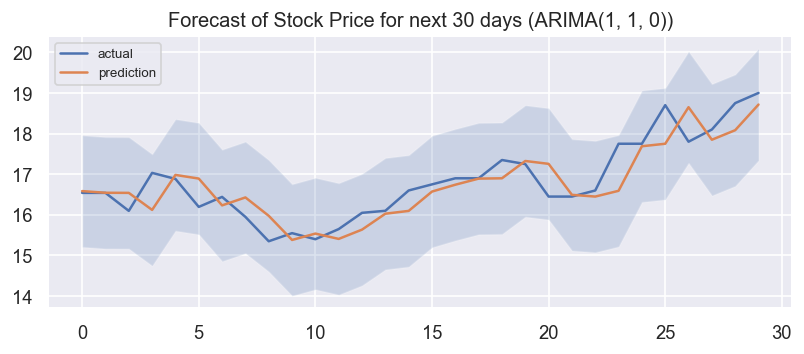

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -156.348
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7055.46     0.0256205       1394.74           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7165.77      0.010587       227.087           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7214.02    0.00122302       673.629      0.7822      0.7822      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7231.16    0.00183398       220.753           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7260.66     0.0050506       1009.24      0.1946           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  12.610221    9.681766   14.568624    12.610221    12.610221   
1  2017-10-03  12.582966    9.518558   14.933688    12.582966    12.582966   
2  2017-10-04  12.555711    9.443934   14.509596    12.555711    12.555711   
3  2017-10-05  12.528456    9.342631   14.611211    12.528456    12.528456   
4  2017-10-06  12.501201    9.625808   14.747171    12.501201    12.501201   
5  2017-10-09  12.419436    9.099244   14.077413    12.419436    12.419436   
6  2017-10-10  12.392182    9.116367   14.253541    12.392182    12.392182   
7  2017-10-11  12.364927    8.809206   14.165187    12.364927    12.364927   
8  2017-10-12  12.337672    9.012460   14.080611    12.337672    12.337672   
9  2017-10-13  12.310417    8.878741   14.066387    12.310417    12.310417   
10 2017-10-16  12.228652    8.668112   13.768240    12.228652    12.228652   
11 2017-10-17  12.201397    8.694677   14.080647    12.201397   

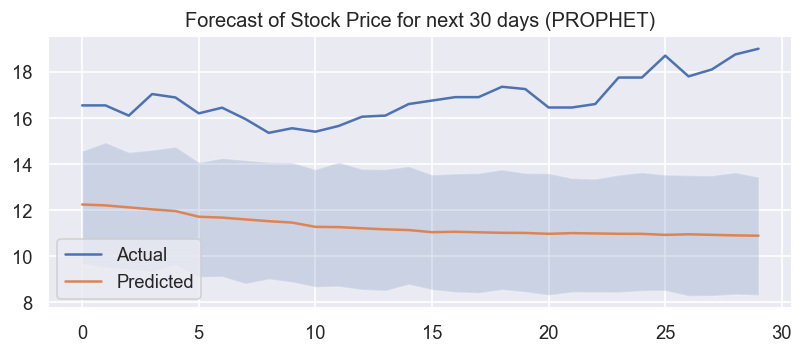

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4108.508, Time=0.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4145.971, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4113.914, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4111.668, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4143.979, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4102.248, Time=0.96 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4112.208, Time=0.19 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4104.224, Time=1.60 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4108.728, Time=2.53 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4102.266, Time=1.43 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=4113.505, Time=0.30 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=4106.177, Time=1.39 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4100.264, Time=0.31 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4106.523, Time=0.26 sec
 ARIMA(2,1,0)(0,0,0)[0]          

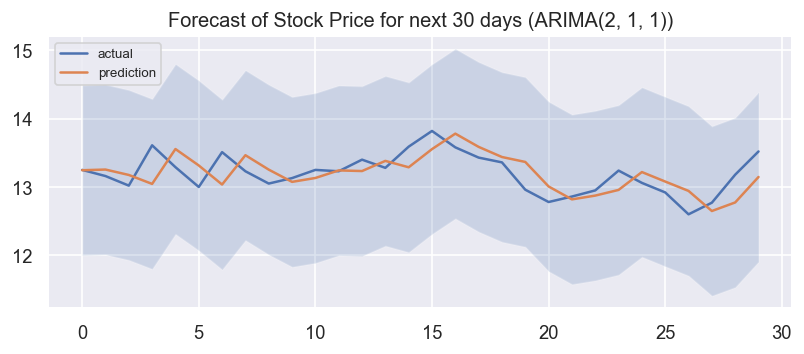

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -104.637
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6701.81     0.0883064       5351.71      0.3872           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6996.52     0.0415857       1095.29           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7045.35    0.00219786       281.047           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     358        7057.2   0.000458993       117.887    3.47e-06       0.001      460  LS failed, Hessian reset 
     399       7062.86     0.0371248       435.634           1           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     408       7063.71   6.46592e-05    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  18.366188   15.833618   21.196526    18.366188    18.366188   
1  2017-10-03  18.343178   15.927081   20.857373    18.343178    18.343178   
2  2017-10-04  18.320167   15.871002   20.970590    18.320167    18.320167   
3  2017-10-05  18.297157   15.913904   21.058568    18.297157    18.297157   
4  2017-10-06  18.274147   15.929576   20.896435    18.274147    18.274147   
5  2017-10-09  18.205116   15.630336   20.809061    18.205116    18.205116   
6  2017-10-10  18.182106   15.932306   21.002631    18.182106    18.182106   
7  2017-10-11  18.159095   15.811844   20.689728    18.159095    18.159095   
8  2017-10-12  18.136085   15.704724   20.755032    18.136085    18.136085   
9  2017-10-13  18.113075   15.751880   20.796006    18.113075    18.113075   
10 2017-10-16  18.044044   15.645150   20.636566    18.044044    18.044044   
11 2017-10-17  18.021034   15.714061   20.584819    18.021034   

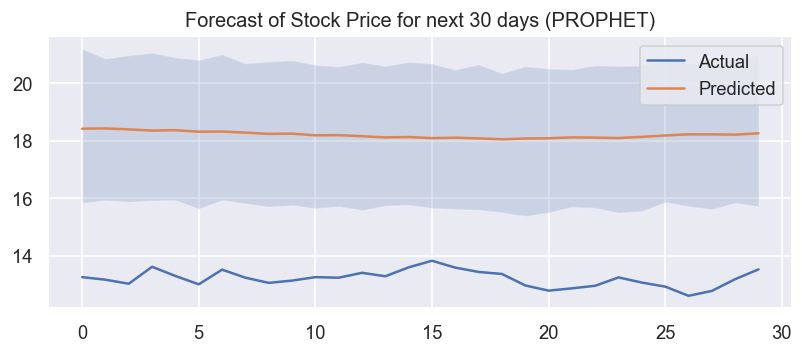

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9589.133, Time=0.77 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9586.375, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9588.195, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9588.200, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9585.561, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.121 seconds


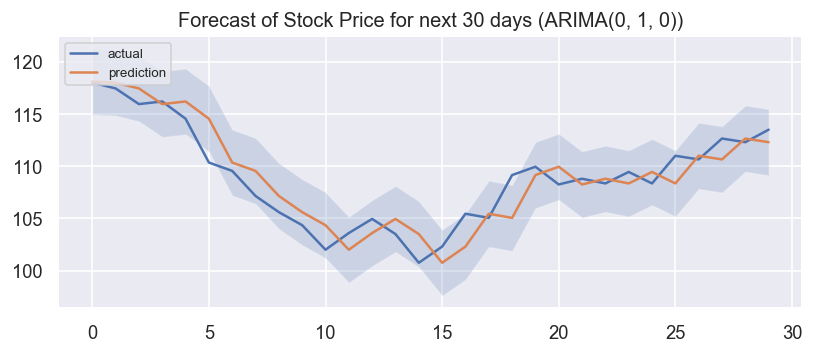

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -124.767
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6977.06    0.00897797       282.785      0.9291      0.9291      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7128.29    0.00451821       732.769           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7240.29     0.0184126       888.035           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7271.66    0.00376802       400.145      0.1041           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7279.21   0.000737193       201.656      0.7335      0.7335      589   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  112.480507  105.316899  119.803267   112.480507   112.480507   
1  2017-10-03  112.550470  105.088380  119.687722   112.550470   112.550470   
2  2017-10-04  112.620434  105.251321  119.988541   112.620434   112.620434   
3  2017-10-05  112.690397  105.540538  119.228622   112.690397   112.690397   
4  2017-10-06  112.760360  104.809573  119.572419   112.760360   112.760360   
5  2017-10-09  112.970251  105.611796  119.965880   112.970251   112.970251   
6  2017-10-10  113.040214  105.325570  119.235971   113.040214   113.040214   
7  2017-10-11  113.110177  105.193794  119.503530   113.110177   113.110177   
8  2017-10-12  113.180141  105.675088  119.758064   113.180141   113.180141   
9  2017-10-13  113.250104  105.304119  119.836284   113.250104   113.250104   
10 2017-10-16  113.459994  105.211632  119.114554   113.459994   113.459994   
11 2017-10-17  113.529957  105.345261  119.409127   

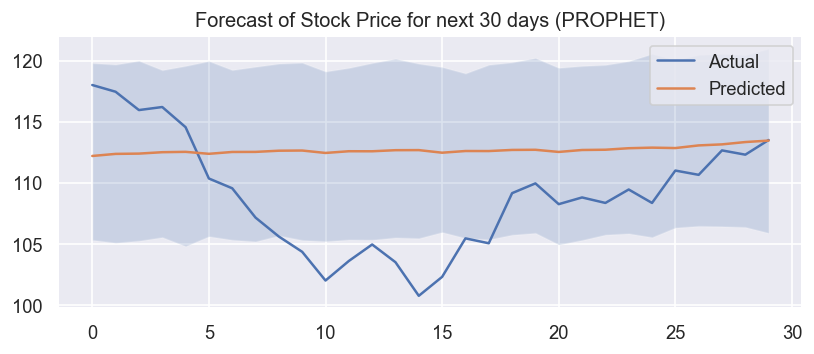

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-36.681, Time=0.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-34.898, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-38.106, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-38.188, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-36.407, Time=0.11 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-36.370, Time=0.33 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-36.541, Time=0.90 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-39.650, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-38.084, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-37.823, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-39.571, Time=0.18 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-38.014, Time=0.34 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 3.315 seconds


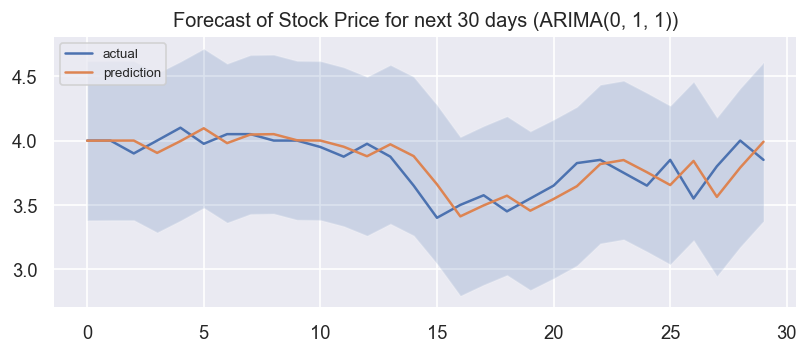

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -89.5902
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5783.28    0.00305544       541.009      0.2046      0.2046      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5998.21     0.0147773       1469.34           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6152.5     0.0243716       504.942           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       6190.29   0.000345609       230.351   3.839e-06       0.001      511  LS failed, Hessian reset 
     399       6190.32   0.000325779       163.465           1           1      512   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6206.87     0.0470474    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  1.942552    1.090005    3.822809     1.942552     1.942552   
1  2017-10-03  1.935608    1.058634    3.746115     1.935608     1.935608   
2  2017-10-04  1.928664    1.035661    3.816806     1.928664     1.928664   
3  2017-10-05  1.921721    0.957494    3.669101     1.921721     1.921721   
4  2017-10-06  1.914777    0.956342    3.840401     1.914777     1.914777   
5  2017-10-09  1.893945    0.820735    3.643851     1.893945     1.893945   
6  2017-10-10  1.887001    0.866177    3.620877     1.887001     1.887001   
7  2017-10-11  1.880058    0.859987    3.511670     1.880058     1.880058   
8  2017-10-12  1.873114    0.756715    3.539789     1.873114     1.873114   
9  2017-10-13  1.866170    0.655206    3.517289     1.866170     1.866170   
10 2017-10-16  1.845339    0.729730    3.499759     1.845339     1.845339   
11 2017-10-17  1.838395    0.696323    3.531524     1.838395     1.838395   

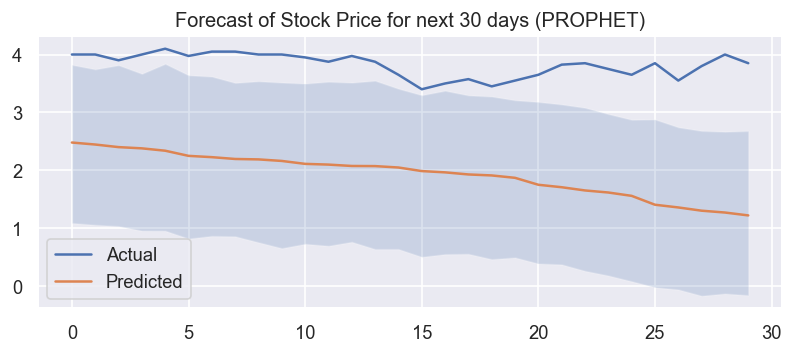

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4293.585, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4291.414, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4292.017, Time=0.71 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4292.030, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4289.761, Time=0.07 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.405 seconds


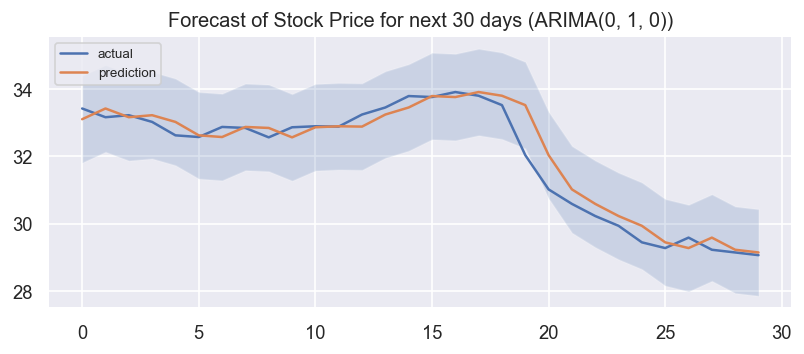

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -91.8982
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5403.94     0.0596197       1960.98      0.7525      0.7525      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5639.14     0.0209421       1068.52      0.1459           1      217   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5765.81     0.0437284       541.617      0.9883     0.09883      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5824.57     0.0140419       198.253           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       5847.78     0.0106267       373.196           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  34.054604   30.361493   35.977826    34.054604    34.054604   
1  2017-10-03  34.061229   30.507430   35.943679    34.061229    34.061229   
2  2017-10-04  34.067854   30.462484   35.666725    34.067854    34.067854   
3  2017-10-05  34.074479   30.613462   35.937323    34.074479    34.074479   
4  2017-10-06  34.081104   30.121435   36.030839    34.081104    34.081104   
5  2017-10-09  34.100978   30.270882   35.732974    34.100978    34.100978   
6  2017-10-10  34.107603   30.260223   35.918350    34.107603    34.107603   
7  2017-10-11  34.114228   30.363282   35.877903    34.114228    34.114228   
8  2017-10-12  34.120853   30.353454   35.604663    34.120853    34.120853   
9  2017-10-13  34.127478   30.336580   35.678869    34.127478    34.127478   
10 2017-10-16  34.147352   30.376619   35.771973    34.147352    34.147352   
11 2017-10-17  34.153977   30.452322   35.968856    34.153977   

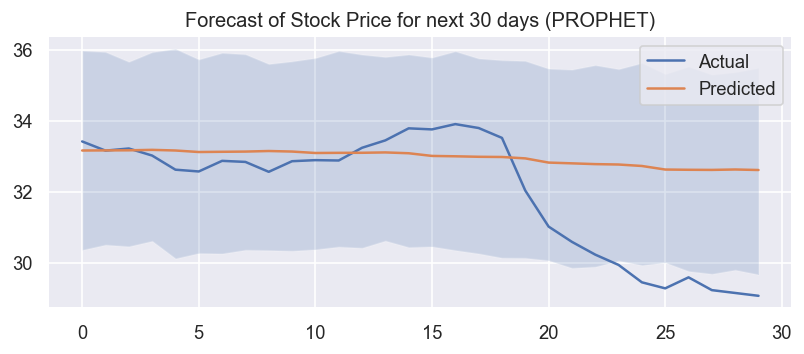

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7342.828, Time=0.46 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7341.497, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7341.845, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7341.714, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7347.412, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.029 seconds


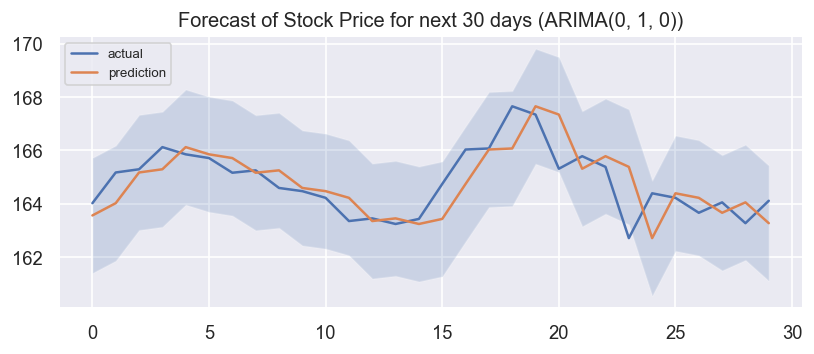

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -106.341
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9495.28     0.0068223       4639.76           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9922.11    0.00402275        2054.1      0.3465           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9998.08     0.0310811       3748.67           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       10054.3    0.00339896       1164.16      0.6587      0.6587      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       10078.1     0.0012438       219.442           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  153.529198  148.311098  156.061307   153.529198   153.529198   
1  2017-10-03  153.582941  148.381485  156.133685   153.582941   153.582941   
2  2017-10-04  153.636684  148.520648  155.899668   153.636684   153.636684   
3  2017-10-05  153.690428  148.204222  156.038877   153.690428   153.690428   
4  2017-10-06  153.744171  148.309855  156.245849   153.744171   153.744171   
5  2017-10-09  153.905400  148.331614  155.866918   153.905400   153.905400   
6  2017-10-10  153.959143  148.267073  155.840007   153.959143   153.959143   
7  2017-10-11  154.012886  148.362629  155.770907   154.012886   154.012886   
8  2017-10-12  154.066630  148.180097  155.765709   154.066630   154.066630   
9  2017-10-13  154.120373  148.220174  156.202308   154.120373   154.120373   
10 2017-10-16  154.281602  148.530512  156.109006   154.281602   154.281602   
11 2017-10-17  154.335345  148.150146  155.651665   

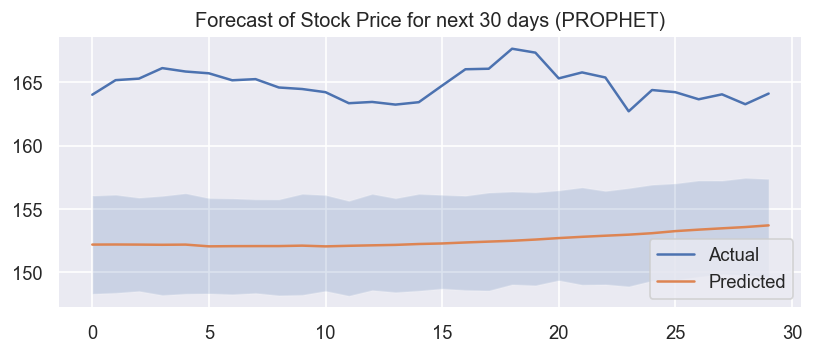

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3181.447, Time=0.85 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3180.309, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3181.596, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3181.717, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3181.039, Time=0.09 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-3180.641, Time=0.39 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-3181.407, Time=1.52 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3182.351, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3181.967, Time=0.24 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-3181.225, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3182.237, Time=0.14 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-3182.052, Time=0.50 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 4.575 seconds


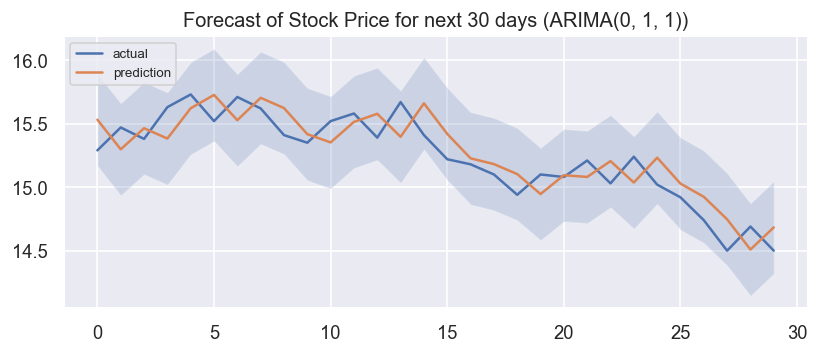

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -135.844
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7047.95     0.0997029        4660.1           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        7203.1    0.00442676       450.169           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7242.04    0.00472278       266.047       1.131      0.1131      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7256.64     0.0208889       306.648           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7268.13    0.00339779       94.0644           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  14.625650   13.307846   15.443171    14.625650    14.625650   
1  2017-10-03  14.632503   13.338269   15.304063    14.632503    14.632503   
2  2017-10-04  14.639355   13.344047   15.398518    14.639355    14.639355   
3  2017-10-05  14.646208   13.475058   15.312679    14.646208    14.646208   
4  2017-10-06  14.653061   13.400600   15.332636    14.653061    14.653061   
5  2017-10-09  14.673619   13.358160   15.296824    14.673619    14.673619   
6  2017-10-10  14.680472   13.339009   15.330863    14.680472    14.680472   
7  2017-10-11  14.687324   13.262546   15.351330    14.687324    14.687324   
8  2017-10-12  14.694177   13.412171   15.317419    14.694177    14.694177   
9  2017-10-13  14.701030   13.349202   15.308384    14.701030    14.701030   
10 2017-10-16  14.721588   13.299625   15.313206    14.721588    14.721588   
11 2017-10-17  14.728441   13.281791   15.296732    14.728441   

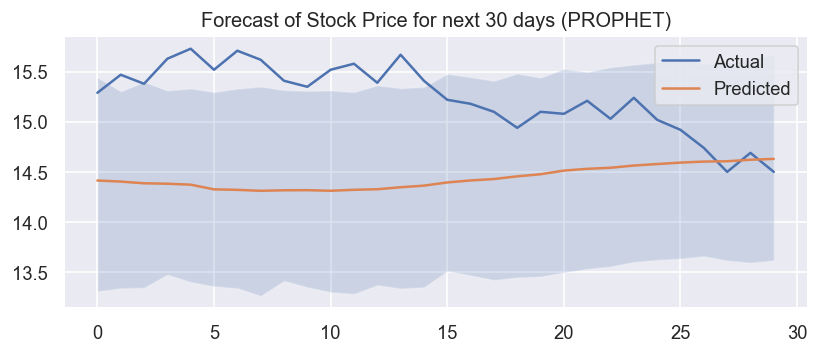

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7785.309, Time=0.78 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7783.511, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7784.842, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7784.875, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7785.100, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 1.416 seconds


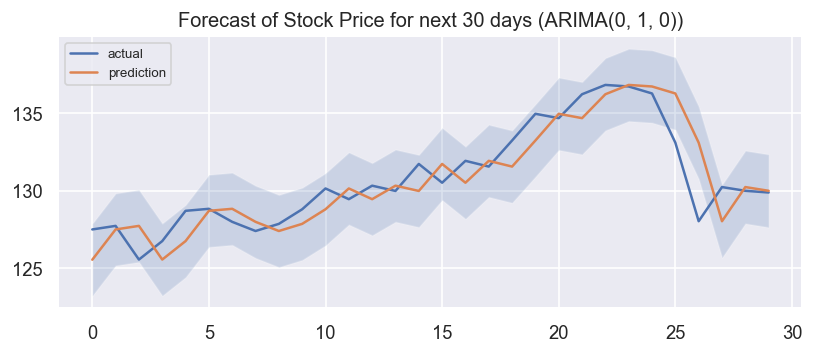

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -163.693
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        7596.5     0.0494688       765.803           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7720.01    0.00906555       1484.96           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        7793.2     0.0365901       2037.46           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7836.51    0.00580216       727.659           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7859.01    0.00537231       635.119      0.3573      0.3573      593   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  107.952936  103.627062  116.458271   107.952936   107.952936   
1  2017-10-03  108.025431  103.995918  115.841291   108.025431   108.025431   
2  2017-10-04  108.097925  104.414786  116.127631   108.097925   108.097925   
3  2017-10-05  108.170419  104.398554  116.937602   108.170419   108.170419   
4  2017-10-06  108.242913  104.586404  116.242727   108.242913   108.242913   
5  2017-10-09  108.460396  104.544393  116.679641   108.460396   108.460396   
6  2017-10-10  108.532890  104.670664  116.478838   108.532890   108.532890   
7  2017-10-11  108.605385  104.674859  117.309612   108.605385   108.605385   
8  2017-10-12  108.677879  104.503765  117.118553   108.677879   108.677879   
9  2017-10-13  108.750373  105.428753  116.538678   108.750373   108.750373   
10 2017-10-16  108.967856  104.469462  116.972546   108.967856   108.967856   
11 2017-10-17  109.040350  105.073225  116.841500   

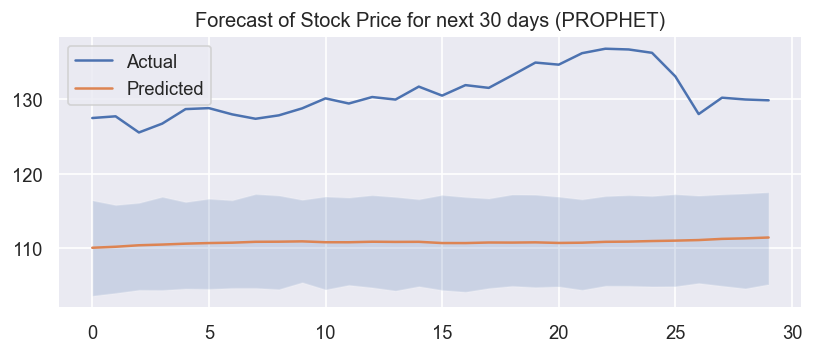

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5525.810, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5521.810, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5523.810, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5523.810, Time=0.22 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5519.834, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.957 seconds


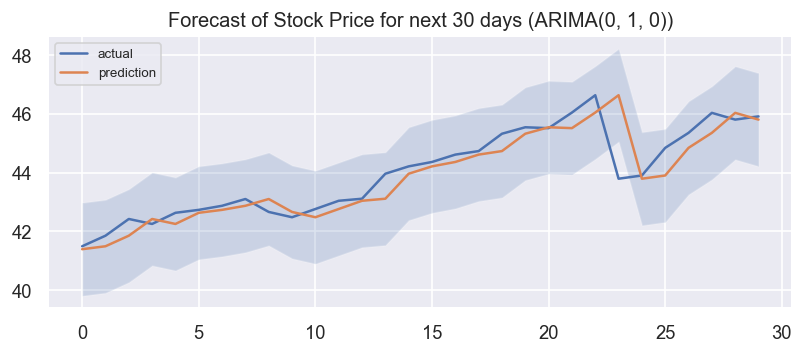

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -148.248
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6120.53     0.0110338       950.644      0.4961      0.4961      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6186.04     0.0102481       357.038           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     222       6195.18   0.000262181       191.598   1.641e-06       0.001      297  LS failed, Hessian reset 
     299       6203.58     0.0123679        118.45           1           1      393   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6212.32      0.032922       353.732      0.4093      0.4093      513   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6224.46    0.00557841    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  33.817761   28.879485   36.448860    33.817761    33.817761   
1  2017-10-03  33.816852   28.752392   36.138609    33.816852    33.816852   
2  2017-10-04  33.815943   28.464176   35.971286    33.815943    33.815943   
3  2017-10-05  33.815033   28.641587   36.008430    33.815033    33.815033   
4  2017-10-06  33.814124   28.869803   35.936770    33.814124    33.814124   
5  2017-10-09  33.811396   28.069879   35.718140    33.811396    33.811396   
6  2017-10-10  33.810487   28.215548   35.749438    33.810487    33.810487   
7  2017-10-11  33.809577   28.143482   35.928639    33.809577    33.809577   
8  2017-10-12  33.808668   28.484033   36.081194    33.808668    33.808668   
9  2017-10-13  33.807759   28.585141   35.742905    33.807759    33.807759   
10 2017-10-16  33.805031   28.583216   35.643460    33.805031    33.805031   
11 2017-10-17  33.804121   28.218238   35.974579    33.804121   

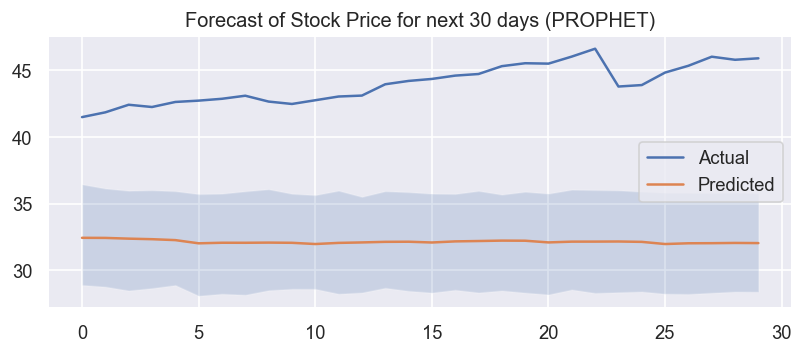

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=10520.881, Time=0.76 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=10526.482, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=10525.040, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=10524.749, Time=0.13 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=10524.547, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=10523.792, Time=0.73 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=10523.897, Time=0.90 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=10522.292, Time=0.27 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=10522.286, Time=0.19 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=10519.978, Time=2.71 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=10524.825, Time=2.54 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=10524.412, Time=4.05 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=10524.674, Time=2.70 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=10525.757, Time=1.70 sec
 ARIMA(3,1,3)(0,0,0

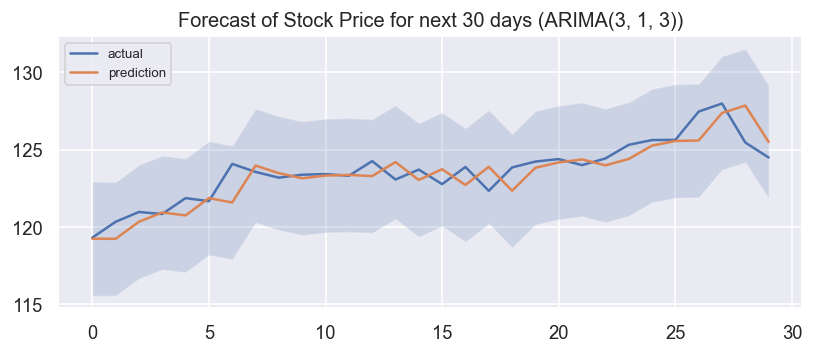

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -46.5964
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6876.33    0.00320903       685.294           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7037.66    0.00111597        604.03      0.3005      0.3005      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7109.53     0.0382582       530.607      0.9665      0.9665      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7170.69      0.156475       948.643           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7196.68    0.00063142       85.0599      0.8277      0.8277      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  106.567621   97.228514  111.658595   106.567621   106.567621   
1  2017-10-03  106.549352   96.646103  111.920892   106.549352   106.549352   
2  2017-10-04  106.531082   96.592806  111.856100   106.531082   106.531082   
3  2017-10-05  106.512813   95.931630  110.763816   106.512813   106.512813   
4  2017-10-06  106.494543   95.112118  110.314505   106.494543   106.494543   
5  2017-10-09  106.439734   94.716279  109.704999   106.439734   106.439734   
6  2017-10-10  106.421464   94.369698  110.320247   106.421464   106.421464   
7  2017-10-11  106.403195   94.422910  109.466493   106.403195   106.403195   
8  2017-10-12  106.384925   94.216618  109.449164   106.384925   106.384925   
9  2017-10-13  106.366656   93.798183  109.289974   106.366656   106.366656   
10 2017-10-16  106.311847   94.545916  109.707294   106.311847   106.311847   
11 2017-10-17  106.293577   94.540859  109.379831   

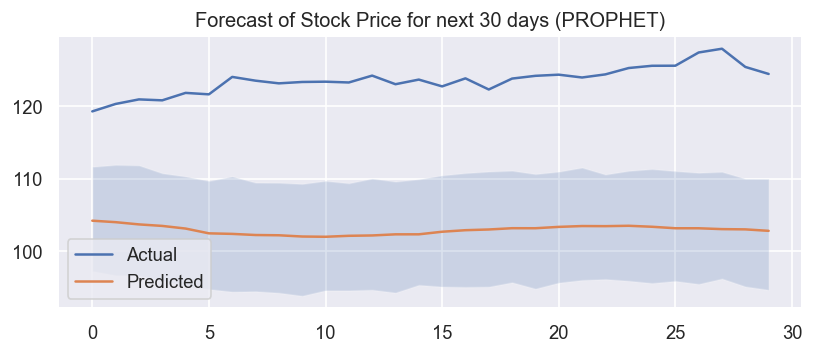

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7219.443, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7216.405, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7217.562, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7217.575, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7215.701, Time=0.04 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.701 seconds


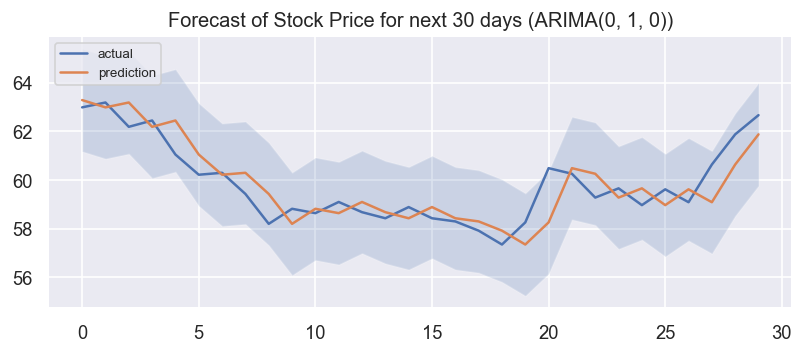

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -45.7626
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       7089.54    0.00541685       1175.07      0.0981           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7431.61      0.106822       718.819           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7563.11    0.00318066       381.078           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399          7648     0.0255246       758.647           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     416       7653.52   9.96713e-05        280.93   2.784e-07       0.001      520  LS failed, Hessian reset 
     499       7678.33     0.0122372    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  59.548348   53.599233   62.584714    59.548348    59.548348   
1  2017-10-03  59.509760   53.659044   62.818466    59.509760    59.509760   
2  2017-10-04  59.471172   53.086397   62.697652    59.471172    59.471172   
3  2017-10-05  59.432583   53.180343   62.442105    59.432583    59.432583   
4  2017-10-06  59.393995   53.229911   62.374113    59.393995    59.393995   
5  2017-10-09  59.278230   53.652932   62.286011    59.278230    59.278230   
6  2017-10-10  59.239642   53.202178   62.418943    59.239642    59.239642   
7  2017-10-11  59.201054   52.700476   62.259052    59.201054    59.201054   
8  2017-10-12  59.162465   52.796473   62.088251    59.162465    59.162465   
9  2017-10-13  59.123877   53.360823   62.210465    59.123877    59.123877   
10 2017-10-16  59.008112   52.546142   62.062590    59.008112    59.008112   
11 2017-10-17  58.969524   53.068462   62.499849    58.969524   

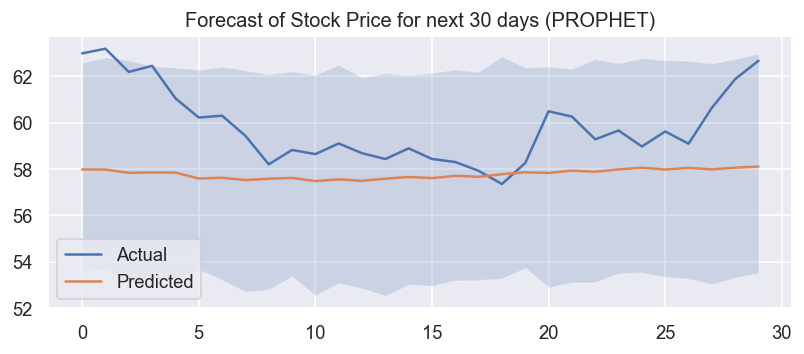

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=7586.512, Time=0.82 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=7590.982, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=7589.046, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=7588.698, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=7589.833, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=7587.196, Time=0.72 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=7587.285, Time=0.78 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=7586.045, Time=0.28 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=7586.417, Time=0.44 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=7581.814, Time=1.08 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=7578.884, Time=2.36 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=7589.073, Time=1.56 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=7579.342, Time=2.88 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=7579.638, Time=2.19 sec
 ARIMA(2,1,3)(0,0,0)[0]          

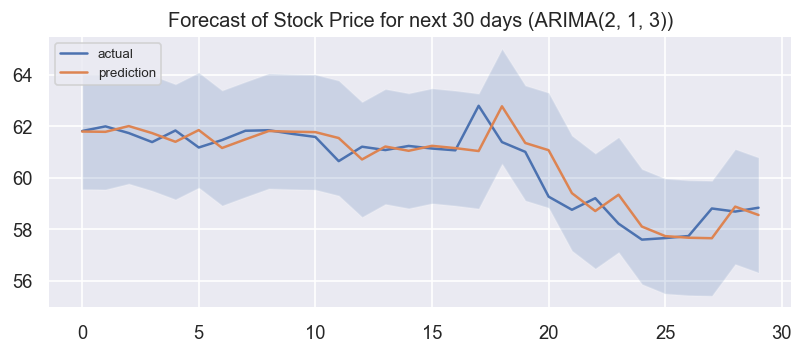

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -26.7118
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6627.75     0.0377224       1788.74           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6860.03     0.0248105       252.062      0.8532      0.8532      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6900.02     0.0216642       411.726           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6962.75    0.00269882       528.748           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6987.58    0.00786798       199.117       1.488      0.1488      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  62.481956   56.210644   65.461012    62.481956    62.481956   
1  2017-10-03  62.494242   55.836117   65.036329    62.494242    62.494242   
2  2017-10-04  62.506529   56.203136   65.036684    62.506529    62.506529   
3  2017-10-05  62.518815   56.091445   65.411222    62.518815    62.518815   
4  2017-10-06  62.531101   56.356814   65.010492    62.531101    62.531101   
5  2017-10-09  62.567960   56.552946   65.269038    62.567960    62.567960   
6  2017-10-10  62.580246   56.582929   65.176766    62.580246    62.580246   
7  2017-10-11  62.592532   56.652194   65.574696    62.592532    62.592532   
8  2017-10-12  62.604818   56.889723   65.495558    62.604818    62.604818   
9  2017-10-13  62.617104   56.774506   65.693722    62.617104    62.617104   
10 2017-10-16  62.653963   57.017080   65.772753    62.653963    62.653963   
11 2017-10-17  62.666249   57.194609   65.949496    62.666249   

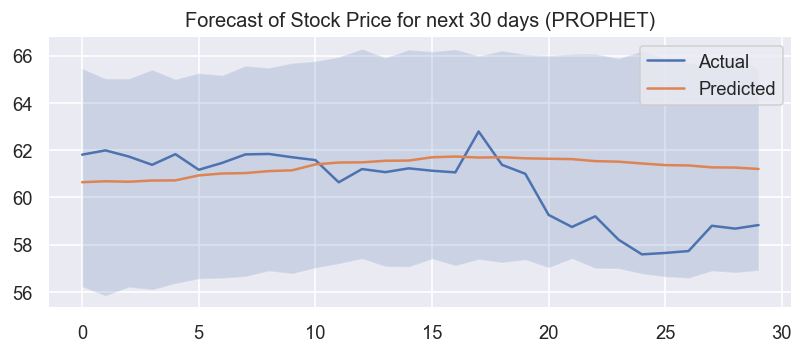

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4289.326, Time=0.49 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4305.434, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4288.764, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4287.741, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4303.638, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4288.707, Time=0.29 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4277.122, Time=1.06 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4276.141, Time=1.74 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4275.092, Time=1.03 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4287.314, Time=0.23 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4275.714, Time=1.09 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=4278.834, Time=0.32 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=4277.467, Time=1.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=4273.363, Time=0.33 sec
 ARIMA(1,1,1)(0,0,0)[0]          

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


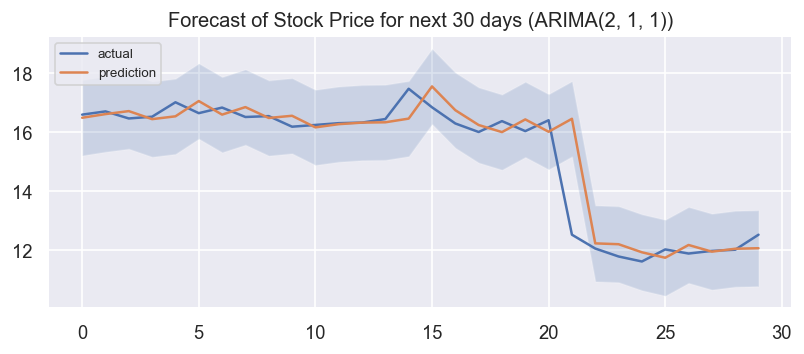

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -85.535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        6809.7    0.00977617       1087.85           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       7050.43     0.0777459       628.764           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       7213.46     0.0300702        425.32           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       7286.16     0.0234654       497.361      0.5172           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       7301.76     0.0143417       485.717           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha   

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  19.054257   17.568747   23.241990    19.054257    19.054257   
1  2017-10-03  19.020025   17.559421   23.556172    19.020025    19.020025   
2  2017-10-04  18.985794   17.322571   23.315440    18.985794    18.985794   
3  2017-10-05  18.951563   17.588577   23.415248    18.951563    18.951563   
4  2017-10-06  18.917331   17.365586   23.276833    18.917331    18.917331   
5  2017-10-09  18.814637   17.400138   23.353726    18.814637    18.814637   
6  2017-10-10  18.780406   17.216240   23.076578    18.780406    18.780406   
7  2017-10-11  18.746175   17.005038   23.111992    18.746175    18.746175   
8  2017-10-12  18.711943   17.200305   23.096972    18.711943    18.711943   
9  2017-10-13  18.677712   17.327532   23.037519    18.677712    18.677712   
10 2017-10-16  18.575018   16.832133   22.918408    18.575018    18.575018   
11 2017-10-17  18.540787   17.085603   22.902419    18.540787   

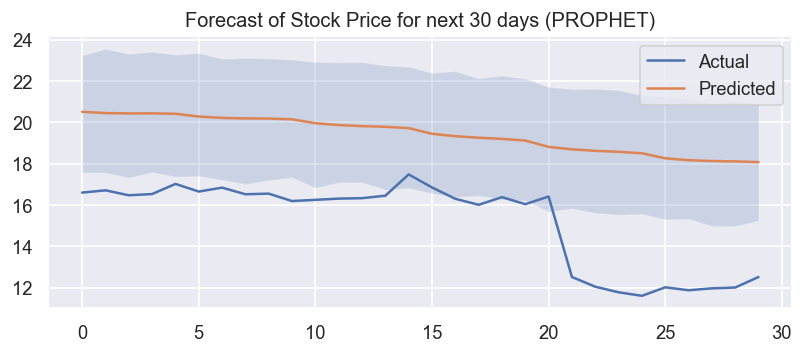

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4471.206, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4471.551, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4469.221, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4469.206, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4470.445, Time=0.06 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4471.189, Time=0.27 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4473.205, Time=0.32 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4468.175, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4470.178, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=4470.162, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4468.186, Time=0.10 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=4472.175, Time=0.17 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 1.861 seconds


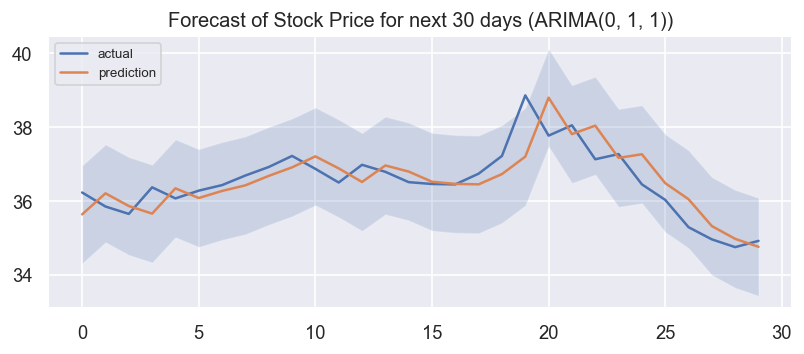

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -61.101
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5940.51     0.0185282       345.983           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6051.89     0.0043882       175.235           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6081.41     0.0040498       431.839      0.8488      0.8488      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     353       6092.51   0.000521326       104.411   3.434e-06       0.001      449  LS failed, Hessian reset 
     399       6101.15     0.0011817       589.148      0.5074      0.5074      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     404       6101.29   8.51822e-05     

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  28.344181   24.665576   31.347144    28.344181    28.344181   
1  2017-10-03  28.342804   24.984834   31.267093    28.342804    28.342804   
2  2017-10-04  28.341428   24.920545   31.402290    28.341428    28.341428   
3  2017-10-05  28.340051   24.736836   31.390844    28.340051    28.340051   
4  2017-10-06  28.338675   24.859499   31.111711    28.338675    28.338675   
5  2017-10-09  28.334546   24.458328   30.957257    28.334546    28.334546   
6  2017-10-10  28.333169   24.344498   31.040993    28.333169    28.333169   
7  2017-10-11  28.331793   24.496089   31.189985    28.331793    28.331793   
8  2017-10-12  28.330416   24.738275   30.886920    28.330416    28.330416   
9  2017-10-13  28.329040   24.537370   31.217876    28.329040    28.329040   
10 2017-10-16  28.324911   24.505624   31.099725    28.324911    28.324911   
11 2017-10-17  28.323534   24.471642   31.107854    28.323534   

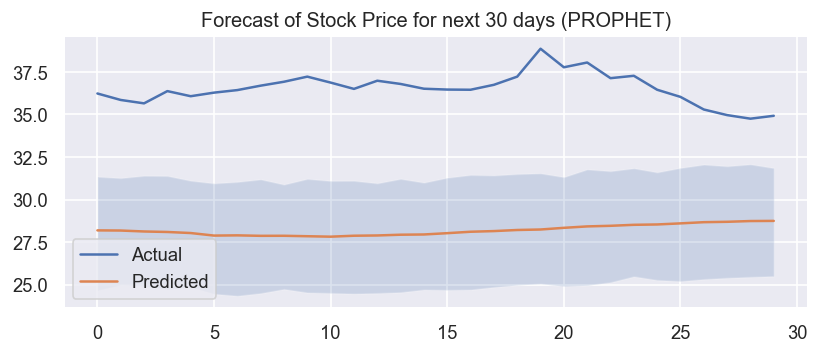

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=6555.174, Time=0.92 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=6551.480, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=6553.459, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=6553.458, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=6549.481, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.446 seconds


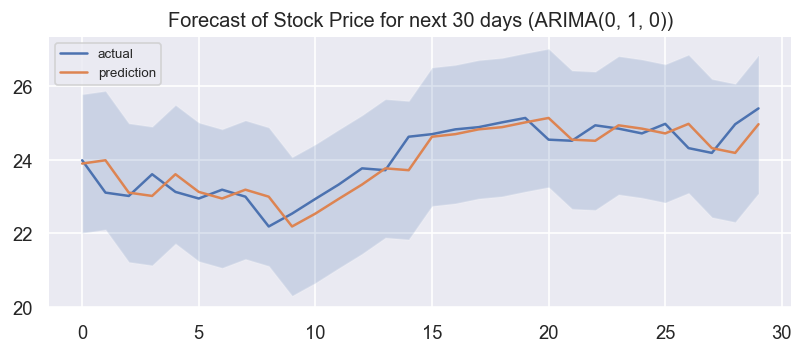

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -56.5137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5260.39      0.294699       962.872           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       5364.58    0.00378427       584.742           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       5405.46    0.00714588       256.099       0.938       0.938      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       5419.78    0.00782835       443.321       3.513      0.3513      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     425       5424.78   0.000309694       204.892   1.149e-06       0.001      556  LS failed, Hessian reset 
     499       5434.89    0.00297682    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.314912   17.406976   26.773630    22.314912    22.314912   
1  2017-10-03  22.300879   17.474312   26.587188    22.300879    22.300879   
2  2017-10-04  22.286846   17.162610   26.852619    22.286846    22.286846   
3  2017-10-05  22.272813   17.269978   26.903147    22.272813    22.272813   
4  2017-10-06  22.258780   17.696781   26.904500    22.258780    22.258780   
5  2017-10-09  22.216680   16.827029   26.207598    22.216680    22.216680   
6  2017-10-10  22.202647   16.286458   26.313939    22.202647    22.202647   
7  2017-10-11  22.188614   16.535900   25.931598    22.188614    22.188614   
8  2017-10-12  22.174581   16.554162   25.663061    22.174581    22.174581   
9  2017-10-13  22.160548   16.475169   25.621206    22.160548    22.160548   
10 2017-10-16  22.118448   15.929484   25.532743    22.118448    22.118448   
11 2017-10-17  22.104415   16.139598   25.658550    22.104415   

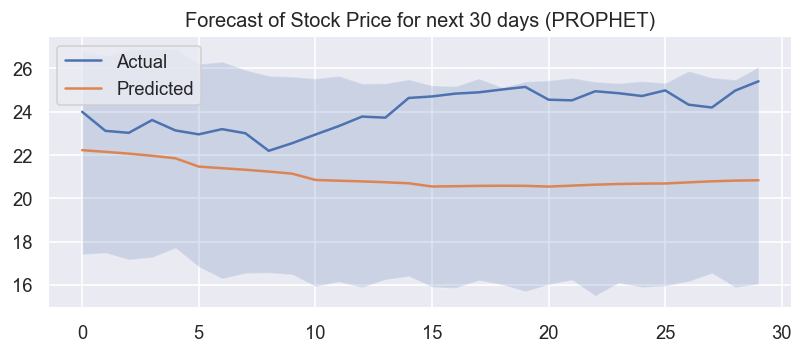

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=9442.382, Time=0.54 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=9454.769, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=9444.686, Time=0.13 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=9443.981, Time=0.17 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=9461.980, Time=0.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=9443.033, Time=0.77 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=9442.679, Time=0.81 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=9443.998, Time=0.22 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=9443.964, Time=0.16 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=9444.054, Time=1.54 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=9452.893, Time=0.19 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 4.631 seconds


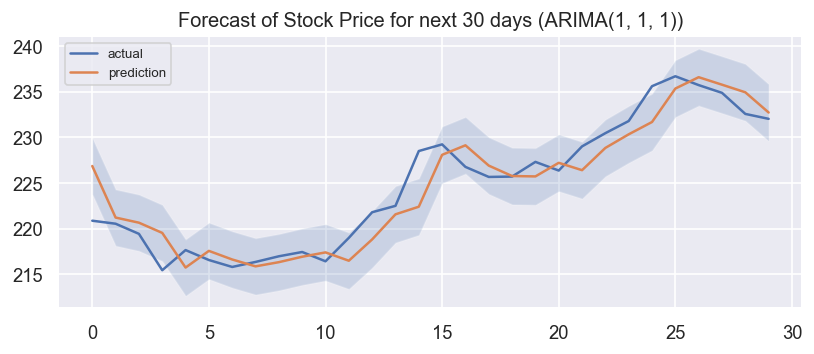

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -140.448
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       9322.27      0.173817       5714.38           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       9516.18     0.0063709       1586.03           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       9597.19    0.00696323       2303.66           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       9663.53   0.000798668       442.625           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     448       9667.81   0.000202522       449.366   8.796e-07       0.001      551  LS failed, Hessian reset 
     499       9671.22    0.00253247    

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  211.643783  205.291582  217.322902   211.643783   211.643783   
1  2017-10-03  211.788137  204.809440  217.798938   211.788137   211.788137   
2  2017-10-04  211.932492  205.372737  217.184048   211.932492   211.932492   
3  2017-10-05  212.076846  205.443782  217.861241   212.076846   212.076846   
4  2017-10-06  212.221200  205.819468  217.776658   212.221200   212.221200   
5  2017-10-09  212.654263  205.506975  218.445060   212.654263   212.654263   
6  2017-10-10  212.798617  205.365463  217.069128   212.798617   212.798617   
7  2017-10-11  212.942972  205.320321  218.072868   212.942972   212.942972   
8  2017-10-12  213.087326  205.822336  217.651915   213.087326   213.087326   
9  2017-10-13  213.231680  205.795309  217.764158   213.231680   213.231680   
10 2017-10-16  213.664743  206.591939  218.722905   213.664743   213.664743   
11 2017-10-17  213.809098  206.796771  218.775904   

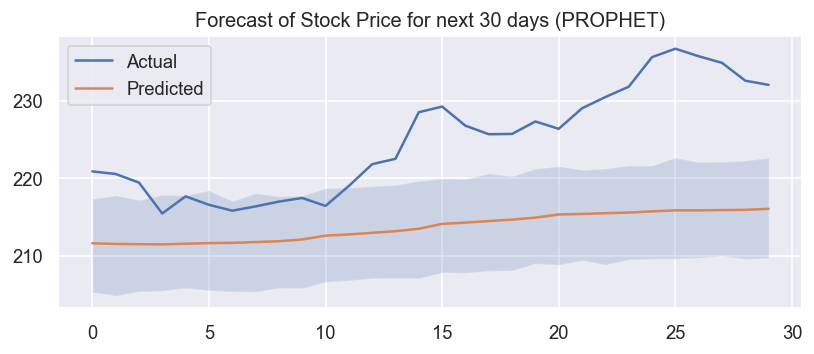

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2285.688, Time=1.24 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2285.608, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2287.577, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2287.576, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=2284.518, Time=0.08 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.877 seconds


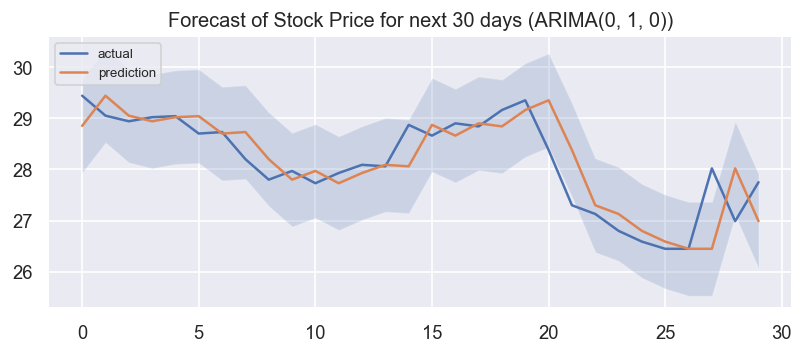

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -23.1675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       6188.72      0.011277       376.192           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6209.97      0.065914       361.472           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       6226.89    0.00341086       115.215           1           1      366   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6239.81    0.00242592       100.052           1           1      491   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6243.86    0.00227042        143.12           1           1      624   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  22.761510   19.868388   25.762421    22.761510    22.761510   
1  2017-10-03  22.760121   19.687686   25.628906    22.760121    22.760121   
2  2017-10-04  22.758732   20.105536   25.602578    22.758732    22.758732   
3  2017-10-05  22.757343   19.727419   25.674942    22.757343    22.757343   
4  2017-10-06  22.755955   19.947162   25.781640    22.755955    22.755955   
5  2017-10-09  22.751788   19.584541   25.709081    22.751788    22.751788   
6  2017-10-10  22.750400   19.663757   25.437439    22.750400    22.750400   
7  2017-10-11  22.749011   19.661201   25.331333    22.749011    22.749011   
8  2017-10-12  22.747622   19.349691   25.107114    22.747622    22.747622   
9  2017-10-13  22.746234   19.595009   25.447877    22.746234    22.746234   
10 2017-10-16  22.742067   19.238468   25.389356    22.742067    22.742067   
11 2017-10-17  22.740679   19.213681   25.021306    22.740679   

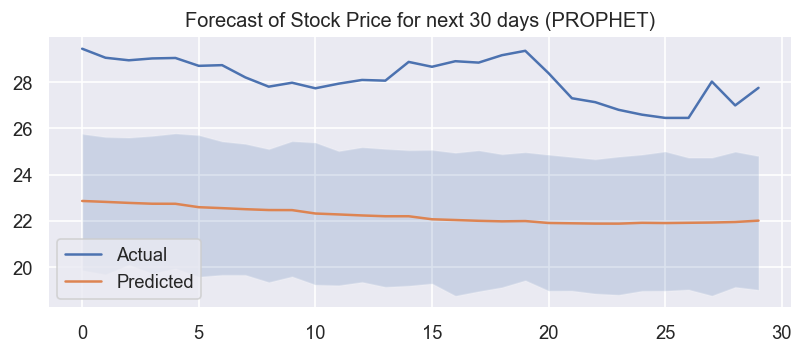

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=13496.430, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=13492.661, Time=0.04 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=13494.428, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=13494.431, Time=0.18 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=13491.486, Time=0.05 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 0.655 seconds


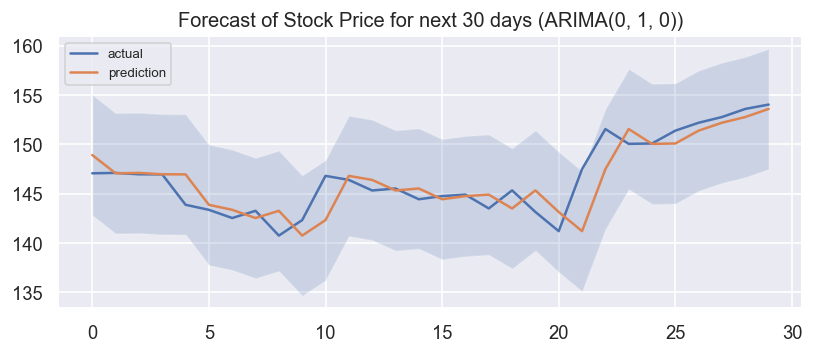

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -35.8273
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       5870.85     0.0490459       1404.31           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       6300.37     0.0173319        1723.3       0.548       0.548      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        6568.4    0.00604968       1016.94           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       6723.87   0.000474576       583.589      0.2561      0.2561      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       6788.79     0.0386847       778.881      0.7108      0.7108      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds       trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  119.831206  107.133874  131.522228   119.831206   119.831206   
1  2017-10-03  119.883034  105.892678  131.806986   119.883034   119.883034   
2  2017-10-04  119.934861  106.850086  131.737553   119.934861   119.934861   
3  2017-10-05  119.986689  105.987971  131.151453   119.986689   119.986689   
4  2017-10-06  120.038517  106.024157  131.517039   120.038517   120.038517   
5  2017-10-09  120.194000  105.634900  129.933392   120.194000   120.194000   
6  2017-10-10  120.245828  106.607305  131.404344   120.245828   120.245828   
7  2017-10-11  120.297656  105.465829  131.126703   120.297656   120.297656   
8  2017-10-12  120.349483  105.029896  131.074972   120.349483   120.349483   
9  2017-10-13  120.401311  104.787157  131.032405   120.401311   120.401311   
10 2017-10-16  120.556794  105.695789  130.616528   120.556794   120.556794   
11 2017-10-17  120.608622  105.318830  131.031300   

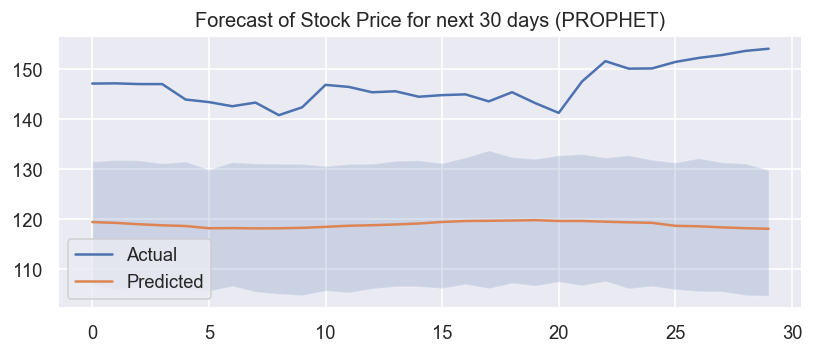

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=5511.515, Time=0.75 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5532.397, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5529.654, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5529.005, Time=0.19 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5533.484, Time=0.05 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5510.709, Time=1.81 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=5521.436, Time=0.19 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=5512.191, Time=0.85 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=5512.134, Time=1.93 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=5510.835, Time=1.08 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=5515.228, Time=0.26 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=5514.221, Time=0.95 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=5513.628, Time=0.31 sec

Best model:  ARIMA(2,1,1)(0,0,0)[0] intercept
Total fit time: 8.637 seconds


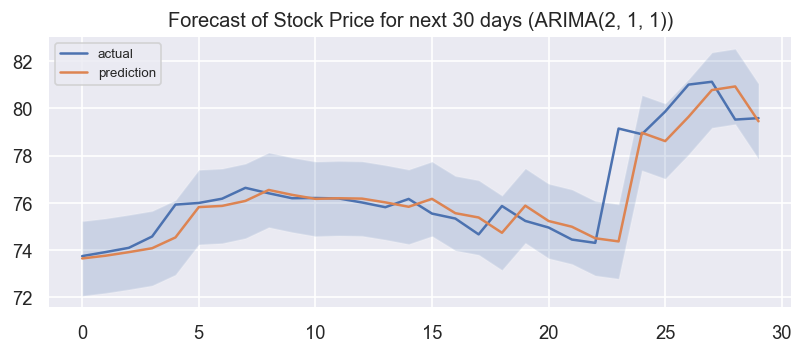

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


Initial log joint probability = -16.6541
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
Exception: normal_lpdf: Scale parameter is 0, but must be > 0!  (in 'unknown file name' at line 136)

Error evaluating model log probability: Non-finite gradient.

      99       8303.39     0.0506849       2008.67           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       8348.51     0.0178117       1502.66           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       8376.55     0.0122466       487.213           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       8389.32    0.00147749       133.501           1           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # e

/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/pallavibothra/opt/anaconda3/envs/prophet39/lib/python3.9/site-packages/prophet/forecaster.py:896: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


           ds      trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0  2017-10-02  70.705346   66.445963   73.128795    70.705346    70.705346   
1  2017-10-03  70.726659   66.194600   72.963417    70.726659    70.726659   
2  2017-10-04  70.747971   66.215514   72.928812    70.747971    70.747971   
3  2017-10-05  70.769284   66.261924   72.916777    70.769284    70.769284   
4  2017-10-06  70.790596   66.323012   72.718972    70.790596    70.790596   
5  2017-10-09  70.854534   66.129561   72.841470    70.854534    70.854534   
6  2017-10-10  70.875846   66.141376   72.467593    70.875846    70.875846   
7  2017-10-11  70.897159   66.079592   72.883804    70.897159    70.897159   
8  2017-10-12  70.918471   65.951569   72.668282    70.918471    70.918471   
9  2017-10-13  70.939784   65.947017   72.552484    70.939784    70.939784   
10 2017-10-16  71.003721   66.004302   73.069091    71.003721    71.003721   
11 2017-10-17  71.025034   65.999458   72.872862    71.025034   

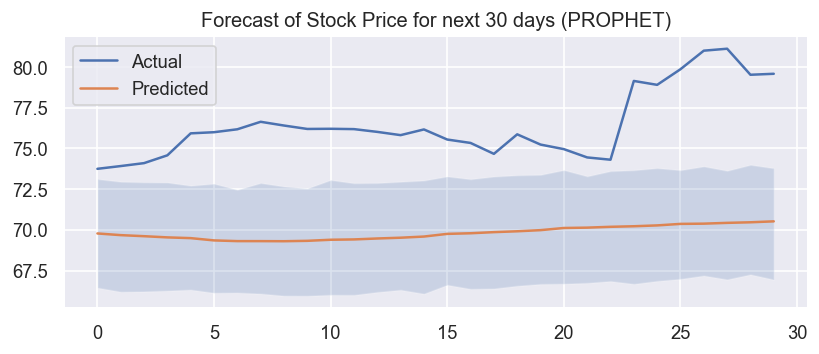

total_time: 38 mins 9 secs


In [432]:
start = time.time()
keys_list = []
PMDARIMA_RMSE_list = []
PMDARIMA_MAPE_list = []
PROPHET_RMSE_list = []
PROPHET_MAPE_list = []
for keys in cons_cyc_df_years:
    try:
        Company_df = cons_cyc_df_years[keys][['Close']]
        pmdarima_model = pmdarima_model_eval(Company_df)
        prophet_model = prophet_model_eval(Company_df)
        keys_list.append(keys)
        PMDARIMA_RMSE_list.append(pmdarima_model[1])
        PMDARIMA_MAPE_list.append(pmdarima_model[2])
        PROPHET_RMSE_list.append(prophet_model[1])
        PROPHET_MAPE_list.append(prophet_model[2])
    except KeyError:
        pass
    
    
eval_metrics = pd.DataFrame({'Company' : keys_list ,'PMDARIMA_RMSE' : PMDARIMA_RMSE_list,'PMDARIMA_MAPE' :PMDARIMA_MAPE_list , 'Prophet_RMSE': PROPHET_RMSE_list,'Prophet_MAPE' : PROPHET_MAPE_list})
end = time.time()
print('total_time: {} mins {} secs'.format(int((end - start)/60), int(end - start)%60))


In [434]:
eval_metrics_final = eval_metrics.copy()

In [435]:
eval_metrics_final

,Company,PMDARIMA_RMSE,PMDARIMA_MAPE,Prophet_RMSE,Prophet_MAPE
0,AAN,0.911358,0.016202,9.710925,0.220906
1,ANF,0.394411,0.020395,3.914968,0.288544
2,AAP,1.616379,0.013680,42.845225,0.496572
3,AIN,0.871488,0.008481,8.165627,0.139757
4,AMZN,24.781994,0.010127,57.682643,0.052654
...,...,...,...,...,...
147,URBN,0.429364,0.014140,3.291062,0.124189
148,MTN,2.333392,0.007986,12.324862,0.048944
149,WWW,0.533592,0.013525,5.957204,0.209443
150,WYNN,2.012363,0.009610,27.985402,0.188560


In [ ]:
eval_metrics.nsmallest(columns ='PMDARIMA_MAPE',n = 5)